<a href="https://colab.research.google.com/github/lfernandof/lfp_signals_analysis/blob/main/lfp_main_pipeline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Install packages and mount Drive space containing data and other resources

In [1]:
!pip install imageio

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.io as sio
import os
import json
import scipy

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### custom functions

In [47]:
def data_from_mat(rat_id,day_id):
    animal_label = f'rat{rat_id}_day{day_id}_LFP_all'

    if os.path.isdir(f'./data/separated_channels/{animal_label}'): #if the .mat file has already been split
      pass #simply skip this phase
    else: #whereas if not, split it proper
      data = sio.loadmat('./data/'+animal_label+'_regions.mat')

      lfp = data[animal_label]['data'][0][0].T #using the transpose so its shape is (num_channels,num_points)
      timestamps = data[animal_label]['timestamps'][0][0]
      regions_listing = data[animal_label]['regions'][0][0][0]

      regions = {}
      metadata = {}
      metadata['total_duration'] = float(data[animal_label]['duration'][0][0][0][0])
      metadata['interval'] = list(data[animal_label]['interval'][0][0][0])
      metadata['sampling_rate'] = int(data[animal_label]['samplingRate'][0][0][0][0])

      #create a folder to store the data
      os.chdir('./data/separated_channels')
      os.makedirs(animal_label)

      #go inside this folder
      os.chdir(animal_label)

      #loop through the dataset
      for i in range(np.shape(lfp)[0]):
          label = f'ch{i}_{regions_listing[i][0]}'  #chX_region, channel in [0,31]
          #and region being either "PFC" or "STR"

          regions[label.split('_')[0]] = label.split('_')[1]

          #save each channel's activity as a .npy file
          np.save(file=label,arr=lfp[i,:])

      #save the timestamps to a .npy file
      np.save(file='timestamps',arr=timestamps)

      #save the channel-region correspondence into a file
      import json
      with open("channel_region", "w") as regions_file:
          json.dump(obj=regions,fp=regions_file)

      #save the metadata to a text file
      with open('metadata','w') as metadata_file:
          json.dump(obj=metadata,fp=metadata_file)

      #return to the former directory
      os.chdir('../../..')
      #and confirm whether it really is where one started
      print(os.getcwd())

#this should be run in the 'separated_channels' folder
def load_lfp(rat_id,day_id,channel_id):
    #file_path = f'./rat{rat_id}_day{day_id}_LFP_all'
    import json
    with open("./channel_region", "r") as fp:
        regions_listing = json.load(fp) #load the JSON with channel-region pairings
    region = regions_listing[f'ch{channel_id}'] #from it fetch the region for the current channel

    timestamps_data = np.squeeze(np.load('./timestamps.npy'))
    lfp_data = np.squeeze(np.load(f'./ch{channel_id}_'+region+'.npy'))

    df = pd.DataFrame.from_dict({'timestamps':timestamps_data,'lfp':lfp_data})
    return df,channel_id,region

######################################### DEPRECATED #########################################
def band_extraction_IIR(lfp_data,cutoff_low,cutoff_high,sampling_rate=1250,order=3):
    '''Filter the broadband LFP signal, allowing only frequencies between the limits [cutoff_low,cutoff_high]
    using a Butter bandpass filter.

    INPUT:
        - lfp_data: a pandas Series object containing the signal to be filtered (i.e. the LFP);
        - cutoff_low: the lowest frequency allowed;
        - cutoff_high: the highest frequency allowed;
        - sampling_rate: in Hz [default: 1250];
        - order: the order of the Butter filter employed [default: 3]

    OUTPUT:
        - the filtered signal as a 1D numpy array;
    '''

    from scipy.signal import butter, lfilter, filtfilt

    #Design the filter
    nyquist_freq = 0.5*sampling_rate
    inf_threshold = cutoff_low/nyquist_freq
    sup_threshold = cutoff_high/nyquist_freq
    b,a = butter(order,[inf_threshold,sup_threshold],btype='bandpass')

    #Return the filter applied to the signal
    return filtfilt(b,a,lfp_data)

################################################################ generate comodulogram gif
def comodulogram2(lfp,ind_band=[1,20],dep_band=[20,200],ind_step=2,dep_step=5,
                  ind_bandwidth=4,dep_bandwidth=10,num_bins=18,sampling_rate=1250):

    bin_size = round(360/num_bins)
    phasevector = np.arange(-180,180-bin_size+1,bin_size)
    phase_freq_vector = np.arange(ind_band[0],ind_band[1],ind_step)
    amp_freq_vector = np.arange(dep_band[0],dep_band[1],dep_step)

    mean_amp = np.empty(num_bins)
    comodulogram = np.empty((len(phase_freq_vector),len(amp_freq_vector)))

    from scipy.signal import hilbert
    for count_phase,fp in enumerate(phase_freq_vector):
        ind_analytic = hilbert(band_extraction(lfp,cutoff_low=fp,cutoff_high=fp+ind_bandwidth,
                                               sampling_rate=sampling_rate))
        phase = np.angle(ind_analytic)

        for count_amp,fa in enumerate(amp_freq_vector):
            dep_analytic = hilbert(band_extraction(lfp,cutoff_low=fa,cutoff_high=fa+dep_bandwidth,
                                                   sampling_rate=sampling_rate))
            amplitude = abs(dep_analytic)

            for count,phasebin in enumerate(phasevector):
                I = (np.rad2deg(phase)>phasebin)*(np.rad2deg(phase)<(phasebin+20))
                mean_amp[count] = np.mean(amplitude[I])

            p = mean_amp/sum(mean_amp)
            MI = (np.log(len(p))+sum(p[p>0]*np.log(p[p>0])))/np.log(len(p))
            comodulogram[count_phase,count_amp] = MI

    return comodulogram,phase_freq_vector,amp_freq_vector

def plot_comodulogram(comod,ind_freqs,dep_freqs,trial_index=''):
    #estimating the frequency step used to build the comodulogram from the frequencies
    ind_step = ind_freqs[1] - ind_freqs[0]
    dep_step = dep_freqs[1] - dep_freqs[0]

    #make a grid to accommodate the data
    x,y = np.meshgrid(ind_freqs,dep_freqs)

    plt.contourf(x, y, comod.T, 30, cmap=plt.cm.viridis)
    plt.title(f'Trial: {trial_index}')
    plt.xlabel('Independent \n frequency (Hz)')
    plt.ylabel('Dependent \n frequency (Hz)')
    plt.colorbar(label="Modulation Index (MI)")

#this should be run inside all_channels/data/separated_channels/______ (session)
def comodulogram_gif(trials_dict,ind_band=[1,20],dep_band=[30,200],ind_step=0.25,dep_step=2,ind_bandwidth=0.25,dep_bandwidth=2,
                     nbins=50,sampling_rate=1250):
#  lfp,ind_band=[1,20],dep_band=[20,200],ind_step=0.25,dep_step=2,
#                  ind_bandwidth=0.25,dep_bandwidth=2,num_bins=50,sampling_rate=1250
    os.mkdir('./comodulogram_gif')
    #generate each trial's comodulogram and save it to a .png file
    for trial_index in trials_dict.keys():
        current_lfp = trials_dict[trial_index].lfp.values
        comod, ind_freqs, dep_freqs = comodulogram2(current_lfp,ind_band=[1,20],dep_band=[25,200],ind_step=2,
                                                dep_step=5,ind_bandwidth=5,dep_bandwidth=10,
                                                num_bins=18,sampling_rate=1250)
        plot_comodulogram(comod,ind_freqs,dep_freqs,trial_index) #WRITE THIS FUNCTION HERE
        plt.savefig('./comodulogram_gif/'+trial_index+'.png',format='png')
        plt.close()

    #make a gif out of these images
    filenames = ['./comodulogram_gif/'+trial_index+'.png' for trial_index in trials_dict.keys()]
    import imageio as iio
    images = list()

    for file in filenames:
        images.append(iio.imread(file))

    iio.mimsave('./session_cfc.gif',images,format='GIF',duration=0.4)

##################################################################################

def compute_erp(trials_dict,norm_by_mean = True):
    #I should use the number of points in the shortest trial in the dictionary
    #for now, I will choose a random trial from the dictionary because all should have the same length
    from numpy import random
    series_length = len(trials_dict[random.choice(list(trials_dict.keys()))])

    num_trials = len(trials_dict)
    recipient = np.ndarray([num_trials,series_length])
    counter = 0
    for trial in trials_dict.keys():
        buffer_lfp = trials_dict[trial]['lfp']
        if norm_by_mean:
            buffer_lfp = buffer_lfp - np.mean(buffer_lfp)
        recipient[counter,:] = buffer_lfp
        counter+=1

    #the "ERP" is the mean along all trials
    erp = np.mean(recipient,axis=0)
    return erp,recipient

def erp_comodulogram(erp_signal,erp_label):
    comod,ind_freqs,dep_freqs = comodulogram2(erp_signal,ind_band=[1,20],dep_band=[20,200],ind_step=2,dep_step=5,
                                ind_bandwidth=4,dep_bandwidth=10,num_bins=18,sampling_rate=1250)
    plot_comodulogram(comod,ind_freqs,dep_freqs,trial_index='')
    plt.savefig('./erp_comodulogram/'+erp_label+'.png',format='png')

    plt.close()

In [3]:
def split_lfp_trials(session_df,lfp_df,rat_id,day_id,region_id,min_duration=0.8,sampling_rate=1250,
                      slicing='first',peri_trial_inclusion = 0,per_slice=1500):
    elegible_trials = session_df.query(f"rat == {rat_id} & day == {day_id} &\
    region == '{region_id}' & duration >= {min_duration}")
    elegible_trials = elegible_trials.sort_values('trial').copy()

    #separate the lfp df into a dictionary of trials, whose keys are trial identifiers and
    #values are dfs corresponding to excerpts of the whole lfp signal that fall between
    #each trials' time boundaries [trial begin, trial end]

    trials_dict = {}
    for trial in elegible_trials.trial.unique():
        '''upon profiling this function to probe its performance I have concluded it is very slow
        the pieces of code that were taking too long were these queries below, so I'll comment them out and implement another querying method (expression matching on Series.values)
        nonetheless, I will leave them for the sake of comprehension of what is going on in the following expression, which yields the same but in a fraction of the elapsed time
        '''

        #select the current trial in the behavioral/spikes dataframe
        #current_trial = elegible_trials.query(f"trial == {int(trial)}")
        current_trial = elegible_trials[elegible_trials.trial.values == int(trial)]

        #extract the timestamps for the beginning and end of trial using the 1st
        #spike (begin) and total duration (end)
        begin = current_trial.iloc[0].timestamp - current_trial.iloc[0].time
        end = begin + current_trial.iloc[0].duration

        #fetch the lfp data within these two timepoints and add to the dict as our trial
        #current_lfp = lfp_df.query(f"timestamps >= {begin-peri_trial_inclusion} & timestamps <= {end}")
        current_lfp = lfp_df[(lfp_df.timestamps.values >= (begin-peri_trial_inclusion)) & (lfp_df.timestamps.values <= end)]

        if slicing == 'first':
                trials_dict[f'trial_{int(trial)}'] = current_lfp.head(per_slice)
        elif slicing == 'last':
            trials_dict[f'trial_{int(trial)}'] = current_lfp.tail(per_slice)
        elif slicing == 'none':
            trials_dict[f'trial_{int(trial)}'] = current_lfp
    print('done parsing the LFP into trials')

    return trials_dict

#### corrected filtering and associated functions (25/09/2023)

In [17]:
#new version: soon i'll simply delete the other implementation of these two above

def comodulogram2(lfp,ind_band=[1,20],dep_band=[20,200],ind_step=0.25,dep_step=2,
                  ind_bandwidth=0.25,dep_bandwidth=2,num_bins=50,sampling_rate=1250):
  '''
  estimate the modulation index for pairs of frequencies {modulating,modulated}, each spanning a range of values
  '''

  freqs_for_amps = np.arange(dep_band[0],dep_band[1]+dep_step,dep_step)
  freqs_for_phases = np.arange(ind_band[0],ind_band[1]+ind_step,ind_step)

  filtered_phases = np.empty([len(freqs_for_phases) - 1,len(lfp)])

  from scipy.signal import hilbert

  for phase_index,phase in enumerate(freqs_for_phases[0:-1]):
    filtered_phases[phase_index,:] = np.angle(hilbert(band_extraction(lfp,cutoff_low=freqs_for_phases[phase_index],cutoff_high=freqs_for_phases[phase_index+1],
                                              sampling_rate=sampling_rate)))

  comod = np.zeros([len(freqs_for_amps) - 1, len(freqs_for_phases)])

  phasebins = np.linspace(-np.pi,np.pi,num_bins+1)
  phasecenters = phasebins[0:-1] + (phasebins[1] - phasebins[0])

  #iterate over signals filtered at higher frequencies (each band for which we extract the amplitude envelope)
  for amp_index,current_amp in enumerate(freqs_for_amps[:-1]):
    print(f'new amp: [{amp_index}/{len(freqs_for_amps)-1}]')
    amp_envelope = abs(hilbert(band_extraction(lfp,cutoff_low=freqs_for_amps[amp_index],cutoff_high=freqs_for_amps[amp_index+1],
                                                      sampling_rate=sampling_rate)))

    '''
    to exploit the storage vs. processing conundrum, I have already filtered the signal in each low-frequency band of interest
    and put each band's signal in a vector (filtered_phases, 76 bands in total).
    once again I have opted for such an approach and below I create a vector called bins_freq,
    that will store each frequency bin's (from [-pi,pi]) mean amplitude in a single modulated band (from which we extract the amplitude envelope)
    '''

    bins_freq = np.empty((num_bins,len(filtered_phases)))

    for phase_bin_id in range(len(phasebins)-1):
      #print(phase_bin_id)
      #print(phasebins[phase_bin_id],phasebins[phase_bin_id+1])

      for band_id,band_signal in enumerate(filtered_phases):
        phasepoints_in_frequency_bin = np.where((band_signal > phasebins[phase_bin_id]) & (band_signal < phasebins[phase_bin_id+1]))[0]
        mean_amplitude_in_frequency_bin = np.mean(amp_envelope[phasepoints_in_frequency_bin])
        #print(mean_amplitude_in_frequency_bin)
        bins_freq[phase_bin_id,band_id] = mean_amplitude_in_frequency_bin

      #print(f'estimated mean amplitude in bin {phase_bin_id} [{phasebins[phase_bin_id]} Hz, {phasebins[phase_bin_id+1]} Hz] in all modulating bands!')
      #print(sum(bins_freq[:,band_id]))
  print(f'finished all frequency bins for all modulating bands in this modulated band: [{freqs_for_amps[amp_index]} Hz,{freqs_for_amps[amp_index+1]} Hz]')
  #normalize over each phase bin, yielding what is dubbed p
  p = [bins_freq[:,band_id]/sum(bins_freq[:,band_id]) for band_id in range(len(filtered_phases))]

  #estimate MI
  from scipy.stats import entropy
  uniform_dist = np.ones(num_bins)/num_bins

  #iterating over all low-frequency filtered bands:
  for low_freq_band_index in range(np.shape(p)[0]):
    MI = entropy(p[low_freq_band_index],uniform_dist)/np.log(num_bins)
    comod[amp_index,low_freq_band_index] = MI

  return comod,freqs_for_phases,freqs_for_amps

def plot_comodulogram(comod,ind_freqs,dep_freqs,trial_index=''):
    #make a grid to accommodate the data
    x,y = np.meshgrid(ind_freqs[:-1],dep_freqs[:-1])

    plt.contourf(x, y, comod.T, 30, cmap=plt.cm.viridis)
    plt.title(f'Trial: {trial_index}')
    plt.xlabel('Independent \n frequency (Hz)',size=13)
    plt.ylabel('Dependent \n frequency (Hz)',size=13)
    plt.colorbar(label="Modulation Index (MI)",size=13)

In [34]:
def band_extraction(lfp_data,cutoff_low,cutoff_high,sampling_rate=1250,order=3):
    '''Filter the broadband LFP signal, allowing only frequencies between the limits [cutoff_low,cutoff_high]
    using a FIR bandpass filter with a Hamming window whose length.

    INPUT:
        - lfp_data: a pandas Series object containing the signal to be filtered (i.e. the LFP);
        - cutoff_low: the lowest frequency allowed;
        - cutoff_high: the highest frequency allowed;
        - sampling_rate: in Hz [default: 1250];
        - order: the order of the Butter filter employed [default: 3]

    OUTPUT:
        - the filtered signal as a 1D numpy array;
    '''

    from scipy.signal import butter, firwin, lfilter, filtfilt

    #Design the filter
    nyquist_freq = 0.5*sampling_rate
    inf_threshold = cutoff_low/nyquist_freq
    sup_threshold = cutoff_high/nyquist_freq

    #order is given in cycles; transform it into samples by multiplying by the sampling rate frequency
    filter_length = round(order*(2*nyquist_freq)/cutoff_high)

    #b,a = butter(order,[inf_threshold,sup_threshold],btype='bandpass')
    #a = scipy.signal.firwin(n, cutoff = [0.016, 0.02], window = 'hamming', pass_zero = False)
    h = firwin(filter_length,cutoff = [inf_threshold,sup_threshold],window='hamming',pass_zero=False)

    #Return the filter applied to the signal
    #return filtfilt(h,1,lfp_data) #TEMPORARY ADJUSTMENT, JUST TO TEST (26/09/23)
    return filtfilt(h,1,lfp_data,padtype=None)

#Calculate 20*log10(x) without printing an error when x=0
def dB20(array):
    with np.errstate(divide='ignore'):
        return 20 * np.log10(array)

def filter_response_plot(b,a,cutoffs):
  w, h = scipy.signal.freqz(b,a)
  h = abs(h) #the frequency-response h is given as a complex number, but the amplitude at each frequency is its absolute value
  #w,dB20(h): #y in decibels, log in the frequency plane x
  plt.plot(w,dB20(h))
  plt.title('Filter frequency response')
  plt.ylabel('Amplitude [dB]')
  plt.xlabel('Frequency (rad/sampling rate)')

  plt.grid(which='both', axis = 'both')
  for cutoff_freq in cutoffs:
    plt.axvline(cutoff_freq,color='green')
  plt.show()

### convert from mat

extracting LFP data from the .mat files and separating into files with accompanying metadata

In [ ]:
#should run at 'all_channels' folder

def data_from_mat(rat_id,day_id):

    animal_label = f'rat{rat_id}_day{day_id}_LFP_all'
    data = sio.loadmat('./data/'+animal_label+'_regions.mat')

    lfp = data[animal_label]['data'][0][0].T #using the transpose so its shape is (num_channels,num_points)
    timestamps = data[animal_label]['timestamps'][0][0]
    regions_listing = data[animal_label]['regions'][0][0][0]

    regions = {}
    metadata = {}
    metadata['total_duration'] = data[animal_label]['duration'][0][0][0][0]
    metadata['interval'] = data[animal_label]['interval'][0][0][0]
    metadata['sampling_rate'] = data[animal_label]['samplingRate'][0][0][0][0]

    #create a folder to store the data
    os.chdir('./data/separated_channels')
    os.makedirs(animal_label)

    #go inside this folder
    os.chdir(animal_label)

    #loop through the dataset
    for i in range(np.shape(lfp)[0]):
        label = f'ch{i}_{regions_listing[i][0]}'  #chX_region, channel in [0,31]
        #and region being either "PFC" or "STR"

        regions[label.split('_')[0]] = label.split('_')[1]

        #save each channel's activity as a .npy file
        np.save(file=label,arr=lfp[i,:])

    #save the timestamps to a .npy file
    np.save(file='timestamps',arr=timestamps)

    #save the channel-region correspondence into a file
    import json
    with open("channel_region", "w") as regions_file:
        json.dump(obj=regions,fp=regions_file)

#    with open('channel_region.txt','w') as regions_file:
#        regions_file.write(str(regions))

    #save the metadata to a text file
    with open('metadata.json','w') as metadata_file:
        metadata_file.write(str(metadata))

    #return to the former directory
    os.chdir('../../..')
    #and confirm whether it really is where one started
    print(os.getcwd())

In [ ]:
######## USE THIS ONE

data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/'
os.chdir(data_path)

#load auxiliary session data (trial segmenting times for all animals)
session_data = pd.read_csv('./data/session_data-spikes.csv').copy()

data_from_mat(rat_id=6,day_id=2)

FileExistsError: ignored

### CFC for each channel in the dataset

In [48]:
#this should run at the "lfp/all_channels" folder

data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/'
os.chdir(data_path)
print(os.getcwd())
session_data = pd.read_csv('./data/session_data-spikes.csv').copy()

import itertools

criterion_duration = 0.8

for rat_day_pair in itertools.product(list(range(3,7)),list(range(1,3))):
    rat = rat_day_pair[0]
    day = rat_day_pair[1]
    print('rat: ',rat,'day: ',day)
    #data_from_mat(rat,day)
    animal_label = f'rat{rat}_day{day}'

    os.chdir(f'./data/separated_channels/{animal_label}_LFP_all')
    print('current session: ',os.getcwd())

    if not os.path.isdir('./results'):
      os.mkdir('./results')

    print(os.listdir())


    '''THIS HERE HAS BEEN BUGGING FOR NO APPARENT REASON IN THE LAST SESSION. THE FILE EXISTS AND CAN BE LISTED WITH OS.LISTDIR() BUT IT SAYS "FILE NOT FOUND".
     MY SOLUTION IS SIMPLY TO INPUT THE SAMPLING RATE BY HAND, WHICH IS EASY BECAUSE IT IS THE SAME IN ALL SESSIONS AND IS A SOLE INTEGER NUMBER'''
    #with open("./metadata.json", "r") as fp:
    #    meta_data = json.load(fp) #load the JSON with metadata
    #data_sampling_rate = meta_data['sampling_rate'] #from it fetch the sampling rate of the loaded data
    data_sampling_rate = 1250

    for channel in list(range(32)): #inside session folder (e.g. './data/separated_channels/rat3_day1_LFP_all')
      print('current channel: ',f'ch_{channel}')
      if os.path.isdir(f'./results/ch_{channel}'): #check if the channel was already probed
        print(f'channel {channel} was already done prior. to the next.')
        continue

      else:
        print(os.listdir())
        #break
        lfp,channel,region = load_lfp(rat_id = rat,day_id = day,channel_id = channel)
        points_per_trial = int(criterion_duration*data_sampling_rate)
        current_trials_dict = split_lfp_trials(session_df = session_data,lfp_df = lfp,rat_id = rat,day_id = day,region_id = region,
                                              min_duration= criterion_duration,sampling_rate= data_sampling_rate,
                                                slicing= 'first',peri_trial_inclusion=0,per_slice = points_per_trial)

        os.chdir('./results')        #go into the results folder
        os.mkdir(f'./ch_{channel}')      #create another folder for this specific channel, e.g. "channel_0"
        os.chdir(f'./ch_{channel}')     #and go inside it
        comodulogram_gif(current_trials_dict,ind_band=[1,20],dep_band=[30,200],sampling_rate=data_sampling_rate)

        channel_erp,norm_channel_erp = compute_erp(current_trials_dict,norm_by_mean = True)

        os.mkdir('./erp_comodulogram') #save the erp comodulograms separately
        erp_comodulogram(channel_erp,erp_label=animal_label+"_ch_"+str(channel))

        os.chdir('../..') #go back into the session folder

        print(f'done with channel {channel}')
        del lfp, channel, region, points_per_trial,current_trials_dict
    os.chdir('../../..') #go back into
    print(f'finished the session corresponding to rat = {rat}, day = {day}')
print('all done!')

/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels
rat:  3 day:  1
current session:  /content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/data/separated_channels/rat3_day1_LFP_all
['results', 'ch0_STR.npy', 'ch1_STR.npy', 'ch2_STR.npy', 'ch3_STR.npy', 'ch4_STR.npy', 'ch5_STR.npy', 'ch6_STR.npy', 'ch7_STR.npy', 'ch8_PFC.npy', 'ch9_PFC.npy', 'ch10_PFC.npy', 'ch11_PFC.npy', 'ch12_PFC.npy', 'ch13_PFC.npy', 'ch14_PFC.npy', 'ch15_PFC.npy', 'ch16_PFC.npy', 'ch17_PFC.npy', 'ch18_PFC.npy', 'ch19_PFC.npy', 'ch20_PFC.npy', 'ch21_PFC.npy', 'ch22_PFC.npy', 'ch23_PFC.npy', 'ch24_STR.npy', 'ch25_STR.npy', 'ch26_STR.npy', 'ch27_STR.npy', 'ch28_STR.npy', 'ch29_STR.npy', 'ch30_STR.npy', 'ch31_STR.npy', 'timestamps.npy', 'channel_region', 'metadata']
current channel:  ch_0
channel 0 was already done prior. to the next.
current channel:  ch_1
channel 1 was already done prior. to the next.
current channel:  ch_2
channel 2 was already done prior. to the next.
current ch

/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
<ipython-input-47-e65c0fa5ea4d>:163: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(iio.imread(file))


done with channel 4
current channel:  ch_5
['results', 'ch0_STR.npy', 'ch1_STR.npy', 'ch2_STR.npy', 'ch3_STR.npy', 'ch4_STR.npy', 'ch5_STR.npy', 'ch6_STR.npy', 'ch7_STR.npy', 'ch8_PFC.npy', 'ch9_PFC.npy', 'ch10_PFC.npy', 'ch11_PFC.npy', 'ch12_PFC.npy', 'ch13_PFC.npy', 'ch14_PFC.npy', 'ch15_PFC.npy', 'ch16_PFC.npy', 'ch17_PFC.npy', 'ch18_PFC.npy', 'ch19_PFC.npy', 'ch20_PFC.npy', 'ch21_PFC.npy', 'ch22_PFC.npy', 'ch23_PFC.npy', 'ch24_STR.npy', 'ch25_STR.npy', 'ch26_STR.npy', 'ch27_STR.npy', 'ch28_STR.npy', 'ch29_STR.npy', 'ch30_STR.npy', 'ch31_STR.npy', 'timestamps.npy', 'channel_region', 'metadata']


KeyboardInterrupt: ignored

In [12]:
current_trials_dict['trial_100']

,timestamps,lfp
5432620,4346.0960,-83
5432621,4346.0968,-85
5432622,4346.0976,38
5432623,4346.0984,-124
5432624,4346.0992,-144
...,...,...
5433615,4346.8920,771
5433616,4346.8928,891
5433617,4346.8936,788
5433618,4346.8944,610


In [18]:
for trial_index in current_trials_dict.keys():
  current_lfp = current_trials_dict[trial_index].lfp.values
  comod, ind_freqs, dep_freqs = comodulogram2(current_lfp)
  break

ValueError: ignored

In [21]:
signal = current_lfp

In [32]:
sampling_rate = 1250
order = 4
cutoff_low = 18
cutoff_high = 18.25

from scipy.signal import butter, firwin, lfilter, filtfilt

#Design the filter
nyquist_freq = 0.5*sampling_rate
inf_threshold = cutoff_low/nyquist_freq
sup_threshold = cutoff_high/nyquist_freq

#order is given in cycles; transform it into samples by multiplying by the sampling rate frequency
filter_length = round(order*(2*nyquist_freq)/cutoff_high)

#b,a = butter(order,[inf_threshold,sup_threshold],btype='bandpass')
#a = scipy.signal.firwin(n, cutoff = [0.016, 0.02], window = 'hamming', pass_zero = False)
h = firwin(filter_length,cutoff = [inf_threshold,sup_threshold],window='hamming',pass_zero=False)

filtered_signal = filtfilt(h,1,signal,padtype=None)

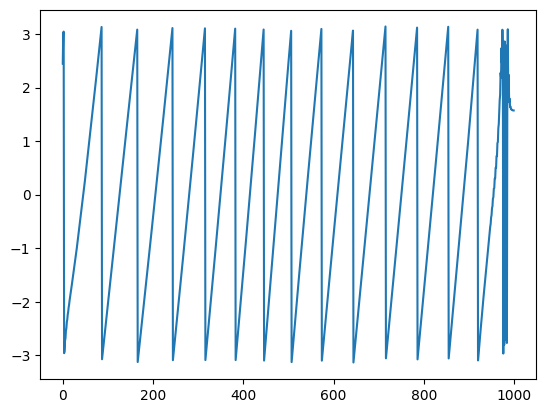

In [33]:
plt.plot(np.angle(hilbert(filtered_signal)))

In [ ]:
def band_extraction(lfp_data,cutoff_low,cutoff_high,sampling_rate=1250,order=3):
    '''Filter the broadband LFP signal, allowing only frequencies between the limits [cutoff_low,cutoff_high]
    using a FIR bandpass filter with a Hamming window whose length.

    INPUT:
        - lfp_data: a pandas Series object containing the signal to be filtered (i.e. the LFP);
        - cutoff_low: the lowest frequency allowed;
        - cutoff_high: the highest frequency allowed;
        - sampling_rate: in Hz [default: 1250];
        - order: the order of the Butter filter employed [default: 3]

    OUTPUT:
        - the filtered signal as a 1D numpy array;
    '''

    from scipy.signal import butter, firwin, lfilter, filtfilt

    #Design the filter
    nyquist_freq = 0.5*sampling_rate
    inf_threshold = cutoff_low/nyquist_freq
    sup_threshold = cutoff_high/nyquist_freq

    #order is given in cycles; transform it into samples by multiplying by the sampling rate frequency
    filter_length = round(order*(2*nyquist_freq)/cutoff_high)

    #b,a = butter(order,[inf_threshold,sup_threshold],btype='bandpass')
    #a = scipy.signal.firwin(n, cutoff = [0.016, 0.02], window = 'hamming', pass_zero = False)
    h = firwin(filter_length,cutoff = [inf_threshold,sup_threshold],window='hamming',pass_zero=False)

    #Return the filter applied to the signal
    return filtfilt(h,1,lfp_data)

In [22]:
'''
comodulogram building
'''

freqs_for_amps = np.arange(30,202,2)
freqs_for_phases = np.arange(1,20.25,.25)

sampling_rate = 1250
filtered_phases = np.empty([len(freqs_for_phases) - 1,len(signal)])

from scipy.signal import hilbert

for phase_index,phase in enumerate(freqs_for_phases[0:-1]):
  filtered_phases[phase_index,:] = np.angle(hilbert(band_extraction(signal,cutoff_low=freqs_for_phases[phase_index],cutoff_high=freqs_for_phases[phase_index+1],
                                            sampling_rate=sampling_rate)))

comod = np.zeros([len(freqs_for_amps) - 1, len(freqs_for_phases)])


num_bins = 50
phasebins = np.linspace(-np.pi,np.pi,num_bins+1)
phasecenters = phasebins[0:-1] + (phasebins[1] - phasebins[0])

#iterate over signals filtered at higher frequencies (each band for which we extract the amplitude envelope)
for amp_index,current_amp in enumerate(freqs_for_amps[:-1]):
  print(f'new amp: [{amp_index}/{len(freqs_for_amps)-1}]')
  amp_envelope = abs(hilbert(band_extraction(signal,cutoff_low=freqs_for_amps[amp_index],cutoff_high=freqs_for_amps[amp_index+1],
                                                   sampling_rate=sampling_rate)))

  '''
  to exploit the storage vs. processing conundrum, I have already filtered the signal in each low-frequency band of interest
  and put each band's signal in a vector (filtered_phases, 76 bands in total).
  once again I have opted for such an approach and below I create a vector called bins_freq,
  that will store each frequency bin's (from [-pi,pi]) mean amplitude in a single modulated band (from which we extract the amplitude envelope)
  '''

  bins_freq = np.empty((num_bins,len(filtered_phases)))

  for phase_bin_id in range(len(phasebins)-1):
    #print(phase_bin_id)
    #print(phasebins[phase_bin_id],phasebins[phase_bin_id+1])

    for band_id,band_signal in enumerate(filtered_phases):
      phasepoints_in_frequency_bin = np.where((band_signal > phasebins[phase_bin_id]) & (band_signal < phasebins[phase_bin_id+1]))[0]
      mean_amplitude_in_frequency_bin = np.mean(amp_envelope[phasepoints_in_frequency_bin])
      #print(mean_amplitude_in_frequency_bin)
      bins_freq[phase_bin_id,band_id] = mean_amplitude_in_frequency_bin

    #print(f'estimated mean amplitude in bin {phase_bin_id} [{phasebins[phase_bin_id]} Hz, {phasebins[phase_bin_id+1]} Hz] in all modulating bands!')
    #print(sum(bins_freq[:,band_id]))
  print(f'finished all frequency bins for all modulating bands in this modulated band: [{freqs_for_amps[amp_index]} Hz,{freqs_for_amps[amp_index+1]} Hz]')
  #normalize over each phase bin, yielding what is dubbed p
  p = [bins_freq[:,band_id]/sum(bins_freq[:,band_id]) for band_id in range(len(filtered_phases))]

  #estimate MI
  from scipy.stats import entropy
  uniform_dist = np.ones(num_bins)/num_bins

  #iterating over all low-frequency filtered bands:
  for low_freq_band_index in range(np.shape(p)[0]):
    MI = entropy(p[low_freq_band_index],uniform_dist)/np.log(num_bins)
    comod[amp_index,low_freq_band_index] = MI

ValueError: ignored

In [ ]:
os.chdir('/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/data/separated_channels/rat6_day2_LFP_all')

In [ ]:
os.listdir()

['ch0_STR.npy',
 'ch1_STR.npy',
 'ch2_STR.npy',
 'ch3_STR.npy',
 'ch4_STR.npy',
 'ch5_STR.npy',
 'ch6_STR.npy',
 'ch7_STR.npy',
 'ch8_PFC.npy',
 'ch9_PFC.npy',
 'ch10_PFC.npy',
 'ch11_PFC.npy',
 'ch12_PFC.npy',
 'ch13_PFC.npy',
 'ch14_PFC.npy',
 'ch15_PFC.npy',
 'ch16_PFC.npy',
 'ch17_PFC.npy',
 'ch18_PFC.npy',
 'ch19_PFC.npy',
 'ch20_PFC.npy',
 'ch21_PFC.npy',
 'ch22_PFC.npy',
 'ch23_PFC.npy',
 'ch24_STR.npy',
 'ch25_STR.npy',
 'ch26_STR.npy',
 'ch27_STR.npy',
 'ch28_STR.npy',
 'ch29_STR.npy',
 'ch30_STR.npy',
 'ch31_STR.npy',
 'timestamps.npy',
 'channel_region.json',
 'metadata.json',
 'results']

In [ ]:
os.path.isdir('data')

In [ ]:
os.chdir('../../../')
os.getcwd()

'/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels'

### check for phase reset in multiple channels, both at the beginning and at the end

**itinerary**
- select a session (animal, day)
- load channel_region.json
- for channel in channel_region:
  - load the LFP of the said channel using load_lfp()
  - split this lfp into peri_trials_dict()
  - estimate phase_reset_dists and save it to a dict with {key:value} pairs = {channel:phase_dists}
    - compare the circular mean plot prior to trial beginning (A = [-500 ms,-400 ms]) and in the beginning of the trial (B = [0 ms,100 ms])

- for channel in channel_region:
  - get the phase_dists for the current channel
  - plot its circular histograms

_perhaps do:_
- _compare the distribution of mean phase per trial in A and B using nonparametric tests that could assert whether either the mean phase, the variance of phase distributions or both changed throughout (Lepage test? perhaps.)_

In [ ]:
#deprecated but I'll keep it in case I need it
  '''def phase_reset_dists(peri_trials_dict,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250):

  estimate the circular mean of the LFP phase in a window following a target instant and in a window at some peri-target vicinity that happens before it
  e.g.:
        - target = 0 ms (trial beginning), peri-target = -500 ms (500 ms before trial begins)
        - target = EOT (end-of-trial), peri-target = -500 ms (500 ms before trial ends)

  input:
      - peri-trials-dict [dict]: {key:value} pairs are {trial:LFP} with LFP being the (continuous) signal cropped from durations [-peri_target,trial_duration]
      - min_freq, bandwidth [float, Hz]: the range in which the LFP will be filtered is from [min_freq,min_freq+bandwidth]
      - peri_trial [float, s]: how many seconds the peri-target vicinity is displaced from the target instant
      - window_width [float, s]: the timespan after which the signal at either the phases of peri- or target instants will be (circularly) averaged out

  output:
      - peri_phases,target_phases [dict]: the {key:value} pairs are {trial [string]:mean phase over either the peri-target or target instant + window[np.array]}

  #if there is no SciPy loaded it will prompt a failure, for we use scipy.stats.circmean and scipy.signal.hilbert
  assert scipy

  peri_points = int(peri_trial*sampling_rate)
  points_in_window = int(window_width*sampling_rate)

  peri_phases = {}
  target_phases = {}

  for trial in peri_trials_dict.keys():
    current_lfp_analytic = scipy.signal.hilbert(band_extraction(peri_trials_dict[trial].lfp,cutoff_low=min_freq,cutoff_high=min_freq+bandwidth,
                                               sampling_rate=sampling_rate))
    lfp_phase = np.angle(current_lfp_analytic)

    #get the mean phase from the beginning of the considered duration (peri-target instant + window)
    peri_phases.update({trial: scipy.stats.circmean(lfp_phase[0:points_in_window])})

    #get the mean phase from the target duration (all points in the peri_points [e.g. 625 for 500 ms of peri-trial interval at 1250 Hz of sampling rate] + window)
    target_phases.update({trial: scipy.stats.circmean(lfp_phase[peri_points:peri_points+points_in_window])})

  return peri_phases,target_phases
'''

#deprecated but I'll keep it in case I need it
'''def comparison_circular_histogram(phase_series1,phase_series2,num_bins=18,labels=(None,None),title='',**kwargs):
  if isinstance(kwargs['channel'],int):
    channel = kwargs['channel']
    title = f'Channel: {channel}'
  bins = np.linspace(0,2*np.pi,num_bins+1)
  series1_counts,_ = np.histogram(phase_series1,bins)
  series2_counts,_ = np.histogram(phase_series2,bins)

  plt.figure()
  width = 2*np.pi/num_bins
  ax = plt.subplot(1, 1, 1, projection='polar')
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color='red',alpha=0.5,label=labels[0])
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color='blue',alpha=0.5,label=labels[1])

  plt.title(title)
  plt.yticks([])

  #silly way to omit the legend if none is input
  if labels[0] != None and labels[1] != None:
    plt.legend()
  plt.tight_layout()

  return plt.gcf()''';

IndentationError: ignored

In [ ]:
def phase_reset_dists(peri_trials_dict,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250,from_the_beginning=True):

  '''
  estimate the circular mean of the LFP phase in a window following a target instant and in a window at some peri-target vicinity that happens before it
  e.g.:
        - target = 0 ms (trial beginning), peri-target = -500 ms (500 ms before trial begins)
        - target = EOT (end-of-trial), peri-target = -500 ms (500 ms before trial ends)

  input:
      - peri-trials-dict [dict]: {key:value} pairs are {trial:LFP} with LFP being the (continuous) signal cropped from durations [-peri_target,trial_duration]
      - min_freq, bandwidth [float, Hz]: the range in which the LFP will be filtered is from [min_freq,min_freq+bandwidth]
      - peri_trial [float, s]: how many seconds the peri-target vicinity is displaced from the target instant
      - window_width [float, s]: the timespan after which the signal at either the phases of peri- or target instants will be (circularly) averaged out

  output:
      - peri_phases,target_phases [dict]: the {key:value} pairs are {trial [type - string]: mean phase over either the peri-target or target instant + window [type - np.array]}
  '''

  #if there is no SciPy loaded it will prompt a failure, for we use scipy.stats.circmean and scipy.signal.hilbert
  assert scipy

  peri_points = int(peri_trial*sampling_rate)
  points_in_window = int(window_width*sampling_rate)
  num_points = (2*points_in_window) + peri_points

  peri_phases = {}
  target_phases = {}

  for trial in peri_trials_dict.keys():
    current_lfp_analytic = scipy.signal.hilbert(band_extraction(peri_trials_dict[trial].lfp,cutoff_low=min_freq,cutoff_high=min_freq+bandwidth,
                                               sampling_rate=sampling_rate))
    lfp_phase = np.angle(current_lfp_analytic)

    if from_the_beginning == True:
      #trim the trial from the beginning
      lfp_phase = lfp_phase[0:num_points]
    else:
      #trim the trial from the end, so the first point (index 0) coincides with the instant to be compared with the trial end
      lfp_phase = lfp_phase[-num_points:]

    #get the mean phase from the beginning of the considered duration (peri-target instant + window)
    peri_phases.update({trial: scipy.stats.circmean(lfp_phase[0:points_in_window])})

    #get the mean phase from the target duration (all points in the peri_points [e.g. 625 for 500 ms of peri-trial interval at 1250 Hz of sampling rate] + 100ms window)
    target_phases.update({trial: scipy.stats.circmean(lfp_phase[peri_points:peri_points+points_in_window])})

  return peri_phases,target_phases

In [ ]:
'''def channel_phase_reset(rat,day,channel,from_the_beginning=True,min_duration=0.8,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250):

  #os.chdir(f'./data/separated_channels/rat{rat}_day{day}_LFP_all')

  import json
  with open("./channel_region", "r") as fp:
    channel_region_pairs = json.load(fp) #load the JSON with channel-region pairings


  #Estimate phase distributions for both a 100 ms window at both a peri-trial instant and at trial beginning over all channels

  #This is the dictionary we will save the results
  channel_phasedist_results = {}

  lfp,channel,region = load_lfp(rat_id = rat,day_id = day,channel_id = channel[2:])

  #split the continuous signal into the segments belonging to each trial (time-consuming, ~1.3s, I should speed it up)
  peri_trial_dict = split_lfp_trials(session_data,lfp,rat,day,region,min_duration=min_duration,sampling_rate=sampling_rate,
                                     slicing='first',peri_trial_inclusion = peri_trial,per_slice=1300)

  #Estimate the phase reset distributions (circular mean of phase in each timespan: peri-trial or in-trial windows)
  pre_phases, target_phases = phase_reset_dists(peri_trial_dict,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250)

  #Save the values of each as a NumPy array into another dict indexed by the key "channel" (e.g. 'ch0'), comprising both results for that channel
  peri_phases_dist = np.array(list(pre_phases.values()))
  target_phases_dist = np.array(list(target_phases.values()))

  return peri_phases_dist,target_phases_dist'''

  #deprecated due to malconfiguration of split_lfp_trials()

In [ ]:
def channel_phase_reset(rat,day,channel,from_the_beginning=True,min_duration=0.8,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250,per_slice=1300):

  #os.chdir(f'./data/separated_channels/rat{rat}_day{day}_LFP_all')

  import json
  with open("./channel_region", "r") as fp:
    channel_region_pairs = json.load(fp) #load the JSON with channel-region pairings


  #Estimate phase distributions for both a 100 ms window at both a peri-trial instant and at trial beginning over all channels

  #This is the dictionary we will save the results
  channel_phasedist_results = {}

  lfp,channel,region = load_lfp(rat_id = rat,day_id = day,channel_id = channel[2:])

  #split the continuous signal into the segments belonging to each trial (time-consuming, ~1.3s, I should speed it up)
  peri_trial_dict = split_lfp_trials(session_data,lfp,rat,day,region,min_duration=min_duration,sampling_rate=sampling_rate,
                                     slicing='none',peri_trial_inclusion = peri_trial,per_slice=per_slice)

  #Estimate the phase reset distributions (circular mean of phase in each timespan: peri-trial or in-trial windows)
  pre_phases, target_phases = phase_reset_dists(peri_trial_dict,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250,from_the_beginning=from_the_beginning)

  #Save the values of each as a NumPy array into another dict indexed by the key "channel" (e.g. 'ch0'), comprising both results for that channel
  peri_phases_dist = np.array(list(pre_phases.values()))
  target_phases_dist = np.array(list(target_phases.values()))

  return peri_phases_dist,target_phases_dist

In [ ]:
!pip3 install pycircstat
!pip install nose #this is important so we can actually import pycircstats

import pycircstat
from pycircstat import descriptive, swap2zeroaxis
import warnings

@swap2zeroaxis(['alpha1', 'alpha2'], [0, 1])
def kuiper(alpha1, alpha2, res=100, axis=None):
    """
    The Kuiper two-sample test tests whether the two samples differ
    significantly.The difference can be in any property, such as mean
    location and dispersion. It is a circular analogue of the
    Kolmogorov-Smirnov test.
    H0: The two distributions are identical.
    HA: The two distributions are different.
    :param alpha1: fist sample (in radians)
    :param alpha2: second sample (in radians)
    :param res:    resolution at which the cdf is evaluated (default 100)
    :returns: p-value and test statistic
              p-value is the smallest of .10, .05, .02, .01, .005, .002,
              .001, for which the test statistic is still higher
              than the respective critical value. this is due to
              the use of tabulated values. if p>.1, pval is set to 1.
    References: [Batschelet1980]_ p. 112
    """

    if axis is not None:
        assert alpha1.shape[1:] == alpha2.shape[1:], "Shapes of alphas not consistent with computation along axis."
    n, m = alpha1.shape[axis], alpha2.shape[axis]

    _, cdf1 = _sample_cdf(alpha1, res, axis=axis)
    _, cdf2 = _sample_cdf(alpha2, res, axis=axis)

    dplus = np.atleast_1d((cdf1 - cdf2).max(axis=axis))
    dplus[dplus < 0] = 0.
    dminus = np.atleast_1d((cdf2 - cdf1).max(axis=axis))
    dminus[dminus < 0] = 0.

    k = n * m * (dplus + dminus)
    mi = np.min([m, n])
    fac = np.sqrt(n * m * (n + m))
    pval = np.asarray([_kuiper_lookup(mi, kk / fac)
                       for kk in k.ravel()]).reshape(k.shape)
    return pval, k


def _kuiper_lookup(n, k):
    ktable = load_kuiper_table()

    alpha = np.asarray([.10, .05, .02, .01, .005, .002, .001])
    nn = ktable[:, 0]

    isin = (nn == n)
    if np.any(isin):
        row = np.where(isin)[0]
    else:
        row = len(nn) - np.sum(n < nn) - 1

        if row == 0:
            raise ValueError('N too small.')
        else:
            warnings.warn(
                'N=%d not found in table, using closest N=%d present.' %
                (n, nn[row]))

    idx = (ktable[row, 1:] < k).squeeze()
    if np.any(idx):
        return alpha[idx].min()
    else:
        return 1.


@swap2zeroaxis(['alpha'], [1])
def _sample_cdf(alpha, resolution=100., axis=None):
    """
    Helper function for circ_kuipertest.
    Evaluates CDF of sample in thetas.
    :param alpha: sample (in radians)
    :param resolution: resolution at which the cdf is evaluated (default 100)
    :param axis: axis along which the cdf is computed
    :returns: points at which cdf is evaluated, cdf values
    """

    if axis is None:
        alpha = alpha.ravel()
        axis = 0
    bins = np.linspace(0, 2 * np.pi, resolution + 1)
    old_shape = alpha.shape
    alpha = alpha % (2 * np.pi)

    alpha = alpha.reshape((alpha.shape[0], int(np.prod(alpha.shape[1:])))).T
    cdf = np.array([np.histogram(a, bins=bins)[0]
                    for a in alpha]).cumsum(axis=1) / float(alpha.shape[1])
    cdf = cdf.T.reshape((len(bins) - 1,) + old_shape[1:])

    return bins[:-1], cdf

def load_kuiper_table():
  _data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/data'
  return np.load(_data_path + '/kuiper_table.npy')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.7/154.7 kB 4.6 MB/s eta 0:00:00


In [ ]:
def plot_phase_reset_histogram(channel_phasedist_results,peri_interval_size=0.5,window_size=0.1,aligned_to='begin',save_fig=True,file_name=''):
  #Plot the results as a panel with 32 polar histograms of mean phase count

  #convert to ms
  peri_interval_size*=100
  window_size*=100

  #The results should be stored in a dictionary named channel_phasedist_results
  fig, axes = plt.subplots(nrows=8, ncols=4,figsize=(8,20))
  fig.subplots_adjust(hspace=0.5)

  if aligned_to == 'begin':
    labels = ('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]')
    suptitle_text = f'Mean phase over a window of {window_size} ms per trial \n at a peri-trial instant (-{peri_interval_size} ms) and at trial beginning'
  elif aligned_to == 'end':
    labels = (f'Mid-trial interval [EOT - {peri_interval_size} ms, EOT - {peri_interval_size+window_size} ms]',f'Trial end [EOT - {window_size} ms, EOT]')
    suptitle_text = f'Mean phase over a window of {window_size} ms per trial \n at a mid-trial instant ({peri_interval_size} ms from trial end) and at trial end'

  fig.suptitle(suptitle_text)

  channel_counter = 0

  num_bins = 18
  bins = np.linspace(0,2*np.pi,num_bins+1)
  width = 2*np.pi/num_bins

  for ax in axes.flatten():
    pre_dist,trial_dist = channel_phasedist_results[f'ch{channel_counter}']

    channel_region = channel_region_pairs[f'ch{channel_counter}']

    if kuiper(pre_dist,trial_dist)[0] <= 0.05:
      colors = ['red','blue']
    else:
      colors = ['#b5b5b5','#525252']

    series1_counts,_ = np.histogram(pre_dist,bins)
    series2_counts,_ = np.histogram(trial_dist,bins)

    #only label the first two plots with significant statistics because otherwise we would have repeated labelling

    ax = plt.subplot(8, 4, channel_counter+1, projection='polar')

    if channel_counter == 0:
      #ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
      label1 = ax.plot([], [], color='red',alpha=0.5,label=labels[0])
      label2 = ax.plot([], [], color='blue',alpha=0.5,label=labels[1])
      label3 = ax.plot([], [], color='#b5b5b5',alpha=0.5,label=labels[0]+'(Non-significant)')
      label4 = ax.plot([], [], color='#525252',alpha=0.5,label=labels[0]+'(Non-significant)')
    else:
      labels = (None,None)
    series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color=colors[0],alpha=0.5)
    series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color=colors[1],alpha=0.5)

    plt.title(f'Channel: {channel_counter} \n Region: {channel_region}')
    plt.yticks([])

    channel_counter+=1

  #fetch the labels for each axis in axes
  lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
  lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
  fig.legend(lines, labels,bbox_to_anchor=(0.75,1.035))

  fig.tight_layout()

  if save_fig:
    plt.savefig(f'./results/{file_name}.png',format='png',bbox_inches='tight')

beginning session: rat3_day1_mean-phase-comparison_begin-aligned
done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsi

<ipython-input-7-5257d770766a>:63: UserWarning: N=425 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


beginning session: rat3_day2_mean-phase-comparison_begin-aligned
done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsi

<ipython-input-7-5257d770766a>:63: UserWarning: N=545 not found in table, using closest N=501 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


beginning session: rat4_day1_mean-phase-comparison_begin-aligned
done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsi

<ipython-input-7-5257d770766a>:63: UserWarning: N=325 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


beginning session: rat4_day2_mean-phase-comparison_begin-aligned
done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsi

<ipython-input-7-5257d770766a>:63: UserWarning: N=311 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


beginning session: rat5_day1_mean-phase-comparison_begin-aligned
done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsi

<ipython-input-7-5257d770766a>:63: UserWarning: N=329 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
<ipython-input-7-5257d770766a>:63: UserWarning: N=325 not found in table, using closest N=200 present.
  warnings.warn(


beginning session: rat5_day2_mean-phase-comparison_begin-aligned
done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsi

<ipython-input-7-5257d770766a>:63: UserWarning: N=317 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


beginning session: rat6_day1_mean-phase-comparison_begin-aligned
done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsi

<ipython-input-7-5257d770766a>:63: UserWarning: N=401 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
<ipython-input-7-5257d770766a>:63: UserWarning: N=682 not found in table, using closest N=501 present.
  warnings.warn(


beginning session: rat6_day2_mean-phase-comparison_begin-aligned


FileNotFoundError: ignored

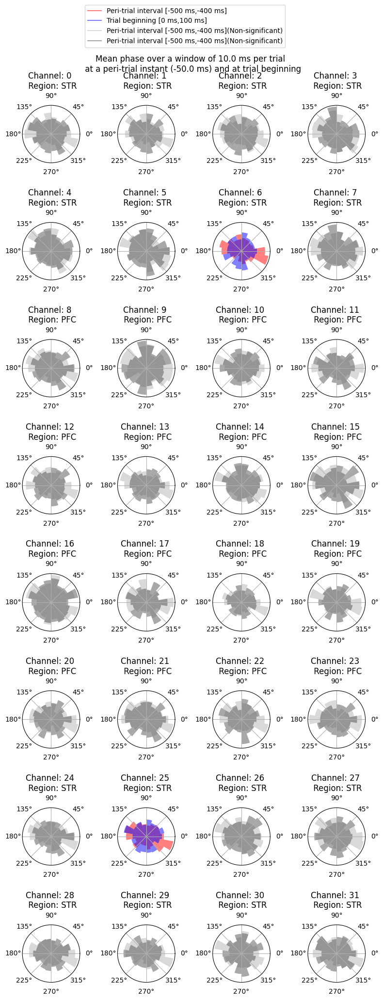

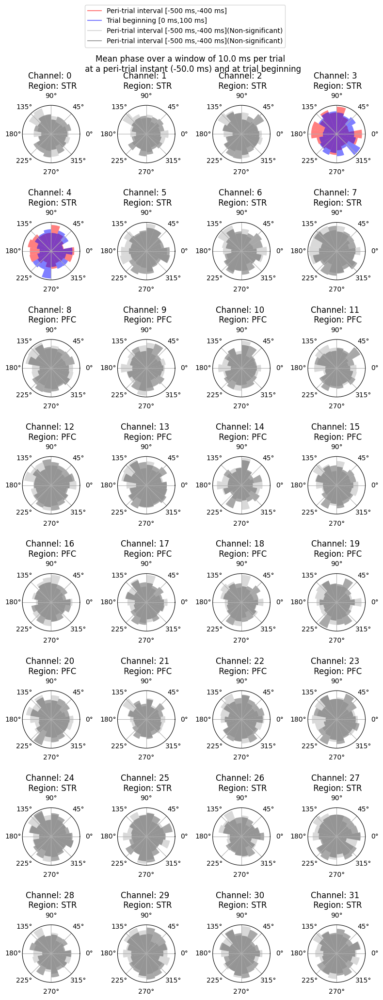

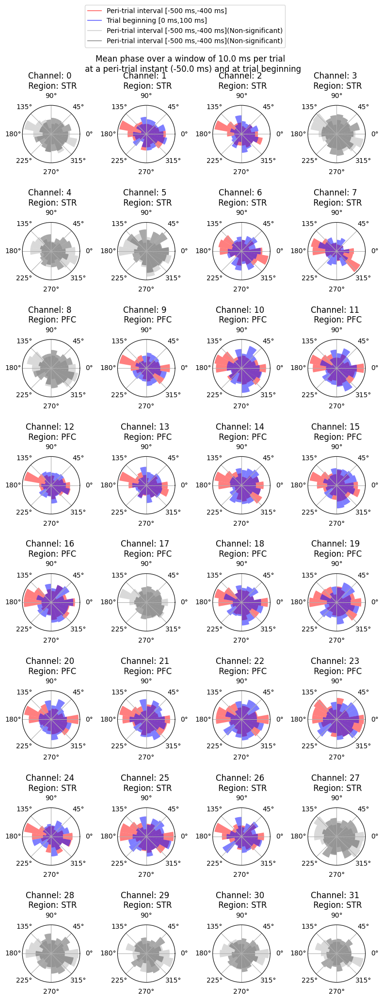

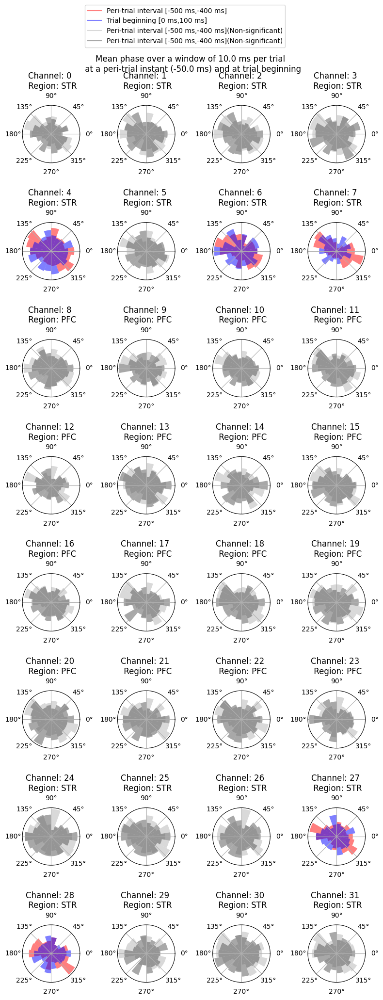

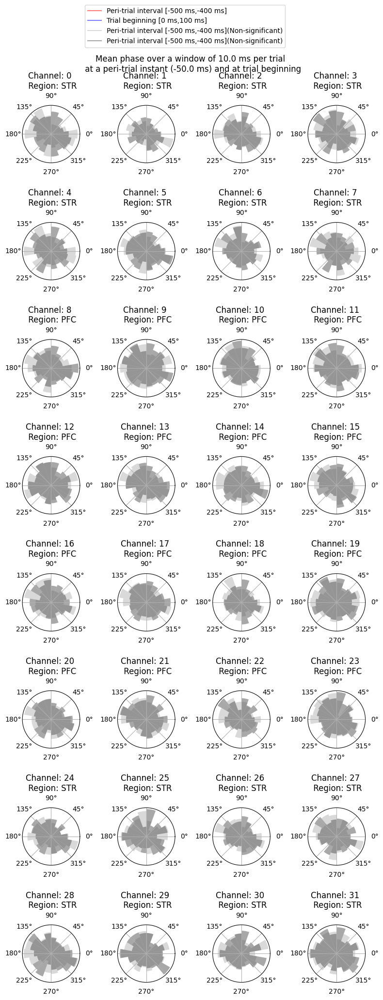

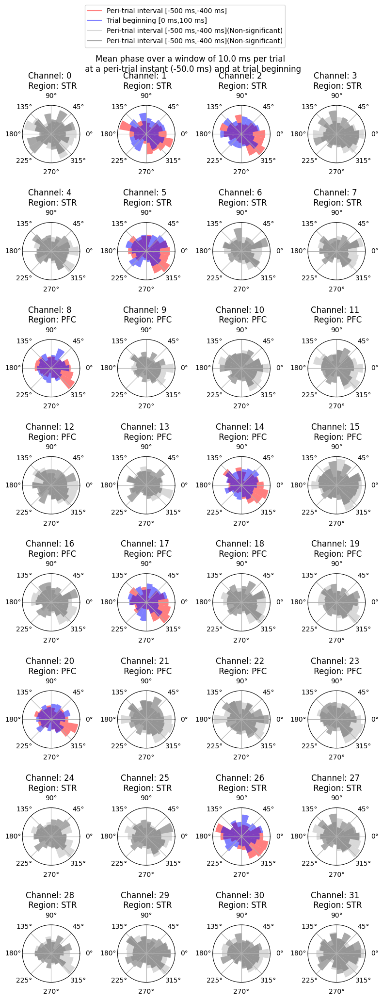

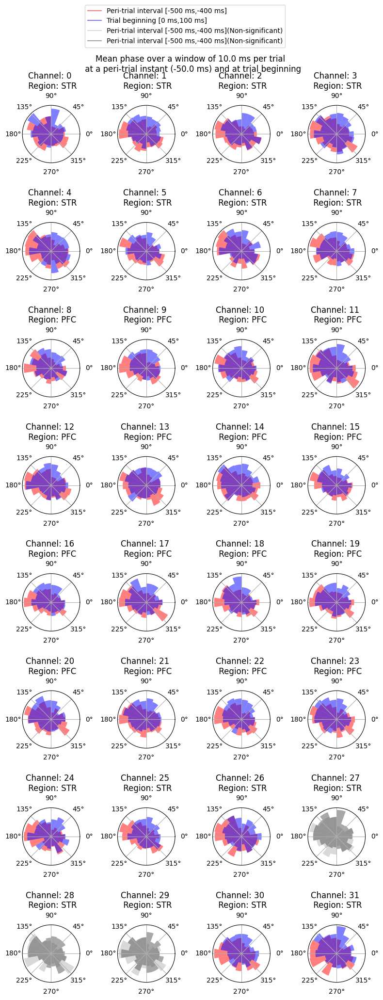

In [ ]:
######## USE THIS ONE

data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/'
os.chdir(data_path)

#load auxiliary session data (trial segmenting times for all animals)
session_data = pd.read_csv('./data/session_data-spikes.csv').copy()

from_the_beginning = True

for rat in range(3,7):
  for day in range(1,3):
    if from_the_beginning:
      label = f'rat{rat}_day{day}_mean-phase-comparison_begin-aligned'
    else:
      label = f'rat{rat}_day{day}_mean-phase-comparison_end-aligned'

    print(f'beginning session: {label}')

    #go to the LFP folder corresponding to the current session
    os.chdir(f'./data/separated_channels/rat{rat}_day{day}_LFP_all')

    import json
    with open("./channel_region", "r") as fp:
      channel_region_pairs = json.load(fp) #load the JSON with channel-region pairings

    #Estimate phase distributions for both a 100 ms window at both a peri-trial instant and at trial beginning over all channels

    #This is the dictionary we will save the results
    channel_phasedist_results = {}

    #Iterate over channels
    #for channel in channel_region_pairs.keys():
    for channel in list(channel_region_pairs.keys()):



      peri_phases_dist,target_phases_dist = channel_phase_reset(rat,day,channel,from_the_beginning=from_the_beginning)
      channel_phasedist_results.update({f'{channel}':[peri_phases_dist,target_phases_dist]})
      del peri_phases_dist,target_phases_dist

      print(f'finished channel {channel}')
    #save the dict corresponding to this session

    with open(f"./results/{label}_results", "w") as regions_file:
      #we cannot save np.arrays to JSON files, so we must convert both pre- and target-phases-dist to lists before saving
      salvable_results = {item[0]:[item[1][0].tolist(),item[1][1].tolist()] for item in channel_phasedist_results.items()}
      json.dump(obj=salvable_results,fp=regions_file)

    plot_phase_reset_histogram(channel_phasedist_results,peri_interval_size=0.5,window_size=0.1,aligned_to='begin',save_fig=True,file_name=label+'_fig')

    os.chdir('../../..')

done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsing the LFP into trials
finished channel ch17
done parsing the LFP

<ipython-input-7-5257d770766a>:63: UserWarning: N=425 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsing the LFP into trials
finished channel ch17
done parsing the LFP

<ipython-input-7-5257d770766a>:63: UserWarning: N=545 not found in table, using closest N=501 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsing the LFP into trials
finished channel ch17
done parsing the LFP

<ipython-input-7-5257d770766a>:63: UserWarning: N=325 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsing the LFP into trials
finished channel ch17
done parsing the LFP

<ipython-input-7-5257d770766a>:63: UserWarning: N=311 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsing the LFP into trials
finished channel ch17
done parsing the LFP

<ipython-input-7-5257d770766a>:63: UserWarning: N=329 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
<ipython-input-7-5257d770766a>:63: UserWarning: N=325 not found in table, using closest N=200 present.
  warnings.warn(


done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsing the LFP into trials
finished channel ch17
done parsing the LFP

<ipython-input-7-5257d770766a>:63: UserWarning: N=317 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


done parsing the LFP into trials
finished channel ch0
done parsing the LFP into trials
finished channel ch1
done parsing the LFP into trials
finished channel ch2
done parsing the LFP into trials
finished channel ch3
done parsing the LFP into trials
finished channel ch4
done parsing the LFP into trials
finished channel ch5
done parsing the LFP into trials
finished channel ch6
done parsing the LFP into trials
finished channel ch7
done parsing the LFP into trials
finished channel ch8
done parsing the LFP into trials
finished channel ch9
done parsing the LFP into trials
finished channel ch10
done parsing the LFP into trials
finished channel ch11
done parsing the LFP into trials
finished channel ch12
done parsing the LFP into trials
finished channel ch13
done parsing the LFP into trials
finished channel ch14
done parsing the LFP into trials
finished channel ch15
done parsing the LFP into trials
finished channel ch16
done parsing the LFP into trials
finished channel ch17
done parsing the LFP

<ipython-input-7-5257d770766a>:63: UserWarning: N=401 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-8-37dd882928c1>:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
<ipython-input-7-5257d770766a>:63: UserWarning: N=682 not found in table, using closest N=501 present.
  warnings.warn(


FileNotFoundError: ignored

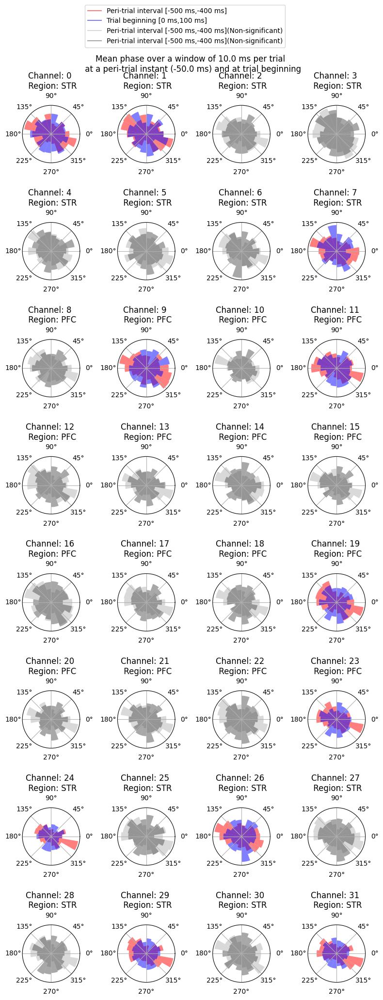

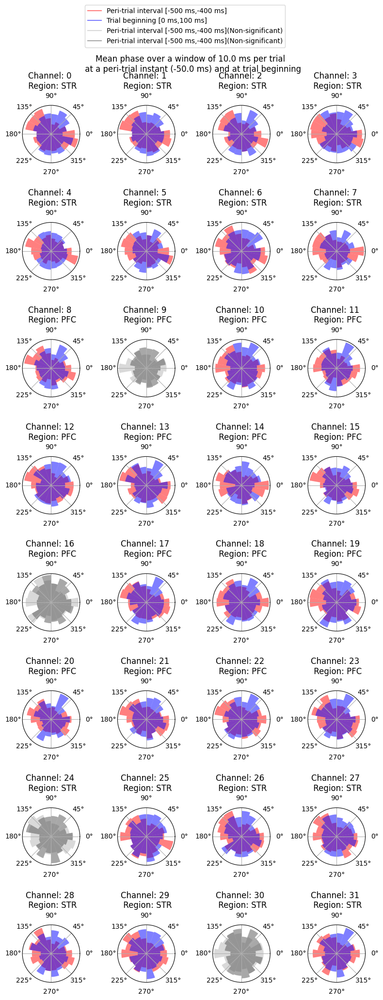

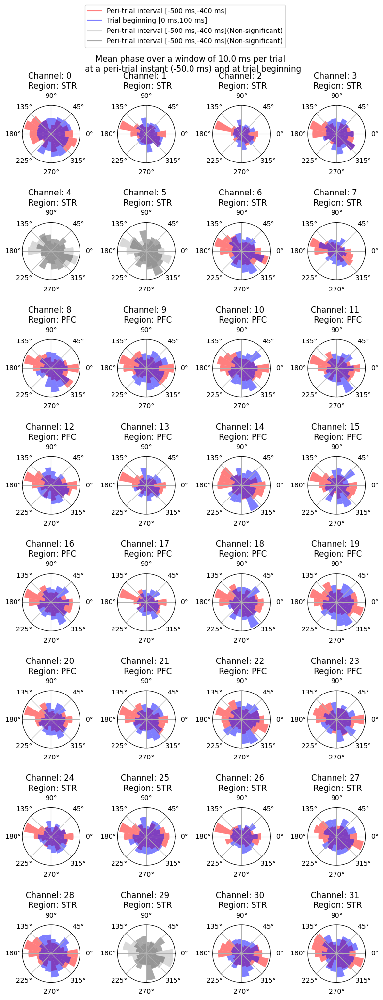

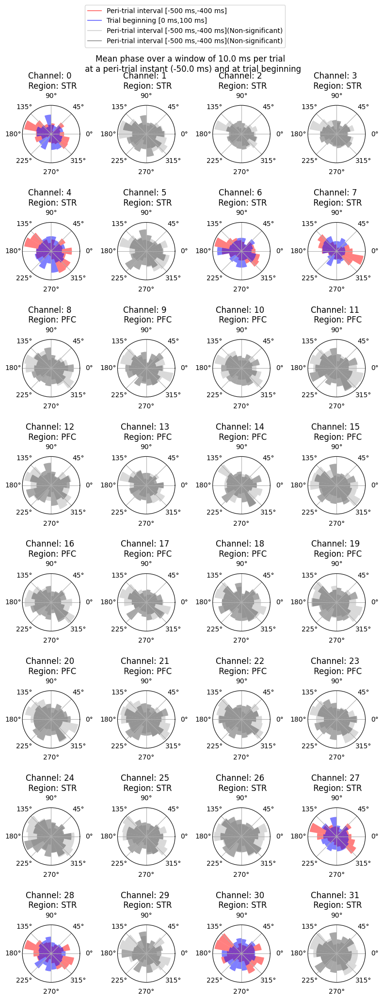

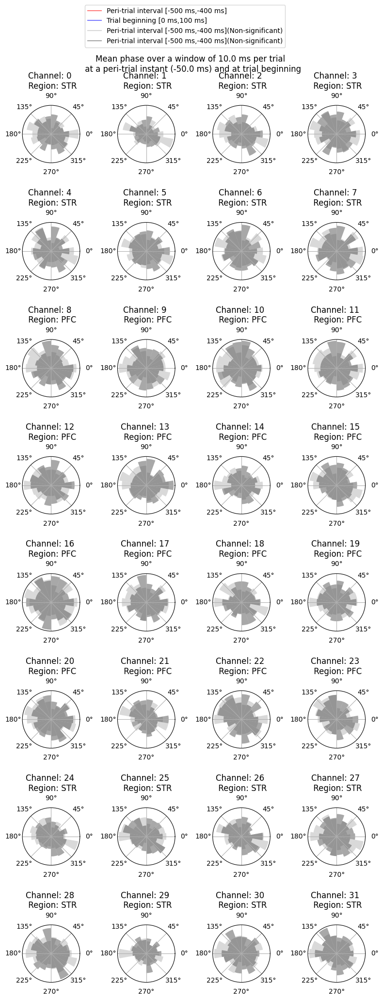

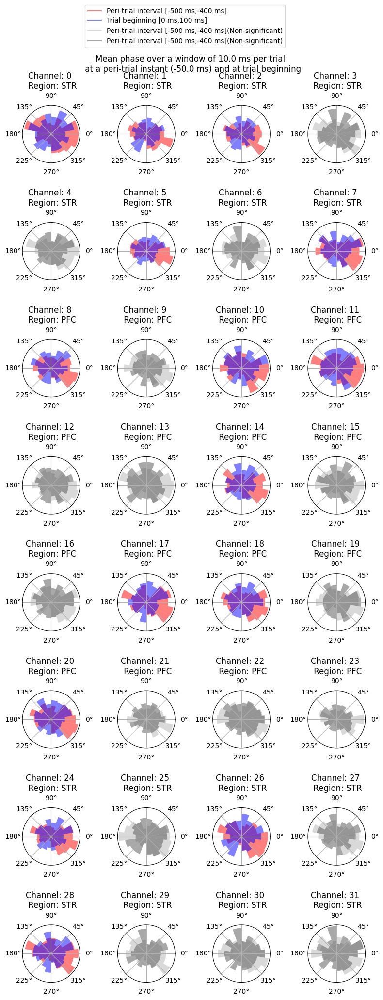

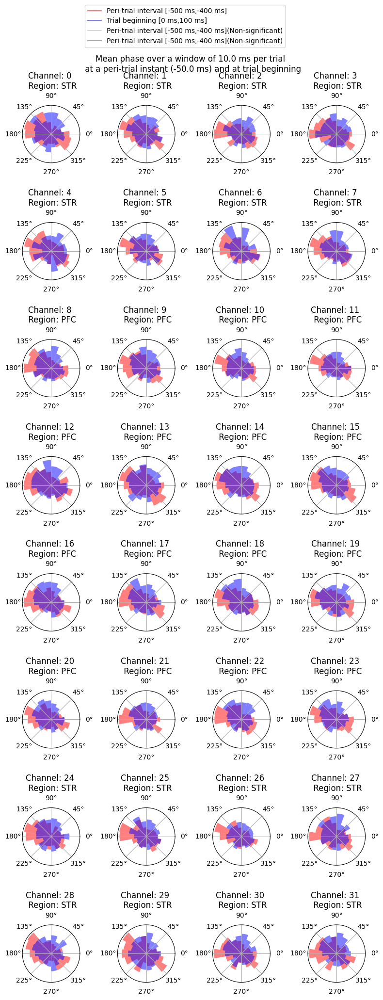

In [ ]:
data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/'
os.chdir(data_path)

#load auxiliary session data (trial segmenting times for all animals)
session_data = pd.read_csv('./data/session_data-spikes.csv').copy()

from_the_beginning = True

for rat in range(3,7):
  for day in range(1,3):
    if from_the_beginning:
      label = f'rat{rat}_day{day}_mean-phase-comparison_begin-aligned'
    else:
      label = f'rat{rat}_day{day}_mean-phase-comparison_end-aligned'

    #go to the LFP folder corresponding to the current session
    os.chdir(f'./data/separated_channels/rat{rat}_day{day}_LFP_all')

    import json
    with open("./channel_region", "r") as fp:
      channel_region_pairs = json.load(fp) #load the JSON with channel-region pairings

    #Estimate phase distributions for both a 100 ms window at both a peri-trial instant and at trial beginning over all channels

    #This is the dictionary we will save the results
    channel_phasedist_results = {}

    #Iterate over channels
    #for channel in channel_region_pairs.keys():
    for channel in list(channel_region_pairs.keys()):

      peri_phases_dist,target_phases_dist = channel_phase_reset(rat,day,channel,from_the_beginning=True)
      channel_phasedist_results.update({f'{channel}':[peri_phases_dist,target_phases_dist]})
      del peri_phases_dist,target_phases_dist

      print(f'finished channel {channel}')
    #save the dict corresponding to this session

    with open(f"./results/{label}_results", "w") as regions_file:
      #we cannot save np.arrays to JSON files, so we must convert both pre- and target-phases-dist to lists before saving
      salvable_results = {item[0]:[item[1][0].tolist(),item[1][1].tolist()] for item in channel_phasedist_results.items()}
      json.dump(obj=salvable_results,fp=regions_file)

    plot_phase_reset_histogram(channel_phasedist_results,peri_interval_size=0.5,window_size=0.1,aligned_to='begin',save_fig=True,file_name=label+'_fig')

    os.chdir('../../..')

In [ ]:
os.getcwd()

'/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/data/separated_channels/rat3_day1_LFP_all'

In [ ]:
with open(f"./results/{label}_results", "w") as regions_file:
  json.dump(obj=channel_phasedist_results,fp=regions_file)

TypeError: ignored

In [ ]:
channel_phasedist_results2 = {'ch' a.tolist()}

In [ ]:
channel_phasedist_results2 = {item[0]:[item[1][0].tolist(),item[1][1].tolist()] for item in channel_phasedist_results.items()}

In [ ]:
with open(f"./results/{label}_results.json", "w") as regions_file:
  json.dump(obj=channel_phasedist_results2,fp=regions_file)

In [ ]:
os.getcwd()

'/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/data/separated_channels/rat3_day1_LFP_all'

In [ ]:
type(channel_phasedist_results2['chch0'][0])

list

In [ ]:
type(channel_phasedist_results['chch0'][0])

numpy.ndarray

In [ ]:
data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/'
os.chdir(data_path)
print(os.getcwd())
session_data = pd.read_csv('./data/session_data-spikes.csv').copy()

rat = 3
day = 1

os.chdir(f'./data/separated_channels/rat{rat}_day{day}_LFP_all')

import json
with open("./channel_region", "r") as fp:
  channel_region_pairs = json.load(fp) #load the JSON with channel-region pairings

channel_results = {}

/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels


In [ ]:
os.chdir('./data/separated_channels')

In [ ]:
for rat in range(3,7):
  for day in range(1,3):
    os.chdir(f'./data/separated_channels/rat{rat}_day{day}_LFP_all')

    import json
    with open("./channel_region", "r") as fp:
      channel_region_pairs = json.load(fp) #load the JSON with channel-region pairings

    #Estimate phase distributions for both a 100 ms window at both a peri-trial instant and at trial beginning over all channels

    #This is the dictionary we will save the results
    channel_phasedist_results = {}

    #Iterate over channels
    #for channel in channel_region_pairs.keys():
    for channel in list(channel_region_pairs.keys()):
      #Load channel's LFP
      lfp,channel,region = load_lfp(rat_id = rat,day_id = day,channel_id = channel[2:])

      #split the continuous signal into the segments belonging to each trial (time-consuming, ~1.3s, I should speed it up)
      peri_trial_dict = split_lfp_trials(session_data,lfp,rat,day,region,min_duration=0.8,sampling_rate=1250,
                          slicing='first',peri_trial_inclusion = 0.5,per_slice=1300)

      #Estimate the phase reset distributions (circular mean of phase in each timespan: peri-trial or in-trial windows)
      pre_phases, trial_phases = phase_reset_dists(peri_trial_dict,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250)

      #Save the values of each as a NumPy array into another dict indexed by the key "channel" (e.g. 'ch0'), comprising both results for that channel
      pre_phases_dist = np.array(list(pre_phases.values()))
      trial_phases_dist = np.array(list(trial_phases.values()))
      channel_phasedist_results.update({f'ch{channel}':[pre_phases_dist,trial_phases_dist]})
      print(f'finished channel {channel}')

3 1
3 2
4 1
4 2
5 1
5 2
6 1
6 2


#### Running PyCircStat's Kuiper test in Google Colab

There is one function needed to use the Kuiper test as implemented in the PyCircStat toolbox. This test is intended to be a circular statistics' analogue to the Kolmogorov-Smirnov for linear distributions.

Unfortunately, in the current implementation the test requires loading a table that is provided under a given direction, namely: "'/'.join(os.path.realpath(__file__).split('/')[:-2] + ['data/'])"

If one tries to load from that location using a Google Colab notebook it yields a loading error for location not found. The simplest solution I had in mind was to simply copy the source code for the kuiper() function and all its necessary appendages in order to run it locally within this notebook.

In [ ]:
!pip3 install pycircstat
!pip install nose #this is important so we can actually import pycircstats

import pycircstat
from pycircstat import descriptive, swap2zeroaxis
import warnings

@swap2zeroaxis(['alpha1', 'alpha2'], [0, 1])
def kuiper(alpha1, alpha2, res=100, axis=None):
    """
    The Kuiper two-sample test tests whether the two samples differ
    significantly.The difference can be in any property, such as mean
    location and dispersion. It is a circular analogue of the
    Kolmogorov-Smirnov test.
    H0: The two distributions are identical.
    HA: The two distributions are different.
    :param alpha1: fist sample (in radians)
    :param alpha2: second sample (in radians)
    :param res:    resolution at which the cdf is evaluated (default 100)
    :returns: p-value and test statistic
              p-value is the smallest of .10, .05, .02, .01, .005, .002,
              .001, for which the test statistic is still higher
              than the respective critical value. this is due to
              the use of tabulated values. if p>.1, pval is set to 1.
    References: [Batschelet1980]_ p. 112
    """

    if axis is not None:
        assert alpha1.shape[1:] == alpha2.shape[1:], "Shapes of alphas not consistent with computation along axis."
    n, m = alpha1.shape[axis], alpha2.shape[axis]

    _, cdf1 = _sample_cdf(alpha1, res, axis=axis)
    _, cdf2 = _sample_cdf(alpha2, res, axis=axis)

    dplus = np.atleast_1d((cdf1 - cdf2).max(axis=axis))
    dplus[dplus < 0] = 0.
    dminus = np.atleast_1d((cdf2 - cdf1).max(axis=axis))
    dminus[dminus < 0] = 0.

    k = n * m * (dplus + dminus)
    mi = np.min([m, n])
    fac = np.sqrt(n * m * (n + m))
    pval = np.asarray([_kuiper_lookup(mi, kk / fac)
                       for kk in k.ravel()]).reshape(k.shape)
    return pval, k


def _kuiper_lookup(n, k):
    ktable = load_kuiper_table()

    alpha = np.asarray([.10, .05, .02, .01, .005, .002, .001])
    nn = ktable[:, 0]

    isin = (nn == n)
    if np.any(isin):
        row = np.where(isin)[0]
    else:
        row = len(nn) - np.sum(n < nn) - 1

        if row == 0:
            raise ValueError('N too small.')
        else:
            warnings.warn(
                'N=%d not found in table, using closest N=%d present.' %
                (n, nn[row]))

    idx = (ktable[row, 1:] < k).squeeze()
    if np.any(idx):
        return alpha[idx].min()
    else:
        return 1.


@swap2zeroaxis(['alpha'], [1])
def _sample_cdf(alpha, resolution=100., axis=None):
    """
    Helper function for circ_kuipertest.
    Evaluates CDF of sample in thetas.
    :param alpha: sample (in radians)
    :param resolution: resolution at which the cdf is evaluated (default 100)
    :param axis: axis along which the cdf is computed
    :returns: points at which cdf is evaluated, cdf values
    """

    if axis is None:
        alpha = alpha.ravel()
        axis = 0
    bins = np.linspace(0, 2 * np.pi, resolution + 1)
    old_shape = alpha.shape
    alpha = alpha % (2 * np.pi)

    alpha = alpha.reshape((alpha.shape[0], int(np.prod(alpha.shape[1:])))).T
    cdf = np.array([np.histogram(a, bins=bins)[0]
                    for a in alpha]).cumsum(axis=1) / float(alpha.shape[1])
    cdf = cdf.T.reshape((len(bins) - 1,) + old_shape[1:])

    return bins[:-1], cdf

def load_kuiper_table():
  _data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/data'
  return np.load(_data_path + '/kuiper_table.npy')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#Plot the results as a panel with 32 polar histograms of mean phase count

#The results should be stored in a dictionary named channel_phasedist_results
fig, axes = plt.subplots(nrows=8, ncols=4,figsize=(8,20))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Mean phase localization \n in a peri-trial window [-500 ms, -400 ms] and trial beginning [0 ms, 100ms] \n')

channel_counter = 0

num_bins=18
bins = np.linspace(0,2*np.pi,num_bins+1)
width = 2*np.pi/num_bins

for ax in axes.flatten():
  pre_dist,trial_dist = channel_phasedist_results[f'ch{channel_counter}']

  channel_region = channel_region_pairs[f'ch{channel_counter}']

  if kuiper(pre_dist,trial_dist)[0] <= 0.05:
    colors = ['red','blue']
  else:
    colors = ['#b5b5b5','#525252']

  series1_counts,_ = np.histogram(pre_dist,bins)
  series2_counts,_ = np.histogram(trial_dist,bins)

  #only label the first two plots with significant statistics because otherwise we would have repeated labelling

  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')

  if channel_counter == 0:
    labels = ('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]')
    #ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
    label1 = ax.plot([], [], color='red',alpha=0.5,label=labels[0])
    label2 = ax.plot([], [], color='blue',alpha=0.5,label=labels[1])
    label3 = ax.plot([], [], color='#b5b5b5',alpha=0.5,label=labels[0]+'(Non-significant)')
    label4 = ax.plot([], [], color='#525252',alpha=0.5,label=labels[0]+'(Non-significant)')
  else:
    labels = (None,None)
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color=colors[0],alpha=0.5)
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color=colors[1],alpha=0.5)

  plt.title(f'Channel: {channel_counter} \n Region: {channel_region}')
  plt.yticks([])

  channel_counter+=1

#fetch the labels for each axis in axes
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels,bbox_to_anchor=(0.75,1.035))

fig.tight_layout()

### Estimate the peri-trial and in-trial mean phase for the selected window

For each trial in each channel in the session:
Calculate the mean phase of extracted low-frequency oscillations (_[min_freq, min_freq + bandwidth]_ in phase_reset_dists(), default = [1 Hz, 20 Hz]) within the LFP signal at two windows spanning 100 ms each (parameter _window_width_ at the phase_reset_dists()): one left positioned at 500 ms before trial begin ((parameter _peri_trial_inclusion_ at the phase_reset_dists())) and other at trial begin.

This will yield a dictionary indexed by channel (example key: _'ch3'_) and whose values are both the mean phase over the window at each trial in two instants: peri-trial and trial begin, i.e.: [[peri-trial mean phase at each trial],[trial beginning mean phase at each trial]].

example key-value pair: {'ch3': [np.array(0.3,1.2,1.4,...,0.7), np.array(2.7,3.1,0.3,...,1.1)]}

In [ ]:
#Estimate phase distributions for both a 100 ms window at both a peri-trial instant and at trial beginning over all channels

#This is the dictionary we will save the results
channel_phasedist_results = {}

#Iterate over channels
#for channel in channel_region_pairs.keys():
for channel in list(channel_region_pairs.keys()):
  #Load channel's LFP
  lfp,channel,region = load_lfp(rat_id = rat,day_id = day,channel_id = channel[2:])

  #split the continuous signal into the segments belonging to each trial (time-consuming, ~1.3s, I should speed it up)
  peri_trial_dict = split_lfp_trials(session_data,lfp,rat,day,region,min_duration=0.8,sampling_rate=1250,
                      slicing='first',peri_trial_inclusion = 0.5,per_slice=1300)

  #Estimate the phase reset distributions (circular mean of phase in each timespan: peri-trial or in-trial windows)
  pre_phases, trial_phases = phase_reset_dists(peri_trial_dict,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250)

  #Save the values of each as a NumPy array into another dict indexed by the key "channel" (e.g. 'ch0'), comprising both results for that channel
  pre_phases_dist = np.array(list(pre_phases.values()))
  trial_phases_dist = np.array(list(trial_phases.values()))
  channel_phasedist_results.update({f'ch{channel}':[pre_phases_dist,trial_phases_dist]})
  print(f'finished channel {channel}')

done parsing the LFP into trials
finished channel 0
done parsing the LFP into trials
finished channel 1
done parsing the LFP into trials
finished channel 2
done parsing the LFP into trials
finished channel 3
done parsing the LFP into trials
finished channel 4
done parsing the LFP into trials
finished channel 5
done parsing the LFP into trials
finished channel 6
done parsing the LFP into trials
finished channel 7
done parsing the LFP into trials
finished channel 8
done parsing the LFP into trials
finished channel 9
done parsing the LFP into trials
finished channel 10
done parsing the LFP into trials
finished channel 11
done parsing the LFP into trials
finished channel 12
done parsing the LFP into trials
finished channel 13
done parsing the LFP into trials
finished channel 14
done parsing the LFP into trials
finished channel 15
done parsing the LFP into trials
finished channel 16
done parsing the LFP into trials
finished channel 17
done parsing the LFP into trials
finished channel 18
don

In [ ]:
with open("./channel_region", "r") as fp:
  regions_listing = json.load(fp) #load the JSON with channel-region pairings
#region = regions_listing[f'ch{channel_id}'] #from it fetch the region for the current channel

<ipython-input-16-5257d770766a>:63: UserWarning: N=425 not found in table, using closest N=200 present.
  warnings.warn(
<ipython-input-19-dc7a5b95a5b3>:29: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


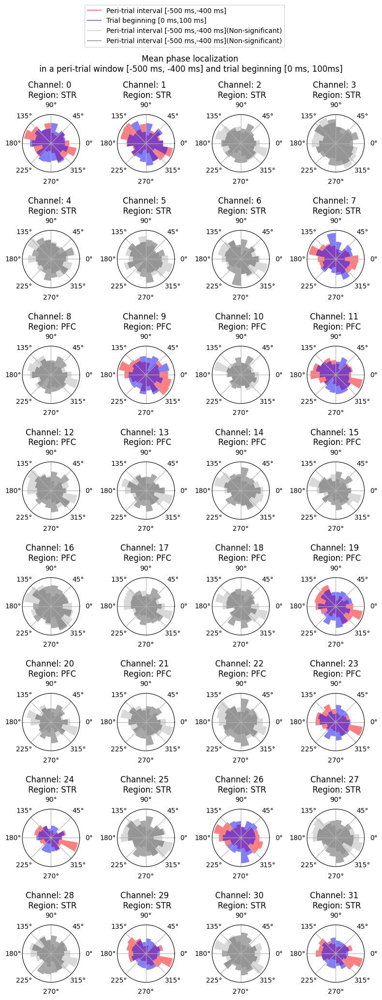

In [ ]:
#Plot the results as a panel with 32 polar histograms of mean phase count

#The results should be stored in a dictionary named channel_phasedist_results
fig, axes = plt.subplots(nrows=8, ncols=4,figsize=(8,20))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Mean phase localization \n in a peri-trial window [-500 ms, -400 ms] and trial beginning [0 ms, 100ms] \n')

channel_counter = 0

num_bins=18
bins = np.linspace(0,2*np.pi,num_bins+1)
width = 2*np.pi/num_bins

for ax in axes.flatten():
  pre_dist,trial_dist = channel_phasedist_results[f'ch{channel_counter}']

  channel_region = channel_region_pairs[f'ch{channel_counter}']

  if kuiper(pre_dist,trial_dist)[0] <= 0.05:
    colors = ['red','blue']
  else:
    colors = ['#b5b5b5','#525252']

  series1_counts,_ = np.histogram(pre_dist,bins)
  series2_counts,_ = np.histogram(trial_dist,bins)

  #only label the first two plots with significant statistics because otherwise we would have repeated labelling

  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')

  if channel_counter == 0:
    labels = ('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]')
    #ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
    label1 = ax.plot([], [], color='red',alpha=0.5,label=labels[0])
    label2 = ax.plot([], [], color='blue',alpha=0.5,label=labels[1])
    label3 = ax.plot([], [], color='#b5b5b5',alpha=0.5,label=labels[0]+'(Non-significant)')
    label4 = ax.plot([], [], color='#525252',alpha=0.5,label=labels[0]+'(Non-significant)')
  else:
    labels = (None,None)
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color=colors[0],alpha=0.5)
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color=colors[1],alpha=0.5)

  plt.title(f'Channel: {channel_counter} \n Region: {channel_region}')
  plt.yticks([])

  channel_counter+=1

#fetch the labels for each axis in axes
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels,bbox_to_anchor=(0.75,1.035))

fig.tight_layout()

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


<ipython-input-52-51e6b6c4ca1f>:29: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


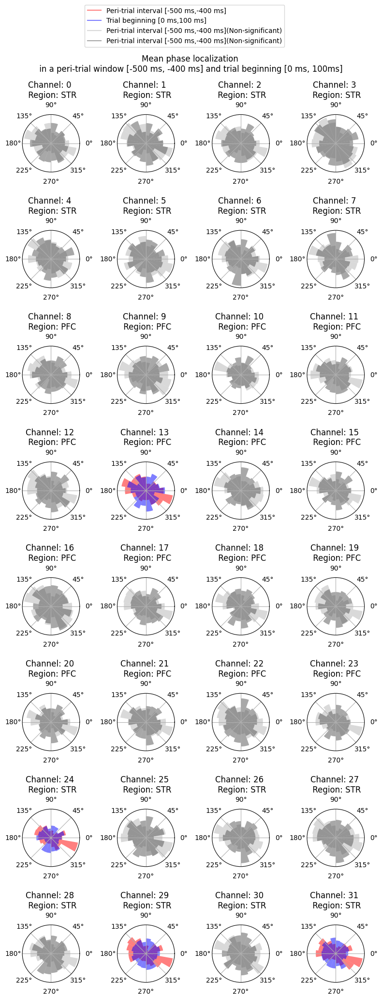

In [ ]:
#Plot the results as a panel with 32 polar histograms of mean phase count

#The results should be stored in a dictionary named channel_phasedist_results
fig, axes = plt.subplots(nrows=8, ncols=4,figsize=(8,20))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Mean phase localization \n in a peri-trial window [-500 ms, -400 ms] and trial beginning [0 ms, 100ms] \n')

channel_counter = 0

num_bins=18
bins = np.linspace(0,2*np.pi,num_bins+1)
width = 2*np.pi/num_bins

for ax in axes.flatten():
  pre_dist,trial_dist = channel_phasedist_results[f'ch{channel_counter}']

  channel_region = channel_region_pairs[f'ch{channel_counter}']

  if scipy.stats.kstest(pre_dist,trial_dist)[1] <= 0.05:
    colors = ['red','blue']
  else:
    colors = ['#b5b5b5','#525252']

  series1_counts,_ = np.histogram(pre_dist,bins)
  series2_counts,_ = np.histogram(trial_dist,bins)

  #only label the first two plots with significant statistics because otherwise we would have repeated labelling

  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')

  if channel_counter == 0:
    labels = ('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]')
    #ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
    label1 = ax.plot([], [], color='red',alpha=0.5,label=labels[0])
    label2 = ax.plot([], [], color='blue',alpha=0.5,label=labels[1])
    label3 = ax.plot([], [], color='#b5b5b5',alpha=0.5,label=labels[0]+'(Non-significant)')
    label4 = ax.plot([], [], color='#525252',alpha=0.5,label=labels[0]+'(Non-significant)')
  else:
    labels = (None,None)
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color=colors[0],alpha=0.5)
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color=colors[1],alpha=0.5)

  plt.title(f'Channel: {channel_counter} \n Region: {channel_region}')
  plt.yticks([])

  channel_counter+=1

#fetch the labels for each axis in axes
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels,bbox_to_anchor=(0.75,1.035))

fig.tight_layout()

In [ ]:
kuiper(pre,post)

<ipython-input-24-c0d8f5b4446e>:56: UserWarning: N=425 not found in table, using closest N=200 present.
  warnings.warn(


(array([0.02]), array([23375.]))

In [ ]:
data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/'
os.chdir(data_path)
print(os.getcwd())
session_data = pd.read_csv('./data/session_data-spikes.csv').copy()

rat = 4
day = 1

os.chdir(f'./data/separated_channels/rat{rat}_day{day}_LFP_all')

/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels


In [ ]:
#Estimate phase distributions for both a 100 ms window at both a peri-trial instant and at trial beginning over all channels

#This is the dictionary we will save the results
channel_phasedist_results = {}

#Iterate over channels
#for channel in channel_region_pairs.keys():
for channel in list(channel_region_pairs.keys()):
  #Load channel's LFP
  lfp,channel,region = load_lfp(rat_id = rat,day_id = day,channel_id = channel[2:])

  #split the continuous signal into the segments belonging to each trial (time-consuming, ~1.3s, I should speed it up)
  peri_trial_dict = split_lfp_trials(session_data,lfp,rat,day,region,min_duration=0.8,sampling_rate=1250,
                      slicing='first',peri_trial_inclusion = 0.5,per_slice=1300)

  #Estimate the phase reset distributions (circular mean of phase in each timespan: peri-trial or in-trial windows)
  pre_phases, trial_phases = phase_reset_dists(peri_trial_dict,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250)

  #Save the values of each as a NumPy array into another dict indexed by the key "channel" (e.g. 'ch0'), comprising both results for that channel
  pre_phases_dist = np.array(list(pre_phases.values()))
  trial_phases_dist = np.array(list(trial_phases.values()))
  channel_phasedist_results.update({f'ch{channel}':[pre_phases_dist,trial_phases_dist]})

done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsing the LFP into trials
done parsi

<ipython-input-22-87b30726c66b>:39: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


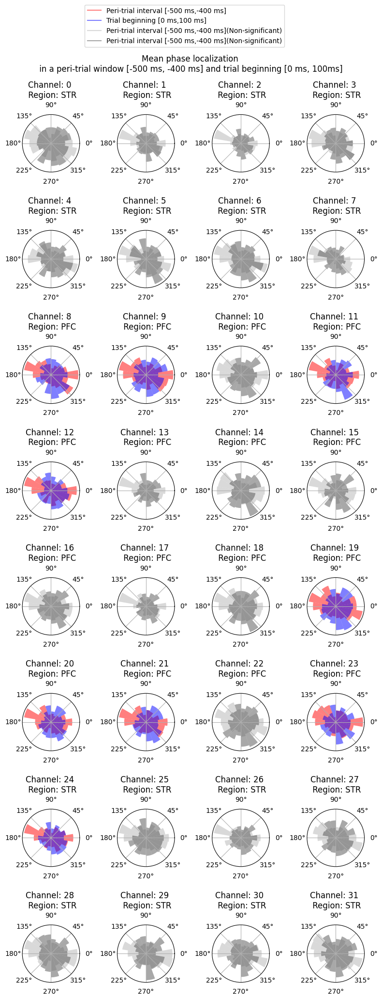

In [ ]:
import json
with open("./channel_region", "r") as fp:
  channel_region_pairs = json.load(fp) #load the JSON with channel-region pairings

channel_results = {}

with open("./channel_region", "r") as fp:
  regions_listing = json.load(fp) #load the JSON with channel-region pairings
#region = regions_listing[f'ch{channel_id}'] #from it fetch the region for the current channel

#Plot the results as a panel with 32 polar histograms of mean phase count

#The results should be stored in a dictionary named channel_phasedist_results
fig, axes = plt.subplots(nrows=8, ncols=4,figsize=(8,20))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Mean phase localization \n in a peri-trial window [-500 ms, -400 ms] and trial beginning [0 ms, 100ms] \n')

channel_counter = 0

num_bins=18
bins = np.linspace(0,2*np.pi,num_bins+1)
width = 2*np.pi/num_bins

for ax in axes.flatten():
  pre_dist,trial_dist = channel_phasedist_results[f'ch{channel_counter}']

  channel_region = channel_region_pairs[f'ch{channel_counter}']

  if scipy.stats.kstest(pre_dist,trial_dist)[1] <= 0.05:
    colors = ['red','blue']
  else:
    colors = ['#b5b5b5','#525252']

  series1_counts,_ = np.histogram(pre_dist,bins)
  series2_counts,_ = np.histogram(trial_dist,bins)

  #only label the first two plots with significant statistics because otherwise we would have repeated labelling

  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')

  if channel_counter == 0:
    labels = ('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]')
    #ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
    label1 = ax.plot([], [], color='red',alpha=0.5,label=labels[0])
    label2 = ax.plot([], [], color='blue',alpha=0.5,label=labels[1])
    label3 = ax.plot([], [], color='#b5b5b5',alpha=0.5,label=labels[0]+'(Non-significant)')
    label4 = ax.plot([], [], color='#525252',alpha=0.5,label=labels[0]+'(Non-significant)')
  else:
    labels = (None,None)
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color=colors[0],alpha=0.5)
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color=colors[1],alpha=0.5)

  plt.title(f'Channel: {channel_counter} \n Region: {channel_region}')
  plt.yticks([])

  channel_counter+=1

#fetch the labels for each axis in axes
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels,bbox_to_anchor=(0.75,1.035))

fig.tight_layout()

# Sleep phases

In [35]:
data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/'
os.chdir(data_path)

data_states = sio.loadmat('./data/state_scoring/rat4_day2/2017-05-07_13-57-27.SleepState.states.mat')

data_episodes = sio.loadmat('./data/state_scoring/rat4_day2/2017-05-07_13-57-27.SleepStateEpisodes.states.mat')

data_scores = sio.loadmat('./data/state_scoring/rat4_day2/2017-05-07_13-57-27.SleepScoreLFP.LFP.mat')

In [36]:
#load data from rat 4, day 2:
data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/'
os.chdir(data_path)

rat = 4
day = 2

animal_label = f'rat{rat}_day{day}'

os.chdir(f'./data/separated_channels/{animal_label}_LFP_all')
print('current session: ',os.getcwd())

#with open("./metadata.json", "r") as fp:
#    meta_data = json.load(fp) #load the JSON with metadata
#data_sampling_rate = meta_data['sampling_rate'] #from it fetch the sampling rate of the loaded data
#data_sampling_rate = 1250

lfp,channel,region = load_lfp(rat_id = rat,day_id = day,channel_id = 18)

current session:  /content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/data/separated_channels/rat4_day2_LFP_all


In [37]:
lfp

,timestamps,lfp
0,0.0000,456
1,0.0008,353
2,0.0016,456
3,0.0024,279
4,0.0032,314
...,...,...
15133009,12106.4072,0
15133010,12106.4080,0
15133011,12106.4088,0
15133012,12106.4096,0


In [38]:
#This encodes the timestamps [begin, end] for each event of a given state
#data_states['SleepState'][0][0][0][0]

#Timestamps for awake states
awake_timestamps = data_states['SleepState'][0][0][0][0][0][0]

#Timestamps for pathological states
pathological_timestamps = data_states['SleepState'][0][0][0][0][0][1]

#Timestamps for NREM states
nrem_timestamps = data_states['SleepState'][0][0][0][0][0][2]

#Timestamps for REM states
rem_timestamps = data_states['SleepState'][0][0][0][0][0][3]

#'''caution: I have figured which timestamps belong to which state due to the dtypes assigned at the level of "data_states['SleepState'][0][0][0][0]", but it might be a mistake of mine

In [39]:
nrem_timestamps

array([[ 2632,  3010],
       [ 7280,  8335],
       [ 8816,  8891],
       [ 8918,  8970],
       [ 9012,  9239],
       [ 9403,  9542],
       [ 9904, 10549],
       [10853, 10992],
       [11018, 11151],
       [11176, 11245],
       [11268, 11536],
       [11910, 11952],
       [11969, 12057]], dtype=uint16)

In [40]:
first_asleep_state = lfp.query(f'timestamps > {nrem_timestamps[0][0]} and timestamps <= {nrem_timestamps[0][1]}')
first_awake_state = lfp.query(f'timestamps > {awake_timestamps[0][0]} and timestamps <= {awake_timestamps[0][1]}')
first_pathological_state = lfp.query(f'timestamps > {pathological_timestamps[0][0]} and timestamps <= {pathological_timestamps[0][1]}')

In [13]:
def state_lfp(lfp_signal,timestamp_delimitators):
  #clip the LFP at the desired timestamp delimitators and return the signal
  return lfp.query(f'timestamps > {timestamp_delimitators[0]} and timestamps <= {timestamp_delimitators[1]}').lfp.values

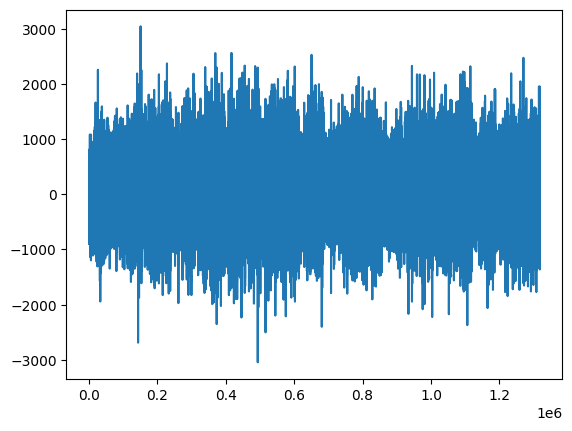

In [14]:
#example usage:
plt.plot(state_lfp(lfp,nrem_timestamps[1]))

In [15]:
target_signal = first_asleep_state.lfp.values

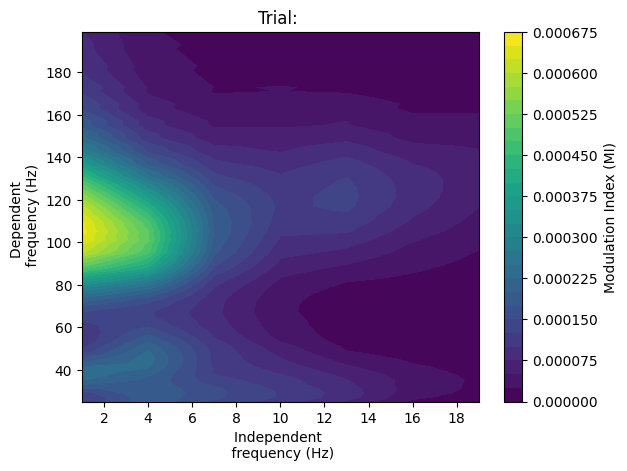

In [16]:
#independent bandwidth = 5, dependent bandwidth = 10
comod_awake,ind_freqs_awake,dep_freqs_awake = comodulogram2(target_signal,ind_band = [1,20],dep_band=[25,200],ind_step=3,dep_step=2,
                  ind_bandwidth=5,dep_bandwidth=10)

plot_comodulogram(comod_awake,ind_freqs_awake,dep_freqs_awake)
plt.show()

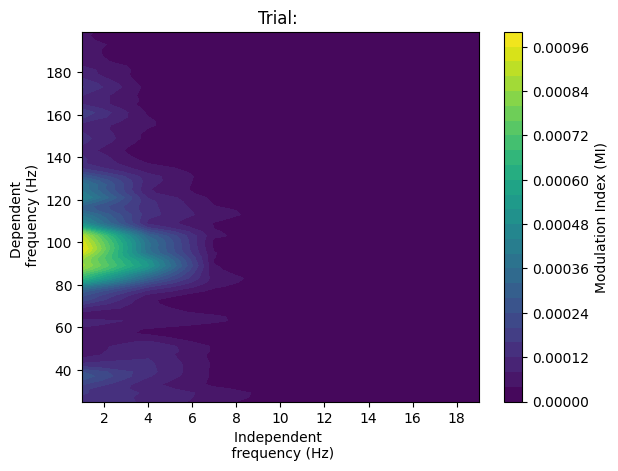

In [ ]:
#independent bandwidth = 5, dependent bandwidth = 15
comod_awake,ind_freqs_awake,dep_freqs_awake = comodulogram2(target_signal,ind_band = [1,20],dep_band=[25,200],ind_step=3,dep_step=2,
                  ind_bandwidth=5,dep_bandwidth=15)

plot_comodulogram(comod_awake,ind_freqs_awake,dep_freqs_awake)
plt.show()

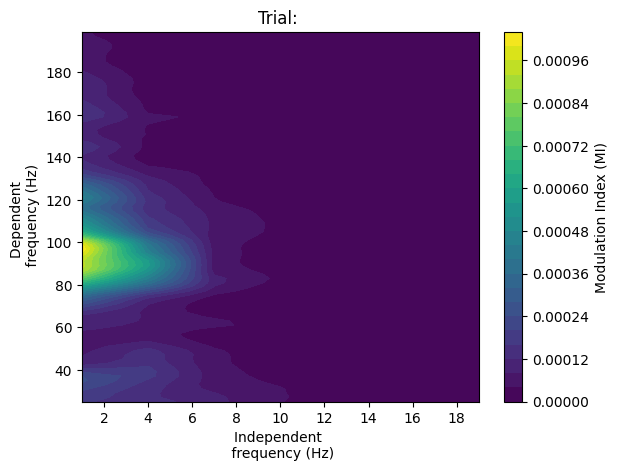

In [ ]:
#independent bandwidth = 5, dependent bandwidth = 20
#comod_awake,ind_freqs_awake,dep_freqs_awake = comodulogram2(target_signal,ind_band = [1,20],dep_band=[25,200],ind_step=3,dep_step=2,
#                  ind_bandwidth=5,dep_bandwidth=20)

plot_comodulogram(comod_awake,ind_freqs_awake,dep_freqs_awake)
plt.show()

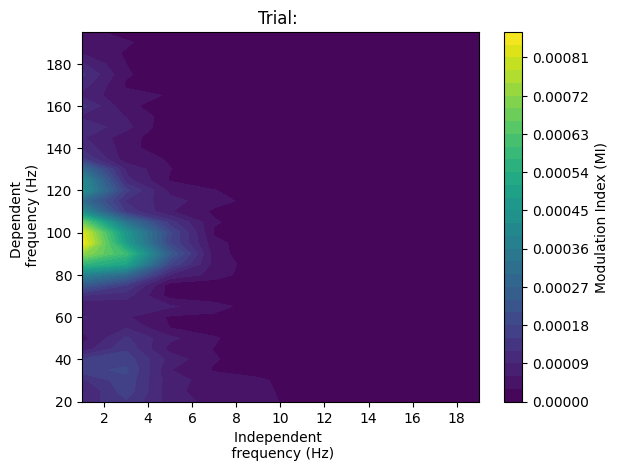

In [ ]:
#comod_tort,ind_freqs_tort,dep_freqs_tort = comodulogram2(target_signal,ind_bandwidth=4,dep_bandwidth=15,sampling_rate=1250,num_bins=30)
plot_comodulogram(comod_tort,ind_freqs_tort,dep_freqs_tort)

#### developing a FIR filter and probing the comodulogram with it

In [15]:
def band_extraction(lfp_data,cutoff_low,cutoff_high,sampling_rate=1250,order=3):
    '''Filter the broadband LFP signal, allowing only frequencies between the limits [cutoff_low,cutoff_high]
    using a Butter bandpass filter.

    INPUT:
        - lfp_data: a pandas Series object containing the signal to be filtered (i.e. the LFP);
        - cutoff_low: the lowest frequency allowed;
        - cutoff_high: the highest frequency allowed;
        - sampling_rate: in Hz [default: 1250];
        - order: the order of the Butter filter employed [default: 3]

    OUTPUT:
        - the filtered signal as a 1D numpy array;
    '''

    from scipy.signal import butter, lfilter, filtfilt

    #Design the filter
    nyquist_freq = 0.5*sampling_rate
    inf_threshold = cutoff_low/nyquist_freq
    sup_threshold = cutoff_high/nyquist_freq
    b,a = butter(order,[inf_threshold,sup_threshold],btype='bandpass')

    #Return the filter applied to the signal
    return filtfilt(b,a,lfp_data)

In [24]:
def band_extraction(lfp_data,cutoff_low,cutoff_high,sampling_rate=1250,order=3):
    '''Filter the broadband LFP signal, allowing only frequencies between the limits [cutoff_low,cutoff_high]
    using a Butter bandpass filter.

    INPUT:
        - lfp_data: a pandas Series object containing the signal to be filtered (i.e. the LFP);
        - cutoff_low: the lowest frequency allowed;
        - cutoff_high: the highest frequency allowed;
        - sampling_rate: in Hz [default: 1250];
        - order: the order of the Butter filter employed [default: 3]

    OUTPUT:
        - the filtered signal as a 1D numpy array;
    '''

    from scipy.signal import butter, firwin, lfilter, filtfilt

    #Design the filter
    nyquist_freq = 0.5*sampling_rate
    inf_threshold = cutoff_low/nyquist_freq
    sup_threshold = cutoff_high/nyquist_freq

    #order is given in cycles; transform it into samples by multiplying by the sampling rate frequency
    filter_length = round(order*(2*nyquist_freq)/cutoff_high)

    #b,a = butter(order,[inf_threshold,sup_threshold],btype='bandpass')
    #a = scipy.signal.firwin(n, cutoff = [0.016, 0.02], window = 'hamming', pass_zero = False)
    h = firwin(filter_length,cutoff = [inf_threshold,sup_threshold],window='hamming',pass_zero=False)

    #Return the filter applied to the signal
    return filtfilt(h,1,lfp_data)

In [ ]:
# Calculate 20*log10(x) without printing an error when x=0
def dB20(array):
    with np.errstate(divide='ignore'):
        return 20 * np.log10(array)

def filter_response_plot(b,a,cutoffs):
  w, h = scipy.signal.freqz(b,a)
  h = abs(h) #the frequency-response h is given as a complex number, but the amplitude at each frequency is its absolute value
  #plt.semilogx(w,dB20(h)) #y in decibels, log in the frequency plane x
  plt.plot(w,dB20(h))
  plt.title('Filter frequency response')
  plt.ylabel('Amplitude [dB]')
  plt.xlabel('Frequency (rad/sampling rate)')

  plt.grid(which='both', axis = 'both')
  for cutoff_freq in cutoffs:
    plt.axvline(cutoff_freq,color='green')
  plt.show()

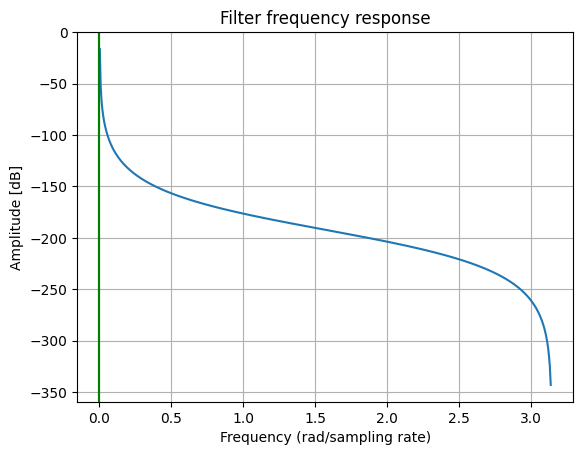

In [ ]:
filter_response_plot(b,a,[inf_threshold,sup_threshold])

In [ ]:
np.log(inf_threshold)

-6.437751649736401

ValueError: ignored

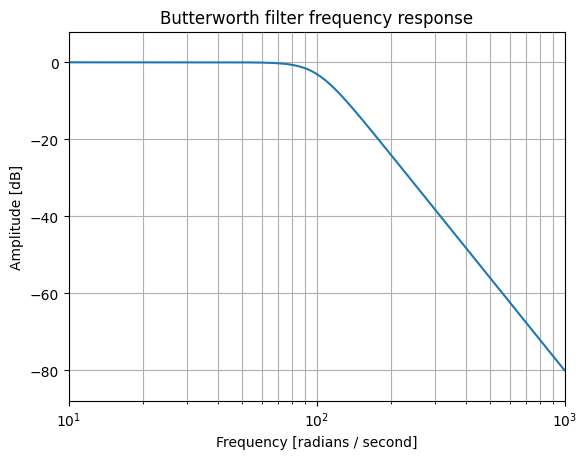

In [ ]:
b2, a2 = scipy.signal.butter(4, 100, 'low', analog=True)
w, h = scipy.signal.freqs(b2, a2)
plt.semilogx(w, 20 * np.log10(abs(h))) #y in decibels
plt.title('Butterworth filter frequency response')
plt.xlabel('Frequency [radians / second]')
plt.ylabel('Amplitude [dB]')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.show()

In [ ]:
freqs_for_amps = np.arange(30,202,2)
freqs_for_phases = np.arange(1,20.25,.25)
sampling_rate = 1250
nyquist_freq = 0.5*sampling_rate


cutoff_low = freqs_for_phases[0]
cutoff_high = freqs_for_phases[1]

print('desired frequencies to be filtered:\n',cutoff_low,cutoff_high)

from scipy.signal import butter, lfilter, filtfilt,freqs,freqz,firwin
order = 3

inf_threshold = cutoff_low/nyquist_freq
sup_threshold = cutoff_high/nyquist_freq

print('desired frequencies to be filtered (as percentages of the nyquist frequency):\n',inf_threshold,sup_threshold)

b,a = butter(order,[inf_threshold,sup_threshold],btype='bandpass')

desired frequencies to be filtered:
 1.0 1.25
desired frequencies to be filtered (as percentages of the nyquist frequency):
 0.0016 0.002


In [ ]:
freqs_for_phases

array([ 1.  ,  1.25,  1.5 ,  1.75,  2.  ,  2.25,  2.5 ,  2.75,  3.  ,
        3.25,  3.5 ,  3.75,  4.  ,  4.25,  4.5 ,  4.75,  5.  ,  5.25,
        5.5 ,  5.75,  6.  ,  6.25,  6.5 ,  6.75,  7.  ,  7.25,  7.5 ,
        7.75,  8.  ,  8.25,  8.5 ,  8.75,  9.  ,  9.25,  9.5 ,  9.75,
       10.  , 10.25, 10.5 , 10.75, 11.  , 11.25, 11.5 , 11.75, 12.  ,
       12.25, 12.5 , 12.75, 13.  , 13.25, 13.5 , 13.75, 14.  , 14.25,
       14.5 , 14.75, 15.  , 15.25, 15.5 , 15.75, 16.  , 16.25, 16.5 ,
       16.75, 17.  , 17.25, 17.5 , 17.75, 18.  , 18.25, 18.5 , 18.75,
       19.  , 19.25, 19.5 , 19.75, 20.  ])

<ipython-input-33-4eafff7fbb77>:2: RuntimeWarning: divide by zero encountered in log10
  plt.plot(w, 20 * np.log10(abs(h)), 'b')


Text(0.5, 0, 'Frequency [rad/sampling frequency]')

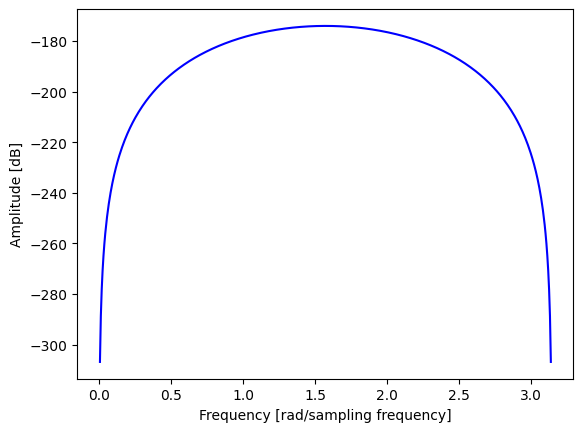

In [ ]:
w,h = freqz(b)
plt.plot(w, 20 * np.log10(abs(h)), 'b')
plt.ylabel('Amplitude [dB]')
plt.xlabel('Frequency [rad/sampling frequency]')

In [ ]:
f1, f2 = 1, 1.25
scipy.signal.firwin(numtaps, [f1, f2], pass_zero=False)

b,a = firwin(numtaps,cutoff = [inf_threshold,sup_threshold],window='hamming')

NameError: ignored

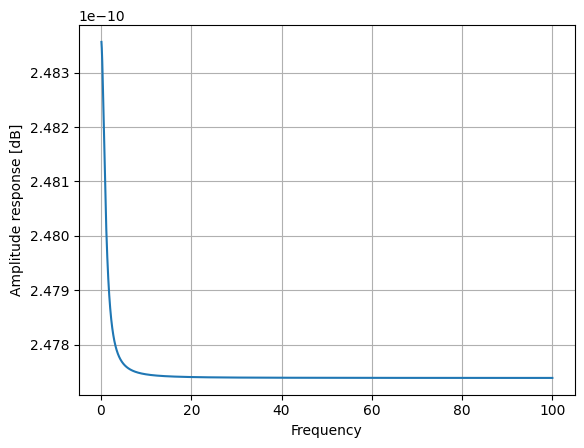

In [ ]:
w, h = freqs(b, a, worN=np.logspace(-1, 2, 1000))
plt.plot(w,abs(h))
plt.xlabel('Frequency')
plt.ylabel('Amplitude response [dB]')
plt.grid(True)
plt.show()

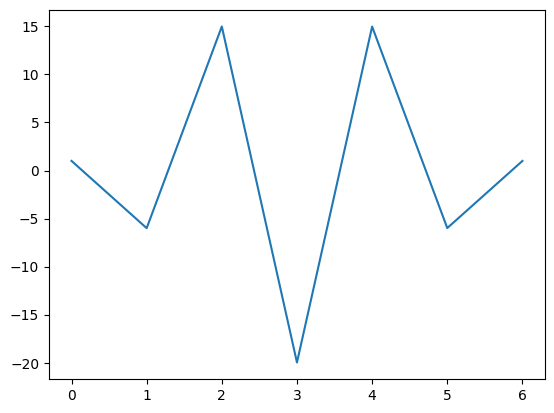

In [ ]:
plt.plot(a)

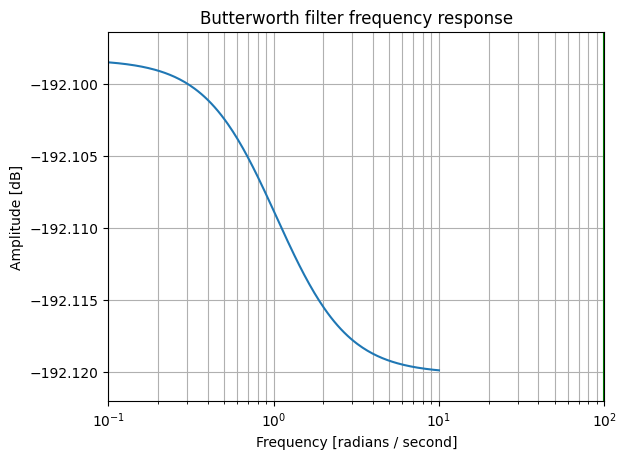

In [ ]:
#b, a = signal.butter(4, 100, 'low', analog=True)
w, h = scipy.signal.freqs(b, a)
plt.semilogx(w, 20 * np.log10(abs(h)))
plt.title('Butterworth filter frequency response')
plt.xlabel('Frequency [radians / second]')
plt.ylabel('Amplitude [dB]')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.axvline(100, color='green') # cutoff frequency
plt.show()

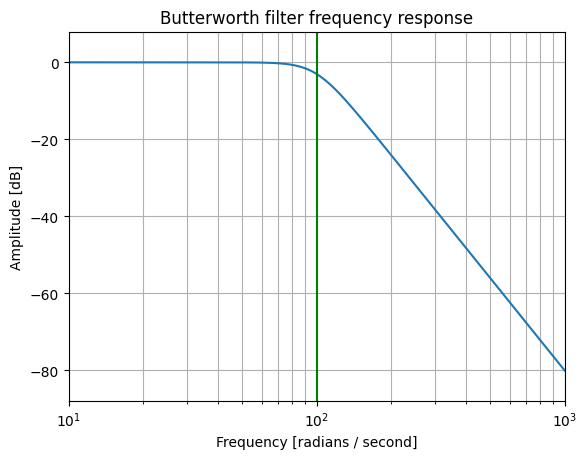

In [ ]:
b2, a2 = scipy.signal.butter(4, 100, 'low', analog=True)
w, h = scipy.signal.freqs(b2, a2)
plt.semilogx(w, 20 * np.log10(abs(h))) #y in decibels
plt.title('Butterworth filter frequency response')
plt.xlabel('Frequency [radians / second]')
plt.ylabel('Amplitude [dB]')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.axvline(100, color='green') # cutoff frequency
plt.show()

In [ ]:
from pylab import *
import scipy.signal as signal

#Plot frequency and phase response
def mfreqz(b,a=1):
    w,h = signal.freqz(b,a)
    h_dB = 20 * log10 (abs(h))
    subplot(211)
    plot(w/max(w),h_dB)
    ylim(-150, 5)
    ylabel('Magnitude (db)')
    xlabel(r'Normalized Frequency (x$\pi$rad/sample)')
    title(r'Frequency response')
    subplot(212)
    h_Phase = unwrap(arctan2(imag(h),real(h)))
    plot(w/max(w),h_Phase)
    ylabel('Phase (radians)')
    xlabel(r'Normalized Frequency (x$\pi$rad/sample)')
    title(r'Phase response')
    subplots_adjust(hspace=0.5)

#Plot step and impulse response
def impz(b,a=1):
    l = len(b)
    impulse = repeat(0.,l); impulse[0] =1.
    x = arange(0,l)
    response = signal.lfilter(b,a,impulse)
    subplot(211)
    stem(x, response)
    ylabel('Amplitude')
    xlabel(r'n (samples)')
    title(r'Impulse response')
    subplot(212)
    step = cumsum(response)
    stem(x, step)
    ylabel('Amplitude')
    xlabel(r'n (samples)')
    title(r'Step response')
    subplots_adjust(hspace=0.5)

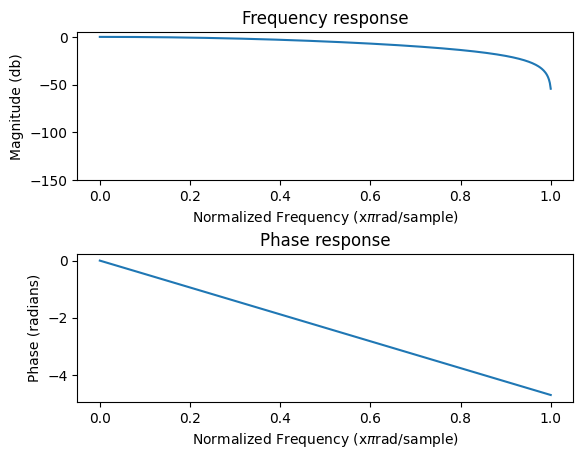

In [ ]:
n = 4
inf_threshold,sup_threshold
a = signal.firwin(n, cutoff = [inf_threshold, sup_threshold], window = 'hamming', pass_zero = False)
mfreqz(a)
show()

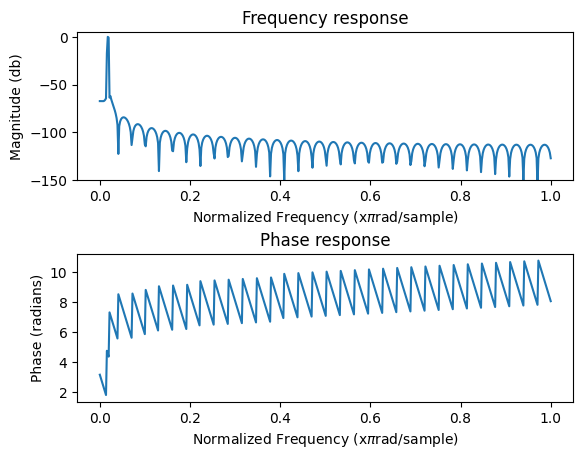

In [77]:
n = 4160
a = scipy.signal.firwin(n, cutoff = [0.016, 0.02], window = 'hamming', pass_zero = False)
mfreqz(a)
show()

In [ ]:
def adjusted_filter_order(nyquist_frequency,stop_band):



In [ ]:
sampling_rate = 1250
nyquist = 650
order = 4
round(order*2*nyquist/1.25)

#filt_order = round(order*2*nyquist./passband(1));
#				[b a] = fir1(filt_order,passband/nyquist);

4160

In [ ]:
ind_analytic = hilbert(band_extraction(lfp,cutoff_low=fp,cutoff_high=fp+ind_bandwidth,
                                               sampling_rate=sampling_rate))

In [ ]:
freqs_for_phases[0]

1.25

In [ ]:
def comodulogram2(lfp,ind_band=[1,20],dep_band=[20,200],ind_step=2,dep_step=5,
                  ind_bandwidth=4,dep_bandwidth=10,num_bins=18,sampling_rate=1250):

    bin_size = round(360/num_bins)
    phasevector = np.arange(-180,180-bin_size+1,bin_size)
    phase_freq_vector = np.arange(ind_band[0],ind_band[1],ind_step)
    amp_freq_vector = np.arange(dep_band[0],dep_band[1],dep_step)

    mean_amp = np.empty(num_bins)
    comodulogram = np.empty((len(phase_freq_vector),len(amp_freq_vector)))

    from scipy.signal import hilbert
    for count_phase,fp in enumerate(phase_freq_vector):
        ind_analytic = hilbert(band_extraction(lfp,cutoff_low=fp,cutoff_high=fp+ind_bandwidth,
                                               sampling_rate=sampling_rate))
        phase = np.angle(ind_analytic)

        for count_amp,fa in enumerate(amp_freq_vector):
            dep_analytic = hilbert(band_extraction(lfp,cutoff_low=fa,cutoff_high=fa+dep_bandwidth,
                                                   sampling_rate=sampling_rate))
            amplitude = abs(dep_analytic)

            for count,phasebin in enumerate(phasevector):
                I = (np.rad2deg(phase)>phasebin)*(np.rad2deg(phase)<(phasebin+20))
                mean_amp[count] = np.mean(amplitude[I])

            p = mean_amp/sum(mean_amp)
            MI = (np.log(len(p))+sum(p[p>0]*np.log(p[p>0])))/np.log(len(p))
            comodulogram[count_phase,count_amp] = MI

    return comodulogram,phase_freq_vector,amp_freq_vector

def plot_comodulogram(comod,ind_freqs,dep_freqs,trial_index=''):
    #estimating the frequency step used to build the comodulogram from the frequencies
    ind_step = ind_freqs[1] - ind_freqs[0]
    dep_step = dep_freqs[1] - dep_freqs[0]

    #make a grid to accommodate the data
    x,y = np.meshgrid(ind_freqs,dep_freqs)

    plt.contourf(x, y, comod.T, 30, cmap=plt.cm.viridis)
    plt.title(f'Trial: {trial_index}')
    plt.xlabel('Independent \n frequency (Hz)')
    plt.ylabel('Dependent \n frequency (Hz)')
    plt.colorbar(label="Modulation Index (MI)")

#### synthetic lfp

In [17]:
def gera_sinal_modulante(t, f, fase= 0, A= 1):
    sinal_modulante = A * np.sin( 2 * np.pi * f * t + fase)
    return( sinal_modulante )

def gera_sinais_ruidosos(t, amp_ruido= 0.1, tipo= 'branco'):
    if tipo == 'branco':
        return(\
               np.random.normal(loc= 0, scale= amp_ruido, size= np.size(t) ))

def sinais_oscilatorios_aleatorios(t):

    freqs = [0.1, 1, 2, 3, 5, 10, 90, 100]
    ampls = [  3, 3, 3, 4, 4,  2,  0,  0]
    fases = np.random.uniform(0, 2*np.pi, size= np.size(freqs))

    signal = ampls[0] * np.sin( 2 * np.pi * freqs[0] * t + fases[0])

    for f, A, fi in zip(freqs, ampls, fases):
        signal = np.vstack(\
            (signal, A * np.sin(2*np.pi*f*t + fi)))

    return(np.mean(signal,0))

def sinal_completo2(f_modulante=4,f_modulada=50,fase=np.pi/2,duracao=0.8,nivel_ruido=0):
    # parâmetros importantes
    # nomenclatura
    # me = modulante
    # mo = modulado
    A_me = 0.4      # amplitude (u.a.) dos sinal modulante
    f_me = f_modulante        # frequencia modulante em Hz

    f_mo = f_modulada       # frequência do sinal modulado em Hz

    #offset = A_me/2 + 0.1   # um ajuste para a evitar que a f_mo fique negativa
    escala = 0.3            # escala da amplitude sinal modulado
    #fase   = np.pi/2       # fase em que um sinal modula o outro
    fase = fase

    # simulando tempo em segundos em uma taxa de amostra de 1 kHz (fs= 1000)
    #t = np.arange(start= 0, stop= 0.8, step= 0.001) #800ms
    t = np.arange(start= 0, stop= duracao, step= 0.001) #20s

    # simulando o sinal modulante s_me
    s_me = gera_sinal_modulante(t, A= A_me, f= f_me)

    # simulando o sinal modulante s_me com fase diferente
    s_me_fase = gera_sinal_modulante(t, A= A_me, f= f_me, fase= fase)

    # modulação
    #mod = (gera_sinal_modulante(t, fase) + offset) * escala
    mod = np.where(s_me < 0, 0, s_me) * escala


    # simulando o sinal modulado (amplitude modulada)
    s_mo = mod * np.sin( 2 * np.pi * f_mo * t + fase)

    # sinal total
    s_t = s_me + s_mo\
        + gera_sinais_ruidosos(t=t,amp_ruido = nivel_ruido)\
#        + sinais_oscilatorios_aleatorios(t)

#    plt.psd(s_t-np.mean(s_t), Fs=1000)
#    plt.show()
#    plt.plot(s_mo)
    return( s_t )

In [18]:
clean_cfc_signal = sinal_completo2(f_modulante=5,f_modulada=50,fase=np.pi/2,duracao=20,nivel_ruido = 0)
noisy_cfc_signal = sinal_completo2(f_modulante=5,f_modulada=50,fase=np.pi/2,duracao=20,nivel_ruido = 0.5)

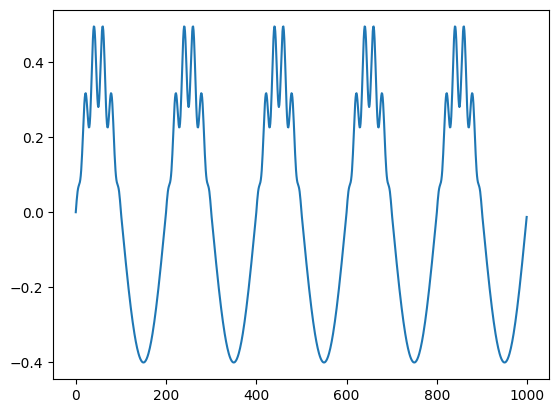

In [19]:
plt.plot(clean_cfc_signal[0:1000])

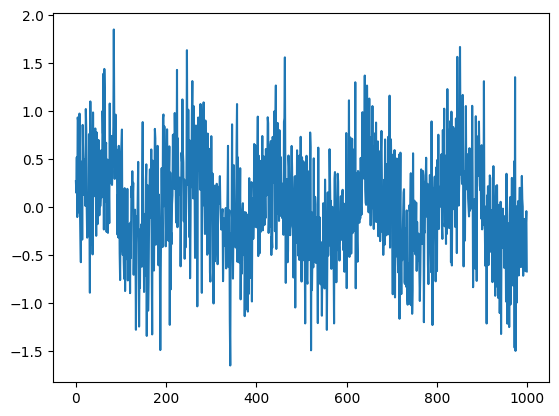

In [20]:
plt.plot(noisy_cfc_signal[0:1000])

Text(0, 0.5, 'Dependent \n frequency (Hz)')

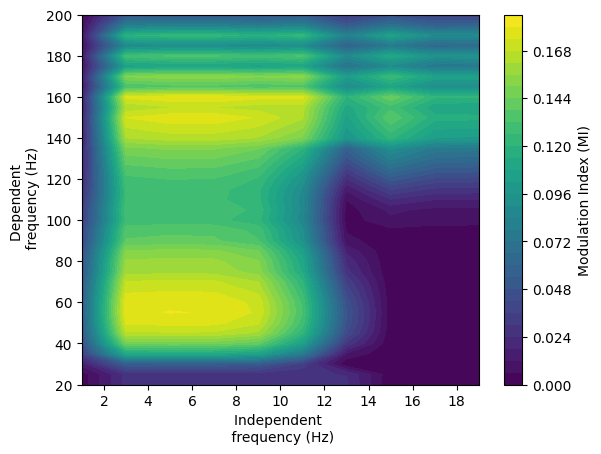

In [21]:
#synth_comod,synth_ind,synth_dep = comodulogram2(clean_cfc_signal)

demo_fp_bw = .5
demo_fa_bw = 5

comod,ind_freqs,dep_freqs = comodulogram2(clean_cfc_signal,ind_band=[1,20],dep_band=[20,201],ind_step=2,dep_step=5,
                  ind_bandwidth=demo_fp_bw,dep_bandwidth=demo_fa_bw,num_bins=30,sampling_rate=1000)

ind_step = ind_freqs[1] - ind_freqs[0]
dep_step = dep_freqs[1] - dep_freqs[0]

x,y = np.meshgrid(ind_freqs,dep_freqs)

#plt.figure(figsize=(10,7))
#plt.contourf(x+ind_step, y+dep_step, comod.T, 30, cmap=plt.cm.viridis)
plt.contourf(x, y, comod.T, 30, cmap=plt.cm.viridis)
plt.colorbar(label='Modulation Index (MI)')
plt.xlabel('Independent \n frequency (Hz)')
plt.ylabel('Dependent \n frequency (Hz)')

In [22]:
def bandwidth_dependence_panel(lfp_signal,ind_coverage=[0.25,1.75],dep_coverage=[2.5,10],ind_step=0.5,dep_step=1.5):
  from matplotlib import ticker

  ind_bandwidths = np.arange(ind_coverage[0],ind_coverage[1]+.1,ind_step)
  dep_bandwidths = np.arange(dep_coverage[0],dep_coverage[1]+.1,dep_step)

  from itertools import product
  bandwidth_pairs = [[ind_band,dep_band] for ind_band,dep_band in product(ind_bandwidths,dep_bandwidths)]

  if len(bandwidth_pairs) > 30:
    fig, axes = plt.subplots(nrows=len(ind_bandwidths), ncols=len(dep_bandwidths),figsize=(18,22),sharex = True,sharey = True)
  else:
    fig, axes = plt.subplots(nrows=len(ind_bandwidths), ncols=len(dep_bandwidths),figsize=(16,12),sharex = True,sharey = True)


  for i, ax in enumerate(axes.flatten()):
      ax.set_title(r'$I_{bw} = $'+f'{bandwidth_pairs[i][0]} \n' r'$D_{bw} = $'+f'{bandwidth_pairs[i][1]}')

      demo_fp_bw = bandwidth_pairs[i][0]
      demo_fa_bw = bandwidth_pairs[i][1]

      comod,ind_freqs,dep_freqs = comodulogram2(lfp_signal,ind_band=[1,20],dep_band=[20,201],ind_step=2,dep_step=5,
                        ind_bandwidth=demo_fp_bw,dep_bandwidth=demo_fa_bw,num_bins=18,sampling_rate=1000)

      ind_step = ind_freqs[1] - ind_freqs[0]
      dep_step = dep_freqs[1] - dep_freqs[0]

      x,y = np.meshgrid(ind_freqs,dep_freqs)

      comod_im = ax.contourf(x, y, comod.T, 30, cmap=plt.cm.viridis)

      #create a colorbar
      cbar = plt.colorbar(comod_im,ax=ax)
      #and plot its y-axis in scientific notation
      cbar.formatter.set_powerlimits((0, 0))

  #Shared x- and y-labels for the whole image
  fig.suptitle('Influence of independent and dependent bandwidths in comodulogram adequacy')
  fig.supxlabel('Dependent \nfrequency (Hz)')
  fig.supylabel('Independent \nfrequency (Hz)')

  plt.tight_layout()
  plt.show()


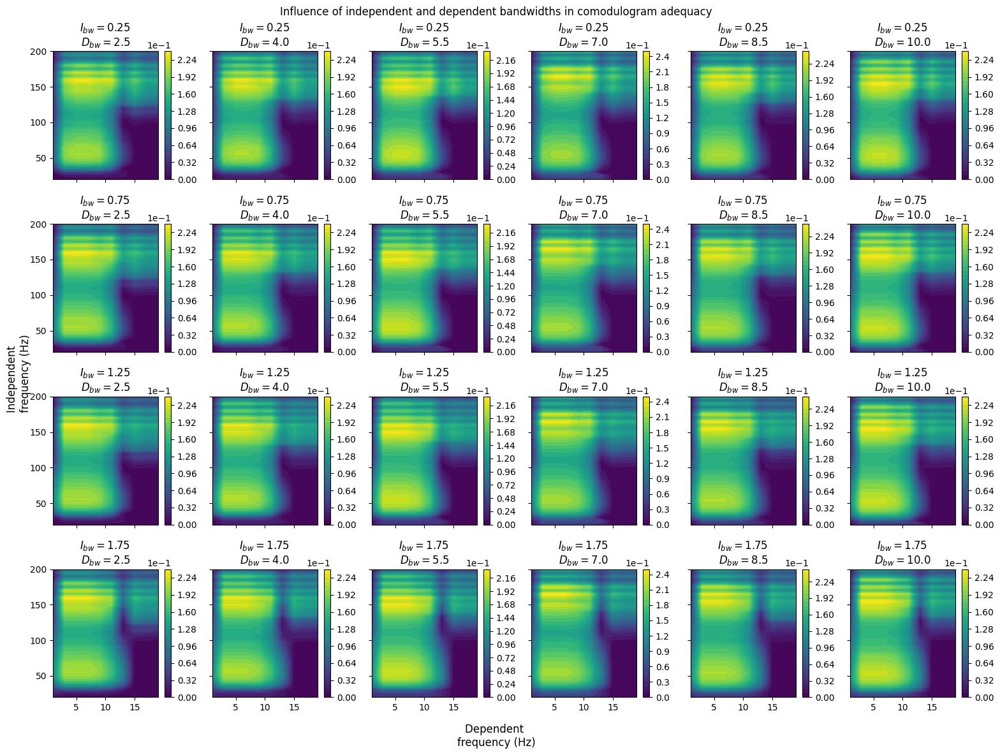

In [23]:
'''
why plot this panel: to illustrate that different window sizes in the filtering process can hinder the identification of a (real) comodulation

the blob at (5 Hz, 50 Hz) [modulating, modulated] can be identified in a few plots but not in others
'''
bandwidth_dependence_panel(clean_cfc_signal)

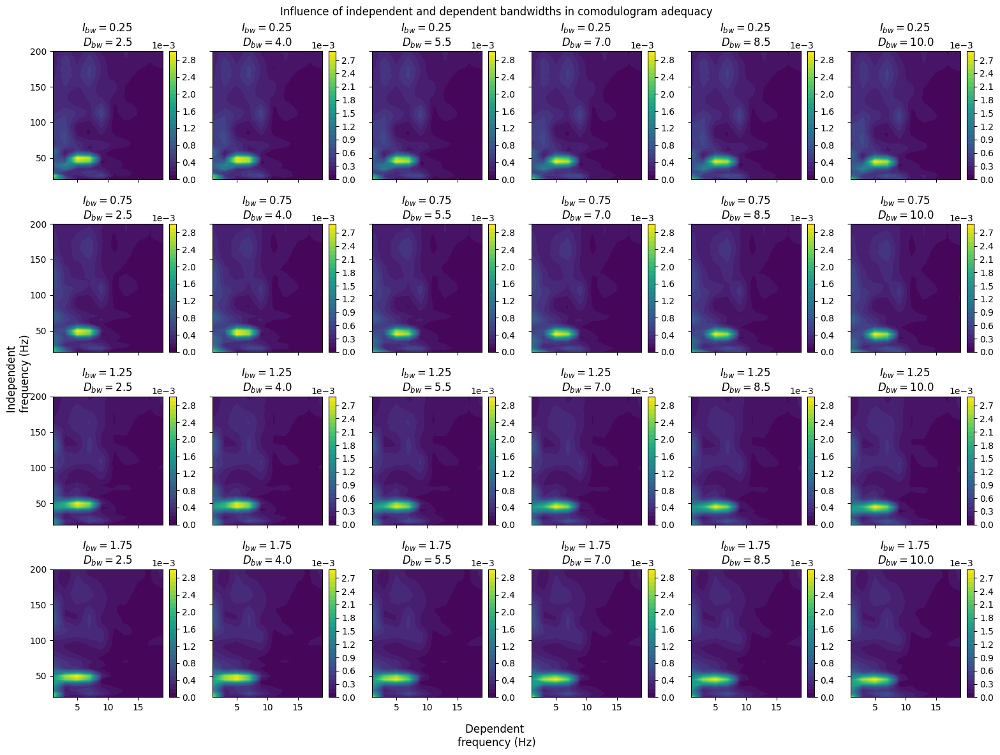

In [24]:
'''
why plot this panel: to show that even though these parameters can keep one from identifying a comodulation it does not work together with noise to create spurious islands in the comodulogram
that could be mistaken for a proper comodulation
'''

bandwidth_dependence_panel(noisy_cfc_signal)

In [ ]:
ind_bandwiths = np.arange(0.25,2,.5)
dep_bandwiths = np.arange(2.5,11,1.5)

In [ ]:
from itertools import product

In [ ]:
test = product(ind_bandwiths,dep_bandwiths)

In [ ]:
bandwidth_pairs = []
for ind_band,dep_band in test:
  print(ind_band,dep_band)
  bandwidth_pairs.append([ind_band,dep_band])

In [ ]:
len(bandwidth_pairs)

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=6,figsize=(16,12),sharex = True,sharey = True)
for i, ax in enumerate(axes.flatten()):
    ax.set_title(r'$I_{bw} = $'+f'{bandwidth_pairs[i][0]} \n' r'$D_{bw} = $'+f'{bandwidth_pairs[i][1]}')
    #synth_comod,synth_ind,synth_dep = comodulogram2(clean_cfc_signal)

    demo_fp_bw = bandwidth_pairs[i][0]
    demo_fa_bw = bandwidth_pairs[i][1]

    comod,ind_freqs,dep_freqs = comodulogram2(clean_cfc_signal,ind_band=[1,20],dep_band=[20,201],ind_step=2,dep_step=5,
                      ind_bandwidth=demo_fp_bw,dep_bandwidth=demo_fa_bw,num_bins=18,sampling_rate=1000)

    ind_step = ind_freqs[1] - ind_freqs[0]
    dep_step = dep_freqs[1] - dep_freqs[0]

    x,y = np.meshgrid(ind_freqs,dep_freqs)

    comod_im = ax.contourf(x, y, comod.T, 30, cmap=plt.cm.viridis)
    plt.colorbar(comod_im, ax=ax)

#Shared x- and y-labels for the whole image
fig.suptitle('Influence of independent and dependent bandwidths in comodulogram adequacy')
fig.supxlabel('Dependent \nfrequency (Hz)')
fig.supylabel('Independent \nfrequency (Hz)')

plt.tight_layout()
plt.show()

#### Loading Tort's data and trying to identify its comodulation

In [25]:
tort_data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/data/tort_data'

tort_LFP = sio.loadmat(tort_data_path+'/LFP_HG_HFO.mat')

In [26]:
tort_LFP

{'__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: Fri Nov 26 20:52:32 2010',
 '__version__': '1.0',
 '__globals__': [],
 'lfpHFO': array([[-0.07958984, -0.05908203, -0.03564453, ...,  0.11328125,
          0.12988281,  0.12353516]]),
 'lfpHG': array([[-0.3203125 , -0.31738281, -0.30712891, ...,  0.16015625,
          0.16552734,  0.17041016]])}

In [27]:
tort_LFP['lfpHG']

array([[-0.3203125 , -0.31738281, -0.30712891, ...,  0.16015625,
         0.16552734,  0.17041016]])

In [28]:
high_gamma = tort_LFP['lfpHG'] #signals with a high-gamma amplitude comodulation to slower signals' phase, as in Tort et al., (J. Neurophysiol., 2010)

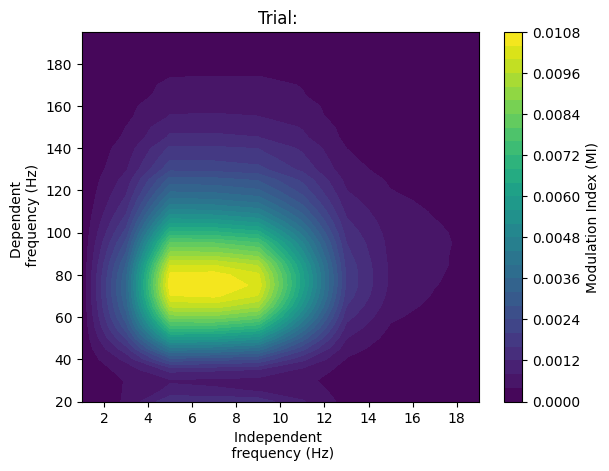

In [29]:
comod_tort,ind_freqs_tort,dep_freqs_tort = comodulogram2(high_gamma,ind_bandwidth=4,dep_bandwidth=15,sampling_rate=1000,num_bins=30)
plot_comodulogram(comod_tort,ind_freqs_tort,dep_freqs_tort)

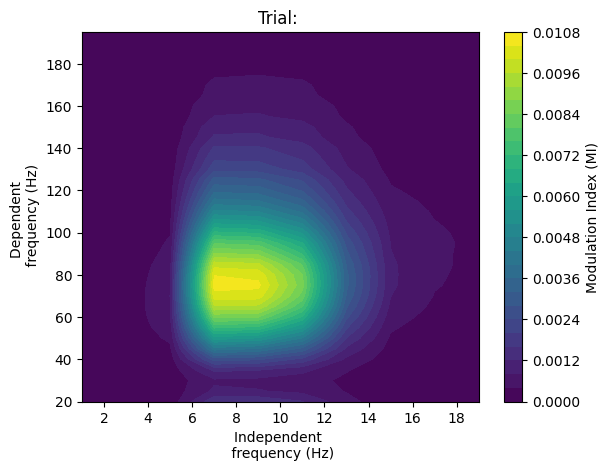

In [30]:
comod_tort,ind_freqs_tort,dep_freqs_tort = comodulogram2(high_gamma,ind_bandwidth=0.5,dep_bandwidth=15,sampling_rate=1000,num_bins=30)
plot_comodulogram(comod_tort,ind_freqs_tort,dep_freqs_tort)

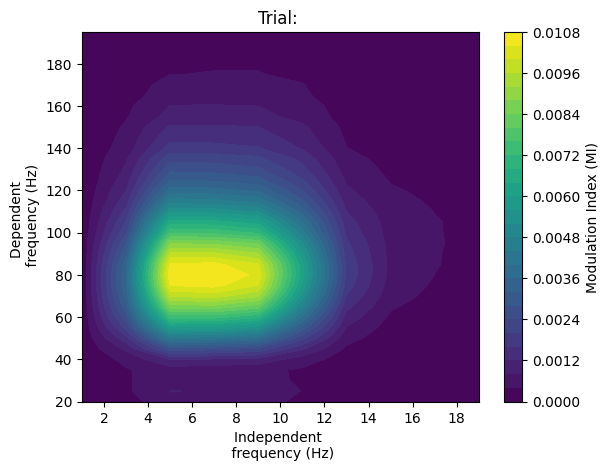

In [31]:
comod_tort,ind_freqs_tort,dep_freqs_tort = comodulogram2(high_gamma,ind_bandwidth=4,dep_bandwidth=5,sampling_rate=1000,num_bins=30)
plot_comodulogram(comod_tort,ind_freqs_tort,dep_freqs_tort)

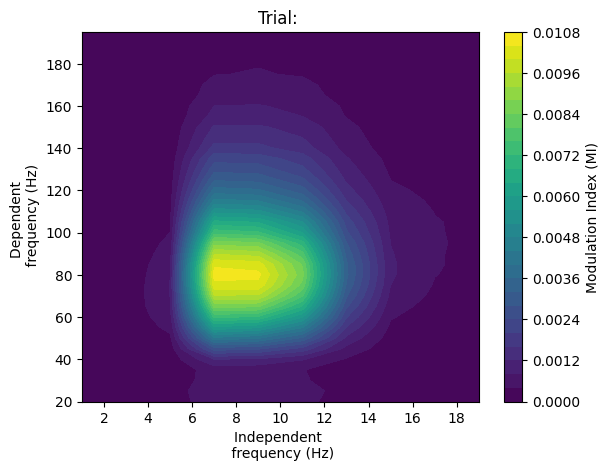

In [32]:
comod_tort,ind_freqs_tort,dep_freqs_tort = comodulogram2(high_gamma,ind_bandwidth=.5,dep_bandwidth=5,sampling_rate=1000,num_bins=30)
plot_comodulogram(comod_tort,ind_freqs_tort,dep_freqs_tort)

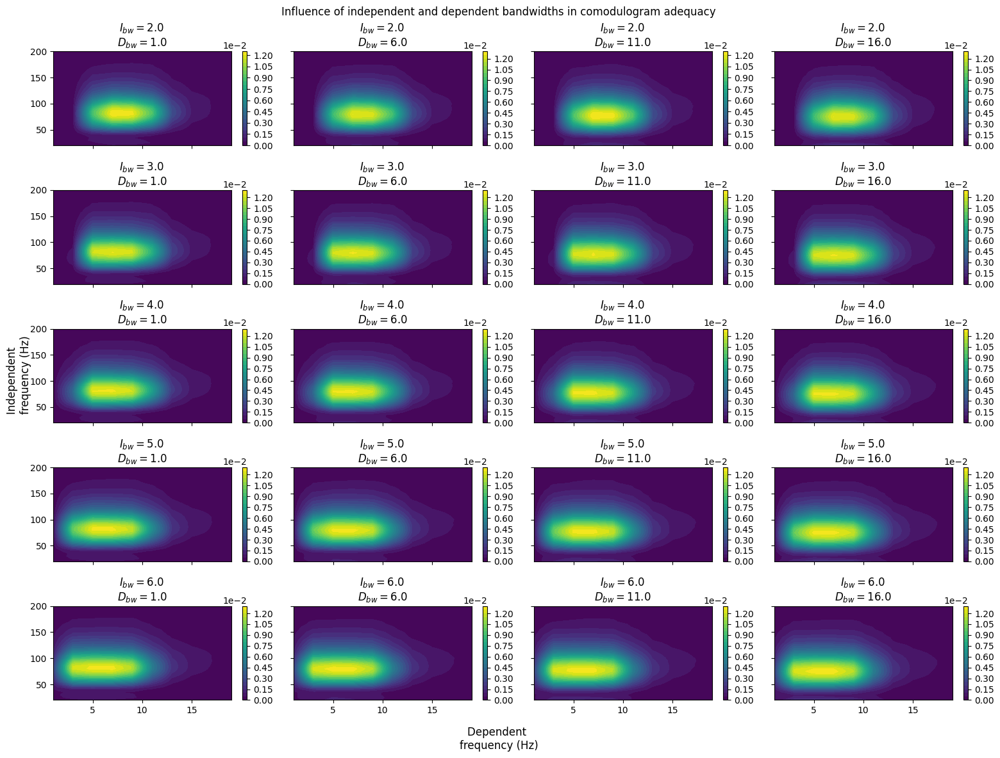

In [33]:
bandwidth_dependence_panel(high_gamma,ind_coverage=[2,6],dep_coverage=[1,16],ind_step = 1,dep_step = 5)

#### end of Tort's LFP

### Eliezyer's comodulogram code translation

In [34]:
freqs_for_amps = np.arange(30,202,2)
freqs_for_phases = np.arange(1,20.25,.25)

In [35]:
freqs_for_phases

array([ 1.  ,  1.25,  1.5 ,  1.75,  2.  ,  2.25,  2.5 ,  2.75,  3.  ,
        3.25,  3.5 ,  3.75,  4.  ,  4.25,  4.5 ,  4.75,  5.  ,  5.25,
        5.5 ,  5.75,  6.  ,  6.25,  6.5 ,  6.75,  7.  ,  7.25,  7.5 ,
        7.75,  8.  ,  8.25,  8.5 ,  8.75,  9.  ,  9.25,  9.5 ,  9.75,
       10.  , 10.25, 10.5 , 10.75, 11.  , 11.25, 11.5 , 11.75, 12.  ,
       12.25, 12.5 , 12.75, 13.  , 13.25, 13.5 , 13.75, 14.  , 14.25,
       14.5 , 14.75, 15.  , 15.25, 15.5 , 15.75, 16.  , 16.25, 16.5 ,
       16.75, 17.  , 17.25, 17.5 , 17.75, 18.  , 18.25, 18.5 , 18.75,
       19.  , 19.25, 19.5 , 19.75, 20.  ])

In [36]:
nrem_timestamps

array([[ 2632,  3010],
       [ 7280,  8335],
       [ 8816,  8891],
       [ 8918,  8970],
       [ 9012,  9239],
       [ 9403,  9542],
       [ 9904, 10549],
       [10853, 10992],
       [11018, 11151],
       [11176, 11245],
       [11268, 11536],
       [11910, 11952],
       [11969, 12057]], dtype=uint16)

In [37]:
print(freqs_for_phases,freqs_for_amps)

[ 1.    1.25  1.5   1.75  2.    2.25  2.5   2.75  3.    3.25  3.5   3.75
  4.    4.25  4.5   4.75  5.    5.25  5.5   5.75  6.    6.25  6.5   6.75
  7.    7.25  7.5   7.75  8.    8.25  8.5   8.75  9.    9.25  9.5   9.75
 10.   10.25 10.5  10.75 11.   11.25 11.5  11.75 12.   12.25 12.5  12.75
 13.   13.25 13.5  13.75 14.   14.25 14.5  14.75 15.   15.25 15.5  15.75
 16.   16.25 16.5  16.75 17.   17.25 17.5  17.75 18.   18.25 18.5  18.75
 19.   19.25 19.5  19.75 20.  ] [ 30  32  34  36  38  40  42  44  46  48  50  52  54  56  58  60  62  64
  66  68  70  72  74  76  78  80  82  84  86  88  90  92  94  96  98 100
 102 104 106 108 110 112 114 116 118 120 122 124 126 128 130 132 134 136
 138 140 142 144 146 148 150 152 154 156 158 160 162 164 166 168 170 172
 174 176 178 180 182 184 186 188 190 192 194 196 198 200]


In [38]:
first_asleep_state = lfp.query(f'timestamps > {nrem_timestamps[0][0]} and timestamps <= {nrem_timestamps[0][1]}')
first_awake_state = lfp.query(f'timestamps > {awake_timestamps[0][0]} and timestamps <= {awake_timestamps[0][1]}')
first_pathological_state = lfp.query(f'timestamps > {pathological_timestamps[0][0]} and timestamps <= {pathological_timestamps[0][1]}')

In [39]:
print(nrem_timestamps[0][0],nrem_timestamps[0][1])
print(nrem_timestamps[1][0],nrem_timestamps[1][1])

2632 3010
7280 8335


In [40]:
#vamos escolher o primeiro período de sono:
[nrem_timestamps[i][1] - nrem_timestamps[i][0] for i in range(len(nrem_timestamps))]

[378, 1055, 75, 52, 227, 139, 645, 139, 133, 69, 268, 42, 88]

(-5000.0, 480000.0)

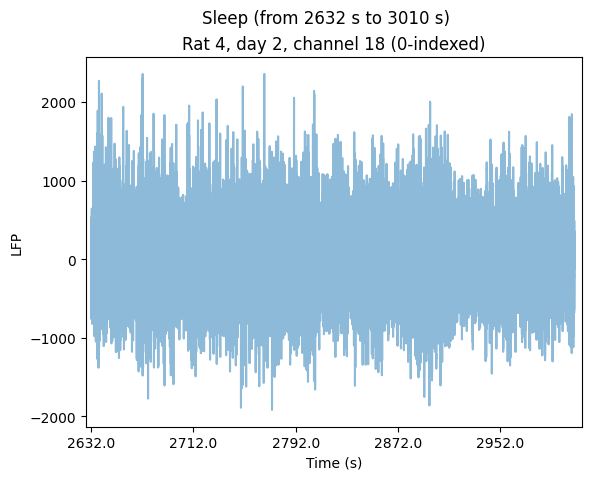

In [41]:
signal = lfp.query(f'timestamps > {nrem_timestamps[0][0]} and timestamps <= {nrem_timestamps[0][1]}').lfp.values
plt.suptitle(f'Sleep (from {nrem_timestamps[0][0]} s to {nrem_timestamps[0][1]} s)')
plt.title('Rat 4, day 2, channel 18 (0-indexed)')
plt.plot(signal,alpha=0.5)
plt.xlabel('Time (s)')
plt.ylabel('LFP')
plt.xticks(plt.xticks()[0],labels = [int(tick)/1250 + nrem_timestamps[0][0] for tick in plt.xticks()[0]])
plt.xlim(left=-5000,right=480000.0)

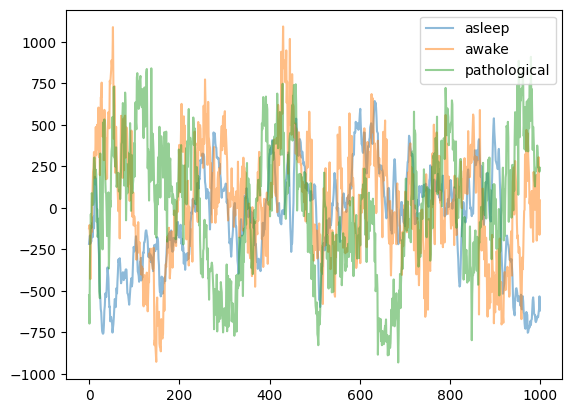

In [42]:
plt.plot(first_asleep_state.lfp.values[0:1000],label='asleep',alpha=0.5)
plt.plot(first_awake_state.lfp.values[0:1000],label='awake',alpha=0.5)
plt.plot(first_pathological_state.lfp.values[0:1000],label='pathological',alpha=0.5)
plt.legend()

In [43]:
awake_timestamps

array([[    1,    93],
       [  114,   163],
       [  182,  1019],
       [ 1045,  1343],
       [ 1405,  1715],
       [ 1768,  1933],
       [ 1958,  2023],
       [ 2048,  2299],
       [ 2326,  2578],
       [ 2608,  2631],
       [ 3011,  7279],
       [ 8336,  8815],
       [ 8971,  9011],
       [ 9240,  9402],
       [ 9543,  9556],
       [ 9576,  9806],
       [ 9832,  9903],
       [10550, 10826],
       [10844, 10852],
       [10993, 11017],
       [11152, 11175],
       [11246, 11267],
       [11537, 11788],
       [11817, 11888],
       [11909, 11909],
       [11953, 11968],
       [12058, 12104]], dtype=uint16)

In [44]:
len(lfp.query(f'timestamps > {awake_timestamps[1][0]} and timestamps <= {awake_timestamps[1][1]}'))

61250

In [45]:
awake_timestamps[1][0]

114

In [46]:
awake_timestamps[1][1]

163

In [42]:
signal = first_asleep_state.lfp.values
#signal = first_pathological_state.lfp.values

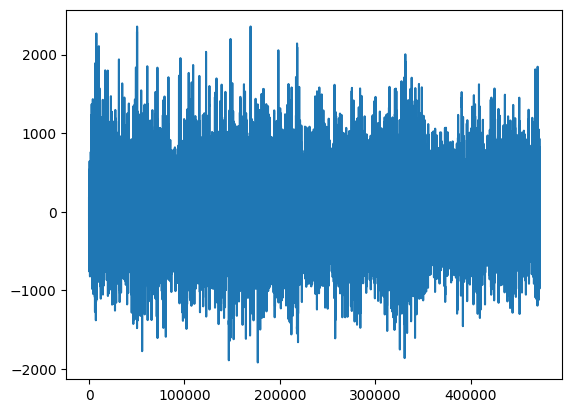

In [53]:
plt.plot(signal)

In [35]:
from scipy.signal import hilbert

sampling_rate = 1250
freqs_for_amps = np.arange(30,202,2)
freqs_for_phases = np.arange(1,20.25,.25)

filtered_phases = np.empty([len(freqs_for_phases) - 1,len(signal)])

for phase_index,phase in enumerate(freqs_for_phases[0:-1]):
  filtered_phases[phase_index,:] = np.angle(hilbert(band_extraction(signal,cutoff_low=freqs_for_phases[phase_index],cutoff_high=freqs_for_phases[phase_index+1],
                                            sampling_rate=sampling_rate)))

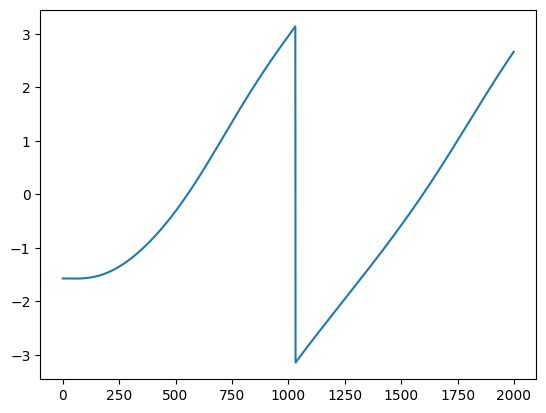

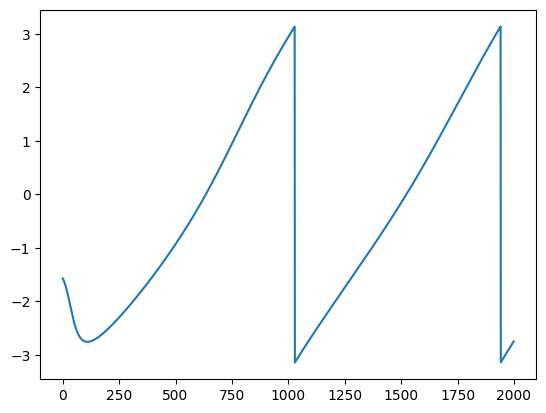

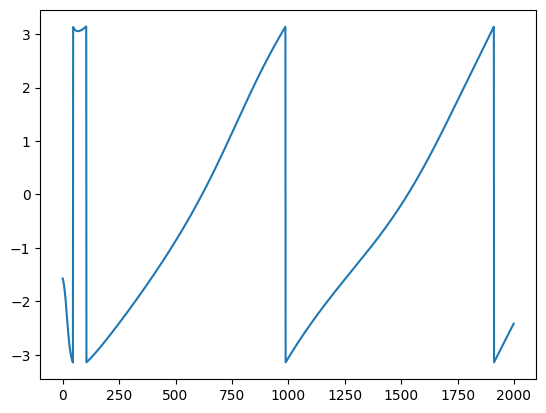

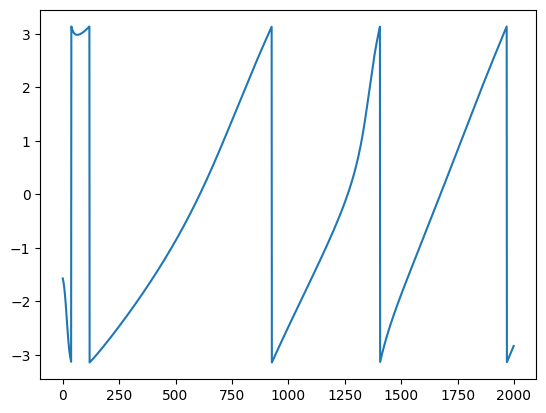

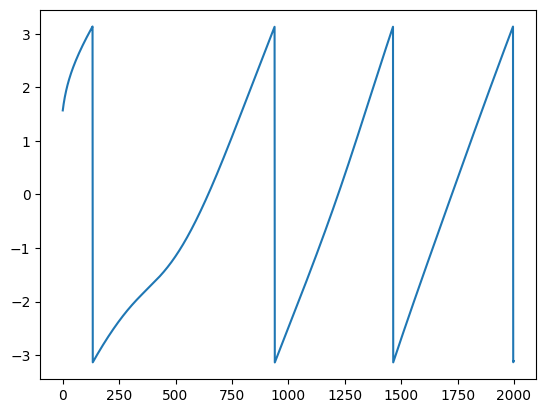

...

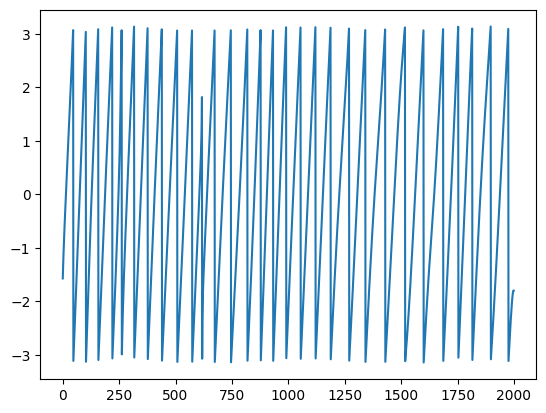

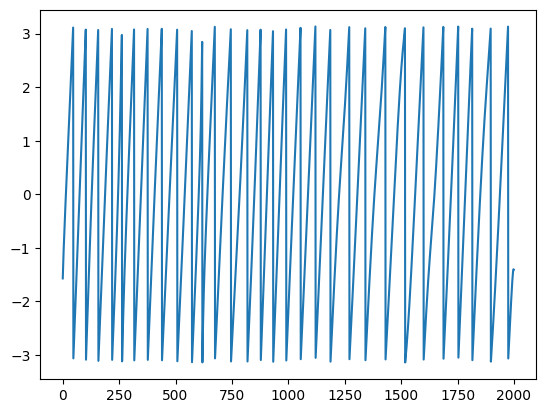

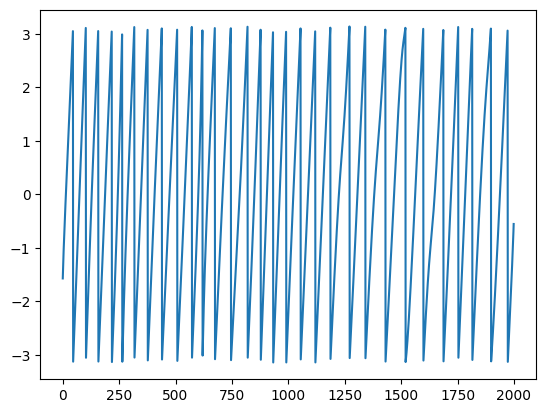

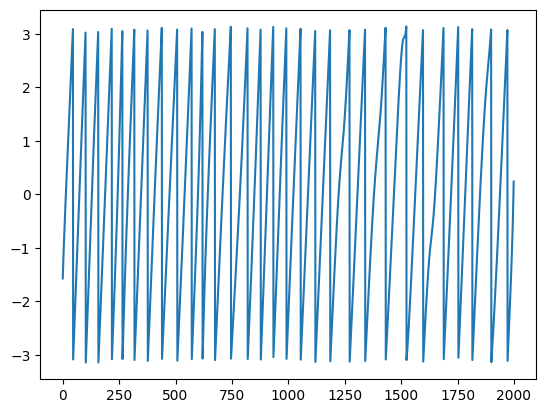

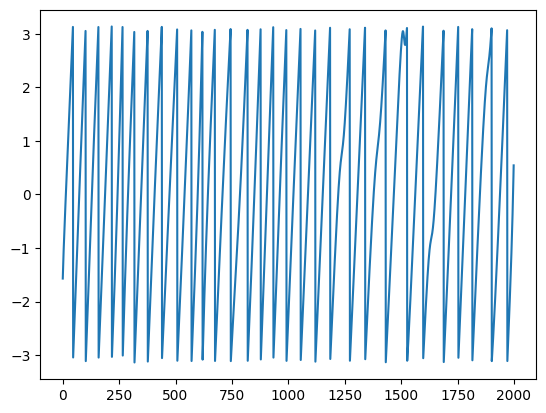

In [38]:
for phase_band in filtered_phases:
  plt.plot(phase_band[0:2000])
  plt.show()

In [ ]:
200_000/1250

160.0

In [ ]:
signal = first_pathological_state.lfp.values[0:200_000]

In [ ]:
20_000/1250

16.0

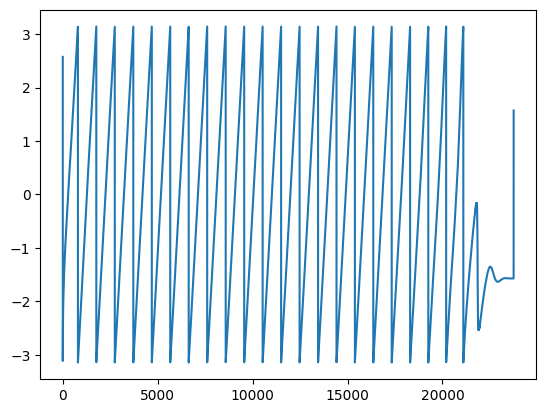

In [ ]:
phase_band_1 = np.angle(hilbert(band_extraction(signal,cutoff_low=1.25,cutoff_high=1.5,
                                            sampling_rate=1250)))
plt.plot(phase_band_1)

In [ ]:
signal = clean_cfc_signal

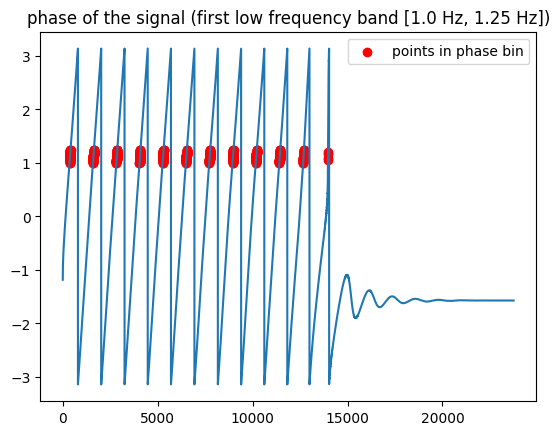

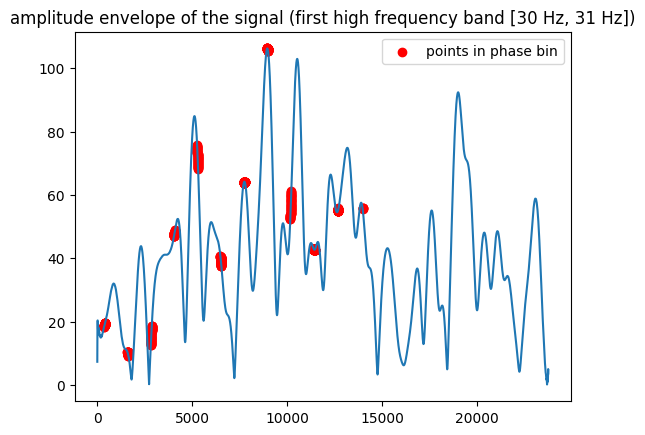

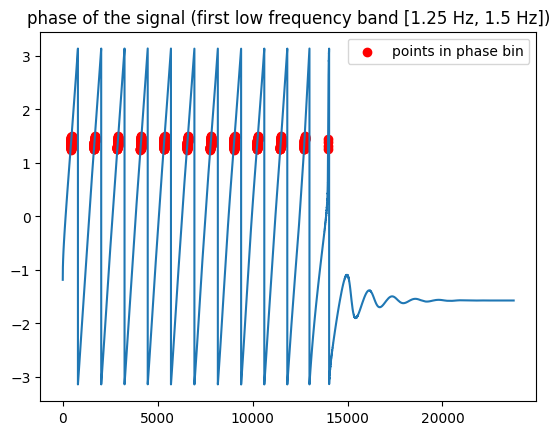

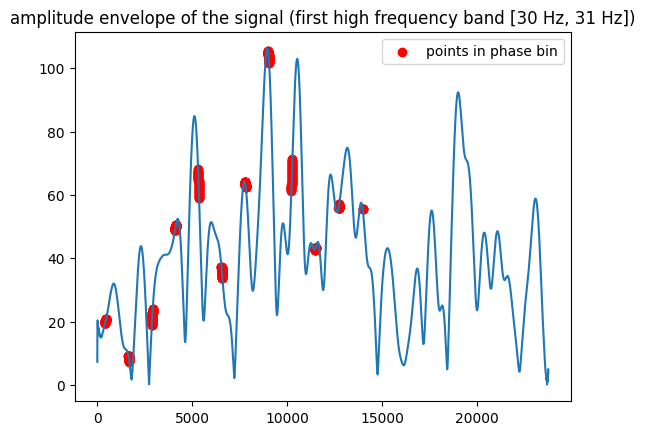

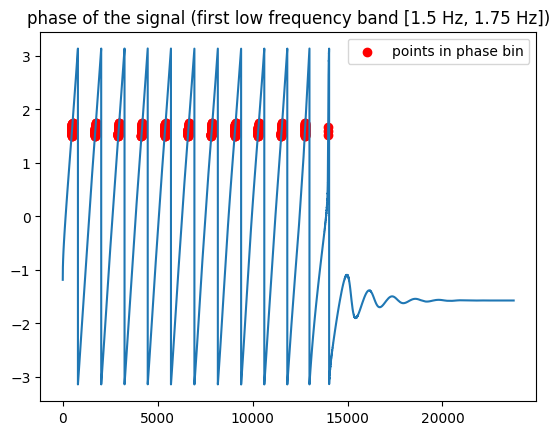

...

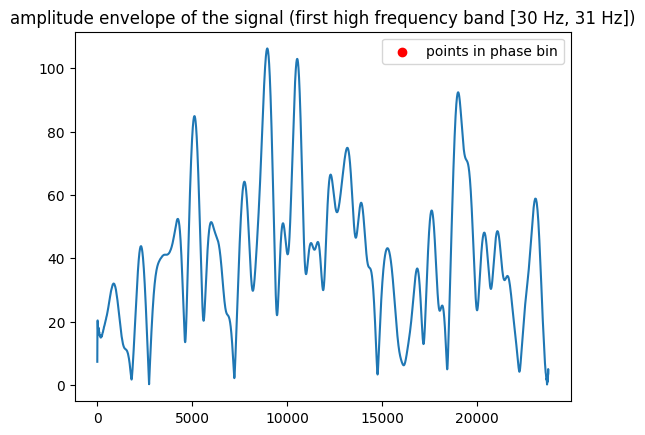

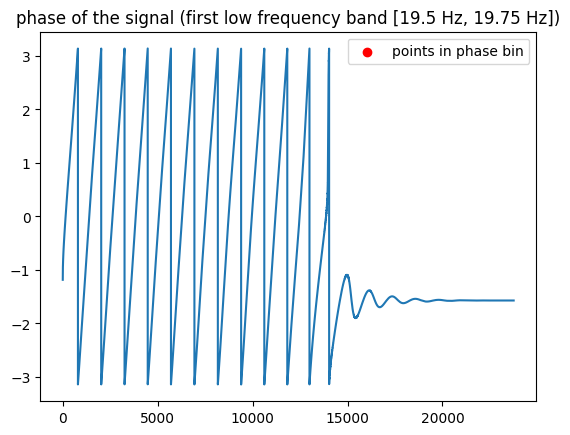

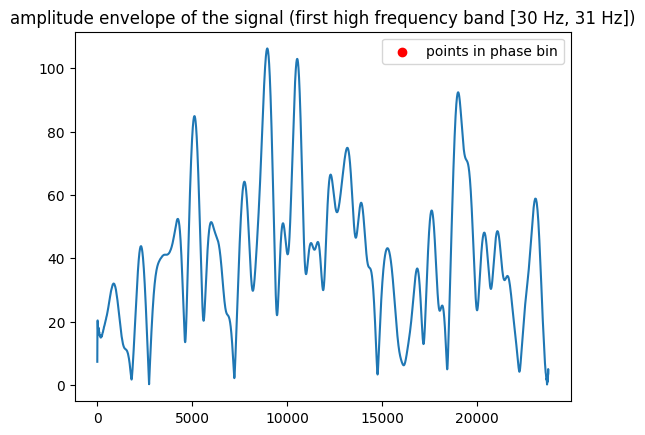

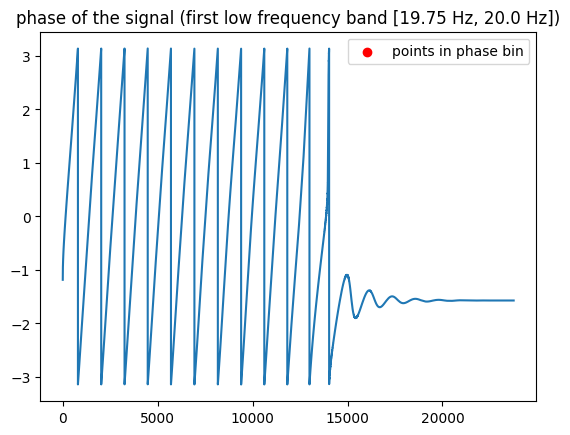

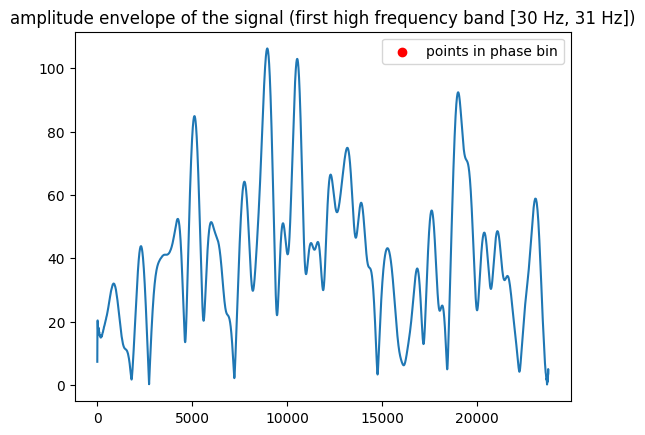

SyntaxError: ignored

In [ ]:
'''this piece of code right here displays a problem: notice that after 3-3.25 Hz in the modulating band it does not color any more points (plots below).

the error: searching the points that fall within the limits of the bandpass filter, not within [-pi,pi]. dumb of me.'''

sampling_rate = 1250
filtered_phases = np.empty([len(freqs_for_phases) - 1,len(signal)])

from scipy.signal import hilbert

for phase_index,phase in enumerate(freqs_for_phases[0:-1]):
  filtered_phases[phase_index,:] = np.angle(hilbert(band_extraction(signal,cutoff_low=freqs_for_phases[phase_index],cutoff_high=freqs_for_phases[phase_index+1],
                                            sampling_rate=sampling_rate)))

comod = np.zeros([len(freqs_for_amps) - 1, len(freqs_for_phases)])

for amp_index,current_amp in enumerate(freqs_for_amps[0:-1]):
  amp_envelope = abs(hilbert(band_extraction(signal,cutoff_low=freqs_for_amps[amp_index],cutoff_high=freqs_for_amps[amp_index+1],
                                                   sampling_rate=sampling_rate)))

  num_bins = 50
  phasebins = np.linspace(-np.pi,np.pi,num_bins+1)
  phasecenters = phasebins[0:-1] + (phasebins[1] - phasebins[0])

  for index in range(len(freqs_for_phases)-1):
    indexes_in_phase_band = np.where((filtered_phases[0,:] > freqs_for_phases[index])*(filtered_phases[0,:] < freqs_for_phases[index+1]) == True)[0]
    plt.plot(filtered_phases[0,:])
    plt.title(f'phase of the signal (first low frequency band [{freqs_for_phases[index]} Hz, {freqs_for_phases[index+1]} Hz])')
    plt.scatter(indexes_in_phase_band,filtered_phases[0,indexes_in_phase_band],color='red',label='points in phase bin')
    plt.legend()
    plt.show()

    plt.plot(amp_envelope)
    plt.title(f'amplitude envelope of the signal (first high frequency band [{freqs_for_amps[amp_index]} Hz, {freqs_for_amps[amp_index]+1} Hz])')
    plt.scatter(indexes_in_phase_band,amp_envelope[indexes_in_phase_band],color='red',label='points in phase bin')
    plt.legend()
    plt.show()

    amps_in_phase_cycles = amp_envelope[indexes_in_phase_band]

  break
break
#    comod[index,amp_index] = MI

In [ ]:
plt.figure(figsize=(15,12))
i = 3
j = 20
plt.plot(filtered_phases[i][0:10000],label=f'[{freqs_for_phases[i]} Hz, {freqs_for_phases[i+1]} Hz]',linestyle='-.')
plt.plot(filtered_phases[j][0:10000],label=f'[{freqs_for_phases[j]} Hz, {freqs_for_phases[j+1]} Hz]',linestyle='dotted')
plt.legend()
plt.title('Different phase bands of the same LFP signal')
plt.show()

NameError: ignored

-3.141592653589793 -3.015928947446201


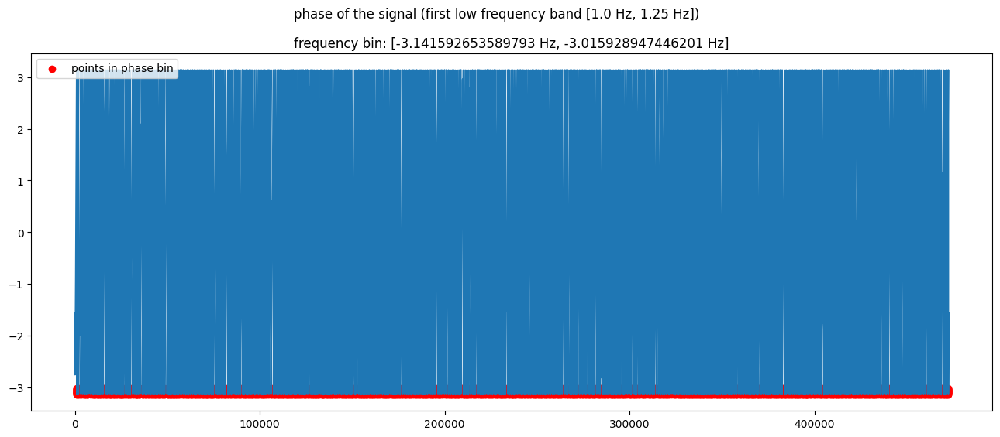

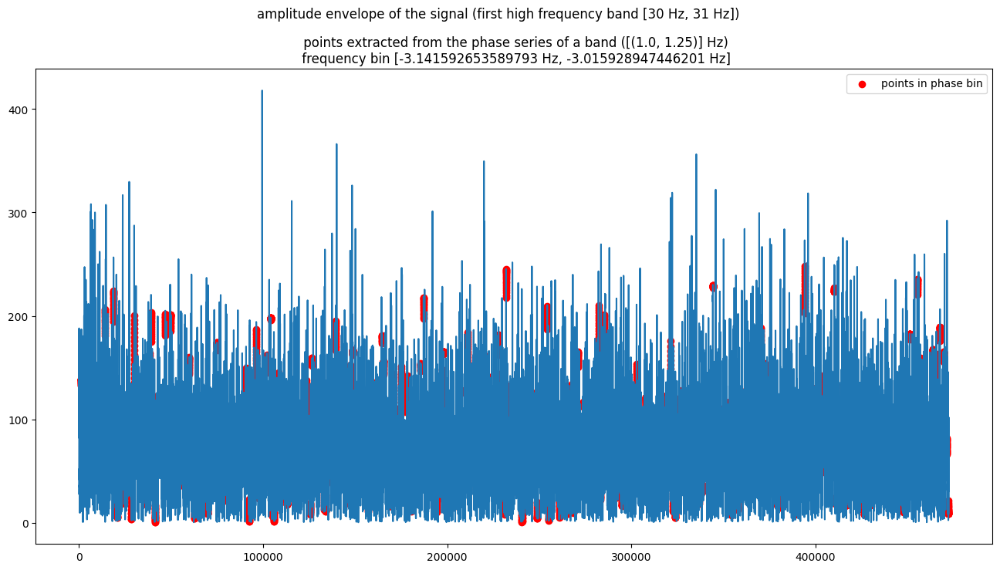

-3.015928947446201 -2.8902652413026098


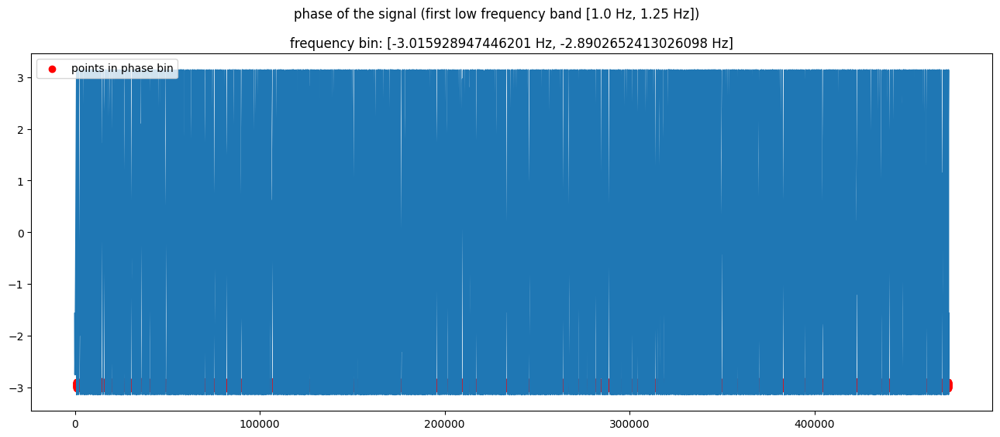

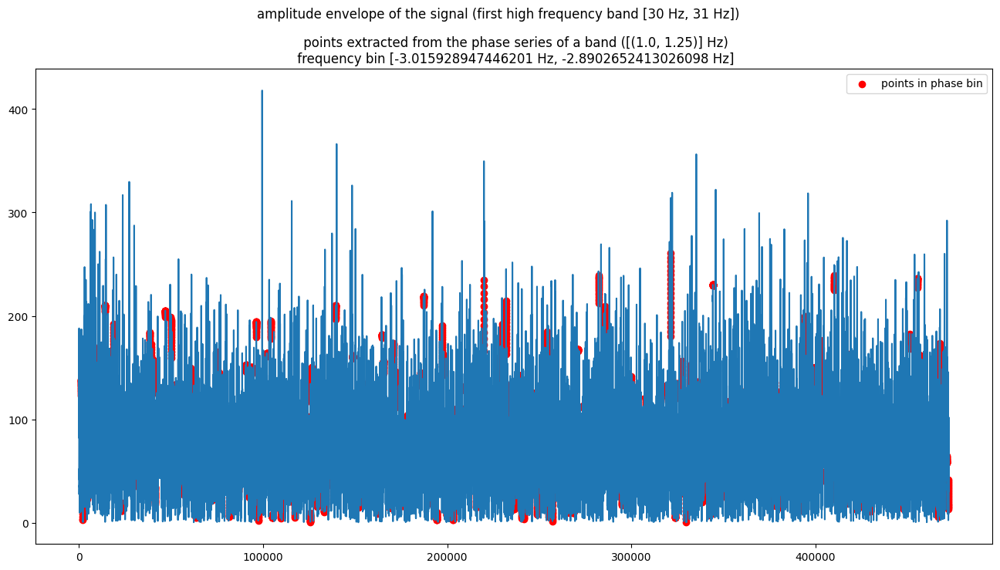

-2.8902652413026098 -2.764601535159018


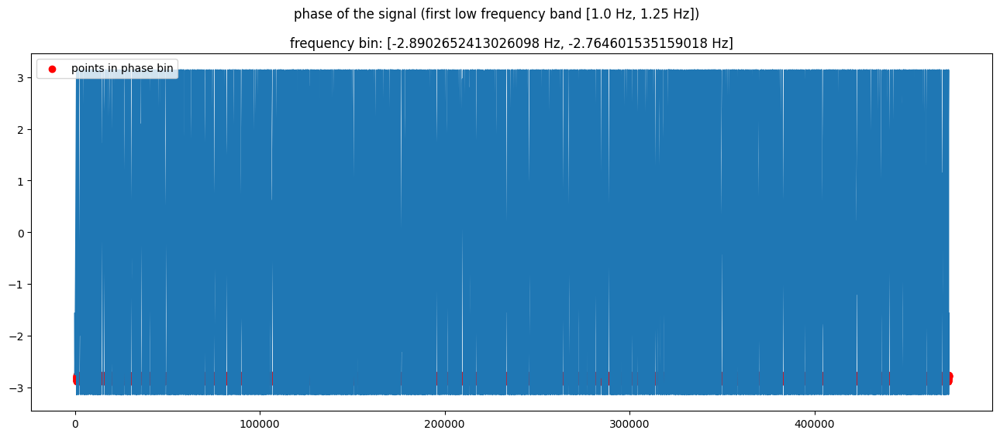

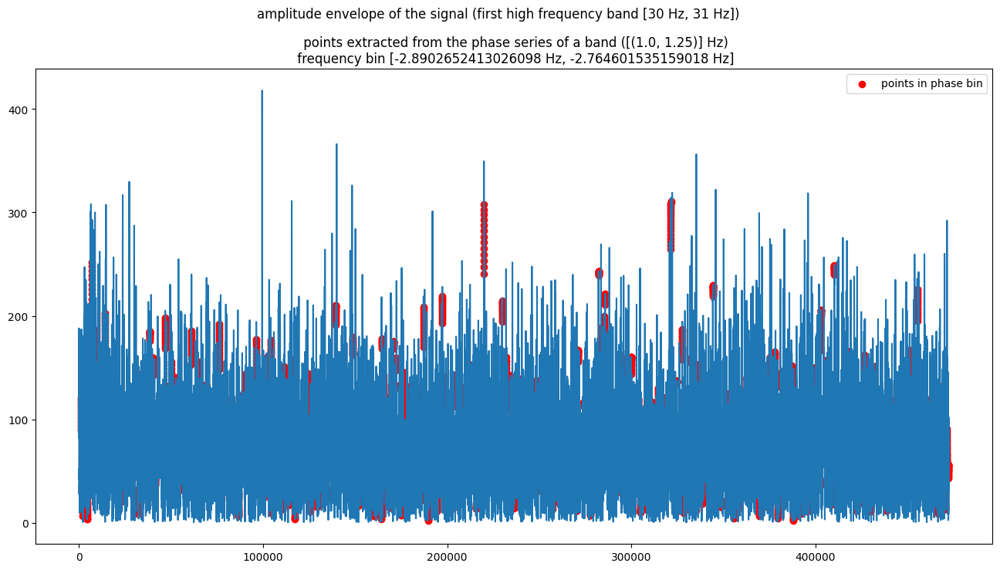

-2.764601535159018 -2.6389378290154264


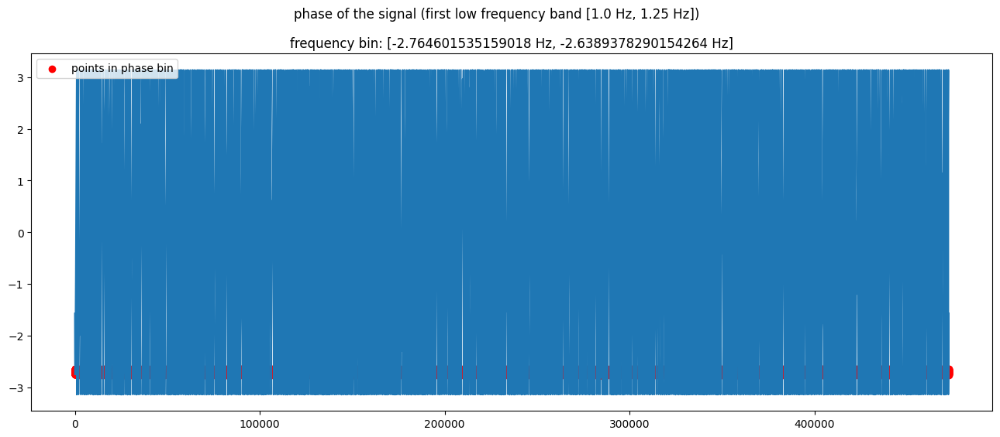

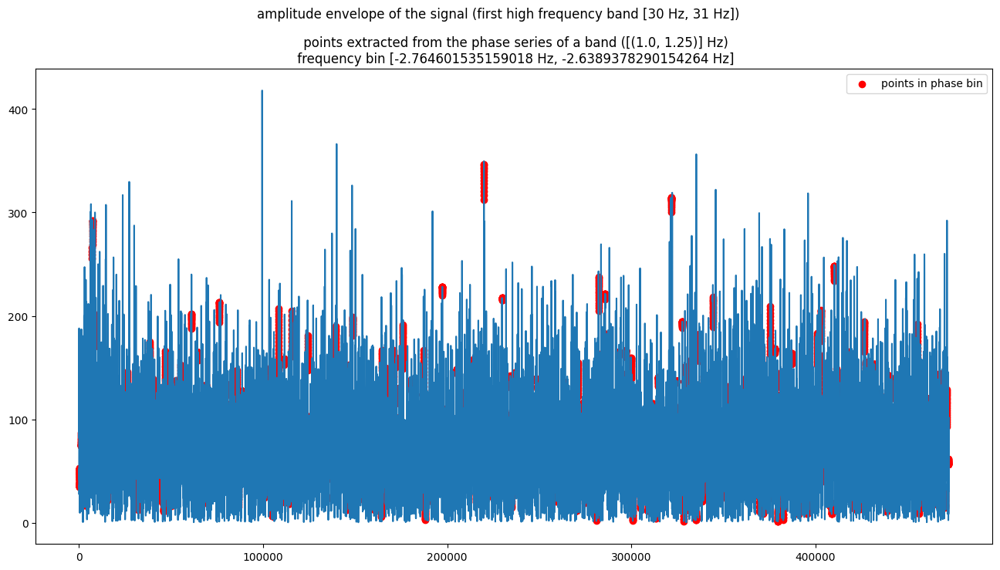

-2.6389378290154264 -2.5132741228718345


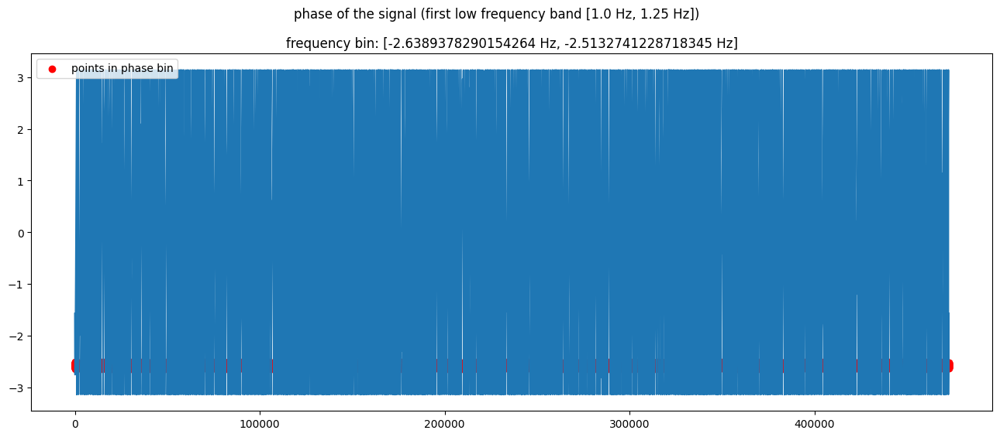

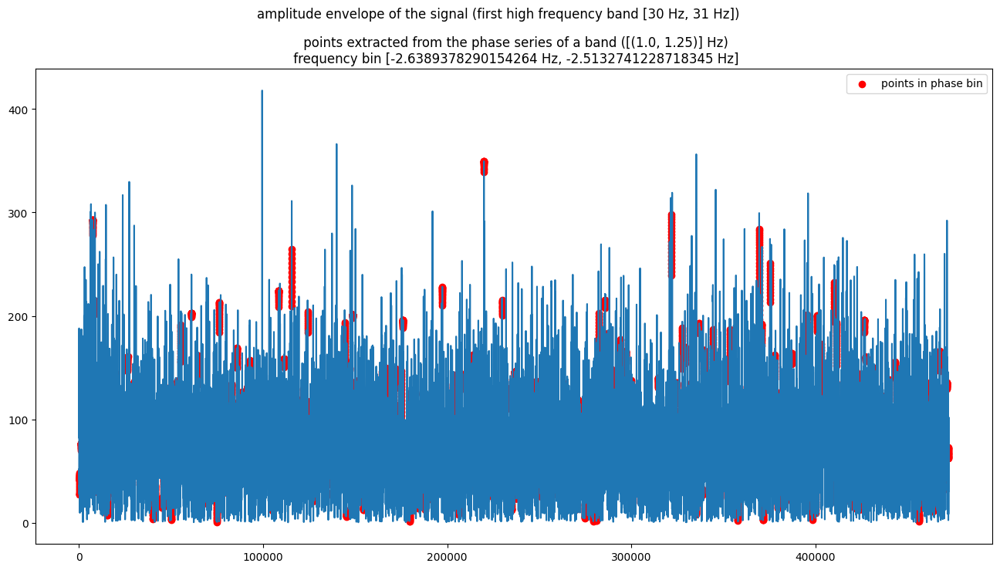

-2.5132741228718345 -2.3876104167282426


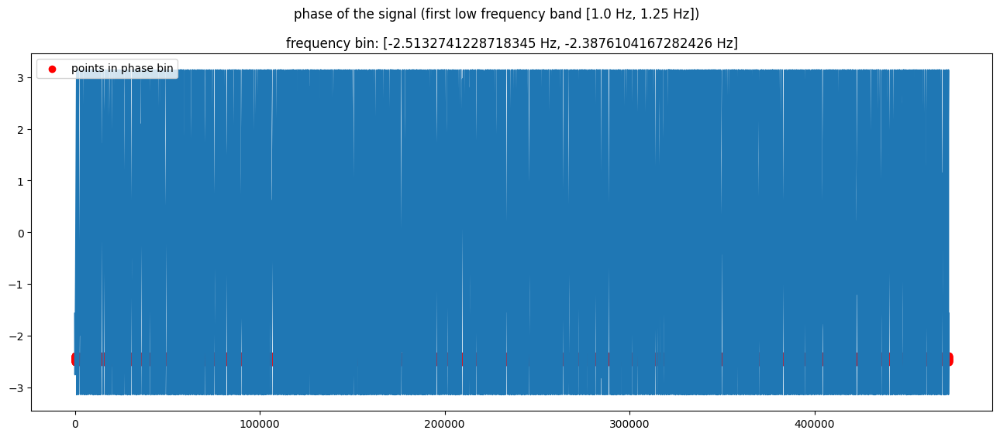

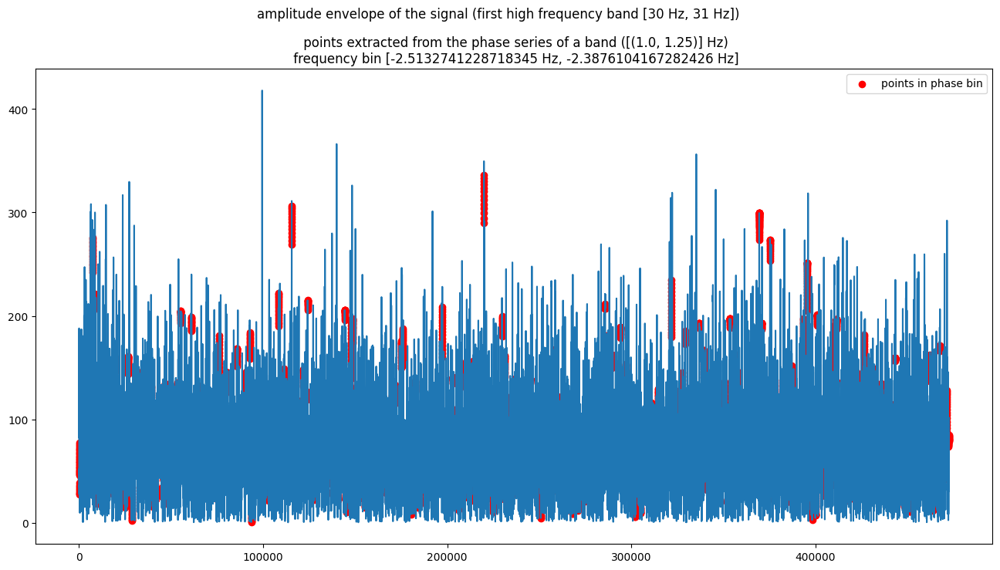

-2.3876104167282426 -2.2619467105846507


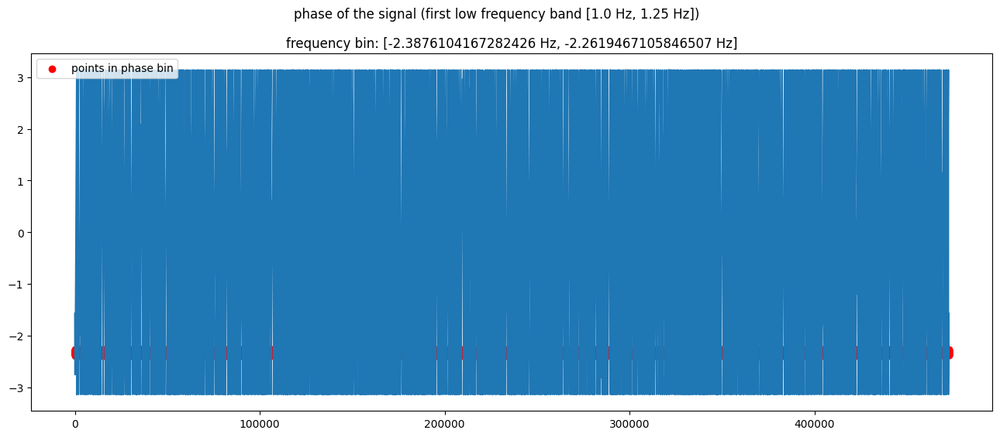

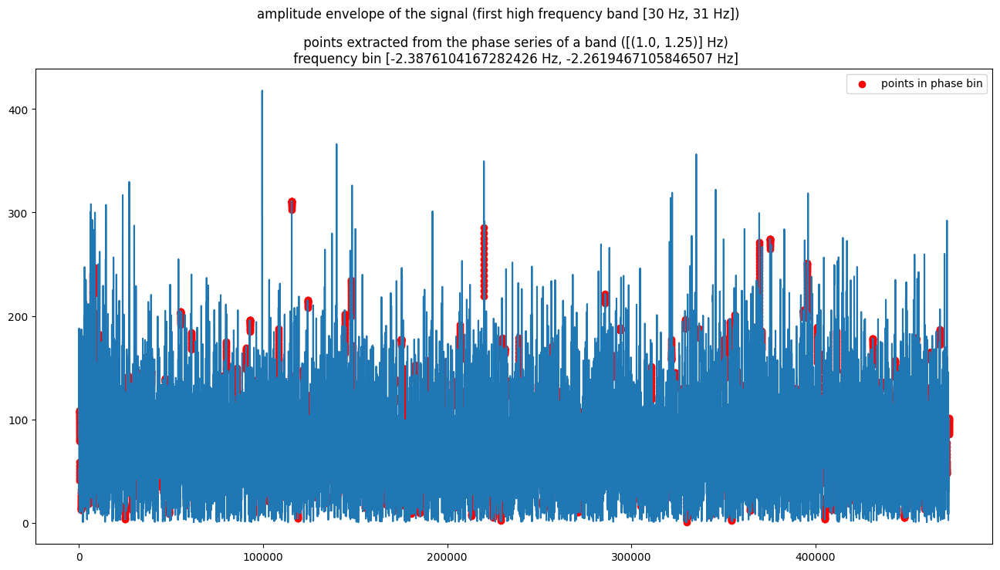

-2.2619467105846507 -2.1362830044410592


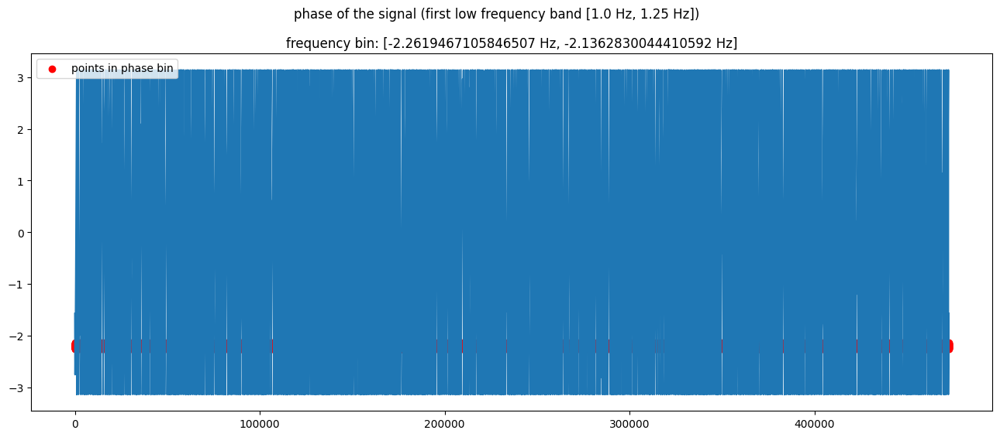

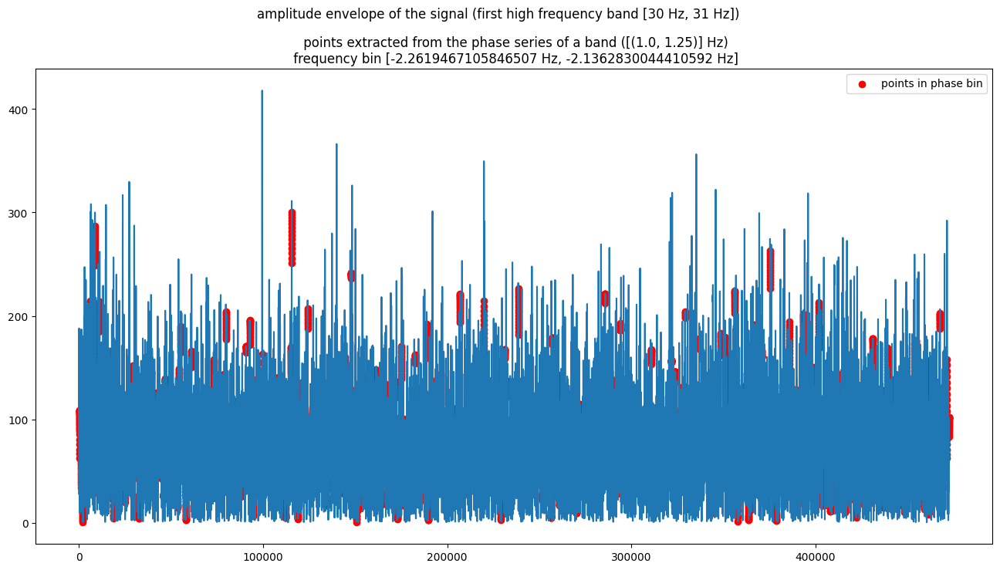

-2.1362830044410592 -2.0106192982974678


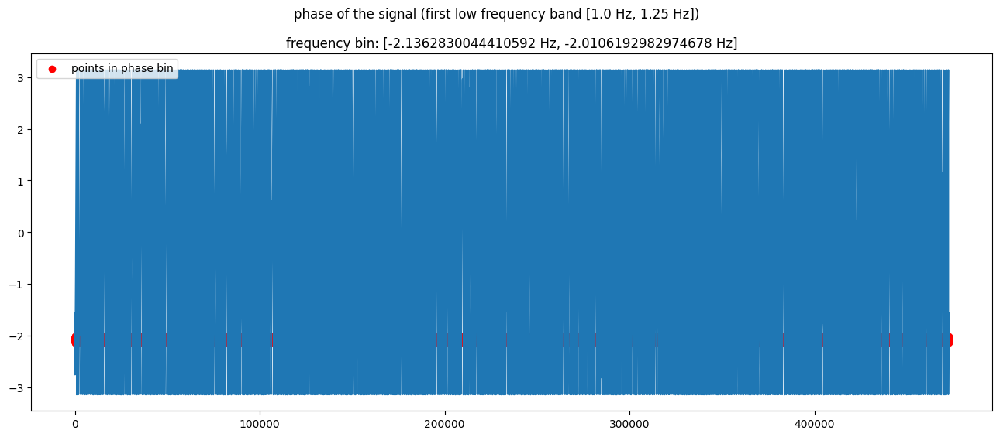

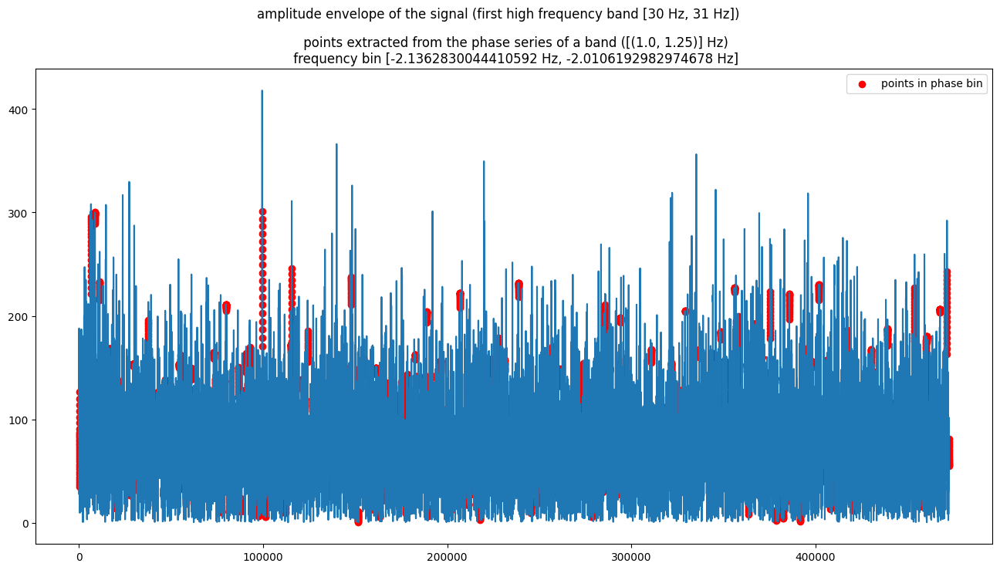

-2.0106192982974678 -1.8849555921538759


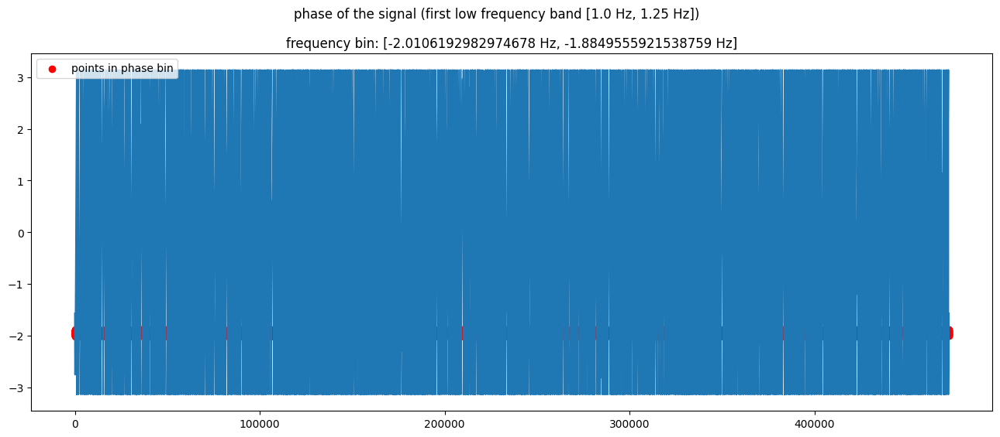

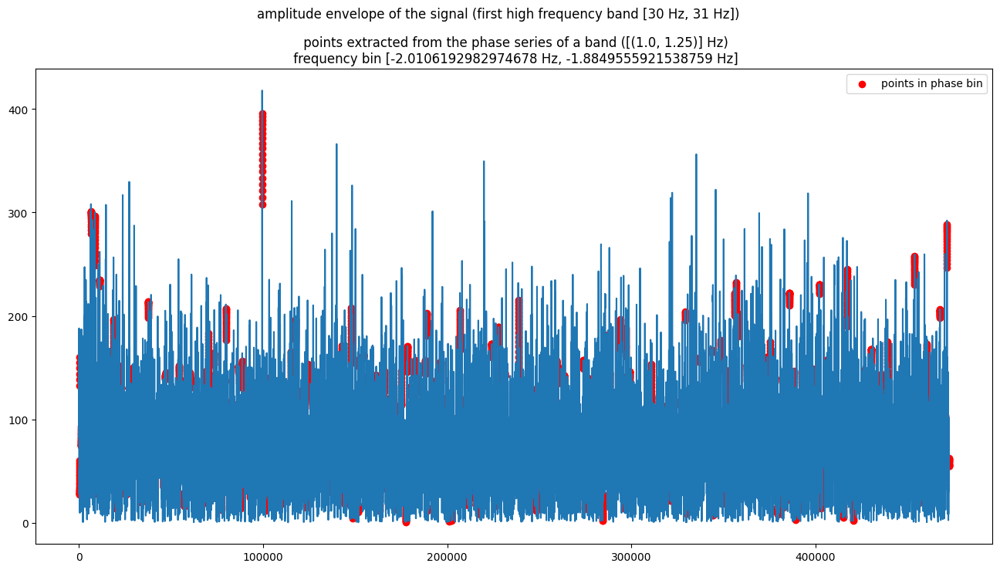

-1.8849555921538759 -1.759291886010284


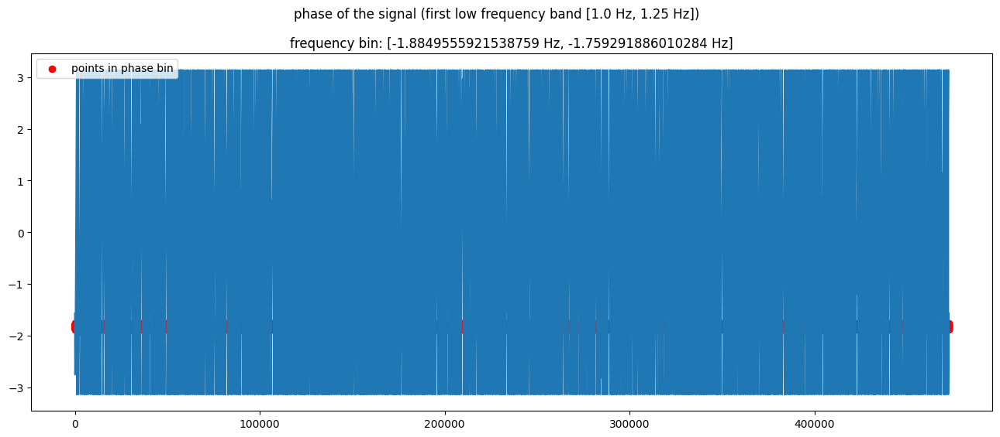

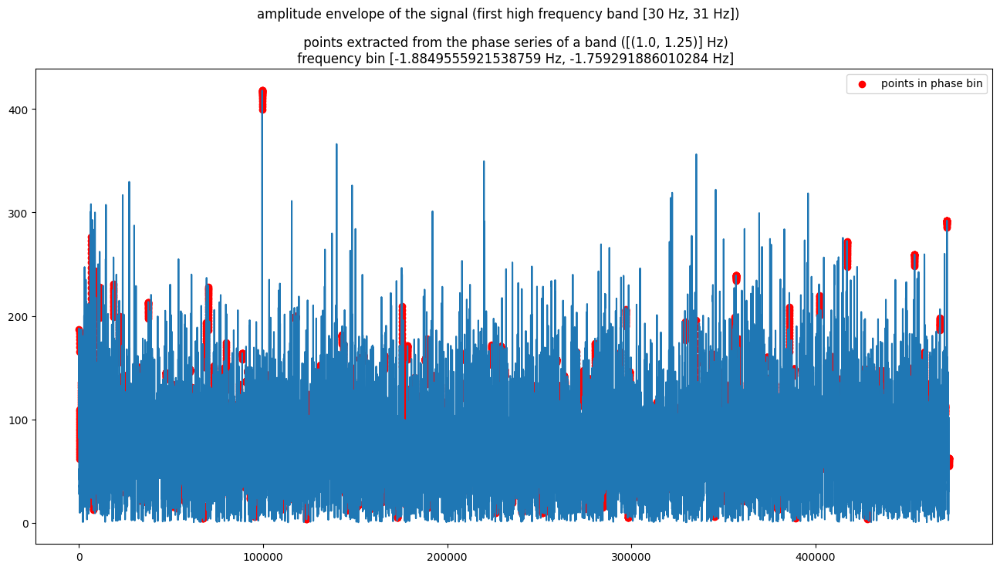

-1.759291886010284 -1.6336281798666923


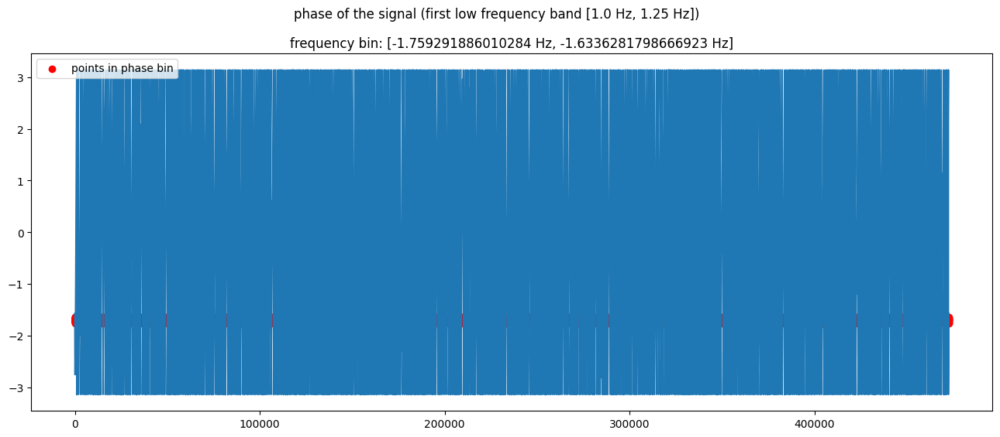

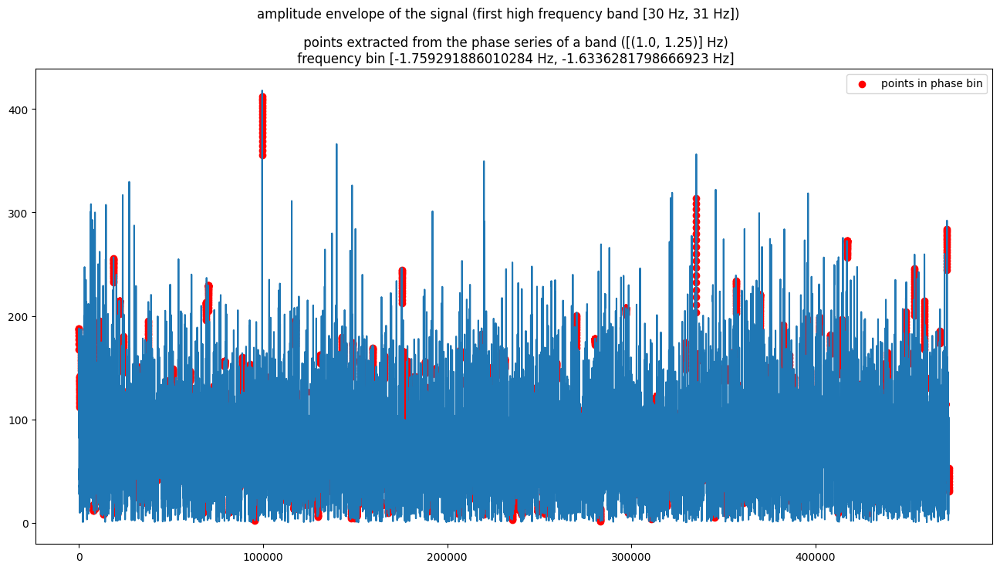

-1.6336281798666923 -1.5079644737231006


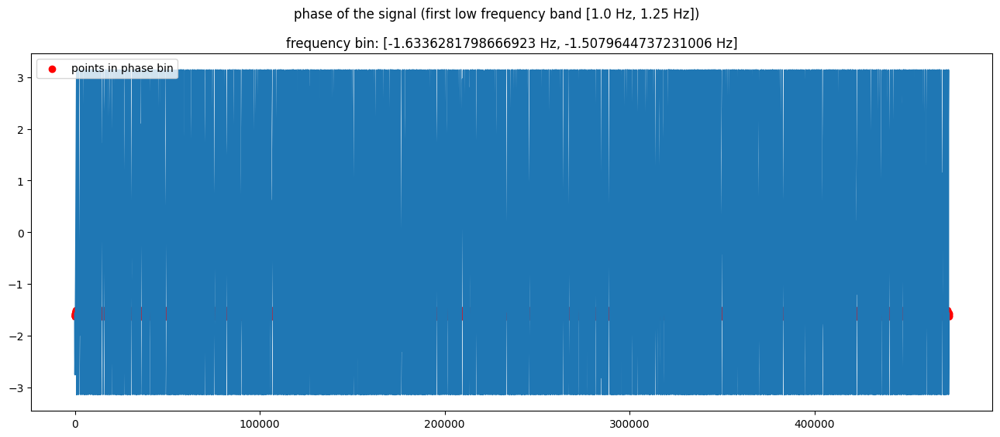

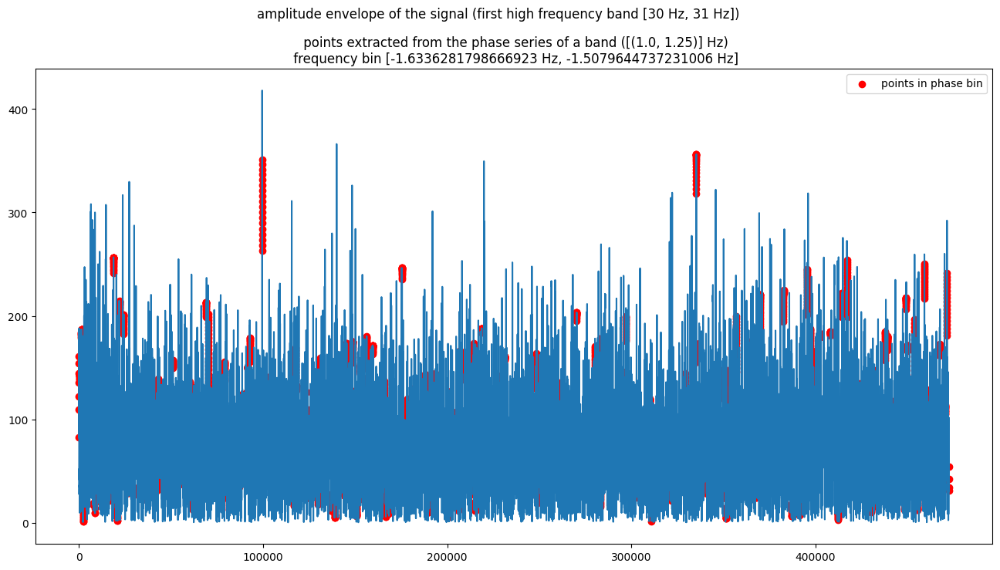

-1.5079644737231006 -1.3823007675795087


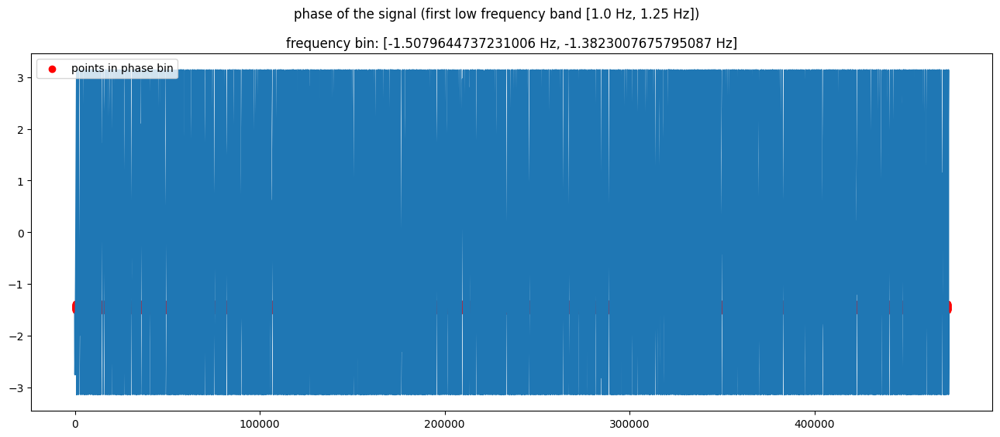

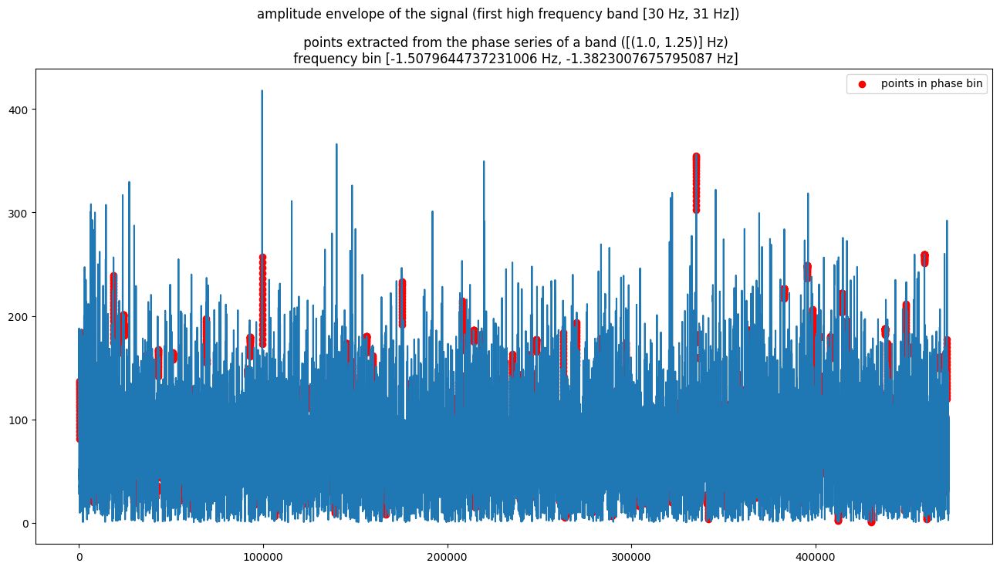

-1.3823007675795087 -1.256637061435917


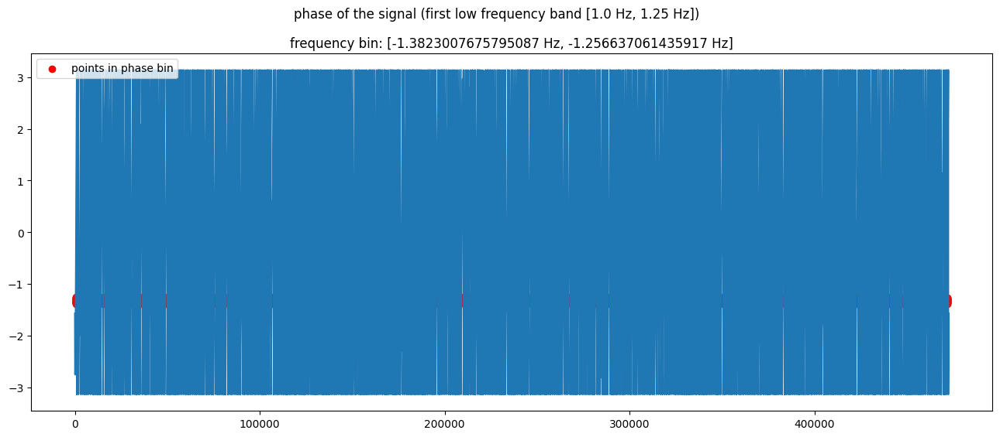

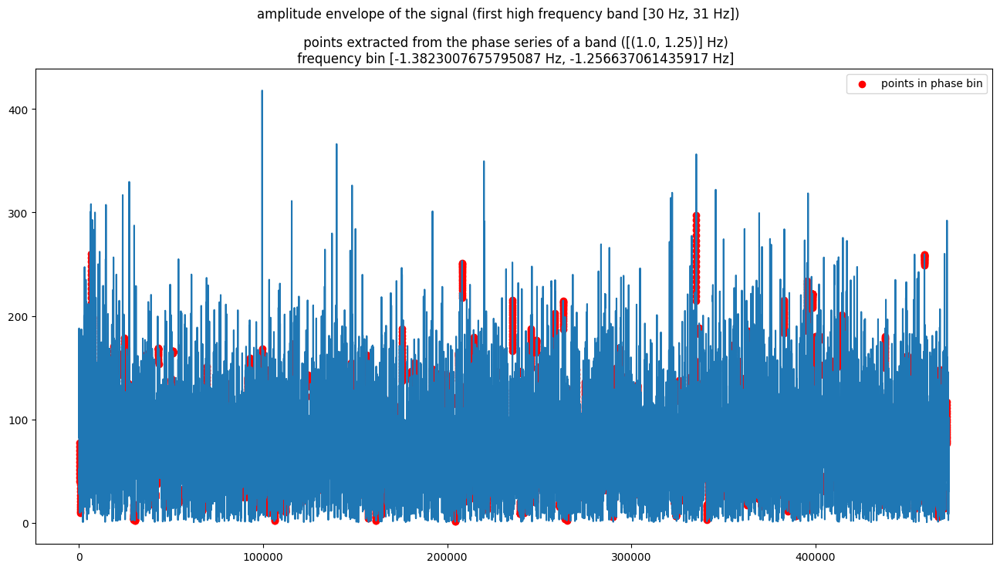

-1.256637061435917 -1.1309733552923253


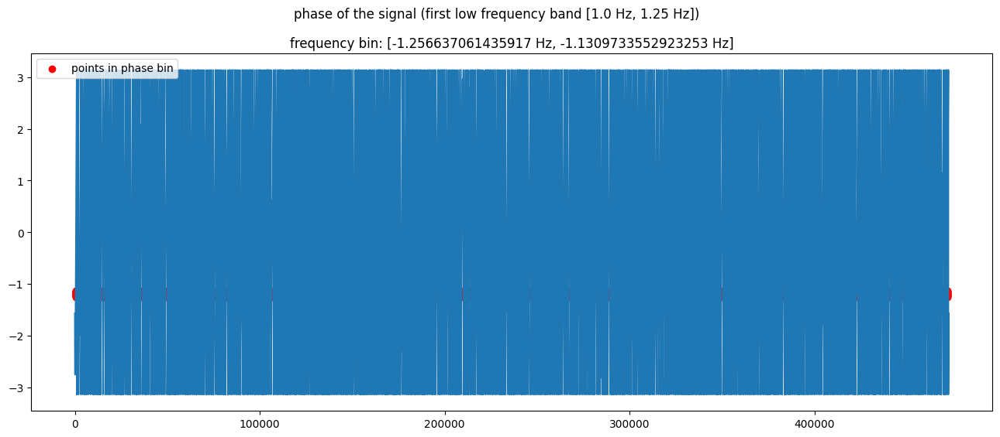

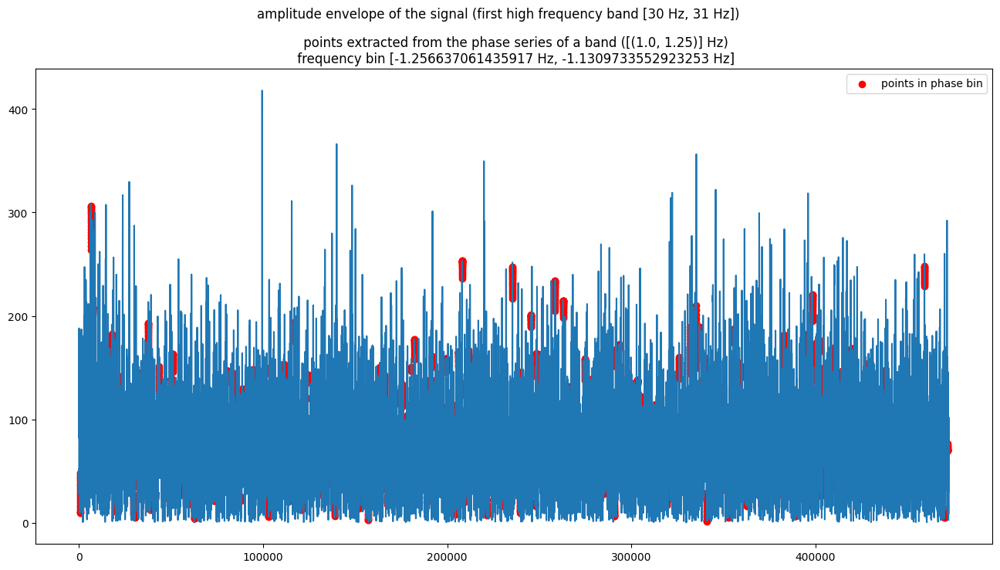

-1.1309733552923253 -1.0053096491487334


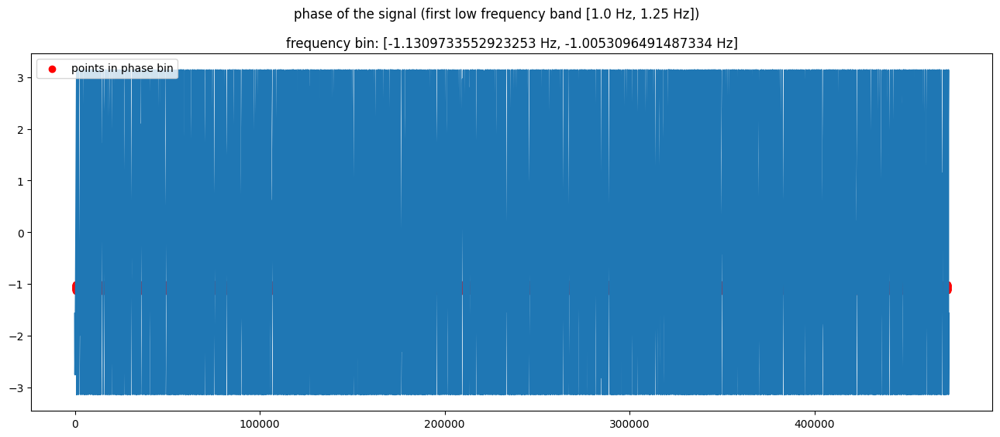

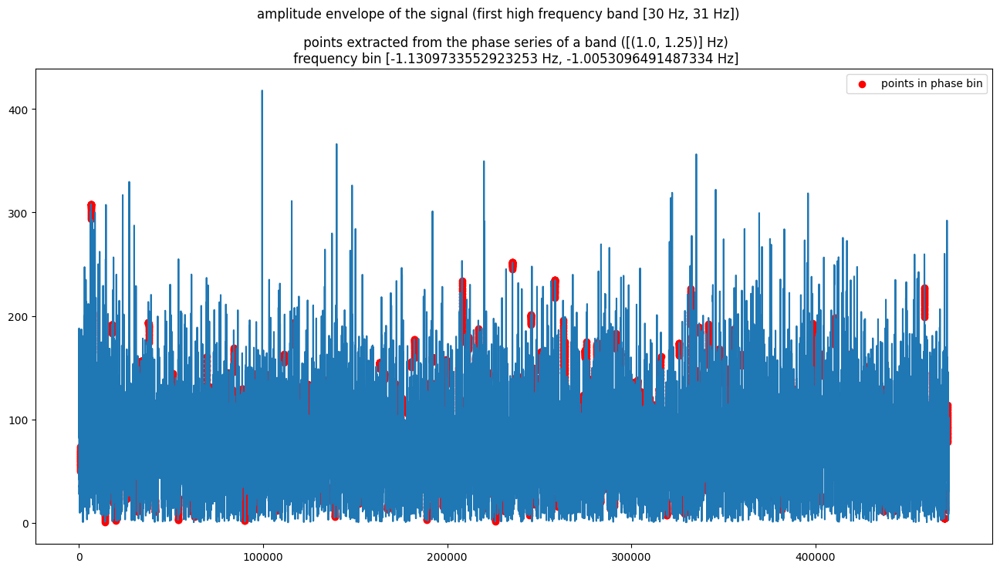

-1.0053096491487334 -0.879645943005142


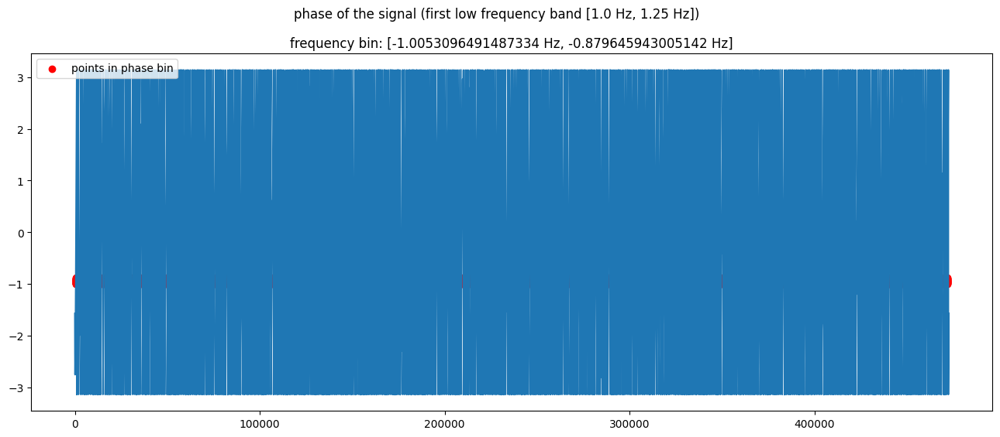

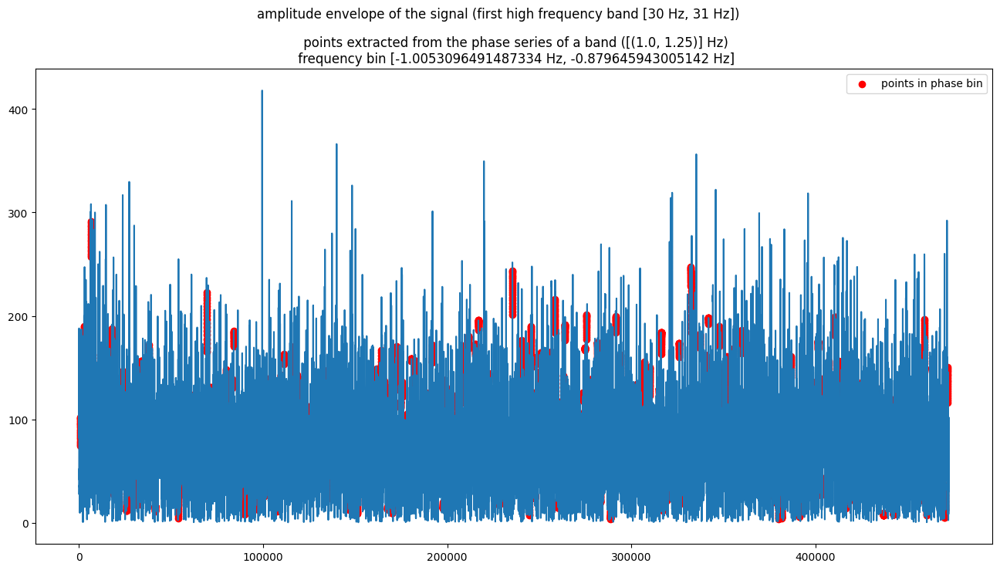

-0.879645943005142 -0.7539822368615501


KeyboardInterrupt: ignored

In [39]:
'''do not run this one until completion, but a few iterations should suffice to give you an idea of its workings:
we are selecting the right points from the phase series at each iteration'''

sampling_rate = 1250
filtered_phases = np.empty([len(freqs_for_phases) - 1,len(signal)])

from scipy.signal import hilbert

for phase_index,phase in enumerate(freqs_for_phases[0:-1]):
  filtered_phases[phase_index,:] = np.angle(hilbert(band_extraction(signal,cutoff_low=freqs_for_phases[phase_index],cutoff_high=freqs_for_phases[phase_index+1],
                                            sampling_rate=sampling_rate)))

comod = np.zeros([len(freqs_for_amps) - 1, len(freqs_for_phases)])


num_bins = 50
phasebins = np.linspace(-np.pi,np.pi,num_bins+1)
phasecenters = phasebins[0:-1] + (phasebins[1] - phasebins[0])

#iterate over signals filtered at higher frequencies (each band for which we extract the amplitude envelope)
for amp_index,current_amp in enumerate(freqs_for_amps[0:-1]):
  amp_envelope = abs(hilbert(band_extraction(signal,cutoff_low=freqs_for_amps[amp_index],cutoff_high=freqs_for_amps[amp_index+1],
                                                   sampling_rate=sampling_rate)))

  for phase_bin_id in range(len(phasebins)-1):
    print(phasebins[phase_bin_id],phasebins[phase_bin_id+1])
    #indexes_in_phase_band = np.where((filtered_phases[0,:] > phasebins[phase_bin_id]) & (filtered_phases[0,:] < freqs_for_phases[phase_bin_id+1]) == True)[0]
    phases_vector = filtered_phases[1,:]
    indexes_in_phase_band = np.where((phases_vector > phasebins[phase_bin_id]) & (phases_vector < phasebins[phase_bin_id+1]))[0]
    plt.figure(figsize=(16,6))
    plt.plot(filtered_phases[1,:])
    plt.suptitle(f'phase of the signal (first low frequency band [{freqs_for_phases[0]} Hz, {freqs_for_phases[1]} Hz])')
    plt.title(f'frequency bin: [{phasebins[phase_bin_id]} Hz, {phasebins[phase_bin_id+1]} Hz]')
    plt.scatter(indexes_in_phase_band,filtered_phases[1,indexes_in_phase_band],color='red',label='points in phase bin')
    plt.legend()
    plt.show()

    plt.figure(figsize=(16,8))
    plt.plot(amp_envelope)
    plt.suptitle(f'amplitude envelope of the signal (first high frequency band [{freqs_for_amps[amp_index]} Hz, {freqs_for_amps[amp_index]+1} Hz])')
    plt.title(f'\n points extracted from the phase series of a band ([{freqs_for_phases[0],freqs_for_phases[1]}] Hz)\n frequency bin [{phasebins[phase_bin_id]} Hz, {phasebins[phase_bin_id+1]} Hz]')
    plt.scatter(indexes_in_phase_band,amp_envelope[indexes_in_phase_band],color='red',label='points in phase bin')
    plt.legend()
    plt.show()

continue

In [43]:
'''
comodulogram building
'''

freqs_for_amps = np.arange(30,202,2)
freqs_for_phases = np.arange(1,20.25,.25)

sampling_rate = 1250
filtered_phases = np.empty([len(freqs_for_phases) - 1,len(signal)])

from scipy.signal import hilbert

for phase_index,phase in enumerate(freqs_for_phases[0:-1]):
  filtered_phases[phase_index,:] = np.angle(hilbert(band_extraction(signal,cutoff_low=freqs_for_phases[phase_index],cutoff_high=freqs_for_phases[phase_index+1],
                                            sampling_rate=sampling_rate)))

comod = np.zeros([len(freqs_for_amps) - 1, len(freqs_for_phases)])


num_bins = 50
phasebins = np.linspace(-np.pi,np.pi,num_bins+1)
phasecenters = phasebins[0:-1] + (phasebins[1] - phasebins[0])

#iterate over signals filtered at higher frequencies (each band for which we extract the amplitude envelope)
for amp_index,current_amp in enumerate(freqs_for_amps[:-1]):
  print(f'new amp: [{amp_index}/{len(freqs_for_amps)-1}]')
  amp_envelope = abs(hilbert(band_extraction(signal,cutoff_low=freqs_for_amps[amp_index],cutoff_high=freqs_for_amps[amp_index+1],
                                                   sampling_rate=sampling_rate)))

  '''
  to exploit the storage vs. processing conundrum, I have already filtered the signal in each low-frequency band of interest
  and put each band's signal in a vector (filtered_phases, 76 bands in total).
  once again I have opted for such an approach and below I create a vector called bins_freq,
  that will store each frequency bin's (from [-pi,pi]) mean amplitude in a single modulated band (from which we extract the amplitude envelope)
  '''

  bins_freq = np.empty((num_bins,len(filtered_phases)))

  for phase_bin_id in range(len(phasebins)-1):
    #print(phase_bin_id)
    #print(phasebins[phase_bin_id],phasebins[phase_bin_id+1])

    for band_id,band_signal in enumerate(filtered_phases):
      phasepoints_in_frequency_bin = np.where((band_signal > phasebins[phase_bin_id]) & (band_signal < phasebins[phase_bin_id+1]))[0]
      mean_amplitude_in_frequency_bin = np.mean(amp_envelope[phasepoints_in_frequency_bin])
      #print(mean_amplitude_in_frequency_bin)
      bins_freq[phase_bin_id,band_id] = mean_amplitude_in_frequency_bin

    #print(f'estimated mean amplitude in bin {phase_bin_id} [{phasebins[phase_bin_id]} Hz, {phasebins[phase_bin_id+1]} Hz] in all modulating bands!')
    #print(sum(bins_freq[:,band_id]))
  print(f'finished all frequency bins for all modulating bands in this modulated band: [{freqs_for_amps[amp_index]} Hz,{freqs_for_amps[amp_index+1]} Hz]')
  #normalize over each phase bin, yielding what is dubbed p
  p = [bins_freq[:,band_id]/sum(bins_freq[:,band_id]) for band_id in range(len(filtered_phases))]

  #estimate MI
  from scipy.stats import entropy
  uniform_dist = np.ones(num_bins)/num_bins

  #iterating over all low-frequency filtered bands:
  for low_freq_band_index in range(np.shape(p)[0]):
    MI = entropy(p[low_freq_band_index],uniform_dist)/np.log(num_bins)
    comod[amp_index,low_freq_band_index] = MI

new amp: [0/85]
finished all frequency bins for all modulating bands in this modulated band: [30 Hz,32 Hz]
new amp: [1/85]
finished all frequency bins for all modulating bands in this modulated band: [32 Hz,34 Hz]
new amp: [2/85]
finished all frequency bins for all modulating bands in this modulated band: [34 Hz,36 Hz]
new amp: [3/85]
finished all frequency bins for all modulating bands in this modulated band: [36 Hz,38 Hz]
new amp: [4/85]
finished all frequency bins for all modulating bands in this modulated band: [38 Hz,40 Hz]
new amp: [5/85]
finished all frequency bins for all modulating bands in this modulated band: [40 Hz,42 Hz]
new amp: [6/85]
finished all frequency bins for all modulating bands in this modulated band: [42 Hz,44 Hz]
new amp: [7/85]
finished all frequency bins for all modulating bands in this modulated band: [44 Hz,46 Hz]
new amp: [8/85]
finished all frequency bins for all modulating bands in this modulated band: [46 Hz,48 Hz]
new amp: [9/85]
finished all frequenc

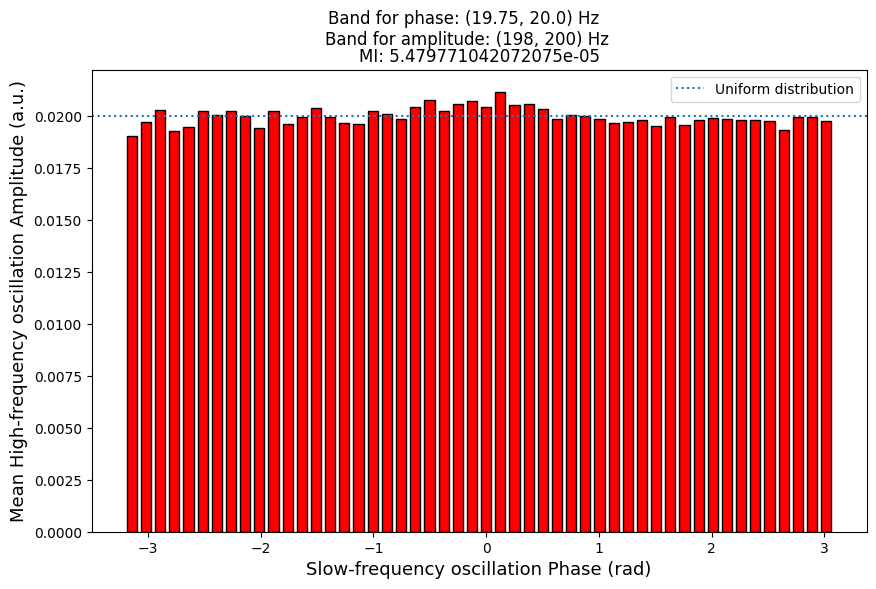

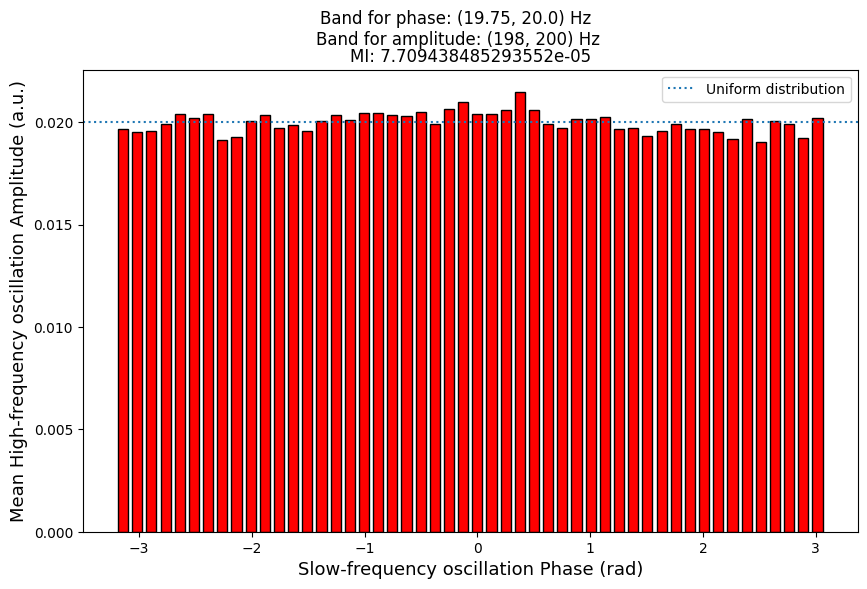

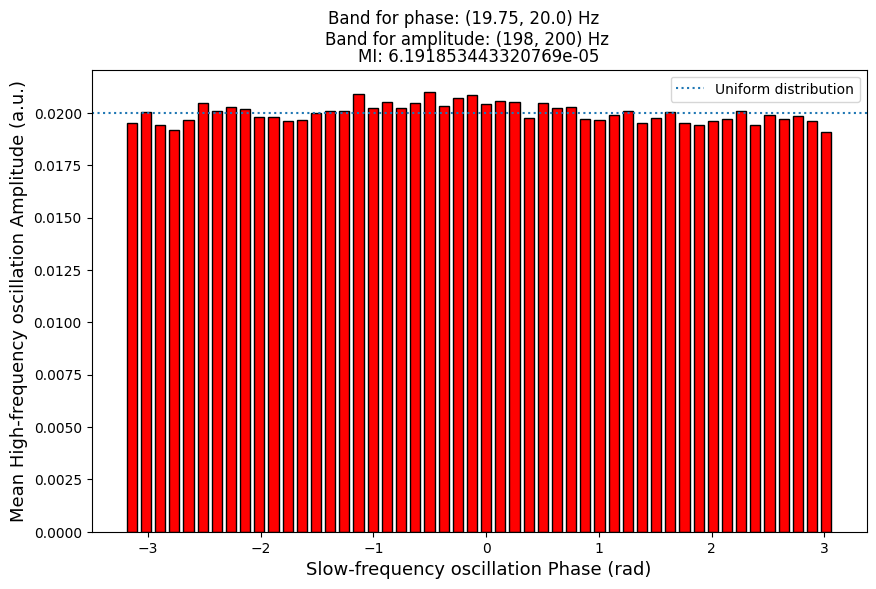

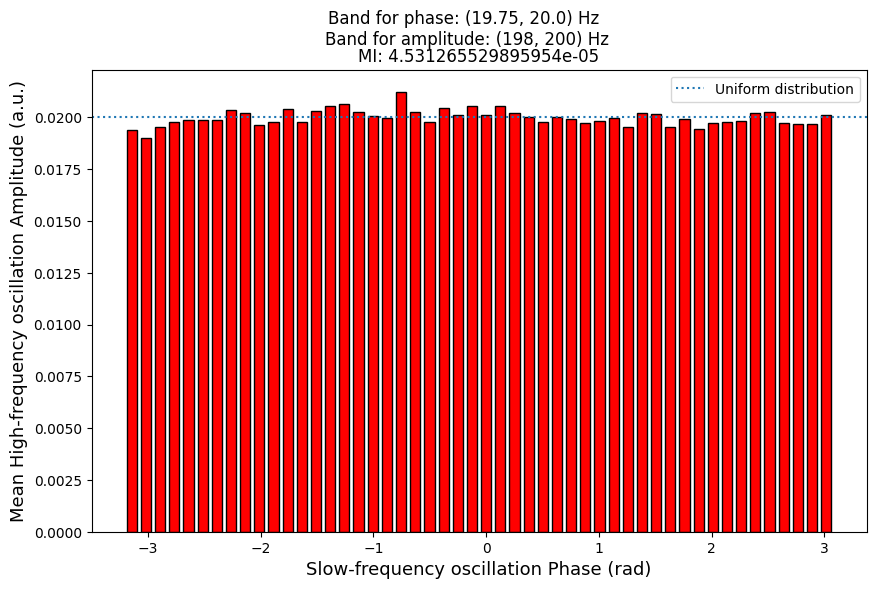

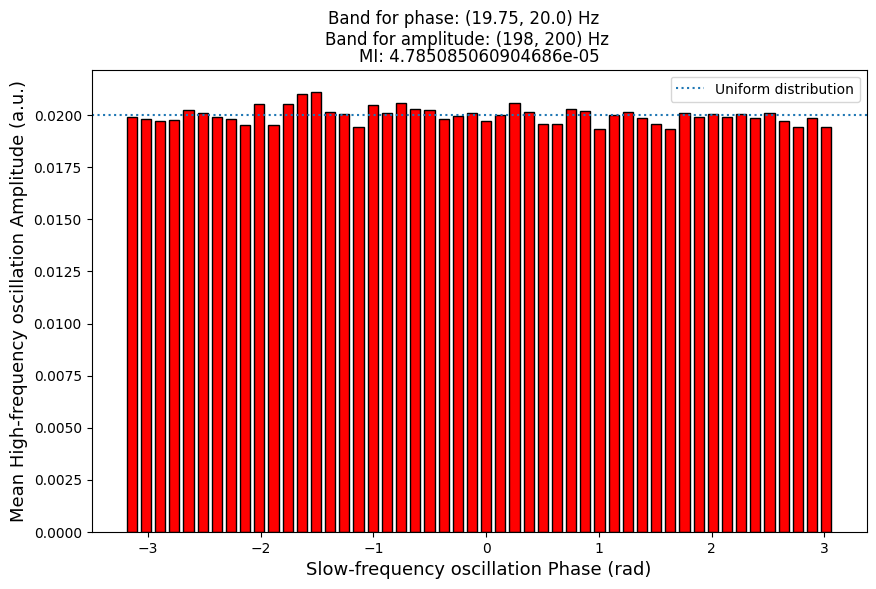

...

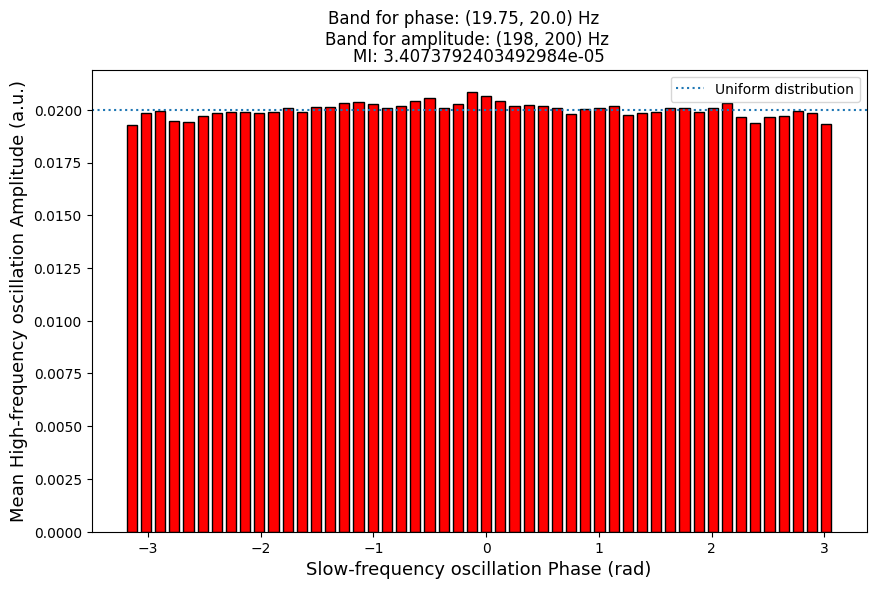

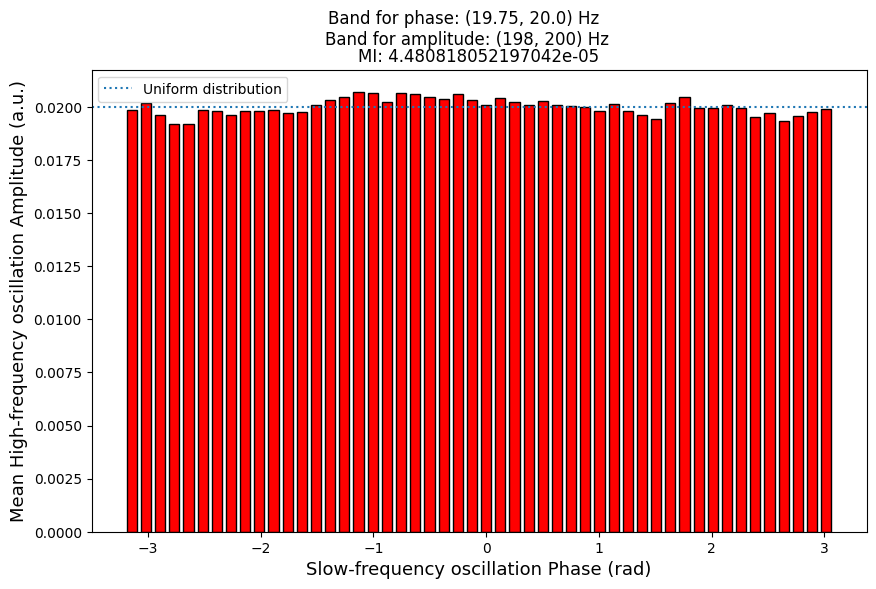

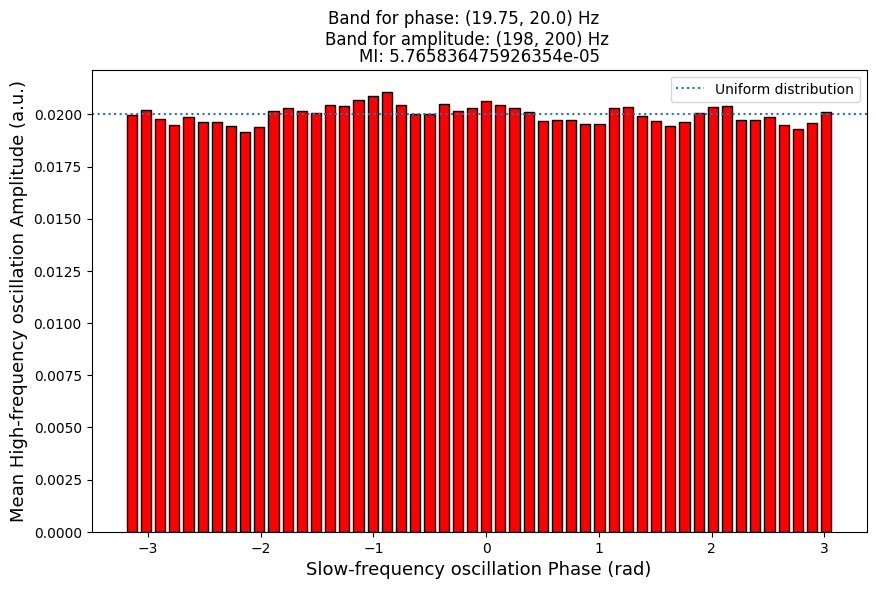

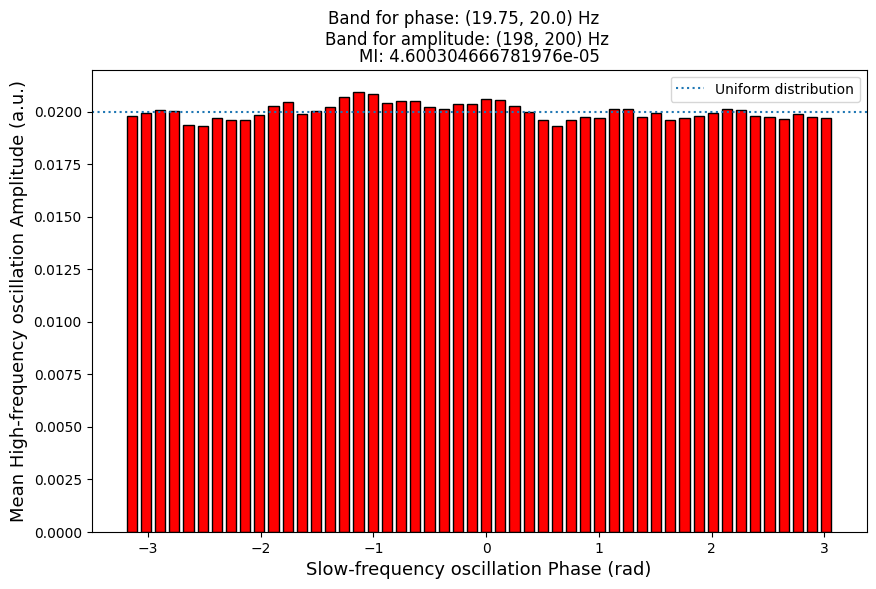

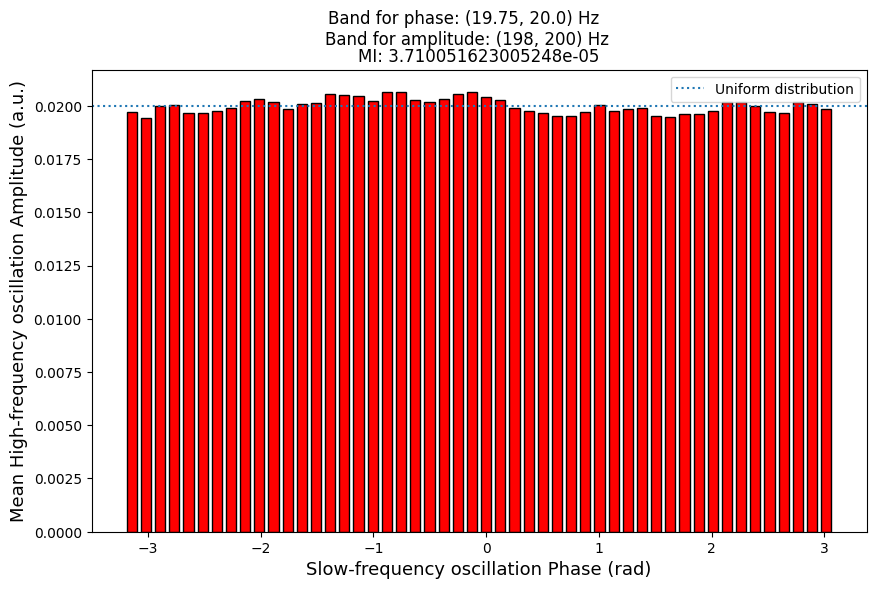

KeyboardInterrupt: ignored

In [44]:
for i in range(len(p)):
  plt.figure(figsize=(10,6))
  plt.bar(x=phasebins[0:-1],height=p[i],width=0.09,color='r',edgecolor='k')
  plt.axhline(y=1/num_bins,linestyle='dotted',label='Uniform distribution')
  plt.suptitle(f'Band for phase: {freqs_for_phases[band_id],freqs_for_phases[band_id+1]} Hz \nBand for amplitude: {freqs_for_amps[amp_index],freqs_for_amps[amp_index+1]} Hz')
  plt.title(f'MI: {entropy(p[i],uniform_dist)/np.log(num_bins)}')
  plt.xlabel(r'Slow-frequency oscillation Phase (rad)',size=13)
  plt.ylabel(r'Mean High-frequency oscillation Amplitude (a.u.)',size=13)
  plt.legend()
  plt.show()

(85, 77) (77,) (85,)


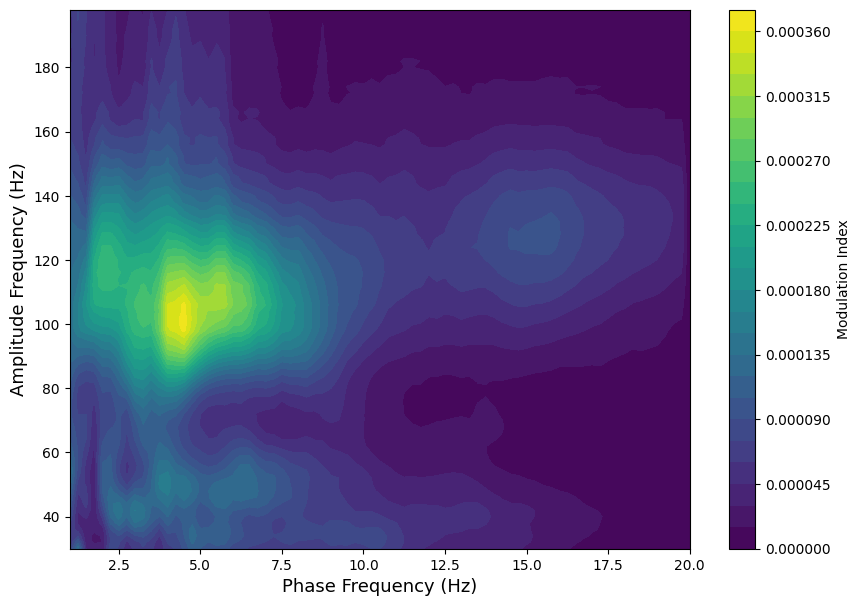

In [45]:
#dimensions
print(np.shape(comod),np.shape(freqs_for_phases),np.shape(freqs_for_amps[0:-1]))

#contour plot
plt.figure(figsize=(10,7))
plt.contourf(freqs_for_phases,freqs_for_amps[0:-1],comod,30)
plt.xlabel('Phase Frequency (Hz)',size=13)
plt.ylabel('Amplitude Frequency (Hz)',size=13)
plt.colorbar(label="Modulation Index");

In [ ]:
nrem_timestamps

def state_lfp(lfp_signal,timestamp_delimitators):
  #clip the LFP at the desired timestamp delimitators and return the signal
  return lfp.query(f'timestamps > {timestamp_delimitators[0]} and timestamps <= {timestamp_delimitators[1]}').lfp.values

In [65]:
for period_index,timestamps in enumerate(nrem_timestamps):
  print(period_index,timestamps)

0 [2632 3010]
1 [7280 8335]
2 [8816 8891]
3 [8918 8970]
4 [9012 9239]
5 [9403 9542]
6 [ 9904 10549]
7 [10853 10992]
8 [11018 11151]
9 [11176 11245]
10 [11268 11536]
11 [11910 11952]
12 [11969 12057]


beginning asleep period [0/13]
(85, 77) (77,) (85,)


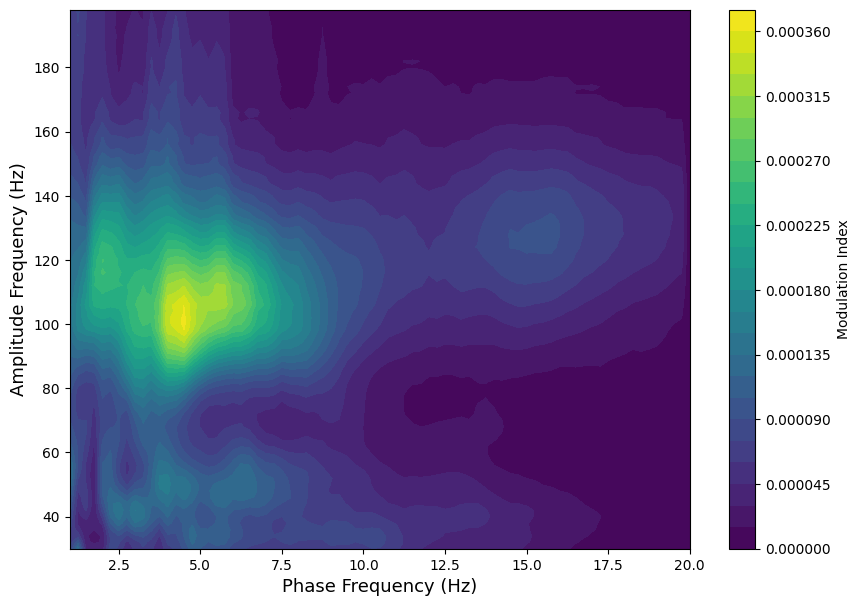

beginning asleep period [1/13]
(85, 77) (77,) (85,)


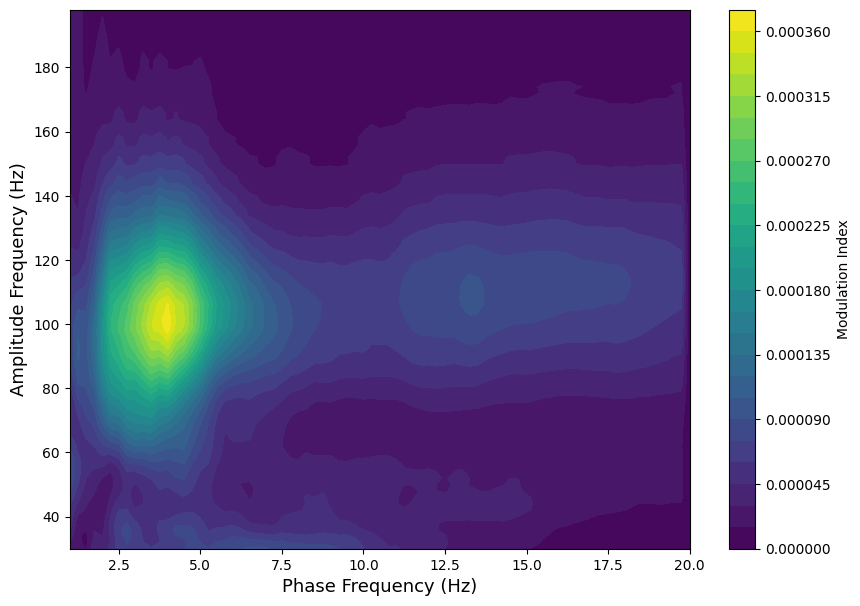

beginning asleep period [2/13]
(85, 77) (77,) (85,)


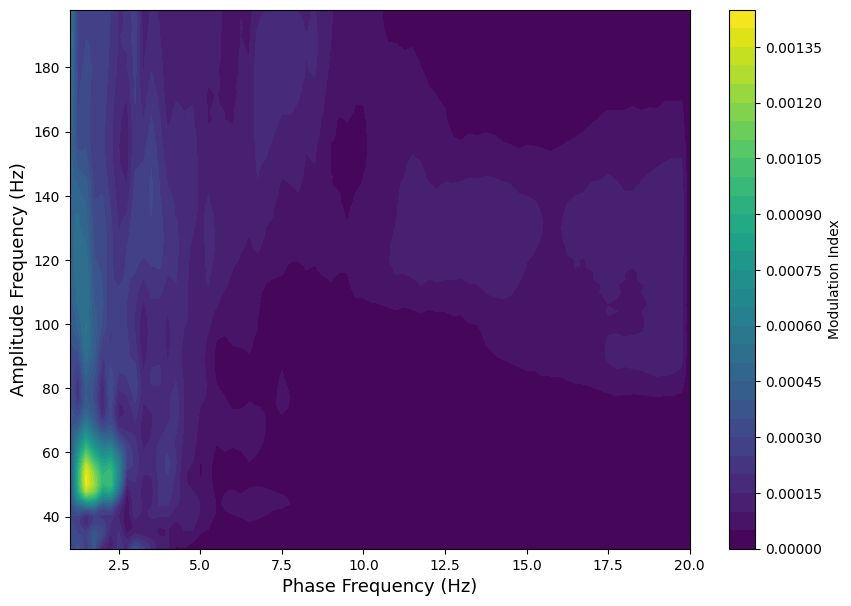

beginning asleep period [3/13]
(85, 77) (77,) (85,)


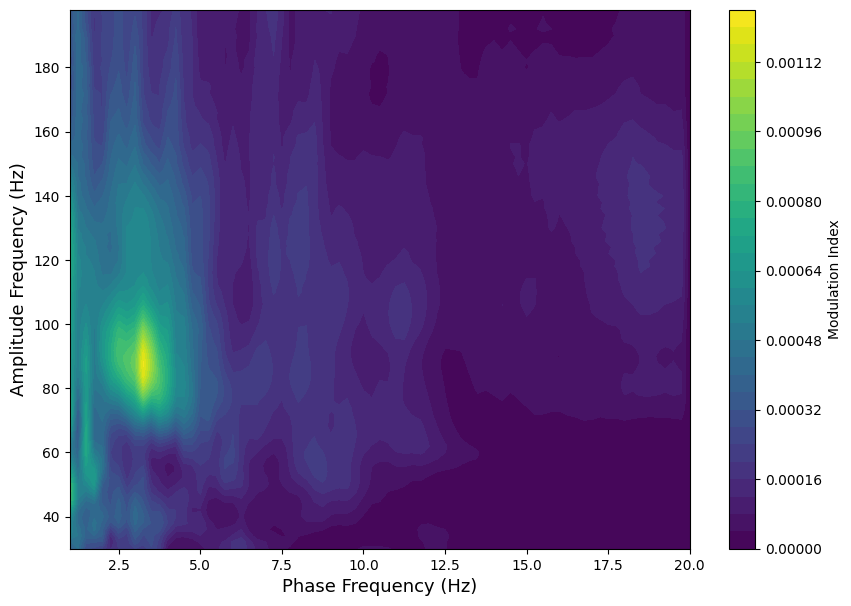

beginning asleep period [4/13]
(85, 77) (77,) (85,)


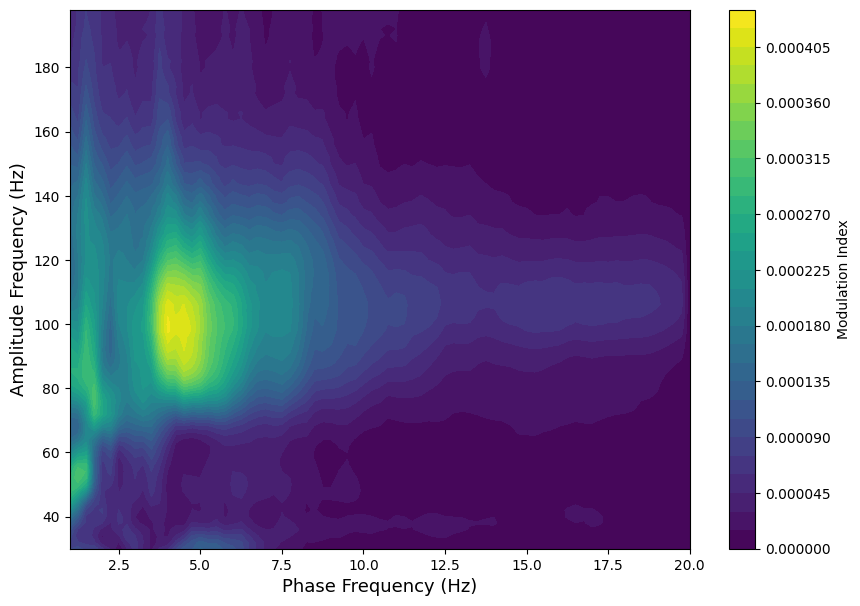

beginning asleep period [5/13]
(85, 77) (77,) (85,)


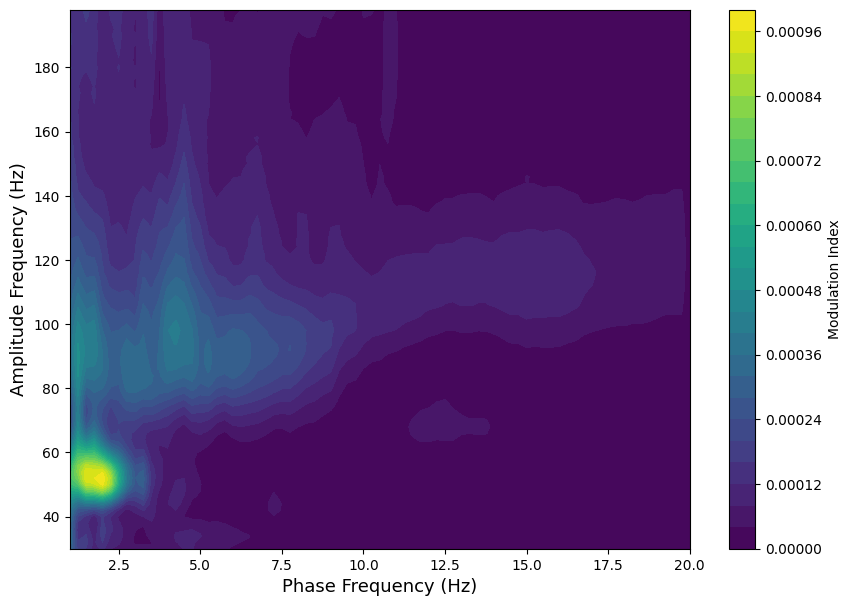

beginning asleep period [6/13]
(85, 77) (77,) (85,)


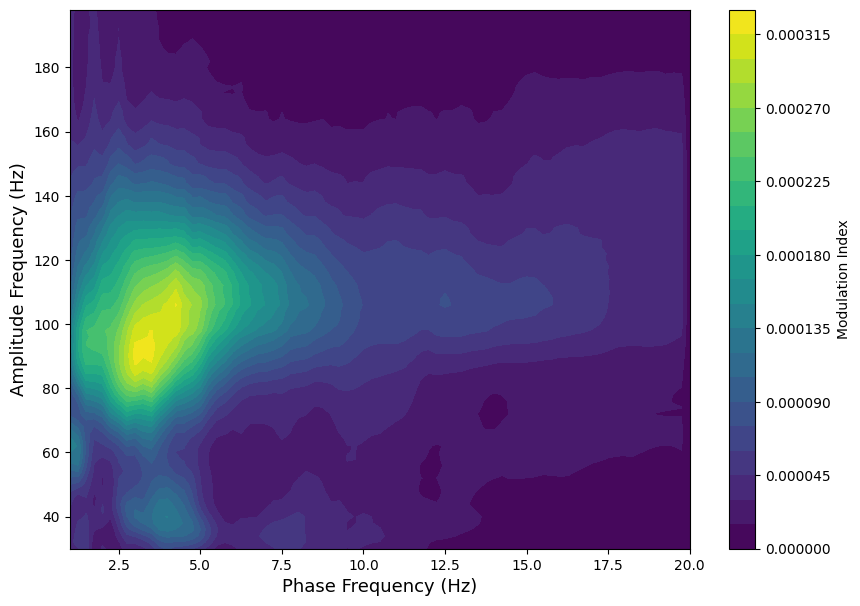

beginning asleep period [7/13]
(85, 77) (77,) (85,)


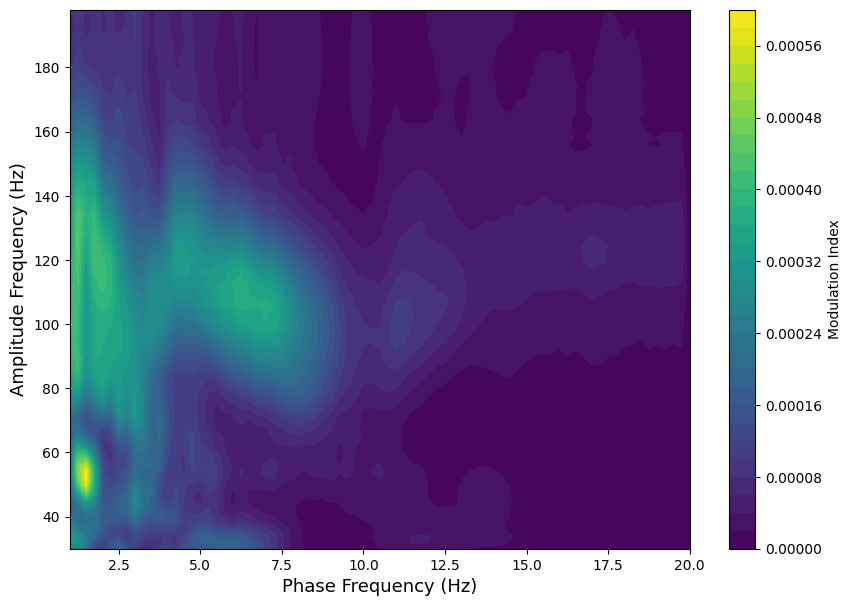

beginning asleep period [8/13]
(85, 77) (77,) (85,)


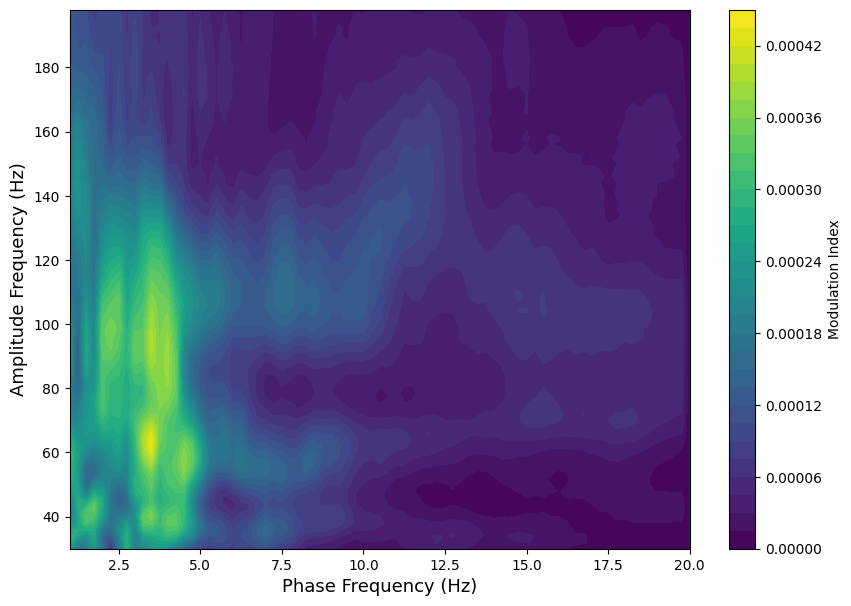

beginning asleep period [9/13]
(85, 77) (77,) (85,)


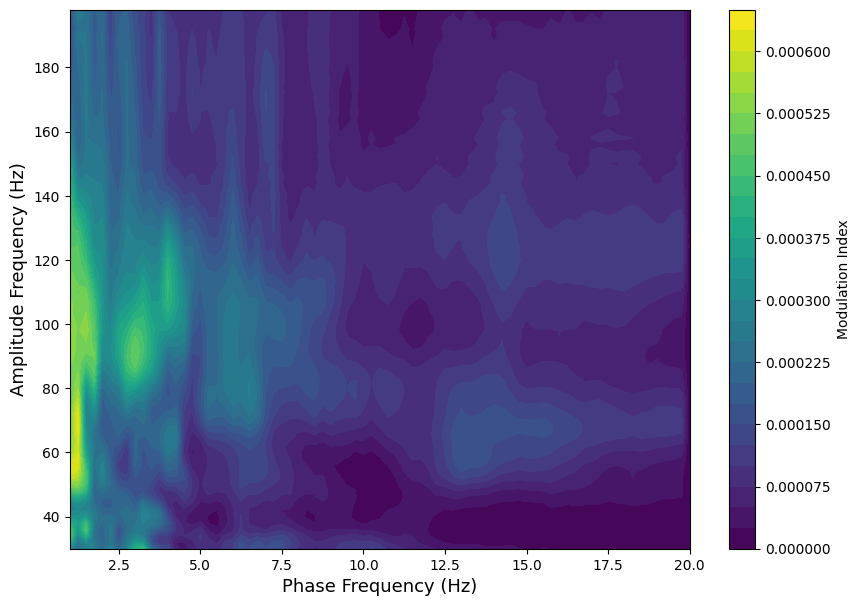

beginning asleep period [10/13]
(85, 77) (77,) (85,)


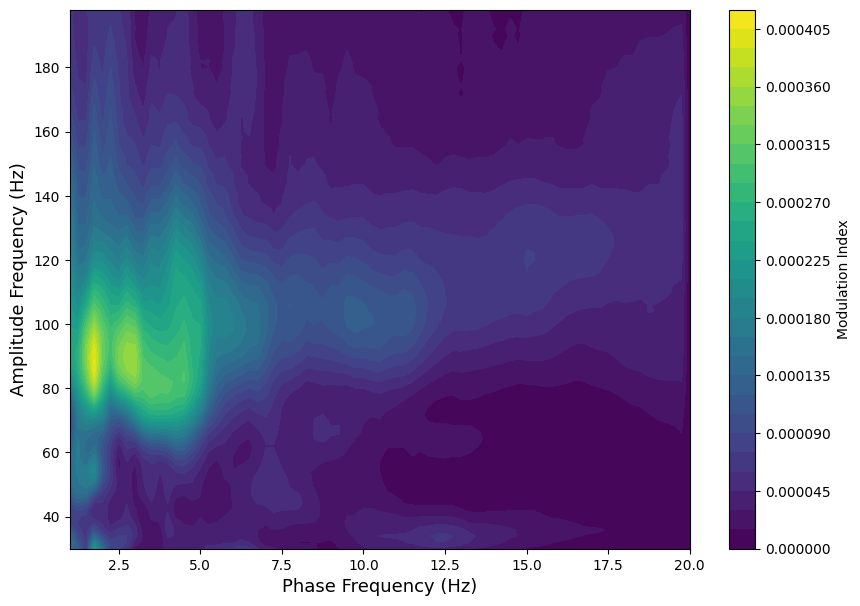

beginning asleep period [11/13]
(85, 77) (77,) (85,)


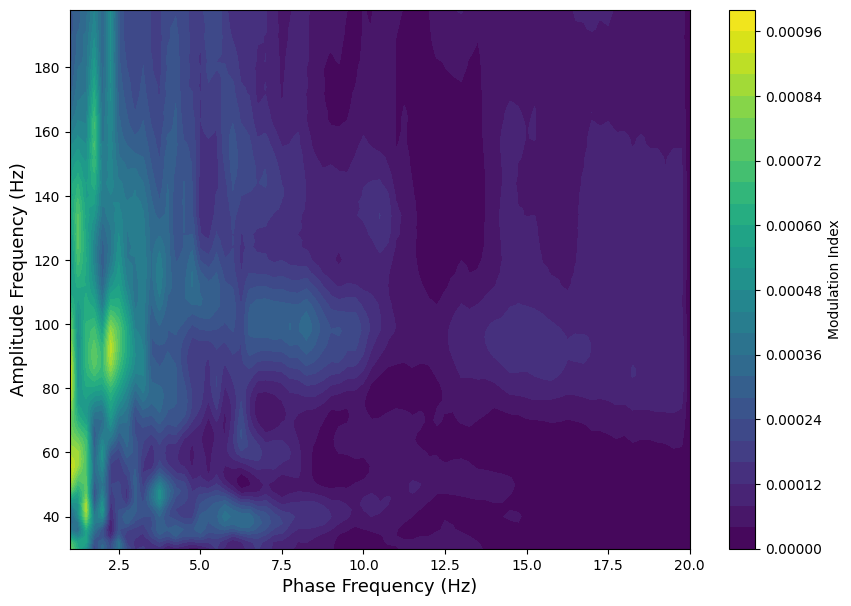

beginning asleep period [12/13]
(85, 77) (77,) (85,)


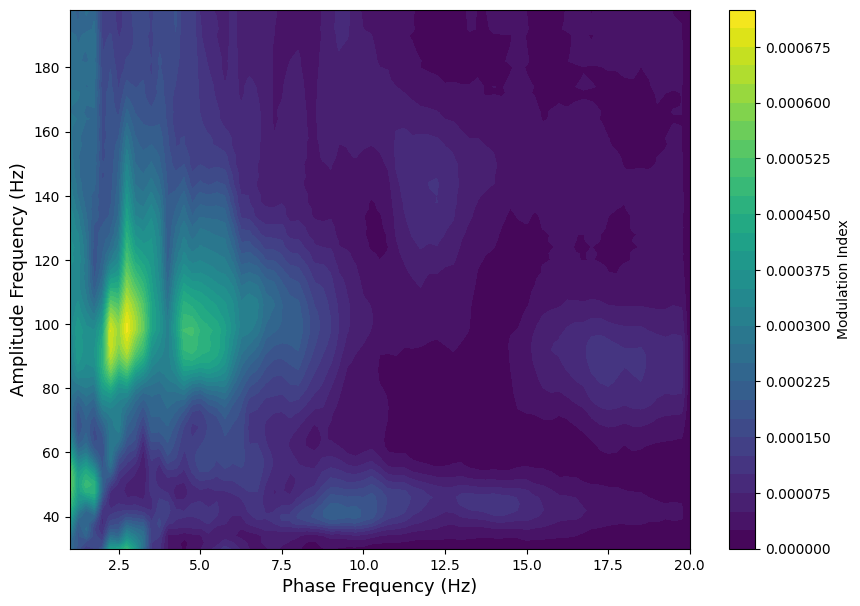

In [72]:
channel_lfp = lfp

for period_index,period_timestamps in enumerate(nrem_timestamps):
  print(f'beginning asleep period [{period_index}/{len(nrem_timestamps)}]')
  asleep_segment_signal = state_lfp(channel_lfp,period_timestamps)

  '''
  comodulogram building
  '''

  freqs_for_amps = np.arange(30,202,2)
  freqs_for_phases = np.arange(1,20.25,.25)

  sampling_rate = 1250
  filtered_phases = np.empty([len(freqs_for_phases) - 1,len(asleep_segment_signal)])

  from scipy.signal import hilbert

  for phase_index,phase in enumerate(freqs_for_phases[0:-1]):
    filtered_phases[phase_index,:] = np.angle(hilbert(band_extraction(asleep_segment_signal,cutoff_low=freqs_for_phases[phase_index],cutoff_high=freqs_for_phases[phase_index+1],
                                              sampling_rate=sampling_rate)))

  comod = np.zeros([len(freqs_for_amps) - 1, len(freqs_for_phases)])


  num_bins = 50
  phasebins = np.linspace(-np.pi,np.pi,num_bins+1)
  phasecenters = phasebins[0:-1] + (phasebins[1] - phasebins[0])

  #iterate over signals filtered at higher frequencies (each band for which we extract the amplitude envelope)
  for amp_index,current_amp in enumerate(freqs_for_amps[:-1]):
    #print(f'new amp: [{amp_index}/{len(freqs_for_amps)-1}]')
    amp_envelope = abs(hilbert(band_extraction(asleep_segment_signal,cutoff_low=freqs_for_amps[amp_index],cutoff_high=freqs_for_amps[amp_index+1],
                                                    sampling_rate=sampling_rate)))

    '''
    to exploit the storage vs. processing conundrum, I have already filtered the signal in each low-frequency band of interest
    and put each band's signal in a vector (filtered_phases, 76 bands in total).
    once again I have opted for such an approach and below I create a vector called bins_freq,
    that will store each frequency bin's (from [-pi,pi]) mean amplitude in a single modulated band (from which we extract the amplitude envelope)
    '''

    bins_freq = np.empty((num_bins,len(filtered_phases)))

    for phase_bin_id in range(len(phasebins)-1):
      #print(phase_bin_id)
      #print(phasebins[phase_bin_id],phasebins[phase_bin_id+1])

      for band_id,band_signal in enumerate(filtered_phases):
        phasepoints_in_frequency_bin = np.where((band_signal > phasebins[phase_bin_id]) & (band_signal < phasebins[phase_bin_id+1]))[0]
        mean_amplitude_in_frequency_bin = np.mean(amp_envelope[phasepoints_in_frequency_bin])
        #print(mean_amplitude_in_frequency_bin)
        bins_freq[phase_bin_id,band_id] = mean_amplitude_in_frequency_bin

      #print(f'estimated mean amplitude in bin {phase_bin_id} [{phasebins[phase_bin_id]} Hz, {phasebins[phase_bin_id+1]} Hz] in all modulating bands!')
      #print(sum(bins_freq[:,band_id]))
    #print(f'finished all frequency bins for all modulating bands in this modulated band: [{freqs_for_amps[amp_index]} Hz,{freqs_for_amps[amp_index+1]} Hz]')
    #normalize over each phase bin, yielding what is dubbed p
    p = [bins_freq[:,band_id]/sum(bins_freq[:,band_id]) for band_id in range(len(filtered_phases))]

    #estimate MI
    from scipy.stats import entropy
    uniform_dist = np.ones(num_bins)/num_bins

    #iterating over all low-frequency filtered bands:
    for low_freq_band_index in range(np.shape(p)[0]):
      MI = entropy(p[low_freq_band_index],uniform_dist)/np.log(num_bins)
      comod[amp_index,low_freq_band_index] = MI

  #dimensions
  print(np.shape(comod),np.shape(freqs_for_phases),np.shape(freqs_for_amps[0:-1]))

  #contour plot
  plt.figure(figsize=(10,7))
  plt.contourf(freqs_for_phases,freqs_for_amps[0:-1],comod,30)
  plt.xlabel('Phase Frequency (Hz)',size=13)
  plt.ylabel('Amplitude Frequency (Hz)',size=13)
  plt.colorbar(label="Modulation Index");
  plt.show()

beginning pathological period [1/15]
(85, 77) (77,) (85,)


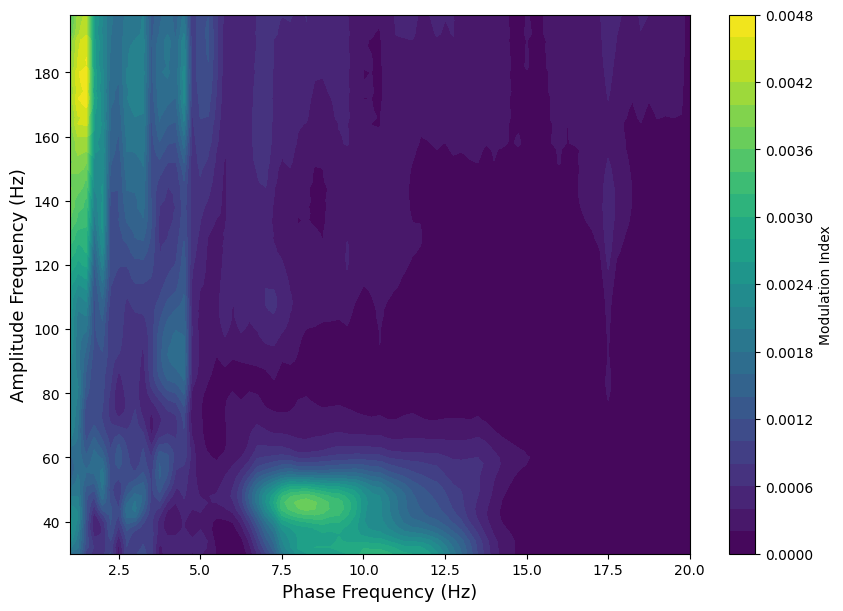

beginning pathological period [2/15]
(85, 77) (77,) (85,)


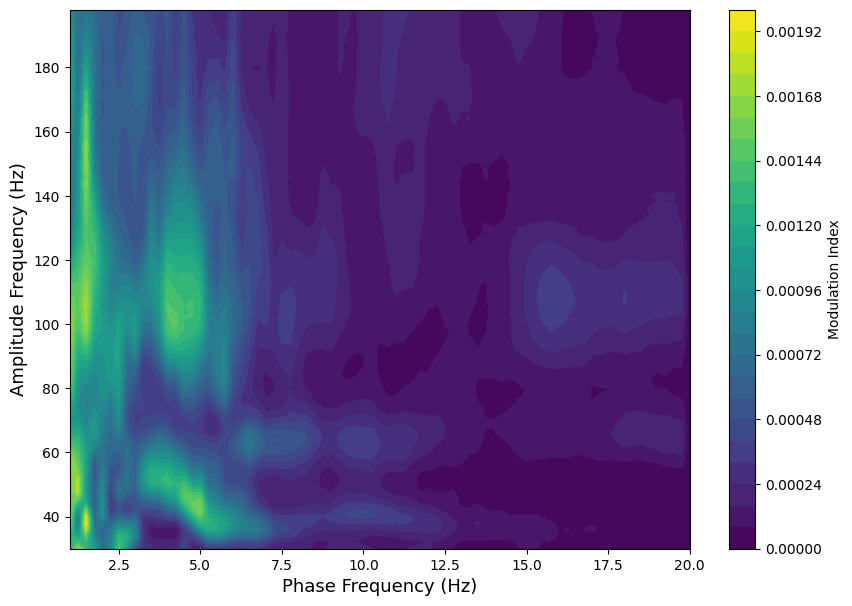

beginning pathological period [3/15]
(85, 77) (77,) (85,)


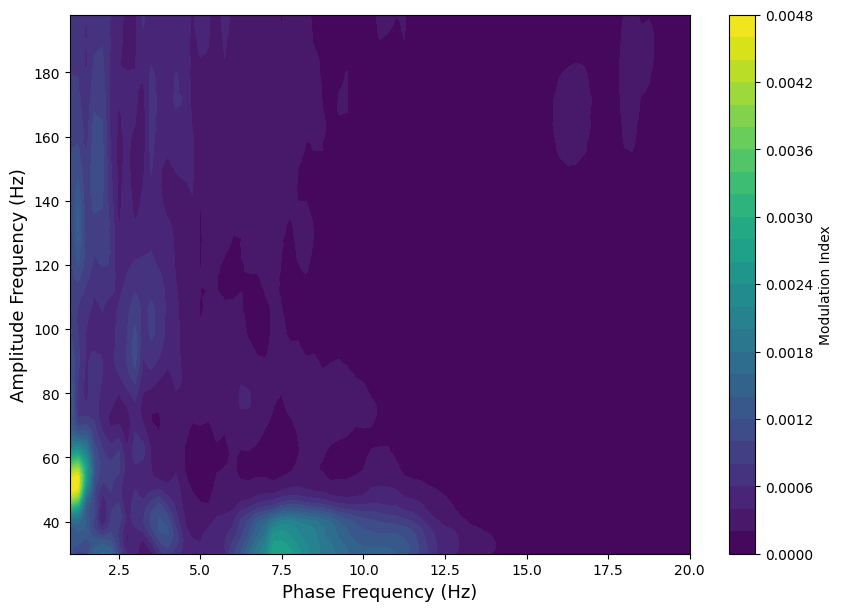

beginning pathological period [4/15]
(85, 77) (77,) (85,)


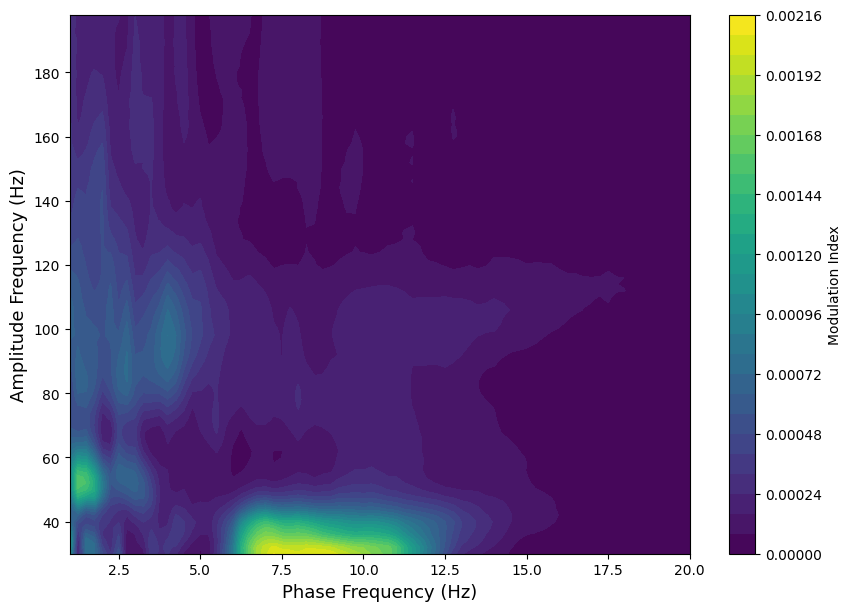

beginning pathological period [5/15]
(85, 77) (77,) (85,)


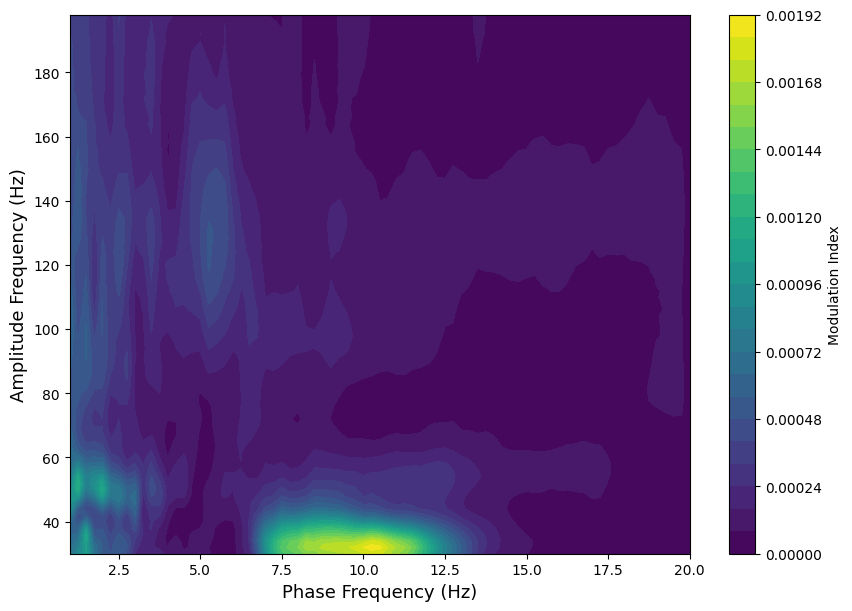

beginning pathological period [6/15]
(85, 77) (77,) (85,)


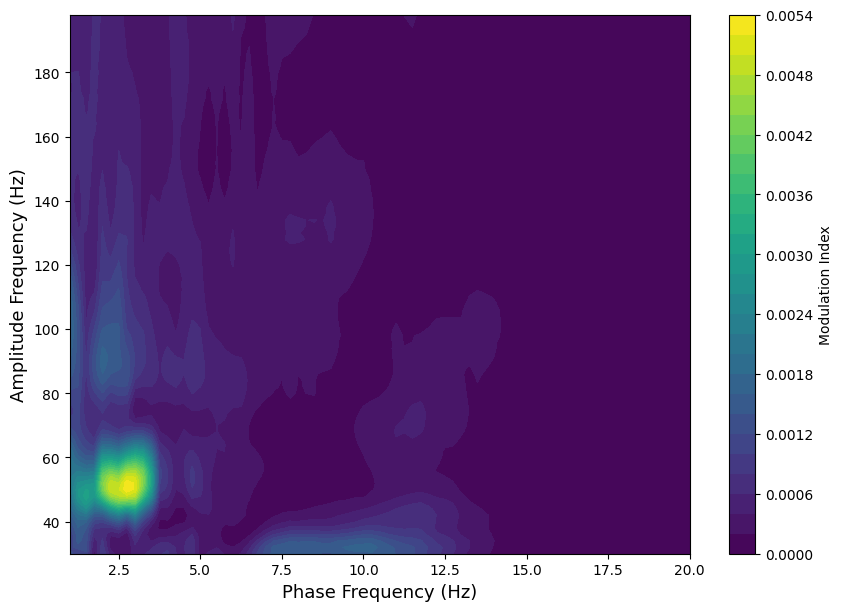

beginning pathological period [7/15]
(85, 77) (77,) (85,)


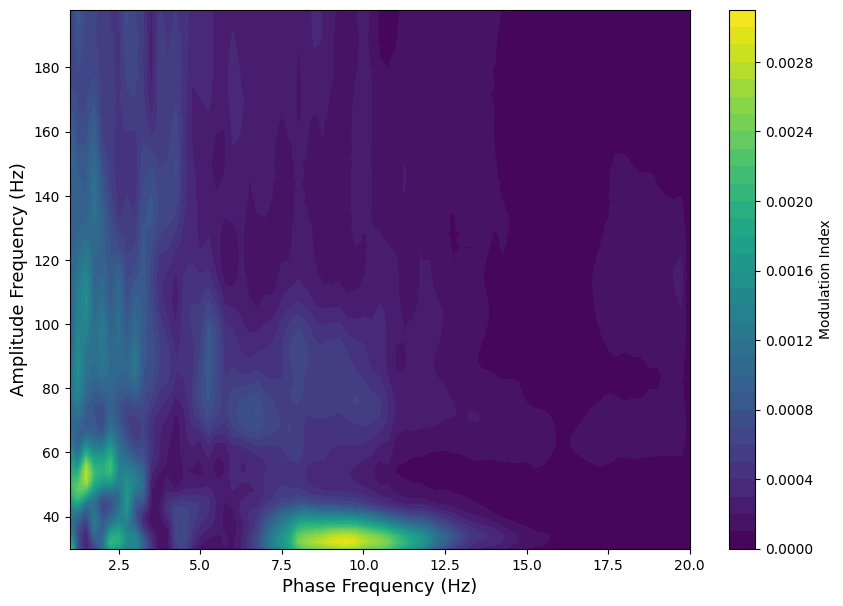

beginning pathological period [8/15]
(85, 77) (77,) (85,)


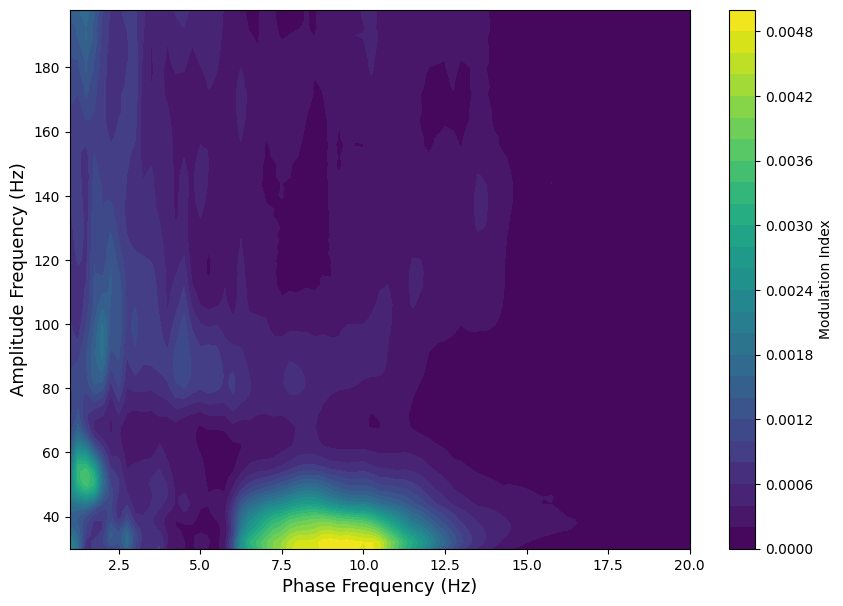

beginning pathological period [9/15]
(85, 77) (77,) (85,)


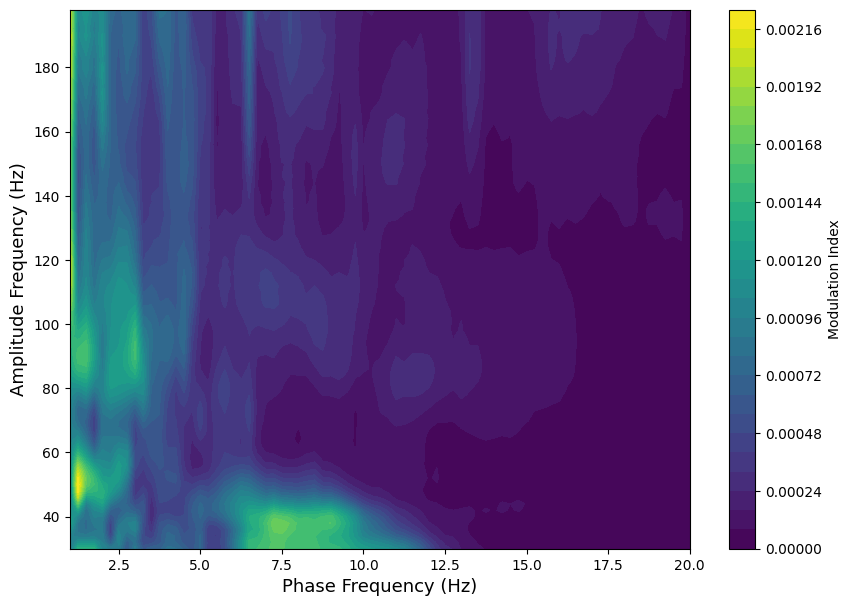

beginning pathological period [10/15]
(85, 77) (77,) (85,)


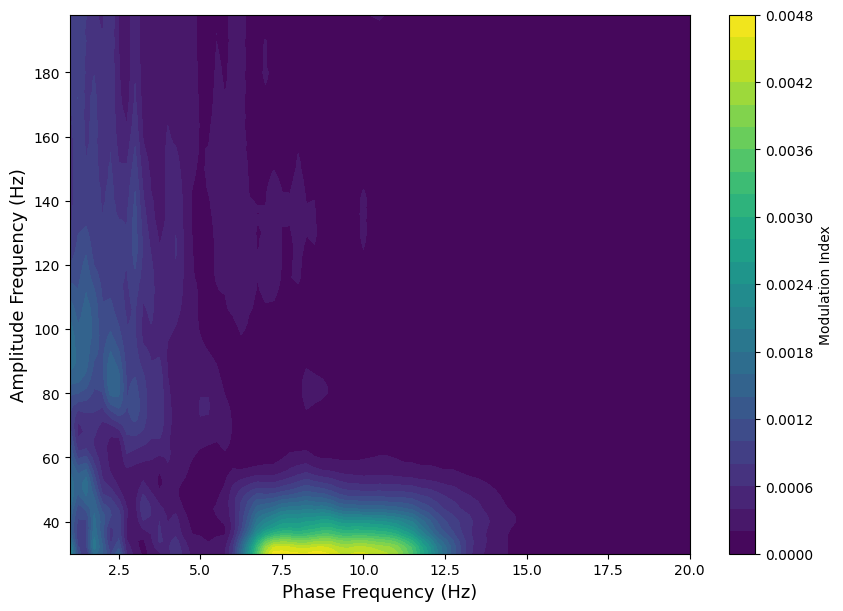

beginning pathological period [11/15]
(85, 77) (77,) (85,)


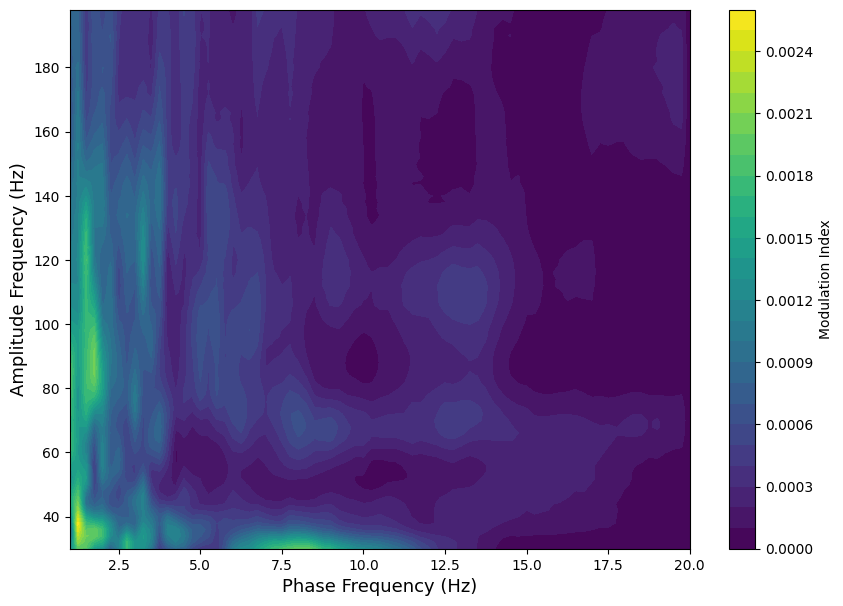

beginning pathological period [12/15]
(85, 77) (77,) (85,)


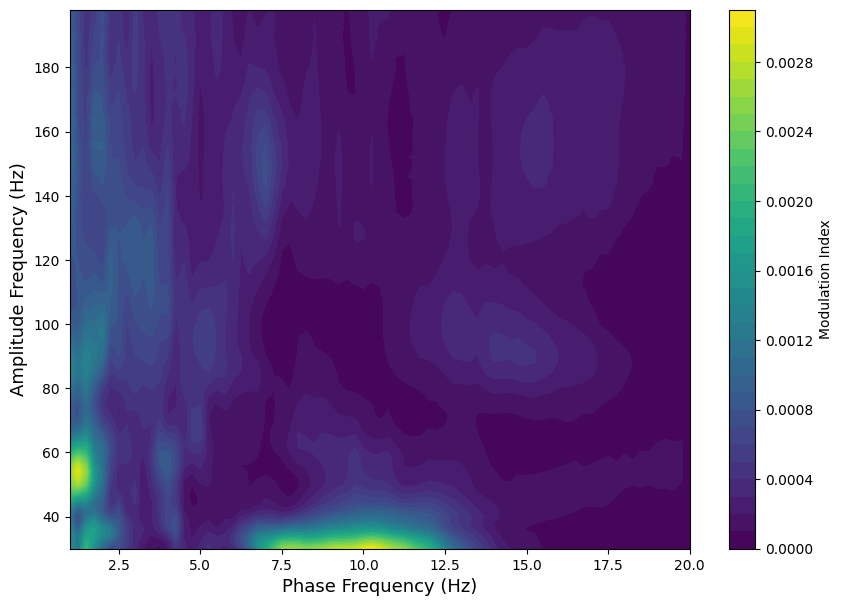

beginning pathological period [13/15]
(85, 77) (77,) (85,)


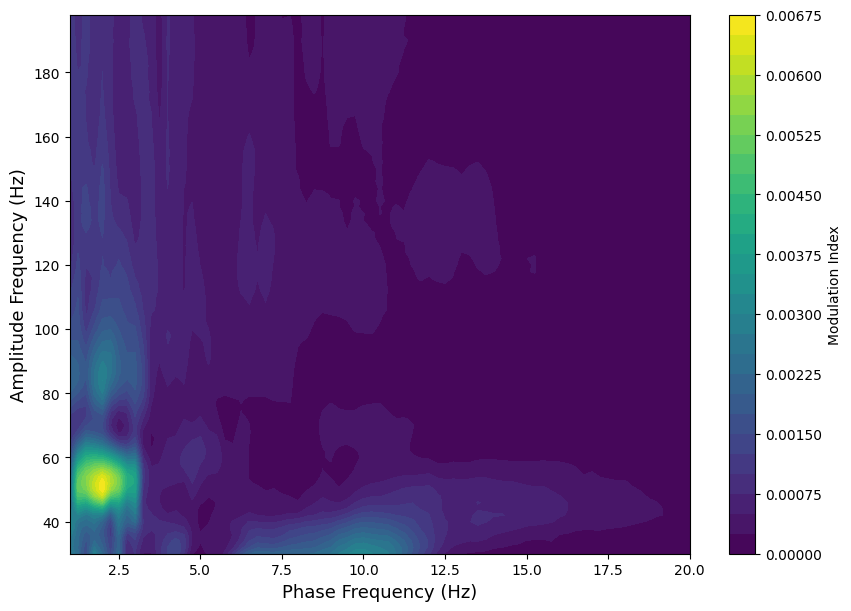

beginning pathological period [14/15]
(85, 77) (77,) (85,)


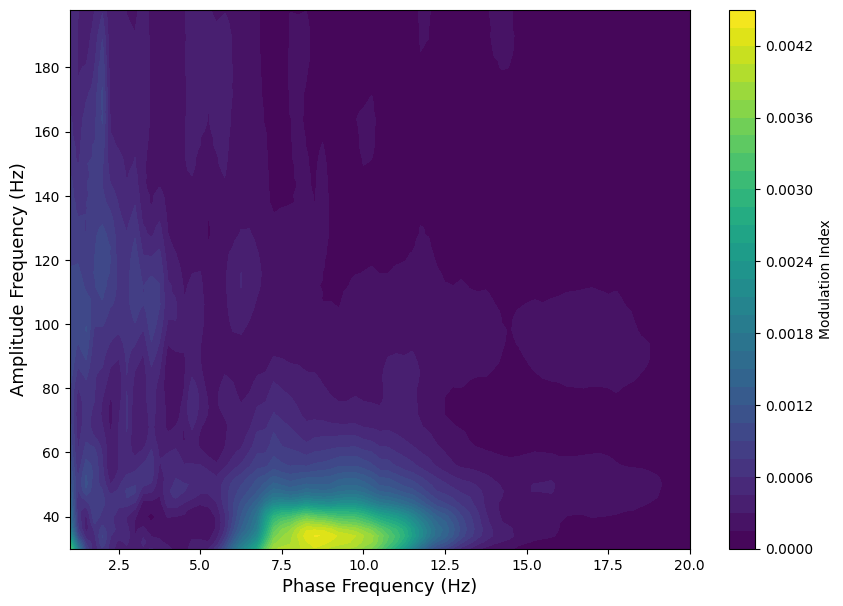

beginning pathological period [15/15]
(85, 77) (77,) (85,)


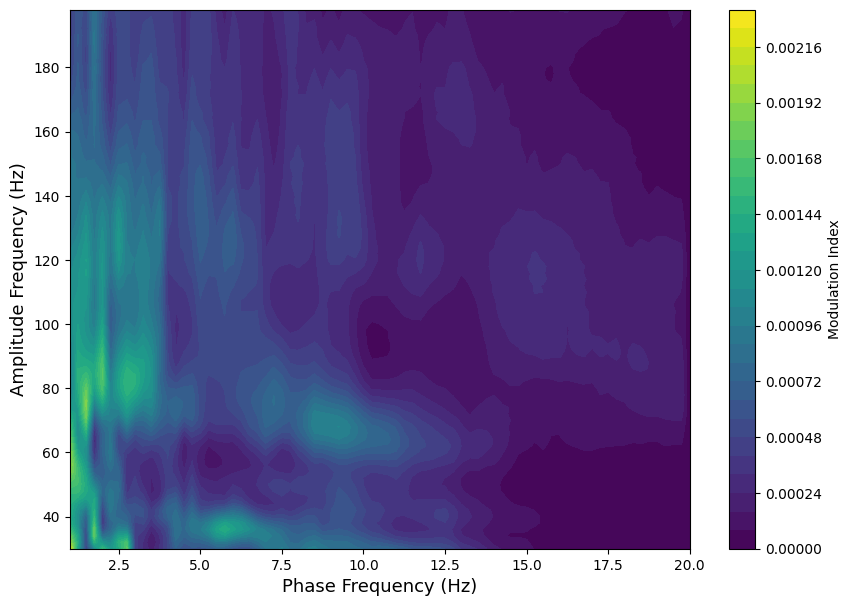

In [74]:
channel_lfp = lfp

for period_index,period_timestamps in enumerate(pathological_timestamps):
  print(f'beginning pathological period [{period_index+1}/{len(pathological_timestamps)}]')
  asleep_segment_signal = state_lfp(channel_lfp,period_timestamps)

  '''
  comodulogram building
  '''

  freqs_for_amps = np.arange(30,202,2)
  freqs_for_phases = np.arange(1,20.25,.25)

  sampling_rate = 1250
  filtered_phases = np.empty([len(freqs_for_phases) - 1,len(asleep_segment_signal)])

  from scipy.signal import hilbert

  for phase_index,phase in enumerate(freqs_for_phases[0:-1]):
    filtered_phases[phase_index,:] = np.angle(hilbert(band_extraction(asleep_segment_signal,cutoff_low=freqs_for_phases[phase_index],cutoff_high=freqs_for_phases[phase_index+1],
                                              sampling_rate=sampling_rate)))

  comod = np.zeros([len(freqs_for_amps) - 1, len(freqs_for_phases)])


  num_bins = 50
  phasebins = np.linspace(-np.pi,np.pi,num_bins+1)
  phasecenters = phasebins[0:-1] + (phasebins[1] - phasebins[0])

  #iterate over signals filtered at higher frequencies (each band for which we extract the amplitude envelope)
  for amp_index,current_amp in enumerate(freqs_for_amps[:-1]):
    #print(f'new amp: [{amp_index}/{len(freqs_for_amps)-1}]')
    amp_envelope = abs(hilbert(band_extraction(asleep_segment_signal,cutoff_low=freqs_for_amps[amp_index],cutoff_high=freqs_for_amps[amp_index+1],
                                                    sampling_rate=sampling_rate)))

    '''
    to exploit the storage vs. processing conundrum, I have already filtered the signal in each low-frequency band of interest
    and put each band's signal in a vector (filtered_phases, 76 bands in total).
    once again I have opted for such an approach and below I create a vector called bins_freq,
    that will store each frequency bin's (from [-pi,pi]) mean amplitude in a single modulated band (from which we extract the amplitude envelope)
    '''

    bins_freq = np.empty((num_bins,len(filtered_phases)))

    for phase_bin_id in range(len(phasebins)-1):
      #print(phase_bin_id)
      #print(phasebins[phase_bin_id],phasebins[phase_bin_id+1])

      for band_id,band_signal in enumerate(filtered_phases):
        phasepoints_in_frequency_bin = np.where((band_signal > phasebins[phase_bin_id]) & (band_signal < phasebins[phase_bin_id+1]))[0]
        mean_amplitude_in_frequency_bin = np.mean(amp_envelope[phasepoints_in_frequency_bin])
        #print(mean_amplitude_in_frequency_bin)
        bins_freq[phase_bin_id,band_id] = mean_amplitude_in_frequency_bin

      #print(f'estimated mean amplitude in bin {phase_bin_id} [{phasebins[phase_bin_id]} Hz, {phasebins[phase_bin_id+1]} Hz] in all modulating bands!')
      #print(sum(bins_freq[:,band_id]))
    #print(f'finished all frequency bins for all modulating bands in this modulated band: [{freqs_for_amps[amp_index]} Hz,{freqs_for_amps[amp_index+1]} Hz]')
    #normalize over each phase bin, yielding what is dubbed p
    p = [bins_freq[:,band_id]/sum(bins_freq[:,band_id]) for band_id in range(len(filtered_phases))]

    #estimate MI
    from scipy.stats import entropy
    uniform_dist = np.ones(num_bins)/num_bins

    #iterating over all low-frequency filtered bands:
    for low_freq_band_index in range(np.shape(p)[0]):
      MI = entropy(p[low_freq_band_index],uniform_dist)/np.log(num_bins)
      comod[amp_index,low_freq_band_index] = MI

  #dimensions
  print(np.shape(comod),np.shape(freqs_for_phases),np.shape(freqs_for_amps[0:-1]))

  #contour plot
  plt.figure(figsize=(10,7))
  plt.contourf(freqs_for_phases,freqs_for_amps[0:-1],comod,30)
  plt.xlabel('Phase Frequency (Hz)',size=13)
  plt.ylabel('Amplitude Frequency (Hz)',size=13)
  plt.colorbar(label="Modulation Index");
  plt.show()

In [ ]:
'''
comodulogram building
'''

freqs_for_amps = np.arange(30,202,2)
freqs_for_phases = np.arange(1,20.25,.25)

sampling_rate = 1250
filtered_phases = np.empty([len(freqs_for_phases) - 1,len(signal)])

from scipy.signal import hilbert

for phase_index,phase in enumerate(freqs_for_phases[0:-1]):
  filtered_phases[phase_index,:] = np.angle(hilbert(band_extraction(signal,cutoff_low=freqs_for_phases[phase_index],cutoff_high=freqs_for_phases[phase_index+1],
                                            sampling_rate=sampling_rate)))

comod = np.zeros([len(freqs_for_amps) - 1, len(freqs_for_phases)])


num_bins = 50
phasebins = np.linspace(-np.pi,np.pi,num_bins+1)
phasecenters = phasebins[0:-1] + (phasebins[1] - phasebins[0])

#iterate over signals filtered at higher frequencies (each band for which we extract the amplitude envelope)
for amp_index,current_amp in enumerate(freqs_for_amps[:-1]):
  print(f'new amp: [{amp_index}/{len(freqs_for_amps)-1}]')
  amp_envelope = abs(hilbert(band_extraction(signal,cutoff_low=freqs_for_amps[amp_index],cutoff_high=freqs_for_amps[amp_index+1],
                                                   sampling_rate=sampling_rate)))

  '''
  to exploit the storage vs. processing conundrum, I have already filtered the signal in each low-frequency band of interest
  and put each band's signal in a vector (filtered_phases, 76 bands in total).
  once again I have opted for such an approach and below I create a vector called bins_freq,
  that will store each frequency bin's (from [-pi,pi]) mean amplitude in a single modulated band (from which we extract the amplitude envelope)
  '''

  bins_freq = np.empty((num_bins,len(filtered_phases)))

  for phase_bin_id in range(len(phasebins)-1):
    #print(phase_bin_id)
    #print(phasebins[phase_bin_id],phasebins[phase_bin_id+1])

    for band_id,band_signal in enumerate(filtered_phases):
      phasepoints_in_frequency_bin = np.where((band_signal > phasebins[phase_bin_id]) & (band_signal < phasebins[phase_bin_id+1]))[0]
      mean_amplitude_in_frequency_bin = np.mean(amp_envelope[phasepoints_in_frequency_bin])
      #print(mean_amplitude_in_frequency_bin)
      bins_freq[phase_bin_id,band_id] = mean_amplitude_in_frequency_bin

    #print(f'estimated mean amplitude in bin {phase_bin_id} [{phasebins[phase_bin_id]} Hz, {phasebins[phase_bin_id+1]} Hz] in all modulating bands!')
    #print(sum(bins_freq[:,band_id]))
  print(f'finished all frequency bins for all modulating bands in this modulated band: [{freqs_for_amps[amp_index]} Hz,{freqs_for_amps[amp_index+1]} Hz]')
  #normalize over each phase bin, yielding what is dubbed p
  p = [bins_freq[:,band_id]/sum(bins_freq[:,band_id]) for band_id in range(len(filtered_phases))]

  #estimate MI
  from scipy.stats import entropy
  uniform_dist = np.ones(num_bins)/num_bins

  #iterating over all low-frequency filtered bands:
  for low_freq_band_index in range(np.shape(p)[0]):
    MI = entropy(p[low_freq_band_index],uniform_dist)/np.log(num_bins)
    comod[amp_index,low_freq_band_index] = MI

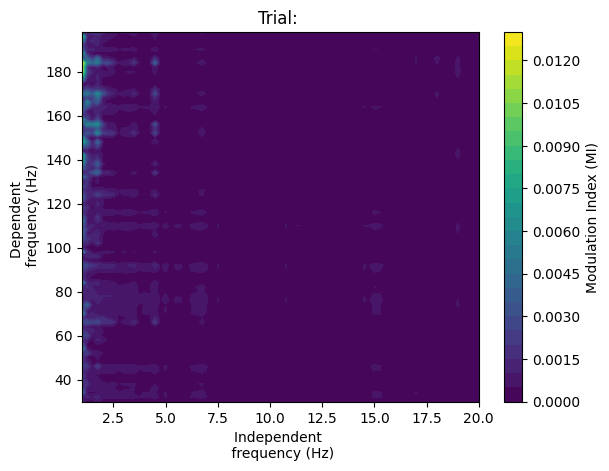

In [ ]:
print(np.shape(comod),np.shape(freqs_for_phases),np.shape(freqs_for_amps[0:-1]))
plot_comodulogram(comod.T,freqs_for_phases,freqs_for_amps[0:-1])

In [ ]:
phasebins

array([-3.14159265e+00, -3.01592895e+00, -2.89026524e+00, -2.76460154e+00,
       -2.63893783e+00, -2.51327412e+00, -2.38761042e+00, -2.26194671e+00,
       -2.13628300e+00, -2.01061930e+00, -1.88495559e+00, -1.75929189e+00,
       -1.63362818e+00, -1.50796447e+00, -1.38230077e+00, -1.25663706e+00,
       -1.13097336e+00, -1.00530965e+00, -8.79645943e-01, -7.53982237e-01,
       -6.28318531e-01, -5.02654825e-01, -3.76991118e-01, -2.51327412e-01,
       -1.25663706e-01,  4.44089210e-16,  1.25663706e-01,  2.51327412e-01,
        3.76991118e-01,  5.02654825e-01,  6.28318531e-01,  7.53982237e-01,
        8.79645943e-01,  1.00530965e+00,  1.13097336e+00,  1.25663706e+00,
        1.38230077e+00,  1.50796447e+00,  1.63362818e+00,  1.75929189e+00,
        1.88495559e+00,  2.01061930e+00,  2.13628300e+00,  2.26194671e+00,
        2.38761042e+00,  2.51327412e+00,  2.63893783e+00,  2.76460154e+00,
        2.89026524e+00,  3.01592895e+00,  3.14159265e+00])

In [ ]:
p[0]

array([0.01793984, 0.01842511, 0.01886639, 0.01948593, 0.02010098,
       0.02067453, 0.02053527, 0.01934426, 0.01744026, 0.01602709,
       0.01647282, 0.01763971, 0.01957467, 0.01924325, 0.02052838,
       0.02153689, 0.02223413, 0.02263556, 0.02325018, 0.02278131,
       0.02244073, 0.02279539, 0.02278155, 0.02346803, 0.0234466 ,
       0.02351622, 0.02312228, 0.0229187 , 0.02207548, 0.02155442,
       0.02098188, 0.02028089, 0.0198566 , 0.01953714, 0.01920929,
       0.01872506, 0.01862513, 0.01896936, 0.019219  , 0.01896676,
       0.01902036, 0.01883092, 0.01877194, 0.01865369, 0.01829689,
       0.01837261, 0.01802808, 0.01792256, 0.0175556 , 0.01732032])

In [ ]:
comod_test,indtest,deptest = comodulogram2(signal,ind_band = [2,20],ind_step = 1,dep_step=5,ind_bandwidth = 0.5,dep_bandwidth = 5,sampling_rate=1000)

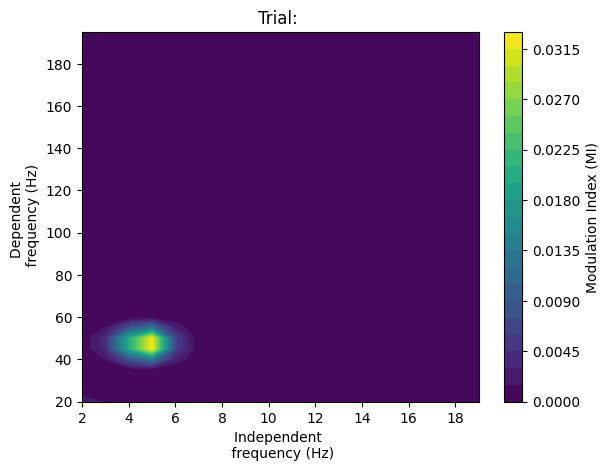

In [ ]:
plot_comodulogram(comod_test,indtest,deptest)

(31, 26) (26,) (31,)


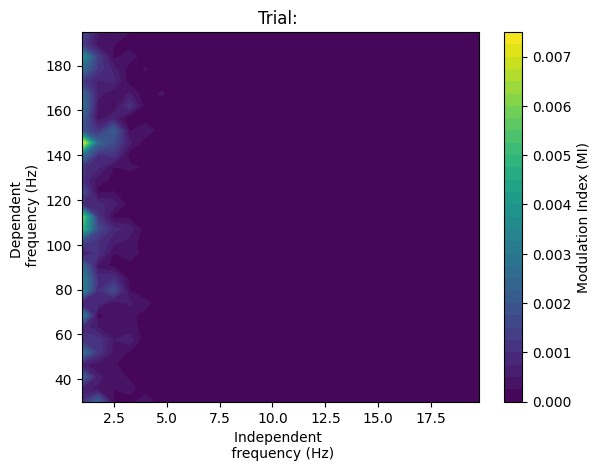

In [ ]:
tort_LFP['lfpHG'][0]

array([-0.3203125 , -0.31738281, -0.30712891, ...,  0.16015625,
        0.16552734,  0.17041016])

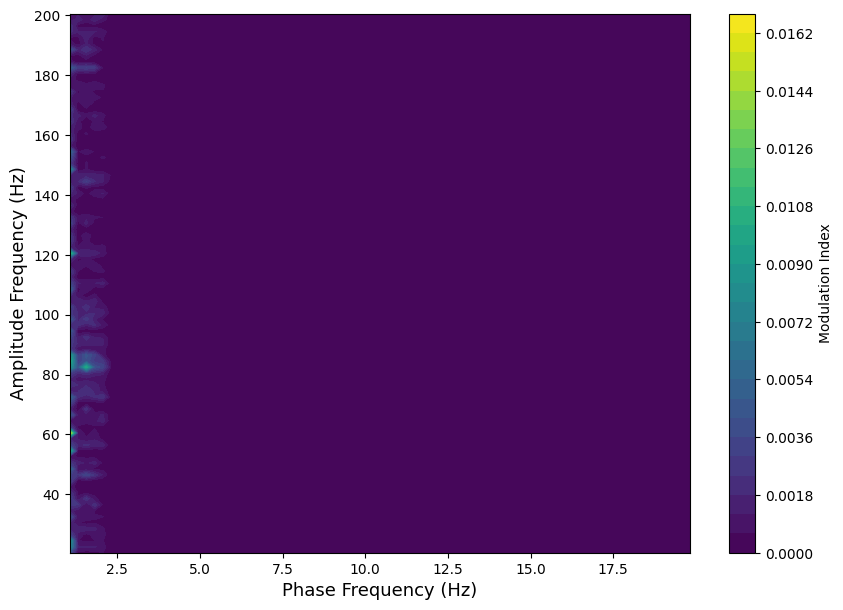

In [ ]:
from scipy.signal import butter,filtfilt
srate = 1000
nyq = 0.5*srate
phasevector = np.arange(-180,161,20)

# Phase-Amplitude comodulogram
LFP = tort_LFP['lfpHG'][0]

phase_freq_vector = np.arange(1.,20.,.25)
fp_bandwidth = .125
amp_freq_vector = np.arange(20.,201.,2.)
fa_bandwidth = 1.

MeanAmp = np.empty(len(phasevector))
Comodulogram = np.empty((len(phase_freq_vector),len(amp_freq_vector)))

for count_phase,fp in enumerate(phase_freq_vector):
    b,a = butter(3,[fp/nyq,(fp+fp_bandwidth)/nyq],'bandpass')
    filteredPhase = filtfilt(b,a,LFP)
    phase = np.angle(hilbert(filteredPhase))

    for count_amp,fa in enumerate(amp_freq_vector):
        b,a = butter(3,[fa/nyq,(fa+fa_bandwidth)/nyq],'bandpass')
        filteredAmp = filtfilt(b,a,LFP)
        amp = abs(hilbert(filteredAmp))

        for count,phasebin in enumerate(phasevector):
            I = (np.rad2deg(phase)>phasebin)*(np.rad2deg(phase)<(phasebin+20))
            MeanAmp[count] = np.mean(amp[I])

        p = MeanAmp/sum(MeanAmp)
        MI = (np.log(len(p))+sum(p[p>0]*np.log(p[p>0])))/np.log(len(p))
        Comodulogram[count_phase,count_amp] = MI

plt.figure(figsize=(10,7))
plt.contourf(phase_freq_vector+fp_bandwidth/2.,amp_freq_vector+fa_bandwidth/2.,Comodulogram.T,30)
plt.xlabel('Phase Frequency (Hz)',size=13)
plt.ylabel('Amplitude Frequency (Hz)',size=13)
plt.colorbar(label="Modulation Index");

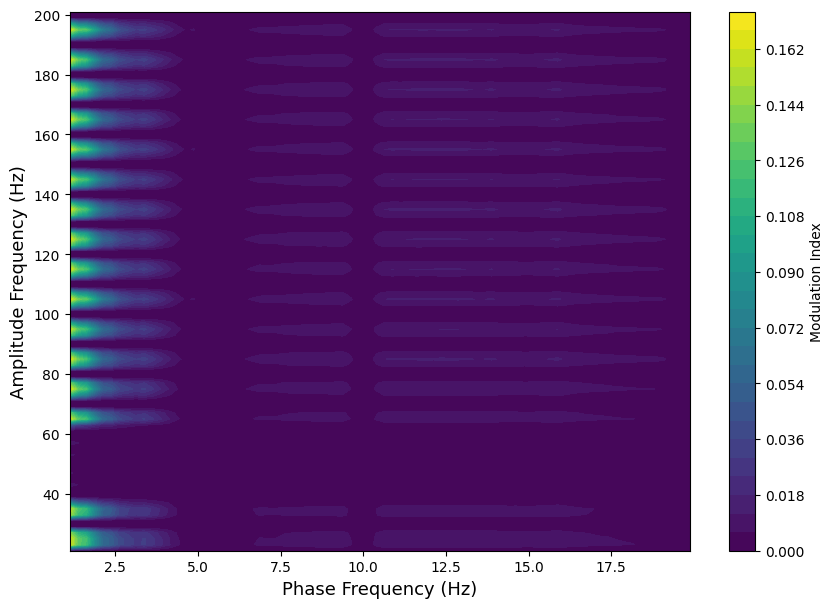

In [ ]:
from scipy.signal import butter,filtfilt
srate = 1000
nyq = 0.5*srate
phasevector = np.arange(-180,161,20)

# Phase-Amplitude comodulogram
LFP = clean_cfc_signal

phase_freq_vector = np.arange(1.,20.,.25)
fp_bandwidth = .25
amp_freq_vector = np.arange(20.,201.,2.)
fa_bandwidth = 2

MeanAmp = np.empty(len(phasevector))
Comodulogram = np.empty((len(phase_freq_vector),len(amp_freq_vector)))

for count_phase,fp in enumerate(phase_freq_vector):
    b,a = butter(3,[fp/nyq,(fp+fp_bandwidth)/nyq],'bandpass')
    filteredPhase = filtfilt(b,a,LFP)
    phase = np.angle(hilbert(filteredPhase))

    for count_amp,fa in enumerate(amp_freq_vector):
        b,a = butter(3,[fa/nyq,(fa+fa_bandwidth)/nyq],'bandpass')
        filteredAmp = filtfilt(b,a,LFP)
        amp = abs(hilbert(filteredAmp))

        for count,phasebin in enumerate(phasevector):
            I = (np.rad2deg(phase)>phasebin)*(np.rad2deg(phase)<(phasebin+20))
            MeanAmp[count] = np.mean(amp[I])

        p = MeanAmp/sum(MeanAmp)
        MI = (np.log(len(p))+sum(p[p>0]*np.log(p[p>0])))/np.log(len(p))
        Comodulogram[count_phase,count_amp] = MI

plt.figure(figsize=(10,7))
plt.contourf(phase_freq_vector+fp_bandwidth/2.,amp_freq_vector+fa_bandwidth/2.,Comodulogram.T,30)
plt.xlabel('Phase Frequency (Hz)',size=13)
plt.ylabel('Amplitude Frequency (Hz)',size=13)
plt.colorbar(label="Modulation Index");

In [ ]:
comod[3]

array([1.28855423e-03, 2.75942681e-04, 1.08741588e-04, 7.31409231e-04,
       6.15998321e-05, 1.18839281e-05, 1.22622920e-06, 1.97583380e-06,
       2.54061875e-06, 2.50491913e-06, 1.32312767e-06, 3.80494491e-06,
       8.06468726e-07, 2.07454726e-06, 2.09129222e-06, 2.07202431e-06,
       9.97319803e-07, 4.26793387e-07, 1.60329663e-06, 2.98645159e-06,
       1.59683690e-06, 1.04678856e-06, 1.60278948e-06, 1.22852315e-06,
       7.33923770e-07, 1.56760915e-06, 1.64798266e-06, 2.19262940e-06,
       9.13400164e-07, 1.42351899e-06, 1.65528195e-06, 4.32476729e-07,
       6.64839004e-07, 1.26124056e-06, 6.28563752e-07, 1.00036884e-06,
       2.07627715e-06, 1.57483435e-06, 1.98173869e-06, 9.64623532e-07,
       9.44279081e-07, 8.95494138e-07, 1.43959043e-06, 1.46509083e-06,
       2.41986316e-06, 2.21051431e-06, 1.12417714e-06, 7.70704878e-07,
       1.24324837e-06, 1.22134768e-06, 1.32239063e-06, 1.35773162e-06,
       1.18279064e-06, 9.23310356e-07, 1.76895352e-06, 1.73841351e-06,
      

In [ ]:
np.shape(bins_freq_norm)[0]

76

In [ ]:
testing = bins_freq_norm.copy()

In [ ]:
uniform_dist = np.ones(num_bins)/num_bins

In [ ]:
from scipy.stats import entropy

In [ ]:
entropies = [entropy(testing[i],uniform_dist)/np.log(num_bins) for i in range(len(testing))]

In [ ]:
len(entropies)

76

In [ ]:
MI = (np.log(len(p))+sum(p[p>0]*np.log(p[p>0])))/np.log(len(p))

In [ ]:
print(sum(bins_freq[0]))

3115.9001906811186


In [ ]:
bins_freq[:][0]

array([40.21123319, 39.6068238 , 42.89979044, 44.03997654, 41.14103278,
       40.90111414, 39.97285807, 40.57489176, 40.33854542, 40.35331461,
       41.13216559, 40.70212301, 40.80678171, 40.94119754, 41.7551959 ,
       40.76281391, 40.87879474, 40.86948226, 40.79628332, 40.79777937,
       40.93741389, 40.64686659, 40.69013162, 40.32502823, 41.02001799,
       40.9864148 , 40.87901866, 40.91472721, 40.89807945, 41.00261646,
       41.00265013, 40.74753656, 40.79097556, 41.12078966, 40.94659271,
       41.01040251, 41.26049665, 40.92232253, 41.26210575, 40.53942128,
       41.1155196 , 41.1534519 , 41.1874293 , 40.76219684, 40.65926118,
       41.21502747, 40.95626928, 41.02601821, 41.13614564, 41.45958741,
       40.95314679, 40.94454978, 40.61960392, 40.8508139 , 41.00482958,
       41.68327887, 40.86226584, 41.16452985, 42.40209396, 40.78769035,
       41.14373315, 40.91363207, 40.77079458, 41.3110218 , 41.27102922,
       41.22868772, 41.42413205, 41.13547637, 40.84149103, 41.55

(50, 76)

In [ ]:
current_amp

30

In [ ]:
bins_freq = np.zeros[[num_bins,]]

In [ ]:
indexes_in_phase_band = np.where((filtered_phases[0,:] > phasebins[phase_bin_id]) & (filtered_phases[0,:] < freqs_for_phases[phase_bin_id+1]) == True)[0]

In [ ]:
phases_vector = filtered_phases[0,:]

In [ ]:
np.where((phases_vector > phasebins[phase_bin_id]) & (phases_vector < phasebins[phase_bin_id+1]))[0]

array([  942,   943,   944,   945,   946,   947,   948,   949,   950,
         951,   952,   953,   954,   955,   956,   957,   958,   959,
         960,   961,   962,   963,   964,   965,  2170,  2171,  2172,
        2173,  2174,  2175,  2176,  2177,  2178,  2179,  2180,  2181,
        2182,  2183,  2184,  2185,  2186,  2187,  2188,  2189,  2190,
        2191,  2192,  3398,  3399,  3400,  3401,  3402,  3403,  3404,
        3405,  3406,  3407,  3408,  3409,  3410,  3411,  3412,  3413,
        3414,  3415,  3416,  3417,  3418,  3419,  3420,  4618,  4619,
        4620,  4621,  4622,  4623,  4624,  4625,  4626,  4627,  4628,
        4629,  4630,  4631,  4632,  4633,  4634,  4635,  4636,  4637,
        4638,  4639,  4640,  5843,  5844,  5845,  5846,  5847,  5848,
        5849,  5850,  5851,  5852,  5853,  5854,  5855,  5856,  5857,
        5858,  5859,  5860,  5861,  5862,  5863,  5864,  5865,  7077,
        7078,  7079,  7080,  7081,  7082,  7083,  7084,  7085,  7086,
        7087,  7088,

In [ ]:
test1 = np.where(filtered_phases[0,:] > phasebins[phase_bin_id])

In [ ]:
test1

(array([    0,     1,     2, ..., 23747, 23748, 23749]),)

In [ ]:
test2 = np.where(filtered_phases[0,:] < phasebins[phase_bin_id+1])

In [ ]:
test2

(array([  799,   800,   801,   802,   803,   804,   805,   806,   807,
          808,   809,   810,   811,   812,   813,   814,   815,   816,
          817,   818,   819,   820,   821,   822,  2025,  2026,  2027,
         2028,  2029,  2030,  2031,  2032,  2033,  2034,  2035,  2036,
         2037,  2038,  2039,  2040,  2041,  2042,  2043,  2044,  2045,
         2046,  2047,  2048,  2049,  3254,  3255,  3256,  3257,  3258,
         3259,  3260,  3261,  3262,  3263,  3264,  3265,  3266,  3267,
         3268,  3269,  3270,  3271,  3272,  3273,  3274,  3275,  3276,
         3277,  4475,  4476,  4477,  4478,  4479,  4480,  4481,  4482,
         4483,  4484,  4485,  4486,  4487,  4488,  4489,  4490,  4491,
         4492,  4493,  4494,  4495,  4496,  4497,  4498,  5699,  5700,
         5701,  5702,  5703,  5704,  5705,  5706,  5707,  5708,  5709,
         5710,  5711,  5712,  5713,  5714,  5715,  5716,  5717,  5718,
         5719,  5720,  5721,  5722,  6934,  6935,  6936,  6937,  6938,
      

In [ ]:
test = np.where((filtered_phases[0,:] < phasebins[phase_bin_id]) < freqs_for_phases[phase_bin_id+1])[0]

In [ ]:
test

array([    0,     1,     2, ..., 23747, 23748, 23749])

In [ ]:
phasebins[phase_bin_id],phasebins[phase_bin_id+1]

(-3.141592653589793, -3.015928947446201)

inside the _amplitudes_ loop, in which each iteration has a target high-frequency band of the LFP signal:


1.   create a matrix with (num_bins-1) $\times$ num_freqs elements (called bins_freq)
2.   for phase_bin_id,bin_limits enumerate(phasebins):
          for band_id,band_signal in enumerate(filtered_phases):
              phasepoints_in_frequency_bin = np.where((band_signal > bin_limits[0]) * (band_signal < bin_limits))
              mean_amplitude_in_frequency_bin = np.mean(current_amp[phasepoints_in_frequency_bin])
              bins_freq[band_id,phase_bin_id] = mean_amplitude_in_frequency_bin
3. modulation_probs = bins_freq/np.sum(bins_freq,axis=0)
4. MI[]


In [ ]:
def comodulogram2(lfp,ind_band=[1,20],dep_band=[20,200],ind_step=2,dep_step=5,
                  ind_bandwidth=4,dep_bandwidth=10,num_bins=18,sampling_rate=1250):

    bin_size = round(360/num_bins)
    phasevector = np.arange(-180,180-bin_size+1,bin_size)
    phase_freq_vector = np.arange(ind_band[0],ind_band[1],ind_step)
    amp_freq_vector = np.arange(dep_band[0],dep_band[1],dep_step)

    mean_amp = np.empty(num_bins)
    comodulogram = np.empty((len(phase_freq_vector),len(amp_freq_vector)))

    from scipy.signal import hilbert
    for count_phase,fp in enumerate(phase_freq_vector):
        ind_analytic = hilbert(band_extraction(lfp,cutoff_low=fp,cutoff_high=fp+ind_bandwidth,
                                               sampling_rate=sampling_rate))
        phase = np.angle(ind_analytic)

        for count_amp,fa in enumerate(amp_freq_vector):
            dep_analytic = hilbert(band_extraction(lfp,cutoff_low=fa,cutoff_high=fa+dep_bandwidth,
                                                   sampling_rate=sampling_rate))
            amplitude = abs(dep_analytic)

            for count,phasebin in enumerate(phasevector):
                I = (np.rad2deg(phase)>phasebin)*(np.rad2deg(phase)<(phasebin+20))
                mean_amp[count] = np.mean(amplitude[I])

            p = mean_amp/sum(mean_amp)
            MI = (np.log(len(p))+sum(p[p>0]*np.log(p[p>0])))/np.log(len(p))
            comodulogram[count_phase,count_amp] = MI

    return comodulogram,phase_freq_vector,amp_freq_vector


In [ ]:
phasebins

array([-3.14159265e+00, -3.01592895e+00, -2.89026524e+00, -2.76460154e+00,
       -2.63893783e+00, -2.51327412e+00, -2.38761042e+00, -2.26194671e+00,
       -2.13628300e+00, -2.01061930e+00, -1.88495559e+00, -1.75929189e+00,
       -1.63362818e+00, -1.50796447e+00, -1.38230077e+00, -1.25663706e+00,
       -1.13097336e+00, -1.00530965e+00, -8.79645943e-01, -7.53982237e-01,
       -6.28318531e-01, -5.02654825e-01, -3.76991118e-01, -2.51327412e-01,
       -1.25663706e-01,  4.44089210e-16,  1.25663706e-01,  2.51327412e-01,
        3.76991118e-01,  5.02654825e-01,  6.28318531e-01,  7.53982237e-01,
        8.79645943e-01,  1.00530965e+00,  1.13097336e+00,  1.25663706e+00,
        1.38230077e+00,  1.50796447e+00,  1.63362818e+00,  1.75929189e+00,
        1.88495559e+00,  2.01061930e+00,  2.13628300e+00,  2.26194671e+00,
        2.38761042e+00,  2.51327412e+00,  2.63893783e+00,  2.76460154e+00,
        2.89026524e+00,  3.01592895e+00,  3.14159265e+00])

In [ ]:
np.shape(signal)

(472500,)

In [ ]:
mean_amp

48.16603650264057

array([  356,   357,   358,   359,   360,   361,   362,   363,   364,
         365,   366,   367,   368,   369,   370,   371,   372,   373,
         374,   375,   376,   377,   378,   379,   380,   381,   382,
         383,   384,   385,   386,   387,   388,   389,   390,   391,
         392,   393,   394,   395,   396,   397,   398,   399,   400,
         401,   402,   403,   404,   405,   406,   407,   408,  1589,
        1590,  1591,  1592,  1593,  1594,  1595,  1596,  1597,  1598,
        1599,  1600,  1601,  1602,  1603,  1604,  1605,  1606,  1607,
        1608,  1609,  1610,  1611,  1612,  1613,  1614,  1615,  1616,
        1617,  1618,  1619,  1620,  1621,  1622,  1623,  1624,  1625,
        1626,  1627,  1628,  1629,  1630,  1631,  1632,  1633,  1634,
        1635,  1636,  1637,  1638,  1639,  1640,  2818,  2819,  2820,
        2821,  2822,  2823,  2824,  2825,  2826,  2827,  2828,  2829,
        2830,  2831,  2832,  2833,  2834,  2835,  2836,  2837,  2838,
        2839,  2840,

In [ ]:
np.where(points_in_phase == True)[0][0:50]

NameError: ignored

[ 356  357  358  359  360  361  362  363  364  365  366  367  368  369
  370  371  372  373  374  375  376  377  378  379  380  381  382  383
  384  385  386  387  388  389  390  391  392  393  394  395  396  397
  398  399  400  401  402  403  404  405  406  407  408 1589 1590 1591
 1592 1593 1594 1595 1596 1597 1598 1599 1600 1601 1602 1603 1604 1605
 1606 1607 1608 1609 1610 1611 1612 1613 1614 1615 1616 1617 1618 1619
 1620 1621 1622 1623 1624 1625 1626 1627 1628 1629 1630 1631 1632 1633
 1634 1635]


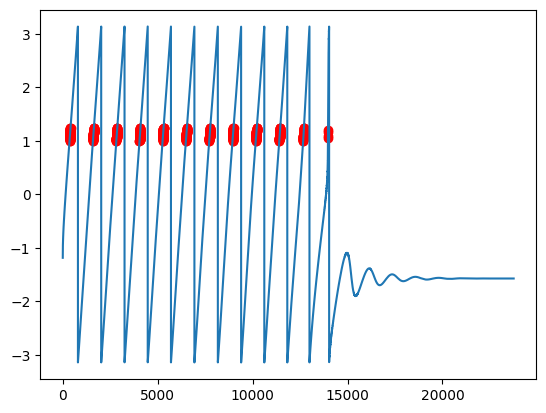

In [ ]:
for point_to_color in np.where(points_in_phase == True):
  print(point_to_color[0:100])
  #points.append(point_to_color)
  #print(point_to_color)
  #counter+=1
  #if counter == 10:
  #  break
  plt.plot(filtered_phases[0,:])
  plt.scatter(point_to_color,filtered_phases[0,point_to_color],color='red')

  break

In [ ]:
np.shape((filtered_phases[index])*(filtered_phases[index+1]))

(23750,)

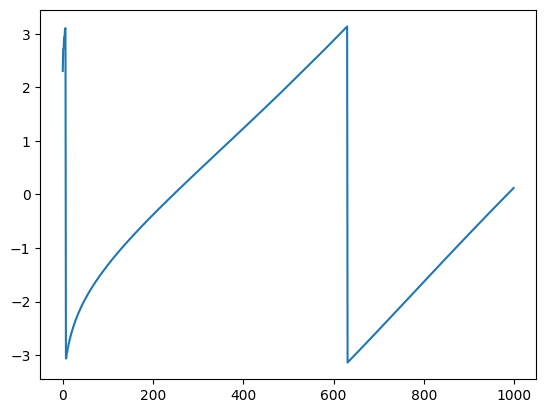

In [ ]:
plt.plot(filtered_phases[index+1][0:1000])

In [ ]:
np.shape(filtered_phases)

(76, 23750)

In [ ]:
len(filtered_phases)

76

In [ ]:
num_bins = 50
phasebins = np.linspace(-np.pi,np.pi,num_bins+1)
phasecenters = phasebins[0:-1] + (phasebins[1] - phasebins[0])

In [ ]:
%% Wavelet Transform LFP in intervals
comod = zeros(length(amprange)-1,length(filtered_phase));
for apr = 1:length(amprange)-1
    wavespec_amp = bz_WaveSpec(lfp,'frange',[amprange(apr) amprange(apr+1)],'nfreqs',1);

    wavespec_amp.data = abs(wavespec_amp.data);
    %% Bin phase and power
    numbins = 50;
    phasebins = linspace(-pi,pi,numbins+1);
    phasecenters = phasebins(1:end-1)+(phasebins(2)-phasebins(1));

    for idx = 1:length(filtered_phase)
        [phasedist,~,phaseall] = histcounts(filtered_phase(idx).phase,phasebins);

        phaseAmp = zeros(numbins,1);
        for bb = 1:numbins
            phaseAmp(bb) = mean(wavespec_amp.data(phaseall==bb),1);
        end

        phaseAmp = phaseAmp./sum(phaseAmp,1);
        comod(apr,idx) = sum(phaseAmp.*log(phaseAmp./(ones(numbins,size(phaseAmp,2))/numbins)))/log(numbins);
    end

end

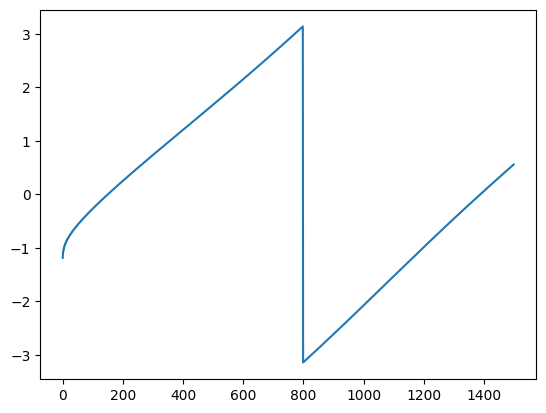

In [ ]:
plt.plot(filtered_phases[0,0:1500])

In [ ]:
lfp.lfp

117501   -526
117502   -697
117503   -343
117504   -161
117505    -38
         ... 
141246   -100
141247    -64
141248   -131
141249   -192
141250   -212
Name: lfp, Length: 23750, dtype: int16

In [ ]:
parfor bnd = 1:length(phaserange)-1
    filtered_phase(bnd,:) = bz_Filter(lfp,'passband',phaserange(bnd:bnd+1),'filter','fir1');
end

In [ ]:
def comodulogram3(lfp,ind_band=[1,20],dep_band=[20,200],ind_step=.25,dep_step=2,
                  ind_bandwidth=4,dep_bandwidth=10,num_bins=50,sampling_rate=1250):


    num_ind_freqs = int((ind_band[1] - ind_band[0])/ind_step)
    num_dep_freqs = int((dep_band[1] - dep_band[0])/dep_step)
    phase_freq_vector = np.linspace(ind_band[0],ind_band[1],num_ind_freqs+1)
    amp_freq_vector = np.linspace(dep_band[0],dep_band[1],num_dep_freqs)

    print(num_ind_freqs)
    print(num_dep_freqs)
    print(phase_freq_vector)
    print(amp_freq_vector)

    filtered_phases = np.empty([num_ind_freqs,len(lfp)])

    from scipy.signal import hilbert

    for phase_index,phase in enumerate(phase_freq_vector[0:-1]):
      filtered_phases[phase_index,:] = np.angle(hilbert(band_extraction(lfp,cutoff_low=phase,cutoff_high=phase+ind_step,
                                               sampling_rate=sampling_rate)))

    print(filtered_phases)

    phasebins = np.linspace(-np.pi,np.pi,num_bins+1)
    print(phasebins)

    for amp_index,freq_for_amp_extraction in enumerate(amp_freq_vector[0:-1]):
      amplitudes_at_freq = abs(hilbert(band_extraction(lfp,cutoff_low=freq_for_amp_extraction,cutoff_high=freq_for_amp_extraction+dep_step,
                                                   sampling_rate=sampling_rate)))



    #bin_size = round(360/num_bins)
    #phasevector = np.arange(-180,180-bin_size+1,bin_size)
    #phase_freq_vector = np.arange(ind_band[0],ind_band[1],ind_step)
    #amp_freq_vector = np.arange(dep_band[0],dep_band[1],dep_step)

    mean_amp = np.empty(num_bins)
    comodulogram = np.empty((len(phase_freq_vector),len(amp_freq_vector)))

    for count_phase,fp in enumerate(phase_freq_vector):
        ind_analytic = hilbert(band_extraction(lfp,cutoff_low=fp,cutoff_high=fp+ind_bandwidth,
                                               sampling_rate=sampling_rate))
        phase = np.angle(ind_analytic)

        for count_amp,fa in enumerate(amp_freq_vector):
            dep_analytic = hilbert(band_extraction(lfp,cutoff_low=fa,cutoff_high=fa+dep_bandwidth,
                                                   sampling_rate=sampling_rate))
            amplitude = abs(dep_analytic)

            for count,phasebin in enumerate(phasevector):
                I = (np.rad2deg(phase)>phasebin)*(np.rad2deg(phase)<(phasebin+20))
                mean_amp[count] = np.mean(amplitude[I])

            p = mean_amp/sum(mean_amp)
            MI = (np.log(len(p))+sum(p[p>0]*np.log(p[p>0])))/np.log(len(p))
            comodulogram[count_phase,count_amp] = MI

    return comodulogram,phase_freq_vector,amp_freq_vector

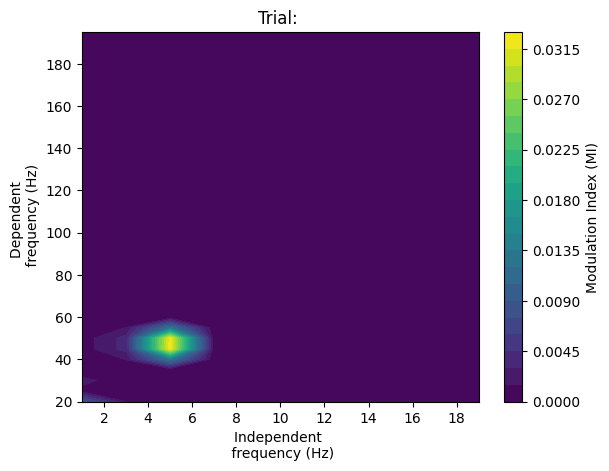

In [ ]:
lfp = clean_cfc_signal

comod,phfreqs,ampfreqs = comodulogram2(lfp,ind_bandwidth = 0.5,dep_bandwidth = 5,sampling_rate=1000)
plot_comodulogram(comod,phfreqs,ampfreqs)

In [ ]:
lfp = clean_cfc_signal

comod,phfreqs,ampfreqs = comodulogram3(lfp,ind_bandwidth = .25,dep_bandwidth = 5,sampling_rate=1000)
plot_comodulogram(comod,phfreqs,ampfreqs)

76
90
[ 1.    1.25  1.5   1.75  2.    2.25  2.5   2.75  3.    3.25  3.5   3.75
  4.    4.25  4.5   4.75  5.    5.25  5.5   5.75  6.    6.25  6.5   6.75
  7.    7.25  7.5   7.75  8.    8.25  8.5   8.75  9.    9.25  9.5   9.75
 10.   10.25 10.5  10.75 11.   11.25 11.5  11.75 12.   12.25 12.5  12.75
 13.   13.25 13.5  13.75 14.   14.25 14.5  14.75 15.   15.25 15.5  15.75
 16.   16.25 16.5  16.75 17.   17.25 17.5  17.75 18.   18.25 18.5  18.75
 19.   19.25 19.5  19.75 20.  ]
[ 20.          22.02247191  24.04494382  26.06741573  28.08988764
  30.11235955  32.13483146  34.15730337  36.17977528  38.20224719
  40.2247191   42.24719101  44.26966292  46.29213483  48.31460674
  50.33707865  52.35955056  54.38202247  56.40449438  58.42696629
  60.4494382   62.47191011  64.49438202  66.51685393  68.53932584
  70.56179775  72.58426966  74.60674157  76.62921348  78.65168539
  80.6741573   82.69662921  84.71910112  86.74157303  88.76404494
  90.78651685  92.80898876  94.83146067  96.85393258  98.87640

NameError: ignored

In [ ]:
lfp = clean_cfc_signal
ind_band=[1,20]
dep_band=[20,200]
ind_step=2
dep_step=5
ind_bandwidth=4
dep_bandwidth=10
num_bins=50
sampling_rate=1000

num_bins = 50
#bin_size = round(360/num_bins)
#phasevector = np.arange(-180,180-bin_size+1,bin_size)

phasebins = np.linspace(-np.pi,np.pi,num_bins+1)

phase_freq_vector = np.arange(ind_band[0],ind_band[1],ind_step)
amp_freq_vector = np.arange(dep_band[0],dep_band[1],dep_step)

mean_amp = np.empty(num_bins+1)
comodulogram = np.empty((len(phase_freq_vector),len(amp_freq_vector)))

from scipy.signal import hilbert
for count_phase,fp in enumerate(phase_freq_vector):
    ind_analytic = hilbert(band_extraction(lfp,cutoff_low=fp,cutoff_high=fp+ind_step,
                                            sampling_rate=sampling_rate))
    phase = np.angle(ind_analytic)

    for count_amp,fa in enumerate(amp_freq_vector):
        dep_analytic = hilbert(band_extraction(lfp,cutoff_low=fa,cutoff_high=fa+dep_step,
                                                sampling_rate=sampling_rate))
        amplitude = abs(dep_analytic)

        for count,phasebin in enumerate(phasebins[0:-1]):
            #print(phase)
            I = (phase>phasebin)*(phase<(phasebin+phasebins[count+1]))
            #print(I)
            mean_amp[count] = np.mean(amplitude[I])

            p = mean_amp/sum(mean_amp)
            MI = (np.log(len(p))+sum(p[p>0]*np.log(p[p>0])))/np.log(len(p))
            comodulogram[count_phase,count_amp] = MI

NameError: ignored

In [ ]:
for item in enumerate(phasebins):
  print(item,'\n')

(0, -3.141592653589793) 

(1, -3.015928947446201) 

(2, -2.8902652413026098) 

(3, -2.764601535159018) 

(4, -2.6389378290154264) 

(5, -2.5132741228718345) 

(6, -2.3876104167282426) 

(7, -2.2619467105846507) 

(8, -2.1362830044410592) 

(9, -2.0106192982974678) 

(10, -1.8849555921538759) 

(11, -1.759291886010284) 

(12, -1.6336281798666923) 

(13, -1.5079644737231006) 

(14, -1.3823007675795087) 

(15, -1.256637061435917) 

(16, -1.1309733552923253) 

(17, -1.0053096491487334) 

(18, -0.879645943005142) 

(19, -0.7539822368615501) 

(20, -0.6283185307179586) 

(21, -0.5026548245743667) 

(22, -0.3769911184307748) 

(23, -0.25132741228718336) 

(24, -0.12566370614359146) 

(25, 4.440892098500626e-16) 

(26, 0.1256637061435919) 

(27, 0.2513274122871838) 

(28, 0.3769911184307757) 

(29, 0.5026548245743672) 

(30, 0.6283185307179591) 

(31, 0.7539822368615505) 

(32, 0.8796459430051424) 

(33, 1.0053096491487343) 

(34, 1.1309733552923262) 

(35, 1.2566370614359172) 

(36, 1.3823007

In [ ]:
from scipy.signal import hilbert
max(np.angle(hilbert(clean_cfc_signal)))

3.141592653589793

In [ ]:
num_bins = 50
bin_size = round(360/num_bins)
phasevector = np.arange(-180,180-bin_size+1,bin_size)

In [ ]:
numbins = 50
phasebins = np.linspace(-np.pi,np.pi,numbins+1)
#phasecenters = phasebins(1:end-1)+(phasebins(2)-phasebins(1));

In [ ]:
phasebins

array([-3.14159265e+00, -3.01592895e+00, -2.89026524e+00, -2.76460154e+00,
       -2.63893783e+00, -2.51327412e+00, -2.38761042e+00, -2.26194671e+00,
       -2.13628300e+00, -2.01061930e+00, -1.88495559e+00, -1.75929189e+00,
       -1.63362818e+00, -1.50796447e+00, -1.38230077e+00, -1.25663706e+00,
       -1.13097336e+00, -1.00530965e+00, -8.79645943e-01, -7.53982237e-01,
       -6.28318531e-01, -5.02654825e-01, -3.76991118e-01, -2.51327412e-01,
       -1.25663706e-01,  4.44089210e-16,  1.25663706e-01,  2.51327412e-01,
        3.76991118e-01,  5.02654825e-01,  6.28318531e-01,  7.53982237e-01,
        8.79645943e-01,  1.00530965e+00,  1.13097336e+00,  1.25663706e+00,
        1.38230077e+00,  1.50796447e+00,  1.63362818e+00,  1.75929189e+00,
        1.88495559e+00,  2.01061930e+00,  2.13628300e+00,  2.26194671e+00,
        2.38761042e+00,  2.51327412e+00,  2.63893783e+00,  2.76460154e+00,
        2.89026524e+00,  3.01592895e+00,  3.14159265e+00])

In [ ]:
np.deg2rad(phasevector)

array([-3.14159265, -3.01941961, -2.89724656, -2.77507351, -2.65290046,
       -2.53072742, -2.40855437, -2.28638132, -2.16420827, -2.04203522,
       -1.91986218, -1.79768913, -1.67551608, -1.55334303, -1.43116999,
       -1.30899694, -1.18682389, -1.06465084, -0.9424778 , -0.82030475,
       -0.6981317 , -0.57595865, -0.45378561, -0.33161256, -0.20943951,
       -0.08726646,  0.03490659,  0.15707963,  0.27925268,  0.40142573,
        0.52359878,  0.64577182,  0.76794487,  0.89011792,  1.01229097,
        1.13446401,  1.25663706,  1.37881011,  1.50098316,  1.6231562 ,
        1.74532925,  1.8675023 ,  1.98967535,  2.11184839,  2.23402144,
        2.35619449,  2.47836754,  2.60054059,  2.72271363,  2.84488668,
        2.96705973])

In [ ]:
'''
1. Choose the frequencies in which to filter the LFP for the modulating phase extraction (min_freq:steps:max_freq); in his dissertation he said it was 0.5-20 Hz in steps of 0.25 Hz.

'''

In [ ]:
step_size = 0.25
slow_bands = np.arange(0.5,20 + step_size,step_size)

In [ ]:
os.getcwd()

'/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/data/separated_channels/rat4_day2_LFP_all'

In [ ]:
mdic = {"simulated_cfc": clean_cfc_signal,"sampling_rate":1000,"modulating_modulated_freqs":[5,50]}
scipy.io.savemat("/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/data/separated_channels/rat4_day2_LFP_all/matlab_simulated_cfc_signal.mat",mdic)

In [ ]:
for band in slow_bands[0:-1]:
  print(band,band+step_size)
  break

0.5 0.75


In [ ]:
###phaserange     [min:steps:max] array of frequencies to filter for the
###                   phase signal
###amprange       [min:stepsmax] array of frequencies range for wavelets
###                   for the power signal

function [comod] = bz_ModIndex(lfp,phaserange,amprange,flagPlot)

nfreqs = length(amprange);

%% Filter LFP for phase
parfor bnd = 1:length(phaserange)-1
    filtered_phase(bnd,:) = bz_Filter(lfp,'passband',phaserange(bnd:bnd+1),'filter','fir1');
end

%% Wavelet Transform LFP in intervals
comod = zeros(length(amprange)-1,length(filtered_phase));
for apr = 1:length(amprange)-1
    wavespec_amp = bz_WaveSpec(lfp,'frange',[amprange(apr) amprange(apr+1)],'nfreqs',1);

    wavespec_amp.data = abs(wavespec_amp.data);
    %% Bin phase and power
    numbins = 50;
    phasebins = linspace(-pi,pi,numbins+1);
    phasecenters = phasebins(1:end-1)+(phasebins(2)-phasebins(1));

    for idx = 1:length(filtered_phase)
        [phasedist,~,phaseall] = histcounts(filtered_phase(idx).phase,phasebins);

        phaseAmp = zeros(numbins,1);
        for bb = 1:numbins
            phaseAmp(bb) = mean(wavespec_amp.data(phaseall==bb),1);
        end

        phaseAmp = phaseAmp./sum(phaseAmp,1);
        comod(apr,idx) = sum(phaseAmp.*log(phaseAmp./(ones(numbins,size(phaseAmp,2))/numbins)))/log(numbins);
    end

end

### end of Eliezyer's code translation

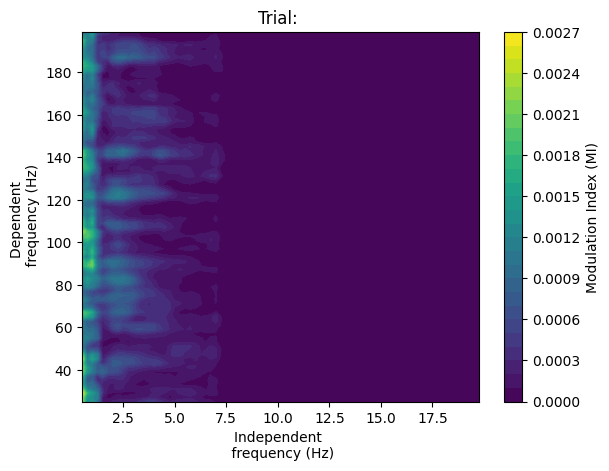

In [ ]:
for awake_state_begin,awake_state_end in awake_timestamps[1:5]:
  awake_state = lfp.query(f'timestamps > {awake_state_begin} and timestamps <= {awake_state_end}')
  LFP = awake_state.lfp.values

  comod_awake,ind_freqs_awake,dep_freqs_awake = comodulogram2(awake_state.lfp.values,ind_band = [0.5,20],dep_band=[25,200],ind_step=0.25,dep_step=2,
                  ind_bandwidth=5,dep_bandwidth=10)

  plot_comodulogram(comod_awake,ind_freqs_awake,dep_freqs_awake)
  plt.show()
  break

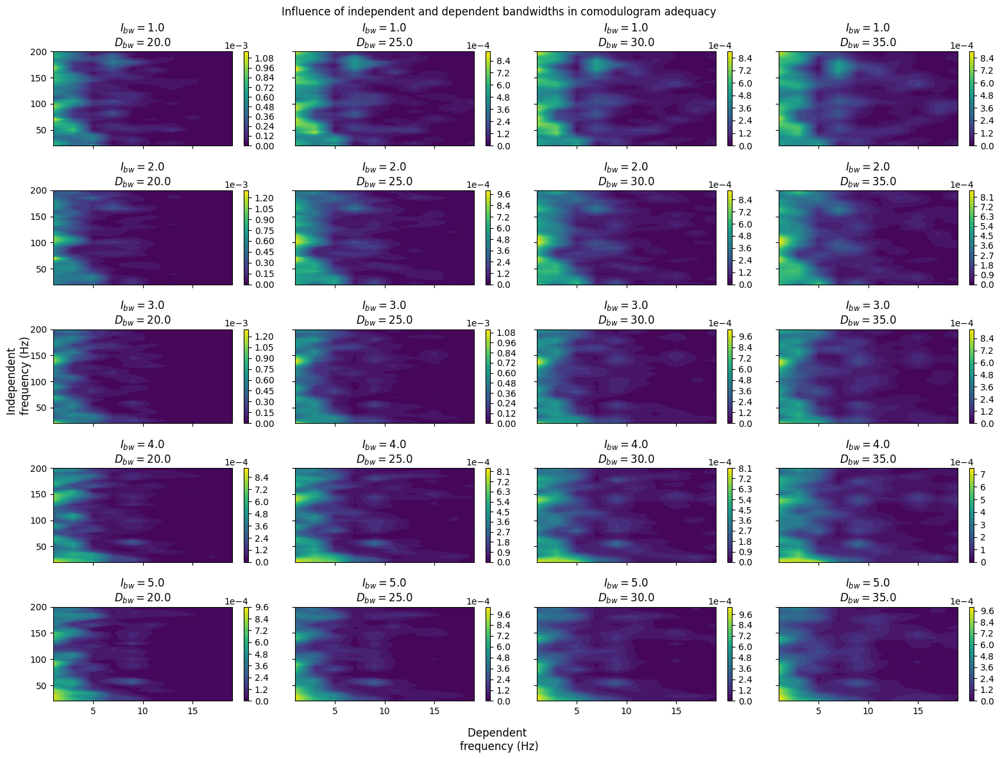

In [ ]:
bandwidth_dependence_panel(awake_state.lfp.values,ind_coverage=[1,5],dep_coverage=[20,36],ind_step = 1,dep_step = 5)

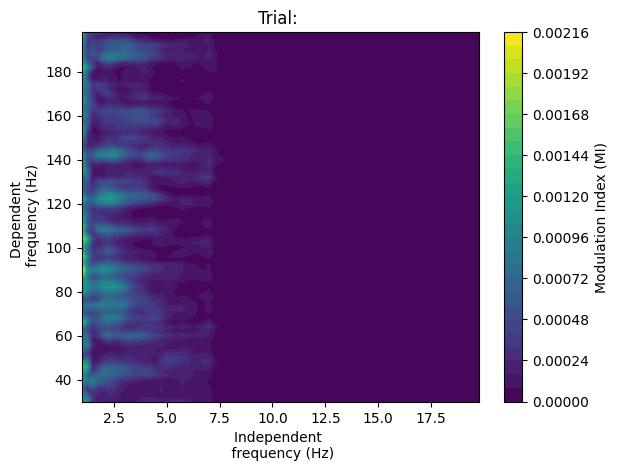

In [ ]:
for awake_state_begin,awake_state_end in awake_timestamps[1:5]:
  awake_state = lfp.query(f'timestamps >= {awake_state_begin} and timestamps <= {awake_state_end}')
  LFP = awake_state.lfp.values

  comod_awake,ind_freqs_awake,dep_freqs_awake = comodulogram2(LFP,ind_band = [1,20],dep_band=[30,200],ind_step=0.25,dep_step=2,
                  ind_bandwidth=5,dep_bandwidth=10)

  plot_comodulogram(comod_awake,ind_freqs_awake,dep_freqs_awake)
  plt.show()
  break

In [ ]:
comod_awake

array([[2.05346535e-03, 1.83972621e-03, 2.19596806e-03, ...,
        1.18659668e-03, 9.43807694e-04, 9.00388901e-04],
       [1.46780180e-03, 1.53060108e-03, 1.85451722e-03, ...,
        9.85760472e-04, 9.03029376e-04, 7.90870968e-04],
       [1.21907030e-03, 1.10918831e-03, 1.49127704e-03, ...,
        1.14725714e-03, 8.73647101e-04, 7.12539151e-04],
       ...,
       [3.02161856e-06, 2.35959886e-06, 2.82697859e-06, ...,
        2.61699764e-06, 2.26838577e-06, 1.82061682e-06],
       [5.53610730e-06, 5.40414861e-06, 6.77617221e-06, ...,
        2.39751336e-06, 2.27544410e-06, 2.89764207e-06],
       [4.00451716e-06, 3.24047969e-06, 3.53764234e-06, ...,
        3.06411981e-06, 3.02534968e-06, 2.49277658e-06]])

In [ ]:
awake_state = lfp.query(f'timestamps > {awake_timestamps[2][0]} and timestamps <= {awake_timestamps[2][1]}')
LFP = awake_state.lfp.values
print(len(LFP))

1046250


In [ ]:
%time

band_extraction(LFP,cutoff_low=0.5,cutoff_high=0.75,sampling_rate=1250)
band_extraction(LFP,cutoff_low=20,cutoff_high=22,sampling_rate=1250)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 8.34 µs


array([8.71264128e-01, 7.09112565e+00, 1.32784708e+01, ...,
       2.01497190e-03, 1.87483048e-03, 1.71332900e-03])

In [ ]:
awake_timestamps[2][1] - awake_timestamps[2][0]

837

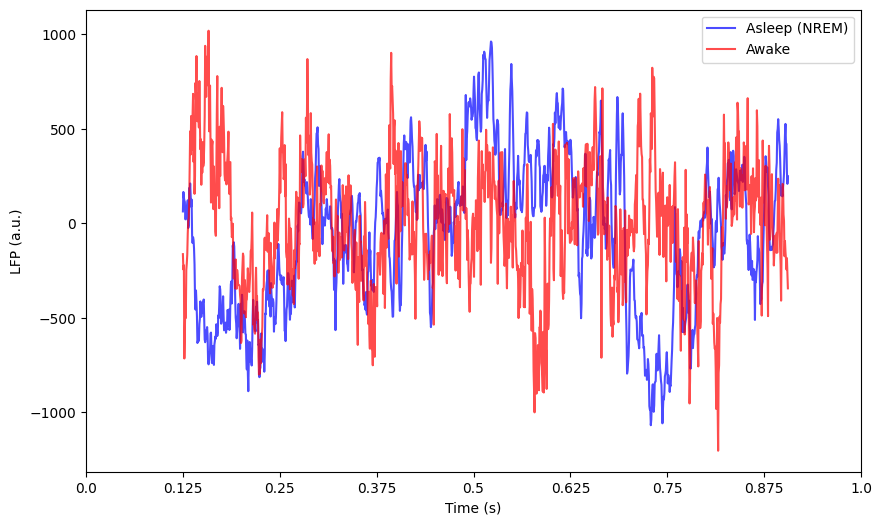

In [ ]:
plt.figure(figsize=(10,6))

plt.plot(first_asleep_state.lfp.values[0:1250],alpha=0.7,color='blue',label='Asleep (NREM)')
plt.plot(first_awake_state.lfp.values[0:1250],alpha=0.7,color='red',label='Awake')
plt.xticks(ticks=plt.xticks()[0],labels=np.linspace(0,1,len(plt.xticks()[0])))
plt.xlabel('Time (s)')
plt.ylabel('LFP (a.u.)')

plt.legend()

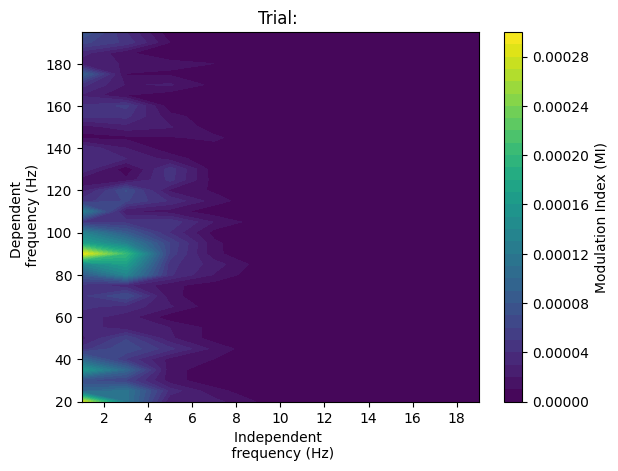

In [ ]:
comod_sleep,ind_freqs_sleep,dep_freqs_sleep = comodulogram2(first_asleep_state.lfp.values)
plot_comodulogram(comod_sleep,ind_freqs_sleep,dep_freqs_sleep)

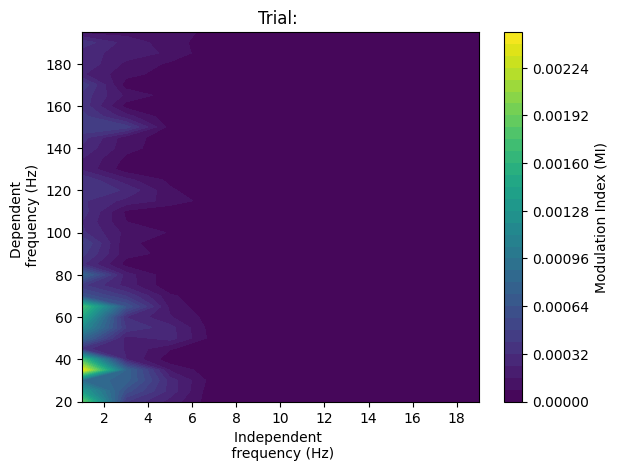

In [ ]:
comod_awake,ind_freqs_awake,dep_freqs_awake = comodulogram2(first_awake_state.lfp.values)
plot_comodulogram(comod_awake,ind_freqs_awake,dep_freqs_awake)

In [ ]:
#This encodes the statenames ('NREM','WAKE','events_pathological') that are actually featured in the dataset
#np.unique(data_states['SleepState'][0][0][1][0][0][0])

#I have no clue of what this encompasses; it says it is 'timestamps', but of what exactly does not ring a bell
#np.unique(data_states['SleepState'][0][0][1][0][0][1])

#This vector encompasses the different states: 1 = Wake, 2 = Pathological, 3 = NREM Sleep, NaN = REM Sleep
#np.unique(data_states['SleepState'][0][0][1][0][0][2])

In [ ]:
data_episodes['SleepStateEpisodes']

array([[(array([[(array([[ 2632,  3010],
                       [ 7280,  8335],
                       [ 8816,  9239],
                       [ 9403,  9542],
                       [ 9904, 10549],
                       [10853, 11536],
                       [11910, 12057]], dtype=uint16), array([], shape=(0, 2), dtype=uint8), array([[    1,  1343],
                       [ 1405,  1715],
                       [ 1768,  2631],
                       [ 3011,  7279],
                       [ 8336,  8815],
                       [ 8971,  9011],
                       [ 9240,  9402],
                       [ 9543,  9903],
                       [10550, 10852],
                       [10993, 11017],
                       [11152, 11175],
                       [11246, 11267],
                       [11537, 11909],
                       [12058, 12104]], dtype=uint16), array([[ 2632,  3010],
                       [ 7280,  8335],
                       [ 8816,  8891],
                       [

In [ ]:
data_scores['SleepScoreLFP']

array([[(array([[530],
               [415],
               [152],
               ...,
               [  0],
               [  0],
               [  0]], dtype=int16), array([[493],
               [357],
               [ 64],
               ...,
               [  0],
               [  0],
               [  0]], dtype=int16), array([[17]], dtype=uint8), array([[19]], dtype=uint8), array([[250]], dtype=uint8), array([[0.0000000e+00],
               [4.0000000e-03],
               [8.0000000e-03],
               ...,
               [1.2106396e+04],
               [1.2106400e+04],
               [1.2106404e+04]]), array([[(array([[ 4.        ,  4.12779766,  4.25967838,  4.39577262,  4.53621498,
                         4.6811444 ,  4.83070422,  4.9850424 ,  5.14431159,  5.30866933,
                         5.47827821,  5.653306  ,  5.83392582,  6.02031634,  6.21266192,
                         6.41115284,  6.61598542,  6.82736229,  7.04549252,  7.27059189,
                         7.502883

In [ ]:
data_states = sio.loadmat('./data/state_scoring/rat4_day2/2017-05-07_13-57-27.SleepState.states.mat')
2017-05-07_13-57-27.SleepState.states.mat

# throwaway

### profiling and optimizing split_lfp_trials()

In [ ]:
pip install line_profiler

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 662.2/662.2 kB 11.1 MB/s eta 0:00:00


In [ ]:
%load_ext line_profiler

In [ ]:
%lprun -f split_lfp_trials split_lfp_trials(session_data,lfp,rat,day,region)

done parsing the LFP into trials


In [ ]:
def split_lfp_trials(session_df,lfp_df,rat_id,day_id,region_id,min_duration=0.8,sampling_rate=1250,
                      slicing='first',peri_trial_inclusion = 0,per_slice=800):
    elegible_trials = session_df.query(f"rat == {rat_id} & day == {day_id} &\
    region == '{region_id}' & duration >= {min_duration}")
    elegible_trials = elegible_trials.sort_values('trial').copy()

    #separate the lfp df into a dictionary of trials, whose keys are trial identifiers and
    #values are dfs corresponding to excerpts of the whole lfp signal that fall between
    #each trials' time boundaries [trial begin, trial end]

    trials_dict = {}
    for trial in elegible_trials.trial.unique():
        '''upon profiling this function to probe its performance I have concluded it is very slow
        the pieces of code that were taking too long were these queries below, so I'll comment them out and implement another querying method (expression matching on Series.values)
        nonetheless, I will leave them for the sake of comprehension of what is going on in the following expression, which yields the same but in a fraction of the elapsed time
        '''

        #select the current trial in the behavioral/spikes dataframe
        #current_trial = elegible_trials.query(f"trial == {int(trial)}")
        current_trial = elegible_trials[elegible_trials.trial.values == int(trial)]

        #extract the timestamps for the beginning and end of trial using the 1st
        #spike (begin) and total duration (end)
        begin = current_trial.iloc[0].timestamp - current_trial.iloc[0].time
        end = begin + current_trial.iloc[0].duration

        #fetch the lfp data within these two timepoints and add to the dict as our trial
        #current_lfp = lfp_df.query(f"timestamps >= {begin-peri_trial_inclusion} & timestamps <= {end}")
        current_lfp = lfp_df[(lfp_df.timestamps.values >= (begin-peri_trial_inclusion)) & (lfp_df.timestamps.values <= end)]

        if slicing == 'first':
                trials_dict[f'trial_{int(trial)}'] = current_lfp.head(per_slice)
        elif slicing == 'last':
            trials_dict[f'trial_{int(trial)}'] = current_lfp.tail(per_slice)
        elif slicing == 'none':
            trials_dict[f'trial_{int(trial)}'] = current_lfp
    print('done parsing the LFP into trials')

    return trials_dict

In [ ]:
rat = 3
day = 1
channel = 0
min_duration = .8
peri_trial_inclusion = .5
lfp,channel,region = load_lfp(rat_id = rat,day_id = day,channel_id = channel)

In [ ]:
%%timeit
elegible_trials = session_data.query(f"rat == {rat} & day == {day} & region == '{region}' & duration >= {min_duration}")

89.8 ms ± 19.1 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [ ]:
a = elegible_trials.copy()

In [ ]:
%%timeit
b = a.sort_values('trial').copy()

10.1 ms ± 833 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [ ]:
trial = 7

In [ ]:
#%%time

current_trial = elegible_trials.query(f"trial == {int(trial)}")
begin = current_trial.iloc[0].timestamp - current_trial.iloc[0].time
end = begin + current_trial.iloc[0].duration

In [ ]:
#%%time

#current_trial = elegible_trials.query(f"trial == {int(trial)}")
current_trial2 = elegible_trials[elegible_trials.trial.values == int(trial)]
begin = current_trial.iloc[0].timestamp - current_trial.iloc[0].time
end = begin + current_trial.iloc[0].duration

In [ ]:
%%time
begin_fast = min(elegible_trials.query(f"trial == {int(trial)}").timestamp.values) - min(elegible_trials.query(f"trial == {int(trial)}").time.values)
end_fast = begin_fast + min(elegible_trials.query(f"trial == {int(trial)}").duration.values)

CPU times: user 15.6 ms, sys: 0 ns, total: 15.6 ms
Wall time: 20 ms


In [ ]:
%%time

begin_fast = elegible_trials.query(f"trial == {int(trial)}").timestamp.values[0] - min(elegible_trials.query(f"trial == {int(trial)}").time.values)
end_fast = begin_fast + elegible_trials.query(f"trial == {int(trial)}").duration.values[0]

CPU times: user 23.8 ms, sys: 2.41 ms, total: 26.2 ms
Wall time: 114 ms


In [ ]:
%%timeit
current_lfp = lfp.query(f"timestamps >= {begin-peri_trial_inclusion} & timestamps <= {end}")

222 ms ± 12.1 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [ ]:
%%timeit
current_lfp = lfp.query(f"timestamps >= {begin-peri_trial_inclusion} & timestamps <= {end}")

486 ms ± 75.9 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [ ]:
%%timeit
current_lfp2 = lfp[(lfp.timestamps.values >= (begin-peri_trial_inclusion)) & (lfp.timestamps.values <= end)]

71.4 ms ± 6.28 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [ ]:
def bex(x):
    return x[x.A.values > 5]

In [ ]:
elegible_trials.query(f"trial == {int(trial)}").timestamp.values

array([3900.84443333, 3900.8538    , 3899.9465    , 3899.96946667,
       3900.03956667, 3900.04836667, 3900.0721    , 3900.09393333,
       3900.11243333, 3900.1306    , 3900.16796667, 3900.17586667,
       3900.23406667, 3900.25293333, 3900.2677    , 3900.27726667,
       3900.29636667, 3900.3167    , 3900.3238    , 3900.33056667,
       3900.3479    , 3900.3537    , 3900.36593333, 3900.40076667,
       3900.42506667, 3900.42983333, 3900.788     , 3900.93406667,
       3900.98473333, 3901.04296667, 3901.07026667, 3901.1072    ,
       3901.12286667, 3901.14773333, 3901.1602    , 3901.1705    ,
       3901.19713333, 3900.59096667, 3901.02883333, 3901.2144    ,
       3900.925     , 3900.03043333, 3900.07686667, 3900.1427    ,
       3900.18396667, 3900.248     , 3900.28036667, 3900.29573333,
       3900.29893333, 3900.3471    , 3900.4986    , 3900.5028    ,
       3900.65606667, 3900.69656667, 3900.7133    , 3900.72016667,
       3900.7308    , 3900.7947    , 3900.83076667, 3900.87996

In [ ]:
begin = current_trial.iloc[0].timestamp - current_trial.iloc[0].time
        end = begin + current_trial.iloc[0].duration

In [ ]:
import cProfile
import re
cProfile.run('split_lfp_trials(session_data,lfp,rat,day,region)')

done parsing the LFP into trials
         3580022 function calls (3302036 primitive calls) in 103.782 seconds

   Ordered by: standard name

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
      851    0.002    0.000    0.042    0.000 <__array_function__ internals>:177(array_equal)
        1    0.000    0.000    0.000    0.000 <__array_function__ internals>:177(concatenate)
     1702    0.005    0.000    0.015    0.000 <__array_function__ internals>:177(copyto)
        1    0.000    0.000    0.000    0.000 <__array_function__ internals>:177(nonzero)
      851    0.005    0.000    0.020    0.000 <__array_function__ internals>:177(result_type)
        1    0.000    0.000    0.000    0.000 <expr>:1(<module>)
     5957    0.010    0.000    0.015    0.000 <frozen importlib._bootstrap>:1033(_handle_fromlist)
        1    0.028    0.028  103.786  103.786 <ipython-input-31-eb07318aed05>:1(split_lfp_trials)
    33639    0.016    0.000    0.027    0.000 <string>:1(<lambda

In [ ]:
#split the continuous signal into the segments belonging to each trial (time-consuming, ~1.3s, I should speed it up)
peri_trial_dict = split_lfp_trials(session_data,lfp,rat,day,region,min_duration=0.8,sampling_rate=1250,
                      slicing='first',peri_trial_inclusion = 0.5,per_slice=1300)

3900.385533333333 3899.885533333333
3903.644166666667 3903.144166666667
3970.3763333333327 3969.8763333333327
3972.0341999999996 3971.5341999999996
4002.8352 4002.3352
4012.5189999999993 4012.0189999999993
4023.9221 4023.4221
4055.9937 4055.4937
4071.193133333333 4070.693133333333
4073.4007333333334 4072.9007333333334
4077.9989 4077.4989
4088.8299333333334 4088.3299333333334
4092.922233333333 4092.422233333333
4094.945 4094.445
4098.491733333333 4097.991733333333
4100.505133333333 4100.005133333333
4109.903566666667 4109.403566666667
4122.0433 4121.5433
4129.191533333334 4128.691533333334
4131.0248 4130.5248
4137.2245 4136.7245
4143.149833333333 4142.649833333333
4160.789866666667 4160.289866666667
4180.572833333334 4180.072833333334
4188.758633333333 4188.258633333333
4192.218833333333 4191.718833333333
4203.3489 4202.8489
4206.9963333333335 4206.4963333333335
4236.735466666667 4236.235466666667
4238.4600666666665 4237.9600666666665
4252.9742 4252.4742
4254.424 4253.924
4262.7532 4262

In [ ]:
peri_trial_dict.keys()

dict_keys(['trial_7'])

In [ ]:
pre_phases, trial_phases = phase_reset_dists(peri_trial_dict,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250)

<ipython-input-7-3e38961d3cc1>:25: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


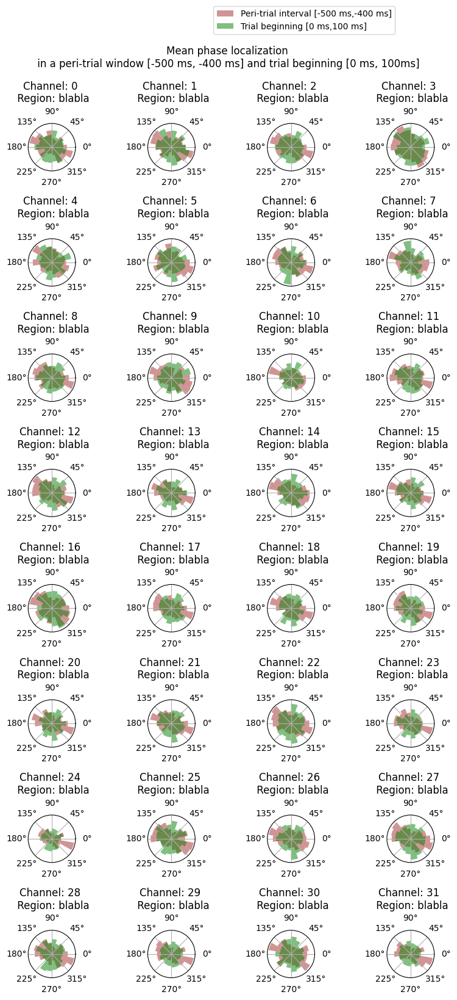

In [ ]:
#Plot the results as a panel with 32 polar histograms of mean phase count

#The results should be stored in a dictionary named channel_phasedist_results
fig, axes = plt.subplots(nrows=8, ncols=4,figsize=(8,16))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Mean phase localization \n in a peri-trial window [-500 ms, -400 ms] and trial beginning [0 ms, 100ms] \n')

channel_counter = 0

num_bins=18
bins = np.linspace(0,2*np.pi,num_bins+1)
width = 2*np.pi/num_bins

for ax in axes.flatten():
  pre_dist,trial_dist = channel_phasedist_results[f'ch{channel_counter}']

  series1_counts,_ = np.histogram(pre_dist,bins)
  series2_counts,_ = np.histogram(trial_dist,bins)

  #only label the first two plots because otherwise we would have repeated labelling
  if channel_counter == 0:
    labels = ('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]')
  else:
    labels = (None,None)
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color='brown',alpha=0.5,label=labels[0])
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color='green',alpha=0.5,label=labels[1])

  plt.title(f'Channel: {channel_counter} \n Region: blabla')
  plt.yticks([])

  channel_counter+=1

#fetch the labels for each axis in axes
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels,bbox_to_anchor=(0.85,1.025))

fig.tight_layout()

### upping up the plotting game

to do:
- check if there is significance in a KS test between these two distributions
  - if not, elect the plot colour from a greyscale pair (light and dark grey)
  - else, if the distributions are significantly different:
    - get the channel ID and look it up in the _regions_listing_ to see whether it belongs to the STR or PFC
    - conditionally select the color palette
- plot

In [ ]:
with open("./channel_region", "r") as fp:
  regions_listing = json.load(fp) #load the JSON with channel-region pairings
#region = regions_listing[f'ch{channel_id}'] #from it fetch the region for the current channel

In [ ]:
regions_listing;

In [ ]:
scipy.stats.kstest(pre_dist,trial_dist)[1]

0.15424534212318647

In [ ]:
scipy.stats.kstest(list(peri.values()),list(target.values()))

<ipython-input-60-9830e5b11b10>:29: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


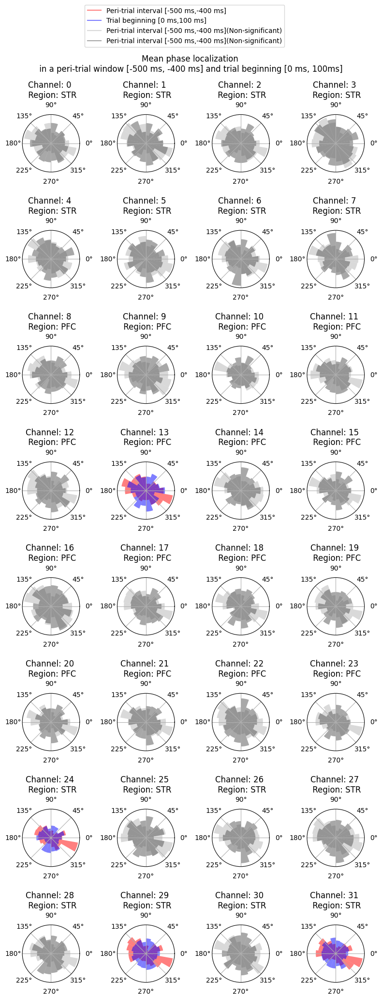

In [ ]:
#Plot the results as a panel with 32 polar histograms of mean phase count

#The results should be stored in a dictionary named channel_phasedist_results
fig, axes = plt.subplots(nrows=8, ncols=4,figsize=(8,20))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Mean phase localization \n in a peri-trial window [-500 ms, -400 ms] and trial beginning [0 ms, 100ms] \n')

channel_counter = 0

num_bins=18
bins = np.linspace(0,2*np.pi,num_bins+1)
width = 2*np.pi/num_bins

for ax in axes.flatten():
  pre_dist,trial_dist = channel_phasedist_results[f'ch{channel_counter}']

  channel_region = channel_region_pairs[f'ch{channel_counter}']

  if scipy.stats.kstest(pre_dist,trial_dist)[1] <= 0.05:
    colors = ['red','blue']
  else:
    colors = ['#b5b5b5','#525252']

  series1_counts,_ = np.histogram(pre_dist,bins)
  series2_counts,_ = np.histogram(trial_dist,bins)

  #only label the first two plots with significant statistics because otherwise we would have repeated labelling

  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')

  if channel_counter == 0:
    labels = ('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]')
    #ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
    label1 = ax.plot([], [], color='red',alpha=0.5,label=labels[0])
    label2 = ax.plot([], [], color='blue',alpha=0.5,label=labels[1])
    label3 = ax.plot([], [], color='#b5b5b5',alpha=0.5,label=labels[0]+'(Non-significant)')
    label4 = ax.plot([], [], color='#525252',alpha=0.5,label=labels[0]+'(Non-significant)')
  else:
    labels = (None,None)
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color=colors[0],alpha=0.5)
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color=colors[1],alpha=0.5)

  plt.title(f'Channel: {channel_counter} \n Region: {channel_region}')
  plt.yticks([])

  channel_counter+=1

#fetch the labels for each axis in axes
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels,bbox_to_anchor=(0.75,1.035))

fig.tight_layout()

### rest

In [ ]:
#Plot the results as a panel with 32 polar histograms of mean phase count

#The results should be stored in a dictionary named channel_phasedist_results
fig, axes = plt.subplots(nrows=1, ncols=32,figsize=(12,22))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Mean phase localization \n in a peri-trial window [-500 ms, -400 ms] and trial beginning [0 ms, 100ms] \n')

channel_counter = 0

num_bins=18
bins = np.linspace(0,2*np.pi,num_bins+1)
width = 2*np.pi/num_bins

for ax in axes.flatten():
  pre_dist,trial_dist = channel_phasedist_results[f'ch{channel_counter}']

  series1_counts,_ = np.histogram(pre_dist,bins)
  series2_counts,_ = np.histogram(trial_dist,bins)

  #only label the first two plots because otherwise we would have repeated labelling
  if channel_counter == 0:
    labels = ('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]')
  else:
    labels = (None,None)
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color='red',alpha=0.5,label=labels[0])
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color='blue',alpha=0.5,label=labels[1])

  plt.title(f'Channel: {channel_counter}')
  plt.yticks([])

  channel_counter+=1

#fetch the labels for each axis in axes
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels,bbox_to_anchor=(0.85,1.025))

fig.tight_layout()

### throwaway

In [ ]:
#estimate phase distributions for both a 100 ms window at both a peri-trial instant and at trial beginning over all channels
fig, axes = plt.subplots(nrows=8, ncols=4,figsize=(8,16))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Mean phase localization \n in a peri-trial window [-500 ms, -400 ms] and trial beginning [0 ms, 100ms] \n')

channel_counter = 0

for ax in axes.flatten():
  pre_dist,trial_dist = channel_results[f'ch{channel_counter}']

  #only label the first two plots because otherwise we would have repeated labelling
  if channel_counter = 0:
    labels = ('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]')
  else:
    labels = ('','')
  ax = comparison_circular_histogram(pre_dist,trial_dist,num_bins=18,
                                labels=,title='',channel=int(channel))

  channel_counter+=1

#fetch the labels for each axis in axes
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels,bbox_to_anchor=(0.85,1.025))

fig.tight_layout()

In [ ]:
for channel in channel_region_pairs.keys():
  pre_dist,trial_dist = channel_results[channel]

  fig, axs = plt.subplots(nrows=8, ncols=4)
  fig.title

  #ax[] = comparison_circular_histogram(pre_dist,trial_dist,num_bins=18,
                                labels=('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]'),title='',channel=int(channel))

ch_0
ch_1
ch_2
ch_3
ch_4
ch_5
ch_6
ch_7
ch_8
ch_9
ch_10
ch_11
ch_12
ch_13
ch_14
ch_15
ch_16
ch_17
ch_18
ch_19
ch_20
ch_21
ch_22
ch_23
ch_24
ch_25
ch_26
ch_27
ch_28
ch_29
ch_30
ch_31


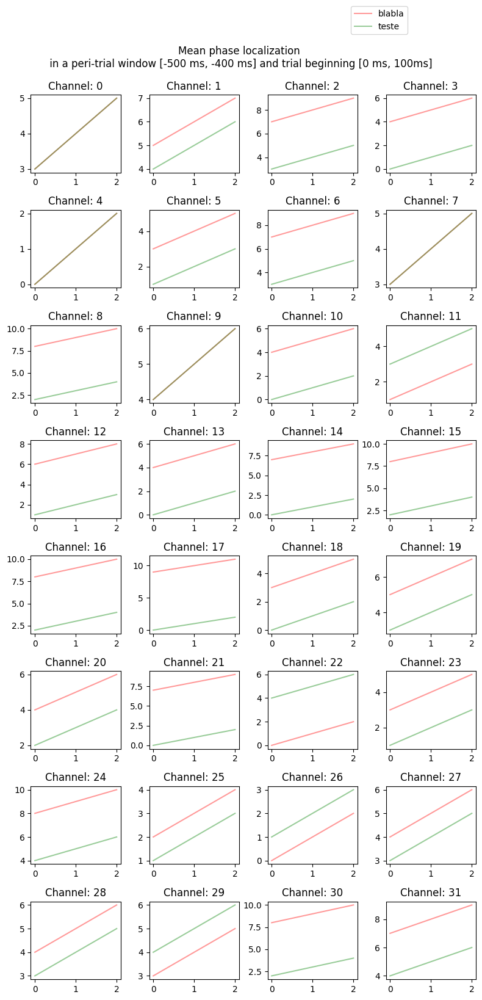

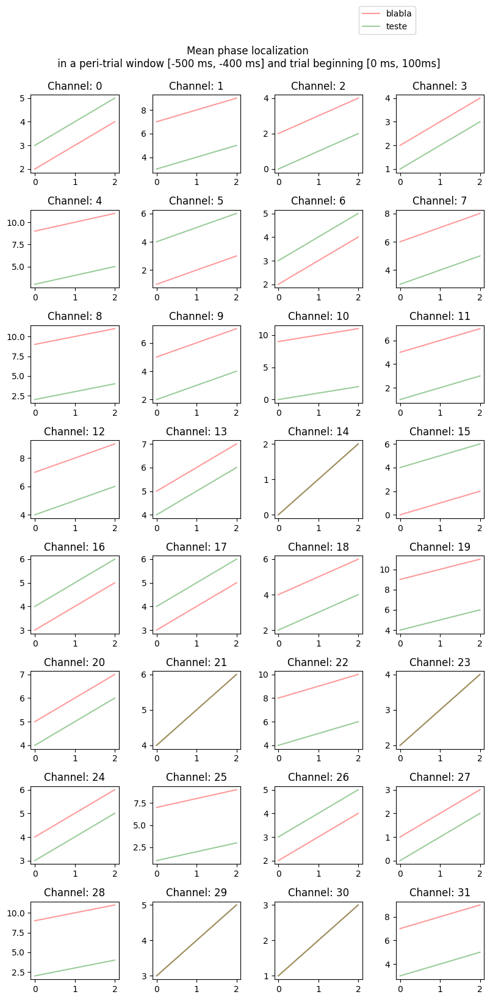

In [ ]:
fig, axes = plt.subplots(nrows=8, ncols=4,figsize=(8,16))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Mean phase localization \n in a peri-trial window [-500 ms, -400 ms] and trial beginning [0 ms, 100ms] \n')

counter = 0

for ax in axes.flatten():
  random_value1 = np.random.randint(10)
  random_value2 = np.random.randint(5)

  ax.set(title=f'Channel: {counter}')

  #only label the first two plots because otherwise we would have repeated labelling
  ax.plot(np.arange(random_value1,random_value1+3), color='red', alpha=0.4, label="blabla" if counter == 0 else "")
  ax.plot(np.arange(random_value2,random_value2+3), color='green', alpha=0.4, label="teste" if counter == 0 else "")
  counter+=1

#fetch the labels for each axis in axes
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels,bbox_to_anchor=(0.85,1.025))

fig.tight_layout()

In [ ]:
import json
with open("./channel_region", "r") as fp:
  channel_region_pairs = json.load(fp) #load the JSON with channel-region pairings

In [ ]:
    #file_path = f'./rat{rat_id}_day{day_id}_LFP_all'
    import json
    with open("./channel_region", "r") as fp:
        regions_listing = json.load(fp) #load the JSON with channel-region pairings
    region = regions_listing[f'ch{channel_id}'] #from it fetch the region for the current channel

    timestamps_data = np.squeeze(np.load('./timestamps.npy'))
    lfp_data = np.squeeze(np.load(f'./ch{channel_id}_'+region+'.npy'))

    df = pd.DataFrame.from_dict({'timestamps':timestamps_data,'lfp':lfp_data})


In [ ]:
rat = 3
day = 1

os.chdir(f'./data/separated_channels/rat{rat}_day{day}_LFP_all')

channel = 0
trial = 8
lfp,channel,region = load_lfp(rat_id = rat,day_id = day,channel_id = channel)
single_session = session_data.query(f"rat == {rat} and day == {day} and region == 'PFC' and duration >={0.8} and trial == {trial}")

import json
with open("./channel_region", "r") as fp:
  regions_listing = json.load(fp) #load the JSON with channel-region pairings

regions_listing.keys()

**itinerary**
- select a session (animal, day)
- load channel_region.json
- for channel in channel_region:
  - load the LFP of the said channel using load_lfp()
  - split this lfp into peri_trials_dict()
  - estimate phase_reset_dists and save it to a dict with {key:value} pairs = {channel:phase_dists}

- for channel in channel_region:
  - get the phase_dists for the current channel
  - plot its circular histograms

In [ ]:
#split_lfp_trials(session_df,lfp_df,rat_id,day_id,region_id,min_duration=0.8,sampling_rate=1250,
#                      slicing='first',peri_trial_inclusion = 0,per_slice=800)

def phase_reset_dists(peri_trials_dict,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250):

  '''
  estimate the circular mean of the LFP phase in a window following a target instant and in a window at some peri-target vicinity that happens before it
  e.g.:
        - target = 0 ms (trial beginning), peri-target = -500 ms (500 ms before trial begins)
        - target = EOT (end-of-trial), peri-target = -500 ms (500 ms before trial ends)

  input:
      - peri-trials-dict [dict]: {key:value} pairs are {trial:LFP} with LFP being the (continuous) signal cropped from durations [-peri_target,trial_duration]
      - min_freq, bandwidth [float, Hz]: the range in which the LFP will be filtered is from [min_freq,min_freq+bandwidth]
      - peri_trial [float, s]: how many seconds the peri-target vicinity is displaced from the target instant
      - window_width [float, s]: the timespan after which the signal at either the phases of peri- or target instants will be (circularly) averaged out

  output:
      - peri_phases,target_phases [dict]: the {key:value} pairs are {trial [string]:mean phase over either the peri-target or target instant + window[np.array]}
  '''

  #if there is no SciPy loaded it will prompt a failure, for we use scipy.stats.circmean and scipy.signal.hilbert
  assert scipy

  peri_points = int(peri_trial*sampling_rate)
  points_in_window = int(window_width*sampling_rate)

  peri_phases = {}
  target_phases = {}

  for trial in peri_trials_dict.keys():
    current_lfp_analytic = scipy.signal.hilbert(band_extraction(peri_trials_dict[trial].lfp,cutoff_low=min_freq,cutoff_high=min_freq+bandwidth,
                                               sampling_rate=sampling_rate))
    lfp_phase = np.angle(current_lfp_analytic)

    #get the mean phase from the beginning of the considered duration (peri-target instant + window)
    peri_phases.update({trial: scipy.stats.circmean(lfp_phase[0:points_in_window])})

    #get the mean phase from the target duration (all points in the peri_points [e.g. 625 for 500 ms of peri-trial interval at 1250 Hz of sampling rate] + window)
    target_phases.update({trial: scipy.stats.circmean(lfp_phase[peri_points:peri_points+points_in_window])})

  return peri_phases,target_phases

In [ ]:
def comparison_circular_histogram(phase_series1,phase_series2,num_bins=18,labels=(None,None),title='',**kwargs):
  if isinstance(kwargs['channel'],int):
    channel = kwargs['channel']
    title = f'Channel: {channel}'
  bins = np.linspace(0,2*np.pi,num_bins+1)
  series1_counts,_ = np.histogram(phase_series1,bins)
  series2_counts,_ = np.histogram(phase_series2,bins)

  plt.figure()
  width = 2*np.pi/num_bins
  ax = plt.subplot(1, 1, 1, projection='polar')
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color='red',alpha=0.5,label=labels[0])
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color='blue',alpha=0.5,label=labels[1])

  plt.title(title)
  plt.yticks([])

  #silly way to omit the legend if none is input
  if labels[0] != None and labels[1] != None:
    plt.legend()
  plt.tight_layout()

  return plt.gcf()

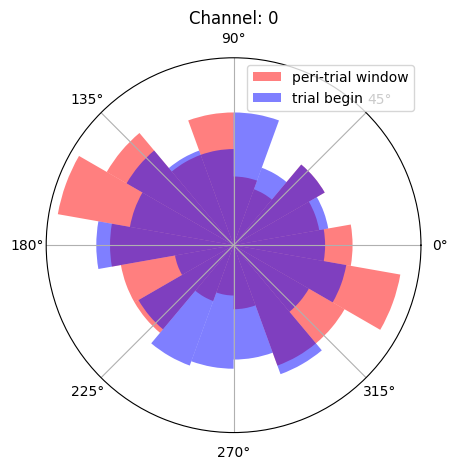

In [ ]:
a = comparison_circular_histogram(phase_series1 = np.array(list(peri.values())),phase_series2 = np.array(list(target.values())),num_bins=18,
                                  labels=('peri-trial window','trial begin'),channel=0)

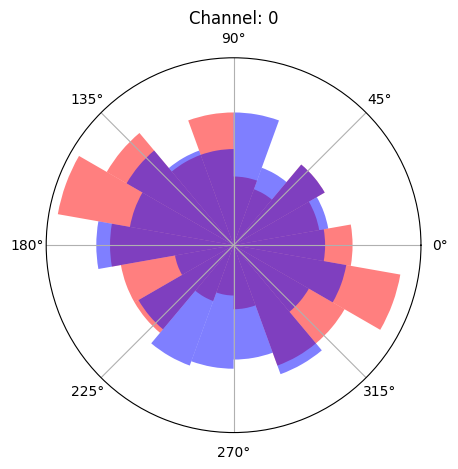

In [ ]:
a = comparison_circular_histogram(phase_series1 = np.array(list(peri.values())),phase_series2 = np.array(list(target.values())),num_bins=18,channel=0)

In [ ]:
scipy.stats.kstest(list(peri.values()),list(target.values()))

KstestResult(statistic=0.08705882352941176, pvalue=0.07978896433952487, statistic_location=2.0235016014978027, statistic_sign=-1)

In [ ]:
data_path = '/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels/'
os.chdir(data_path)
print(os.getcwd())
session_data = pd.read_csv('./data/session_data-spikes.csv').copy()

/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels


In [ ]:
os.getcwd()

'/content/drive/MyDrive/backup-mac/ufabc/entire-backup/lfp/all_channels'

In [ ]:
#session_data
rat = 3
day = 1

os.chdir(f'./data/separated_channels/rat{rat}_day{day}_LFP_all')

channel = 0
trial = 8
lfp,channel,region = load_lfp(rat_id = rat,day_id = day,channel_id = channel)
single_session = session_data.query(f"rat == {rat} and day == {day} and region == 'PFC' and duration >={0.8} and trial == {trial}")

In [ ]:
def split_lfp_trials(session_df,lfp_df,rat_id,day_id,region_id,min_duration=0.8,sampling_rate=1250,
                      slicing='first',peri_trial_inclusion = 0,per_slice=800):
    elegible_trials = session_df.query(f"rat == {rat_id} & day == {day_id} &\
    region == '{region_id}' & duration >= {min_duration}")
    elegible_trials = elegible_trials.sort_values('trial').copy()

    #separate the lfp df into a dictionary of trials, whose keys are trial identifiers and
    #values are dfs corresponding to excerpts of the whole lfp signal that fall between
    #each trials' time boundaries [trial begin, trial end]

    trials_dict = {}
    for trial in elegible_trials.trial.unique():
        #select the current trial in the behavioral/spikes dataframe
        current_trial = elegible_trials.query(f"trial == {int(trial)}")
        #extract the timestamps for the beginning and end of trial using the 1st
        #spike (begin) and total duration (end)
        begin = current_trial.iloc[0].timestamp - current_trial.iloc[0].time
        print(begin,begin-peri_trial_inclusion)
        end = begin + current_trial.iloc[0].duration
        #fetch the lfp data within these two timepoints and add to the dict as our trial
        current_lfp = lfp_df.query(f"timestamps >= {begin-peri_trial_inclusion} & timestamps <= {end}")

        if slicing == 'first':
                trials_dict[f'trial_{int(trial)}'] = current_lfp.head(per_slice)
        elif slicing == 'last':
            trials_dict[f'trial_{int(trial)}'] = current_lfp.tail(per_slice)
        elif slicing == 'none':
            trials_dict[f'trial_{int(trial)}'] = current_lfp

        break
    print('done parsing the LFP into trials')

    return trials_dict

In [ ]:
#minimum duration to exclude shorter trials in which the band extraction might be impossible
min_trial_duration = 0.8 #in seconds

#how many seconds before the actual trial beginning should be considered as before-trial
peri_trial = 0.5 #in seconds

sampling_rate = 1250 #in Hz

#number of points: points in the peri_trial (pre-beginning) + points in trial, both estimated as timespan * sampling_rate
per_slice = int((peri_trial+min_trial_duration)*sampling_rate)

#the timespan in which the phase will be (circularly) averaged over in each of the points of interest [peri- and target-instant]
window_width = 0.1 #in s

In [ ]:
peri_trial_dict = split_lfp_trials(session_data,lfp,rat,day,region,min_duration=0.8,sampling_rate=1250,
                      slicing='first',peri_trial_inclusion = 0.5,per_slice=1300)

done parsing the LFP into trials


In [ ]:
peri,target = phase_reset_dists(peri_trials_dict=peri_trial_dict,peri_trial = 0.5,window_width=0.1,min_freq=1,bandwidth = 19,sampling_rate=1250)

In [ ]:
def comparison_circular_histogram(phase_series1,phase_series2,num_bins=18,labels=(None,None),title='',**kwargs):
  if isinstance(kwargs['channel'],int):
    channel = kwargs['channel']
    title = f'Channel: {channel}'
  bins = np.linspace(0,2*np.pi,num_bins+1)
  series1_counts,_ = np.histogram(phase_series1,bins)
  series2_counts,_ = np.histogram(phase_series2,bins)

  plt.figure()
  width = 2*np.pi/num_bins
  ax = plt.subplot(1, 1, 1, projection='polar')
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color='red',alpha=0.5,label=labels[0])
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color='blue',alpha=0.5,label=labels[1])

  plt.title(title)
  plt.yticks([])

  #silly way to omit the legend if none is input
  if labels[0] != None and labels[1] != None:
    plt.legend()
  plt.tight_layout()

  return plt.gcf()

<ipython-input-69-b6f7a1ad808a>:28: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')


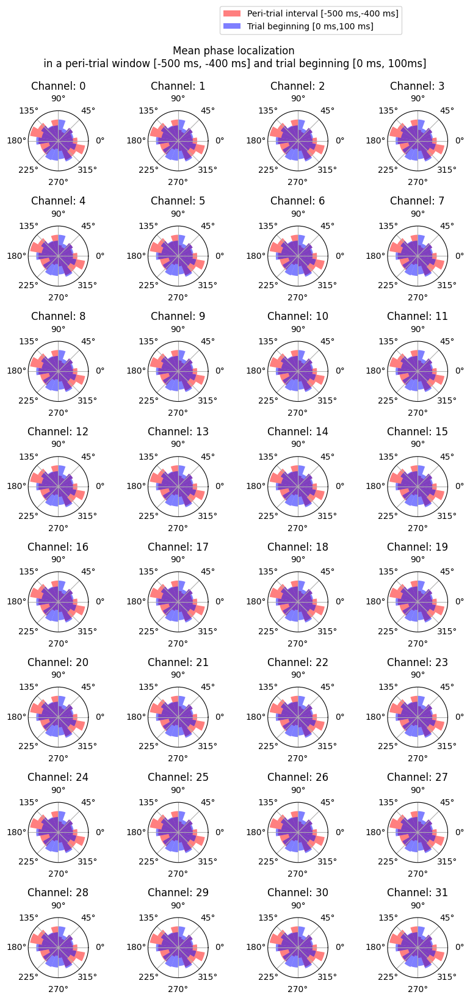

In [ ]:
channel_results = {}
for channel in range(32):
  channel_results.update({f'ch{channel}':[np.array(list(peri.values())),np.array(list(target.values())),]})

num_bins = 18

#estimate phase distributions for both a 100 ms window at both a peri-trial instant and at trial beginning over all channels
fig, axes = plt.subplots(nrows=8, ncols=4,figsize=(8,16))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Mean phase localization \n in a peri-trial window [-500 ms, -400 ms] and trial beginning [0 ms, 100ms] \n')

channel_counter = 0

bins = np.linspace(0,2*np.pi,num_bins+1)
width = 2*np.pi/num_bins

for ax in axes.flatten():
  pre_dist,trial_dist = channel_results[f'ch{channel_counter}']

  series1_counts,_ = np.histogram(pre_dist,bins)
  series2_counts,_ = np.histogram(trial_dist,bins)

  #only label the first two plots because otherwise we would have repeated labelling
  if channel_counter == 0:
    labels = ('Peri-trial interval [-500 ms,-400 ms]','Trial beginning [0 ms,100 ms]')
  else:
    labels = (None,None)
  ax = plt.subplot(8, 4, channel_counter+1, projection='polar')
  series1_bars = ax.bar(bins[:num_bins], series1_counts, width=width, bottom=0.0,color='red',alpha=0.5,label=labels[0])
  series2_bars = ax.bar(bins[:num_bins], series2_counts, width=width, bottom=0.0,color='blue',alpha=0.5,label=labels[1])

  plt.title(f'Channel: {channel_counter}')
  plt.yticks([])

  channel_counter+=1

#fetch the labels for each axis in axes
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels,bbox_to_anchor=(0.85,1.025))

fig.tight_layout()

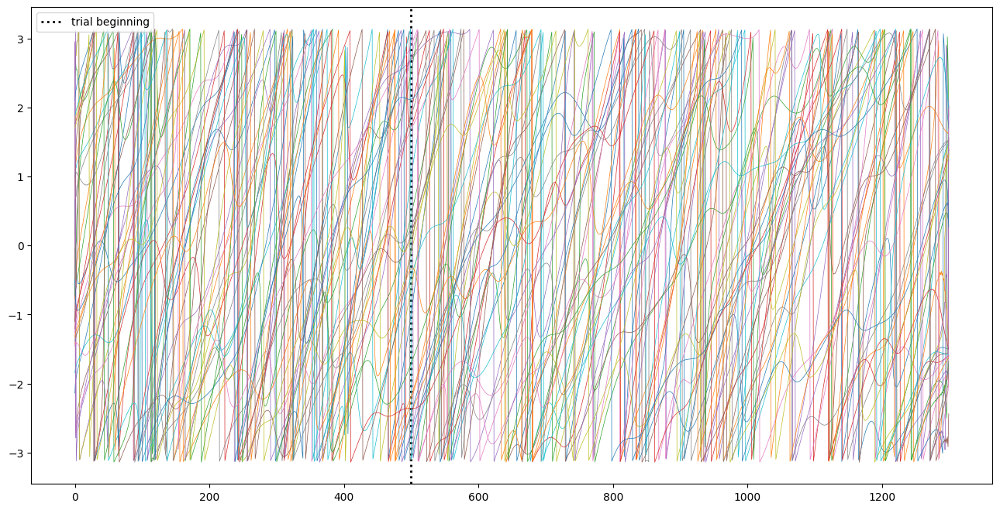

In [ ]:
from scipy.signal import hilbert
fp = 1
ind_bandwidth = 19
sampling_rate = 1250

phases_dict = {}

plt.figure(figsize=(16,8))
plt.axvline(500,color='black',linestyle='dotted',linewidth = 2,label='trial beginning')
counter = 0
for trial in peri_trial_dict.keys():
   current_lfp_analytic = hilbert(band_extraction(peri_trial_dict[trial].lfp,cutoff_low=fp,cutoff_high=fp+ind_bandwidth,
                                               sampling_rate=sampling_rate))
   lfp_phase = np.angle(current_lfp_analytic)
   plt.plot(lfp_phase,linewidth=0.5)
   if counter > 30:
     break

   counter+=1
plt.legend()
plt.show()

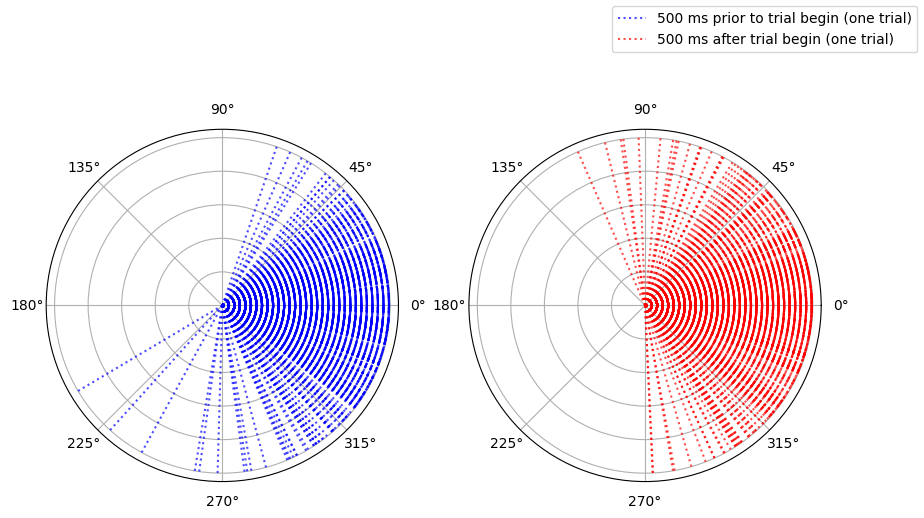

In [ ]:
from scipy.signal import hilbert
fp = 1
ind_bandwidth = 19
sampling_rate = 1250

pre_phases = []
post_phases = []

counter = 0
for trial in peri_trial_dict.keys():
  current_lfp_analytic = hilbert(band_extraction(peri_trial_dict[trial].lfp,cutoff_low=fp,cutoff_high=fp+ind_bandwidth,
                                               sampling_rate=sampling_rate))
  lfp_phase = np.angle(current_lfp_analytic)

  #get the mean phase before and after the trial beginning
  pre_phases.append(np.mean(lfp_phase[0:500]))
  post_phases.append(np.mean(lfp_phase[800:1300]))

  #if counter > 50:
  #  break

  counter+=1

fig = plt.figure(figsize=(10,6))
ax1 = plt.subplot(1, 2, 1,polar=True)
#ax = plt.subplot(111, polar=True)  # Create subplot
ax1.set_rmax(1)
ax1.set_yticklabels([])

#mean phases in each trial 100ms before trial beginning
ax1.vlines(x=pre_phases,ymin=0,ymax=.5,colors='blue',zorder=3,linestyle='dotted',alpha=0.7,label='500 ms prior to trial begin (one trial)')

ax2 = plt.subplot(1, 2, 2,polar=True)
#ax = plt.subplot(111, polar=True)  # Create subplot
ax2.set_rmax(1)
ax2.set_yticklabels([])
#mean phases in each trial 100ms after trial beginning
ax2.vlines(x=post_phases,ymin=0,ymax=.5,colors='red',zorder=2,linestyle='dotted',alpha=0.7,label='500 ms after trial begin (one trial)')

fig.legend()
fig.show()

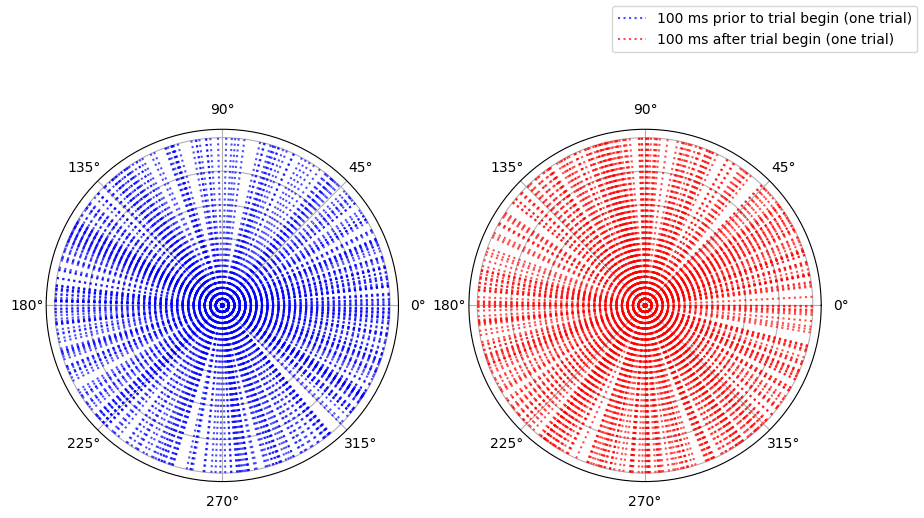

In [ ]:
from scipy.signal import hilbert
fp = 1
ind_bandwidth = 19
sampling_rate = 1250

pre_phases = []
post_phases = []

counter = 0
for trial in peri_trial_dict.keys():
  current_lfp_analytic = hilbert(band_extraction(peri_trial_dict[trial].lfp,cutoff_low=fp,cutoff_high=fp+ind_bandwidth,
                                               sampling_rate=sampling_rate))
  lfp_phase = np.angle(current_lfp_analytic)

  #get the mean phase before and after the trial beginning
  pre_phases.append(scipy.stats.circmean(lfp_phase[0:100]))
  post_phases.append(scipy.stats.circmean(lfp_phase[500:600]))

  counter+=1

fig = plt.figure(figsize=(10,6))
ax1 = plt.subplot(1, 2, 1,polar=True)
#ax = plt.subplot(111, polar=True)  # Create subplot
ax1.set_rmax(1)
ax1.set_yticklabels([])

#mean phases in each trial 100ms before trial beginning
ax1.vlines(x=pre_phases,ymin=0,ymax=.5,colors='blue',zorder=3,linestyle='dotted',alpha=0.7,label='100 ms prior to trial begin (one trial)')

ax2 = plt.subplot(1, 2, 2,polar=True)
#ax = plt.subplot(111, polar=True)  # Create subplot
ax2.set_rmax(1)
ax2.set_yticklabels([])
#mean phases in each trial 100ms after trial beginning
ax2.vlines(x=post_phases,ymin=0,ymax=.5,colors='red',zorder=2,linestyle='dotted',alpha=0.7,label='100 ms after trial begin (one trial)')

fig.legend()
fig.show()

- média polar da fase
- discriminar qual trial na sessão (cor ou terços/metades)
- ver antecipação de movimento pelo final

In [ ]:
from scipy import stats
stats.kstest(pre_phases,post_phases)

KstestResult(statistic=0.11294117647058824, pvalue=0.00879827219646031, statistic_location=-0.9636367079986771, statistic_sign=-1)

In [ ]:
stats.ttest_ind(pre_phases,post_phases)

Ttest_indResult(statistic=1.4239744607088944, pvalue=0.15482171485728122)

In [ ]:
#also see variance of phases: if
print(np.var(pre_phases),np.var(post_phases))

1.145436104810954 1.430563367687709


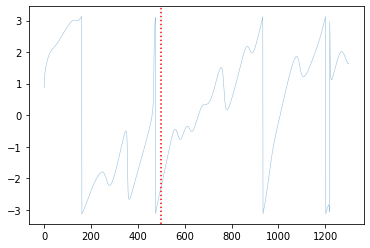

In [ ]:
plt.figure
plt.plot(lfp_phase,linewidth=0.5,alpha=0.5)
plt.axvline(500,color='red',linestyle='dotted')

In [ ]:
peri_trial_dict['trial_174'].lfp

5382852   -2120
5382853   -2111
5382854   -2004
5382855   -1678
5382856   -1648
           ... 
5383647    7303
5383648    7408
5383649    7305
5383650    7490
5383651    7518
Name: lfp, Length: 800, dtype: int16